In [ ]:
# Import necessary libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import itertools
from tabulate import tabulate

import warnings
warnings.filterwarnings("ignore")


In [ ]:
#Mount google drive to google colab
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


# **FUntions for common usage**

In [ ]:

# Plot box plots and calculate number of outliers for specified columns.
def plot_box_and_outliers(columns):
    # Set up subplots
    fig, axes = plt.subplots(nrows=len(columns), figsize=(15, 5 * len(columns)))

    for i, col in enumerate(columns):
        # Plot box plot
        sns.boxplot(x=application_data_df[col], ax=axes[i])
        axes[i].set_title(f'Box Plot - {col}')

        # Calculate and print number of outliers
        Q1 = application_data_df[col].quantile(0.25)
        Q3 = application_data_df[col].quantile(0.75)
        IQR = Q3 - Q1
        lower_bound = Q1 - 1.5 * IQR
        upper_bound = Q3 + 1.5 * IQR
        outliers = application_data_df[(application_data_df[col] < lower_bound) | (application_data_df[col] > upper_bound)][col]

        axes[i].text(1.05, 0.5, f'Outliers: {len(outliers)}', transform=axes[i].transAxes, fontsize=12, verticalalignment='center')

    plt.tight_layout()
    plt.show()
    print("\n" + "-"*200 + "\n")

In [ ]:

# Function to plot value counts for specified column(s)
def plot_value_counts(columns):
    if not isinstance(columns, list):
        columns = [columns]

    for column in columns:
        # Plot value counts
        plt.figure(figsize=(8, 4))
        sns.countplot(x=column, data=application_data_df, palette="viridis")

        # Annotate the count
        for p in plt.gca().patches:
            plt.gca().annotate(f"{p.get_height()}", (p.get_x() + p.get_width() / 2., p.get_height()),
                               ha='center', va='center', xytext=(0, 10), textcoords='offset points')

        plt.title(f"Value Counts for '{column}' Variable")
        plt.xlabel(column)
        plt.ylabel("Count")
        # Rotate x-axis labels by 45 degrees
        plt.xticks(rotation=45)
        plt.show()
        print("\n" + "-"*200 + "\n")




In [ ]:
# Function to Display info about specified columns
def display_column_info(cols):
    # Iterate through each column in cols
    for col in cols:
        # Get unique values and their counts, including NaN
        value_counts = application_data_df[col].value_counts(dropna=False)

        # Get the data type of the column
        data_type = application_data_df[col].dtype

        # Display the results in tabular format
        print(f"Unique values, counts, and data type for {col}:\n")
        table_data = value_counts.reset_index()
        table_data['Data Type'] = data_type
        print(tabulate(table_data, headers=['Index', col, 'Count', 'Data Type'], tablefmt='pretty'))
        print("\n")

        # Plot pie chart for percentage distribution
        plt.figure(figsize=(6, 6))
        plt.pie(value_counts, labels=value_counts.index, autopct='%1.1f%%', startangle=140, explode=[0.1 if index is None else 0 for index in value_counts.index])
        plt.title(f"Percentage Distribution for {col}")
        plt.show()
        print("\n" + "-"*200 + "\n")

In [ ]:

#  Plot box plots, calculate the percentage of outliers
def plot_box_and_outliers(columns):

    # Set a custom color palette
    custom_palette = sns.color_palette("husl", n_colors=len(columns))

    # Set up subplots
    fig, axes = plt.subplots(nrows=len(columns), figsize=(15, 5 * len(columns)))

    for i, col in enumerate(columns):
        # Plot box plot with custom color
        sns.boxplot(x=application_data_df[col], ax=axes[i], color=custom_palette[i])
        axes[i].set_title(f'Box Plot - {col}')

        # Calculate and print percentage of outliers
        Q1 = application_data_df[col].quantile(0.25)
        Q3 = application_data_df[col].quantile(0.75)
        IQR = Q3 - Q1
        lower_bound = Q1 - 1.5 * IQR
        upper_bound = Q3 + 1.5 * IQR
        outliers = application_data_df[(application_data_df[col] < lower_bound) | (application_data_df[col] > upper_bound)][col]
        percentage_outliers = (len(outliers) / len(application_data_df)) * 100

        axes[i].text(1.05, 0.5, f'Outliers: {len(outliers)} ({percentage_outliers:.2f}%)',
                     transform=axes[i].transAxes, fontsize=12, verticalalignment='center')

        # Add dynamic annotations for median, IQR, lower bound, and upper bound values
        median_val = application_data_df[col].median()
        axes[i].annotate(f'Median: {median_val:.2f}', xy=(0.5, 0.97), xycoords='axes fraction', ha='center', fontsize=10, color='red')

        axes[i].annotate(f'IQR: {IQR:.2f}', xy=(0.5, 0.92), xycoords='axes fraction', ha='center', fontsize=10, color='blue')

        #axes[i].annotate(f'Lower Bound: {lower_bound:.2f}', xy=(0.5, 0.87), xycoords='axes fraction', ha='center', fontsize=10, color='green')

        #axes[i].annotate(f'Upper Bound: {upper_bound:.2f}', xy=(0.5, 0.82), xycoords='axes fraction', ha='center', fontsize=10, color='purple')

        # Enhance visual appeal
        axes[i].grid(True, linestyle='--', alpha=0.7)
        axes[i].set_ylabel("Values")
        axes[i].set_xlabel(col)
        sns.despine()

    plt.tight_layout()
    plt.show()
    print("\n" + "-"*200 + "\n")

In [ ]:

# Function to Bin non-continuous numerical columns
def binning_non_continuous_numerical(column_list):
    for col in column_list:
        if not pd.api.types.is_numeric_dtype(application_data_df[col]):
            continue

        n_bins = 5
        bins = pd.cut(application_data_df[col], n_bins, labels=range(1, n_bins + 1))
        application_data_df[col + '_binned'] = bins

        # Plot the original and binned values
        plt.figure(figsize=(10, 6))

        plt.subplot(2, 1, 1)
        plt.hist(application_data_df[col].dropna(), bins='auto', color='skyblue', alpha=0.7)
        plt.title(f'Original Distribution - {col}')
        plt.xlabel(col)
        plt.ylabel('Frequency')

        plt.subplot(2, 1, 2)
        plt.hist(application_data_df[col + '_binned'].dropna(), bins='auto', color='coral', alpha=0.7)
        plt.title(f'Binned Distribution - {col}')
        plt.xlabel(col + '_binned')
        plt.ylabel('Frequency')

        plt.tight_layout()
        plt.show()
        print("\n" + "-"*200 + "\n")

In [ ]:
# Function to Replace outliers in specified numerical continuos columns with the median value.
def replace_outliers_with_median( numerical_continuous_columns):
    for col in numerical_continuous_columns:
        # Calculate the median of the column
        median_value = application_data_df [col].median()

        # Calculate the IQR for outlier detection
        Q1 = application_data_df [col].quantile(0.25)
        Q3 = application_data_df [col].quantile(0.75)
        IQR = Q3 - Q1

        # Define the bounds for outliers
        lower_bound = Q1 - 1.5 * IQR
        upper_bound = Q3 + 1.5 * IQR

        # Replace outliers with the median
        application_data_df [col] = application_data_df [col].apply(lambda x: median_value if x < lower_bound or x > upper_bound else x)




# **1. Data Loading and Initial Exploration:**

**1.1: Data Loading**

In [ ]:
# Load datasets
application_data_df = pd.read_csv('/content/drive/My Drive/LLM/application_data.csv')
previous_application_df = pd.read_csv('/content/drive/My Drive/LLM/previous_application.csv', encoding='cp1252')
columns_description_df = pd.read_csv('/content/drive/My Drive/LLM/columns_description.csv', encoding='cp1252')

**1.2 : Initial Exploration**

Understand the structure, size, and basic statistics of the datasets

In [ ]:
#Glimpse at the initial portion of application_data_df.
print("Application Data:")
application_data_df.head()

Application Data:


,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,...,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
0,100002,1,Cash loans,M,N,Y,0,202500.0,406597.5,24700.5,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,1.0
1,100003,0,Cash loans,F,N,N,0,270000.0,1293502.5,35698.5,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
2,100004,0,Revolving loans,M,Y,Y,0,67500.0,135000.0,6750.0,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
3,100006,0,Cash loans,F,N,Y,0,135000.0,312682.5,29686.5,...,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN
4,100007,0,Cash loans,M,N,Y,0,121500.0,513000.0,21865.5,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0


In [ ]:
# To get a general understanding of the "application_data_df" DataFrame's structure and contents.
application_data_df.info(verbose=True)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 307511 entries, 0 to 307510
Data columns (total 122 columns):
 #    Column                        Dtype  
---   ------                        -----  
 0    SK_ID_CURR                    int64  
 1    TARGET                        int64  
 2    NAME_CONTRACT_TYPE            object 
 3    CODE_GENDER                   object 
 4    FLAG_OWN_CAR                  object 
 5    FLAG_OWN_REALTY               object 
 6    CNT_CHILDREN                  int64  
 7    AMT_INCOME_TOTAL              float64
 8    AMT_CREDIT                    float64
 9    AMT_ANNUITY                   float64
 10   AMT_GOODS_PRICE               float64
 11   NAME_TYPE_SUITE               object 
 12   NAME_INCOME_TYPE              object 
 13   NAME_EDUCATION_TYPE           object 
 14   NAME_FAMILY_STATUS            object 
 15   NAME_HOUSING_TYPE             object 
 16   REGION_POPULATION_RELATIVE    float64
 17   DAYS_BIRTH                    int64  
 18   DA

In [ ]:
# For initial data exploration and understanding of numerical columns
application_data_df.describe()

,SK_ID_CURR,TARGET,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,...,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
count,307511.000000,307511.000000,307511.000000,3.075110e+05,3.075110e+05,307499.000000,3.072330e+05,307511.000000,307511.000000,307511.000000,...,307511.000000,307511.000000,307511.000000,307511.000000,265992.000000,265992.000000,265992.000000,265992.000000,265992.000000,265992.000000
mean,278180.518577,0.080729,0.417052,1.687979e+05,5.990260e+05,27108.573909,5.383962e+05,0.020868,-16036.995067,63815.045904,...,0.008130,0.000595,0.000507,0.000335,0.006402,0.007000,0.034362,0.267395,0.265474,1.899974
std,102790.175348,0.272419,0.722121,2.371231e+05,4.024908e+05,14493.737315,3.694465e+05,0.013831,4363.988632,141275.766519,...,0.089798,0.024387,0.022518,0.018299,0.083849,0.110757,0.204685,0.916002,0.794056,1.869295
min,100002.000000,0.000000,0.000000,2.565000e+04,4.500000e+04,1615.500000,4.050000e+04,0.000290,-25229.000000,-17912.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,189145.500000,0.000000,0.000000,1.125000e+05,2.700000e+05,16524.000000,2.385000e+05,0.010006,-19682.000000,-2760.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,278202.000000,0.000000,0.000000,1.471500e+05,5.135310e+05,24903.000000,4.500000e+05,0.018850,-15750.000000,-1213.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000
75%,367142.500000,0.000000,1.000000,2.025000e+05,8.086500e+05,34596.000000,6.795000e+05,0.028663,-12413.000000,-289.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,3.000000
max,456255.000000,1.000000,19.000000,1.170000e+08,4.050000e+06,258025.500000,4.050000e+06,0.072508,-7489.000000,365243.000000,...,1.000000,1.000000,1.000000,1.000000,4.000000,9.000000,8.000000,27.000000,261.000000,25.000000


In [ ]:
# Checking no. of rows and columns of dataframe
application_data_df.shape

(307511, 122)

**1.3 : Identify and Handle Missing Values**

In [ ]:
# Find number of null values
null_counts = application_data_df.isnull().sum()

# Calculate percentage of null values for each column
null_percentages = (null_counts / len(application_data_df)) * 100

# Find columns with null percentage > 40%
cols_with_null_percentages_gt_40 = null_percentages[null_percentages > 40].index.tolist()
number_of_cols = len(cols_with_null_percentages_gt_40)
print(f"Number of columns with percentage of null values greater than 40%: {number_of_cols}")

Number of columns with percentage of null values greater than 40%: 49


In [ ]:
# Drop the columns which has high percentage of null values
application_data_df = application_data_df.drop(cols_with_null_percentages_gt_40, axis=1)

In [ ]:
#Create an empty list to store names of columns that can be removed
cols_to_be_dropped = []

In [ ]:
# Find columns with NaN values
columns_with_nan = application_data_df.columns[application_data_df.isnull().any()]

# Create a DataFrame to store the results
nan_info = pd.DataFrame(columns=['Column', 'Data Type', 'NaN Count', 'NaN Percentage'])

# Populate the DataFrame with information about NaN values
for column in columns_with_nan:
    nan_count = application_data_df[column].isnull().sum()
    nan_percentage = (nan_count / len(application_data_df)) * 100
    data_type = application_data_df[column].dtype
    nan_info = nan_info.append({'Column': column, 'Data Type': data_type, 'NaN Count': nan_count, 'NaN Percentage': nan_percentage}, ignore_index=True)

# Display the results using tabulate
print("Columns with NaN values:")
print(tabulate(nan_info, headers='keys', tablefmt='pretty', showindex=False))


Columns with NaN values:
+----------------------------+-----------+-----------+------------------------+
|           Column           | Data Type | NaN Count |     NaN Percentage     |
+----------------------------+-----------+-----------+------------------------+
|        AMT_ANNUITY         |  float64  |    12     |  0.003902299429939092  |
|      AMT_GOODS_PRICE       |  float64  |    278    |  0.09040327012692229   |
|      NAME_TYPE_SUITE       |  object   |   1292    |  0.42014757195677555   |
|      OCCUPATION_TYPE       |  object   |   96391   |   31.345545362604916   |
|      CNT_FAM_MEMBERS       |  float64  |     2     | 0.0006503832383231819  |
|        EXT_SOURCE_2        |  float64  |    660    |  0.21462646864665005   |
|        EXT_SOURCE_3        |  float64  |   60965   |   19.825307062186393   |
|  OBS_30_CNT_SOCIAL_CIRCLE  |  float64  |   1021    |   0.3320206431639844   |
|  DEF_30_CNT_SOCIAL_CIRCLE  |  float64  |   1021    |   0.3320206431639844   |
|  OBS_60_CNT_S

**1.4 : Explore and understand different columns of dataset.**

**1.4.1) 'TARGET', that contains Target variable**

 (1 - client with payment difficulties: he/she had late payment more than X days on at least one of the first Y installments of the loan in our sample, 0 - all other cases)

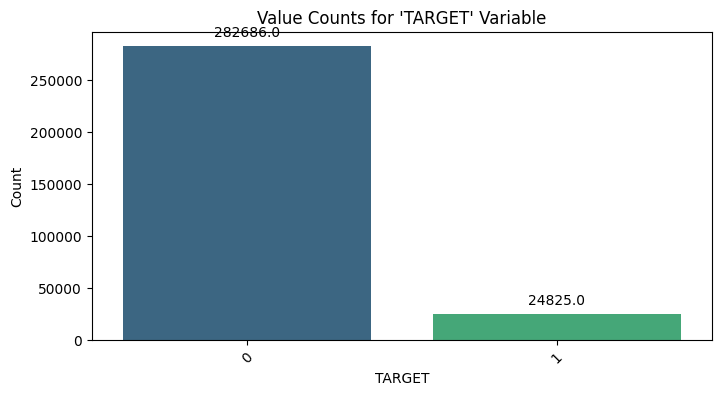


--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------



In [ ]:
plot_value_counts( 'TARGET')

**Inference :** Above graph shows that the data is highly imbalanced.

**1.4.2) CODE_GENDER**

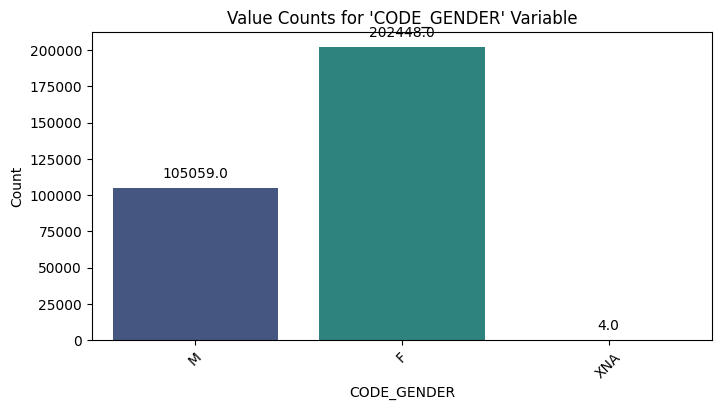


--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------



In [ ]:
plot_value_counts( 'CODE_GENDER')

**Inference :** The column which is Gender of the client has 3 categories (202448 for "F" and 105059 for "M"). It seems that "XNA" might be used as a placeholder or code for missing or unknown gender information. By replacing it with "F"(most frequent value),allows to fill in these missing values with a reasonable assumption.

In [ ]:
# Replace 'XNA' with 'F' in the 'CODE_GENDER' column
application_data_df['CODE_GENDER'].replace('XNA', 'F', inplace=True)

# Check the updated counts
unique_elements_count = application_data_df['CODE_GENDER'].value_counts()
print(unique_elements_count)


F    202452
M    105059
Name: CODE_GENDER, dtype: int64


**1.4.3) All columns starting with 'FLAG_DOCUMENT', that contains data, "Did client provide document"**

In [ ]:
# Get all column names that start with "FLAG_DOCUMENT"
flag_document_cols = [i for i in application_data_df if i.startswith('FLAG_DOCUMENT')]
# Get unique values for each column and store them in a dictionary
unique_values_dict = {}
for col in flag_document_cols:
  unique_values_dict[col] = application_data_df[col].unique().tolist()

# Print the results
print(unique_values_dict)

{'FLAG_DOCUMENT_2': [0, 1], 'FLAG_DOCUMENT_3': [1, 0], 'FLAG_DOCUMENT_4': [0, 1], 'FLAG_DOCUMENT_5': [0, 1], 'FLAG_DOCUMENT_6': [0, 1], 'FLAG_DOCUMENT_7': [0, 1], 'FLAG_DOCUMENT_8': [0, 1], 'FLAG_DOCUMENT_9': [0, 1], 'FLAG_DOCUMENT_10': [0, 1], 'FLAG_DOCUMENT_11': [0, 1], 'FLAG_DOCUMENT_12': [0, 1], 'FLAG_DOCUMENT_13': [0, 1], 'FLAG_DOCUMENT_14': [0, 1], 'FLAG_DOCUMENT_15': [0, 1], 'FLAG_DOCUMENT_16': [0, 1], 'FLAG_DOCUMENT_17': [0, 1], 'FLAG_DOCUMENT_18': [0, 1], 'FLAG_DOCUMENT_19': [0, 1], 'FLAG_DOCUMENT_20': [0, 1], 'FLAG_DOCUMENT_21': [0, 1]}


**Inference :** From inspection, all 'FLAG_DOCUMENT_' have unique value 0 and 1.

1 - customers who applied for loans and submitted document

0 - customers who applied for loans and did not submit document

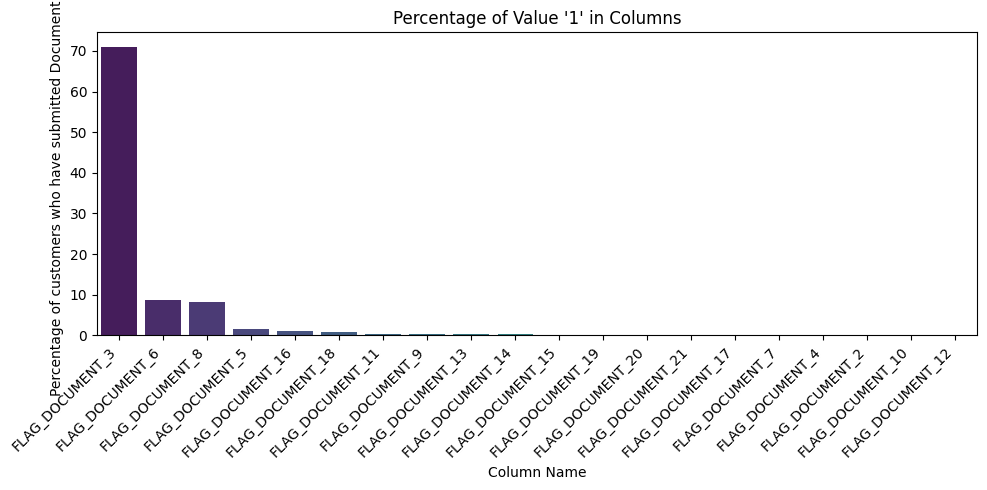

In [ ]:
# Calculate percentages of '1' in each column
percentages = (application_data_df[flag_document_cols].mean() * 100).to_frame(name="Percentage of 1")

# Sort percentages in descending order
percentages = percentages.sort_values(by="Percentage of 1", ascending=False)

# Choose a seaborn color palette
palette = sns.color_palette("viridis", len(percentages))

# Create a bar chart with the chosen color palette
plt.figure(figsize=(10, 5))
sns.barplot(x=percentages.index, y=percentages["Percentage of 1"], palette=palette)
plt.xlabel("Column Name")
plt.ylabel("Percentage of customers who have submitted Document (%)")
plt.title("Percentage of Value '1' in Columns")
plt.xticks(rotation=45, ha="right")  # Rotate x-axis labels for readability
plt.tight_layout()
plt.show()


**Inference:** The graph above illustrates that, for the majority of loan applications, clients who applied for loans did not submit any FLAG_DOCUMENT except for FLAG_DOCUMENT_3 and hence can be added to the list of columns to be removed.

In [ ]:
# FLAG_DOCUMENT column that is valid
element_to_remove = 'FLAG_DOCUMENT_3'

# Creates a separate copy of the list to prevent changes to the original.
flag_document_cols_to_be_dropped= flag_document_cols.copy()

# Remove 'FLAG_DOCUMENT_3' as it's a valid column
flag_document_cols_to_be_dropped.remove(element_to_remove)

#Add flag_document_cols_to_be_dropped to list of columns to be dropped
cols_to_be_dropped.extend(flag_document_cols_to_be_dropped)

**1.4.4) All columns starting with 'NAME_', that contains following data:**

NAME_CONTRACT_TYPE : Identification if loan is cash or revolving

NAME_TYPE_SUITE:Who was accompanying client when he was applying for the loan

NAME_INCOME_TYPE:Clients income type (businessman, working, maternity leave,…)

NAME_EDUCATION_TYPE:Level of highest education the client achieved

NAME_FAMILY_STATUS:Family status of the client

NAME_HOUSING_TYPE:What is the housing situation of the client (renting, living with parents, ...)

In [ ]:
# Get all column names that start with "NAME_"
name_cols = [i for i in application_data_df if i.startswith('NAME_')]

# Get unique values for each column and store them in a dictionary
unique_values_dict = {}
for col in name_cols:
  unique_values_dict[col] = application_data_df[col].unique().tolist()

# Print the results
print(unique_values_dict)

{'NAME_CONTRACT_TYPE': ['Cash loans', 'Revolving loans'], 'NAME_TYPE_SUITE': ['Unaccompanied', 'Family', 'Spouse, partner', 'Children', 'Other_A', nan, 'Other_B', 'Group of people'], 'NAME_INCOME_TYPE': ['Working', 'State servant', 'Commercial associate', 'Pensioner', 'Unemployed', 'Student', 'Businessman', 'Maternity leave'], 'NAME_EDUCATION_TYPE': ['Secondary / secondary special', 'Higher education', 'Incomplete higher', 'Lower secondary', 'Academic degree'], 'NAME_FAMILY_STATUS': ['Single / not married', 'Married', 'Civil marriage', 'Widow', 'Separated', 'Unknown'], 'NAME_HOUSING_TYPE': ['House / apartment', 'Rented apartment', 'With parents', 'Municipal apartment', 'Office apartment', 'Co-op apartment']}


Unique values, counts, and data type for NAME_CONTRACT_TYPE:

+-------+--------------------+--------+-----------+
| Index | NAME_CONTRACT_TYPE | Count  | Data Type |
+-------+--------------------+--------+-----------+
|   0   |     Cash loans     | 278232 |  object   |
|   1   |  Revolving loans   | 29279  |  object   |
+-------+--------------------+--------+-----------+




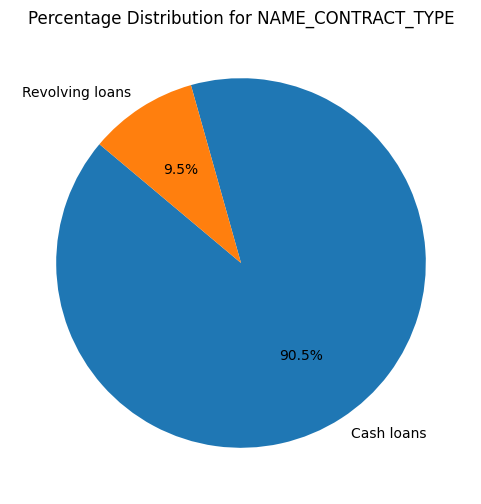


--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------

Unique values, counts, and data type for NAME_TYPE_SUITE:

+-------+-----------------+--------+-----------+
| Index | NAME_TYPE_SUITE | Count  | Data Type |
+-------+-----------------+--------+-----------+
|   0   |  Unaccompanied  | 248526 |  object   |
|   1   |     Family      | 40149  |  object   |
|   2   | Spouse, partner | 11370  |  object   |
|   3   |    Children     |  3267  |  object   |
|   4   |     Other_B     |  1770  |  object   |
|   5   |       nan       |  1292  |  object   |
|   6   |     Other_A     |  866   |  object   |
|   7   | Group of people |  271   |  object   |
+-------+-----------------+--------+-----------+




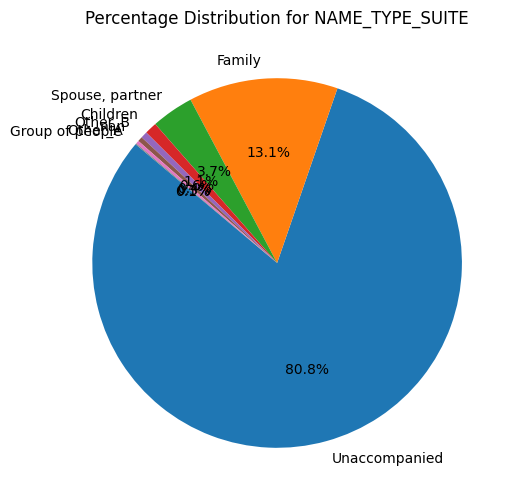


--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------

Unique values, counts, and data type for NAME_INCOME_TYPE:

+-------+----------------------+--------+-----------+
| Index |   NAME_INCOME_TYPE   | Count  | Data Type |
+-------+----------------------+--------+-----------+
|   0   |       Working        | 158774 |  object   |
|   1   | Commercial associate | 71617  |  object   |
|   2   |      Pensioner       | 55362  |  object   |
|   3   |    State servant     | 21703  |  object   |
|   4   |      Unemployed      |   22   |  object   |
|   5   |       Student        |   18   |  object   |
|   6   |     Businessman      |   10   |  object   |
|   7   |   Maternity leave    |   5    |  object   |
+-------+----------------------+--------+-----------+




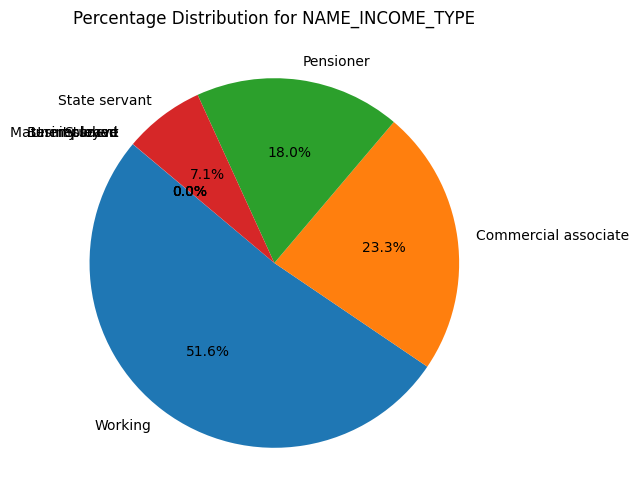


--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------

Unique values, counts, and data type for NAME_EDUCATION_TYPE:

+-------+-------------------------------+--------+-----------+
| Index |      NAME_EDUCATION_TYPE      | Count  | Data Type |
+-------+-------------------------------+--------+-----------+
|   0   | Secondary / secondary special | 218391 |  object   |
|   1   |       Higher education        | 74863  |  object   |
|   2   |       Incomplete higher       | 10277  |  object   |
|   3   |        Lower secondary        |  3816  |  object   |
|   4   |        Academic degree        |  164   |  object   |
+-------+-------------------------------+--------+-----------+




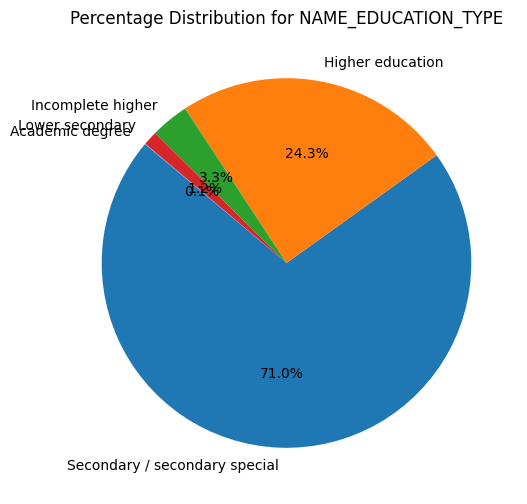


--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------

Unique values, counts, and data type for NAME_FAMILY_STATUS:

+-------+----------------------+--------+-----------+
| Index |  NAME_FAMILY_STATUS  | Count  | Data Type |
+-------+----------------------+--------+-----------+
|   0   |       Married        | 196432 |  object   |
|   1   | Single / not married | 45444  |  object   |
|   2   |    Civil marriage    | 29775  |  object   |
|   3   |      Separated       | 19770  |  object   |
|   4   |        Widow         | 16088  |  object   |
|   5   |       Unknown        |   2    |  object   |
+-------+----------------------+--------+-----------+




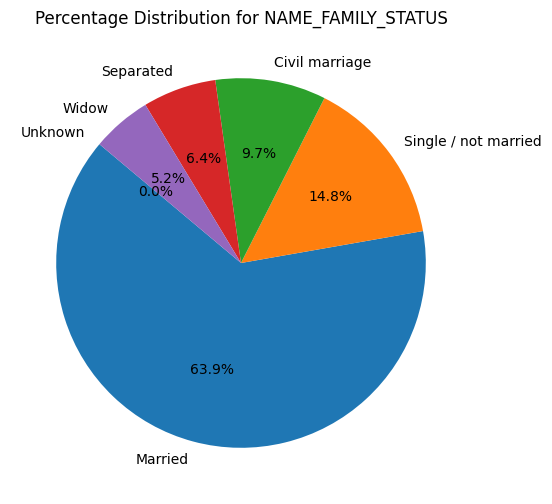


--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------

Unique values, counts, and data type for NAME_HOUSING_TYPE:

+-------+---------------------+--------+-----------+
| Index |  NAME_HOUSING_TYPE  | Count  | Data Type |
+-------+---------------------+--------+-----------+
|   0   |  House / apartment  | 272868 |  object   |
|   1   |    With parents     | 14840  |  object   |
|   2   | Municipal apartment | 11183  |  object   |
|   3   |  Rented apartment   |  4881  |  object   |
|   4   |  Office apartment   |  2617  |  object   |
|   5   |   Co-op apartment   |  1122  |  object   |
+-------+---------------------+--------+-----------+




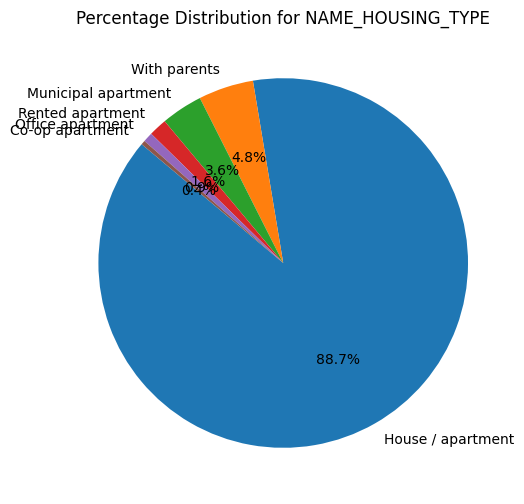


--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------



In [ ]:
display_column_info(name_cols)

**Inference :** Data type of each column is "object" . In "NAME_FAMILY_STATUS" column there are two values marked "Unknown" . As the count is very small, we can replace them with most frequent data in the list, which is "Married"

In [ ]:
# Replace "Unknown" values with "Married" in the specified column
application_data_df.loc[application_data_df["NAME_FAMILY_STATUS"] == "Unknown", "NAME_FAMILY_STATUS"] = "Married"

In [ ]:
# Iterate through each column in name_cols
for col in name_cols:
    # Check if the column has object data type
    if application_data_df[col].dtype == 'object':
        # Convert the data type to category
        application_data_df[col] = application_data_df[col].astype('category')

# Verify the changes
# Print data types of each column in name_cols
for col in name_cols:
    print(f"{col}: {application_data_df[col].dtype}")


NAME_CONTRACT_TYPE: category
NAME_TYPE_SUITE: category
NAME_INCOME_TYPE: category
NAME_EDUCATION_TYPE: category
NAME_FAMILY_STATUS: category
NAME_HOUSING_TYPE: category


**1.4.5) All columns starting with 'FLAG_', that contains following data:**

In [ ]:
# Find all column names that start with "FLAG_"
flag_filtered_columns = [col for col in application_data_df.columns if col.startswith("FLAG_") and "DOCUMENT" not in col]
print(flag_filtered_columns)

['FLAG_OWN_CAR', 'FLAG_OWN_REALTY', 'FLAG_MOBIL', 'FLAG_EMP_PHONE', 'FLAG_WORK_PHONE', 'FLAG_CONT_MOBILE', 'FLAG_PHONE', 'FLAG_EMAIL']


Unique values, counts, and data type for FLAG_OWN_CAR:

+-------+--------------+--------+-----------+
| Index | FLAG_OWN_CAR | Count  | Data Type |
+-------+--------------+--------+-----------+
|   0   |      N       | 202924 |  object   |
|   1   |      Y       | 104587 |  object   |
+-------+--------------+--------+-----------+




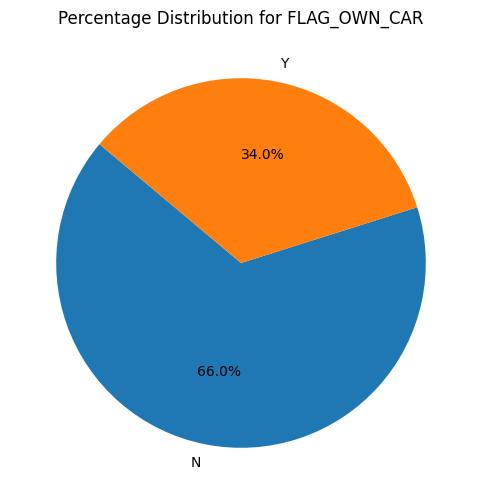


--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------

Unique values, counts, and data type for FLAG_OWN_REALTY:

+-------+-----------------+--------+-----------+
| Index | FLAG_OWN_REALTY | Count  | Data Type |
+-------+-----------------+--------+-----------+
|   0   |        Y        | 213312 |  object   |
|   1   |        N        | 94199  |  object   |
+-------+-----------------+--------+-----------+




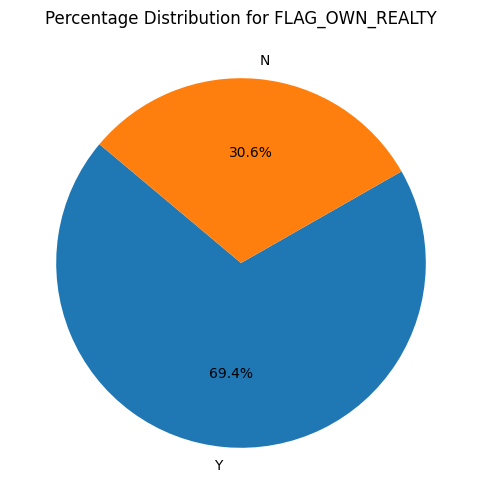


--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------

Unique values, counts, and data type for FLAG_MOBIL:

+-------+------------+--------+-----------+
| Index | FLAG_MOBIL | Count  | Data Type |
+-------+------------+--------+-----------+
|   0   |     1      | 307510 |   int64   |
|   1   |     0      |   1    |   int64   |
+-------+------------+--------+-----------+




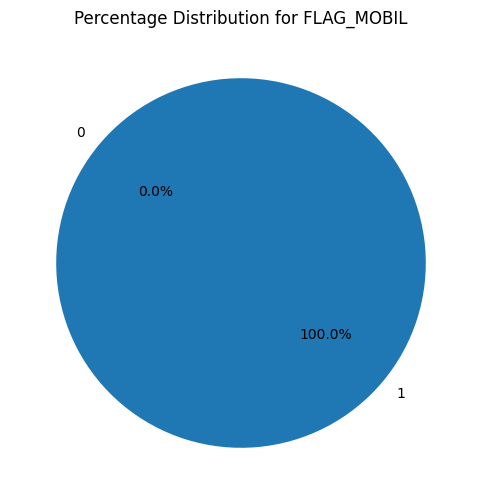


--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------

Unique values, counts, and data type for FLAG_EMP_PHONE:

+-------+----------------+--------+-----------+
| Index | FLAG_EMP_PHONE | Count  | Data Type |
+-------+----------------+--------+-----------+
|   0   |       1        | 252125 |   int64   |
|   1   |       0        | 55386  |   int64   |
+-------+----------------+--------+-----------+




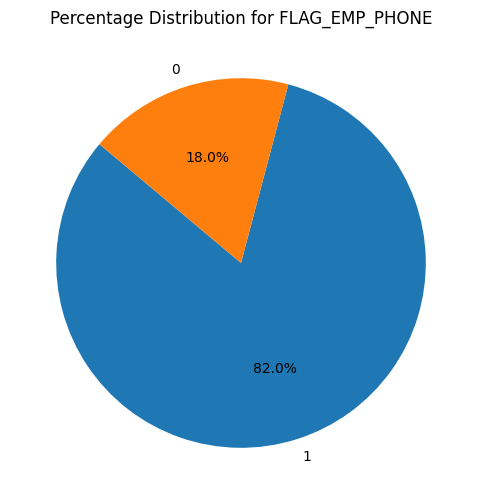


--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------

Unique values, counts, and data type for FLAG_WORK_PHONE:

+-------+-----------------+--------+-----------+
| Index | FLAG_WORK_PHONE | Count  | Data Type |
+-------+-----------------+--------+-----------+
|   0   |        0        | 246203 |   int64   |
|   1   |        1        | 61308  |   int64   |
+-------+-----------------+--------+-----------+




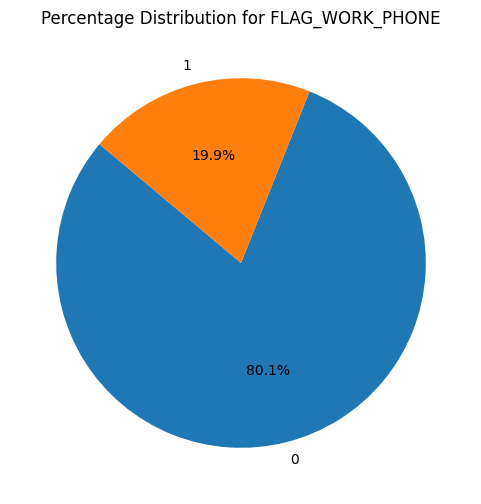


--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------

Unique values, counts, and data type for FLAG_CONT_MOBILE:

+-------+------------------+--------+-----------+
| Index | FLAG_CONT_MOBILE | Count  | Data Type |
+-------+------------------+--------+-----------+
|   0   |        1         | 306937 |   int64   |
|   1   |        0         |  574   |   int64   |
+-------+------------------+--------+-----------+




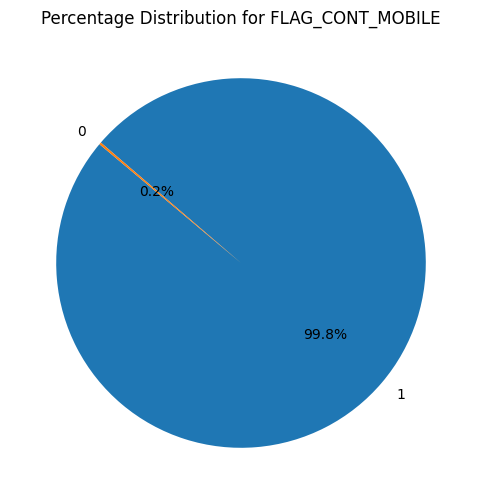


--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------

Unique values, counts, and data type for FLAG_PHONE:

+-------+------------+--------+-----------+
| Index | FLAG_PHONE | Count  | Data Type |
+-------+------------+--------+-----------+
|   0   |     0      | 221080 |   int64   |
|   1   |     1      | 86431  |   int64   |
+-------+------------+--------+-----------+




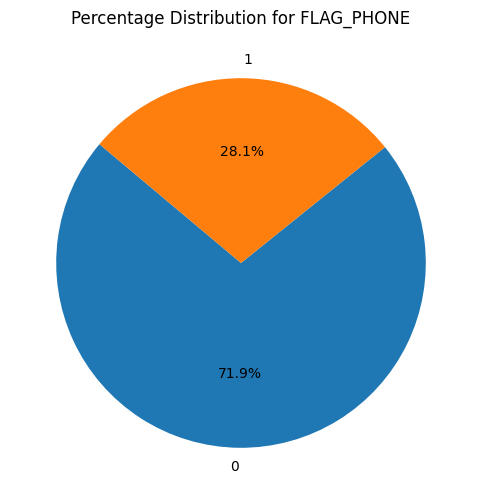


--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------

Unique values, counts, and data type for FLAG_EMAIL:

+-------+------------+--------+-----------+
| Index | FLAG_EMAIL | Count  | Data Type |
+-------+------------+--------+-----------+
|   0   |     0      | 290069 |   int64   |
|   1   |     1      | 17442  |   int64   |
+-------+------------+--------+-----------+




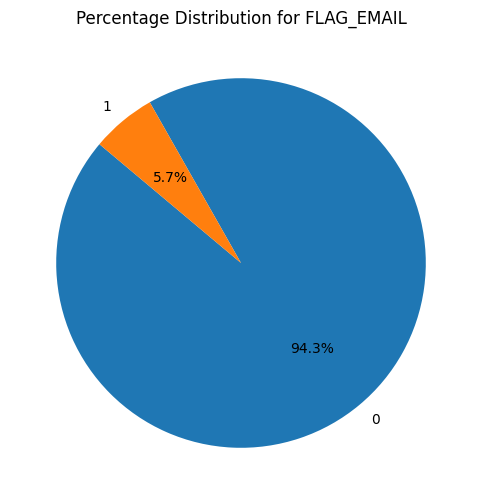


--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------



In [ ]:
display_column_info(flag_filtered_columns)

**Inference :** All "FLAG_" variables contains either "1" or "0" depending on Did client provide necessary details except for FLAG_OWN_CAR and FLAG_OWN_REALTY.

In [ ]:
# Use a dictionary to map old values to new values
value_map = {"Y": 1, "N": 0}

# Apply the mapping to the column
application_data_df["FLAG_OWN_CAR"] = application_data_df["FLAG_OWN_CAR"].map(value_map)
application_data_df["FLAG_OWN_REALTY"] = application_data_df["FLAG_OWN_REALTY"].map(value_map)

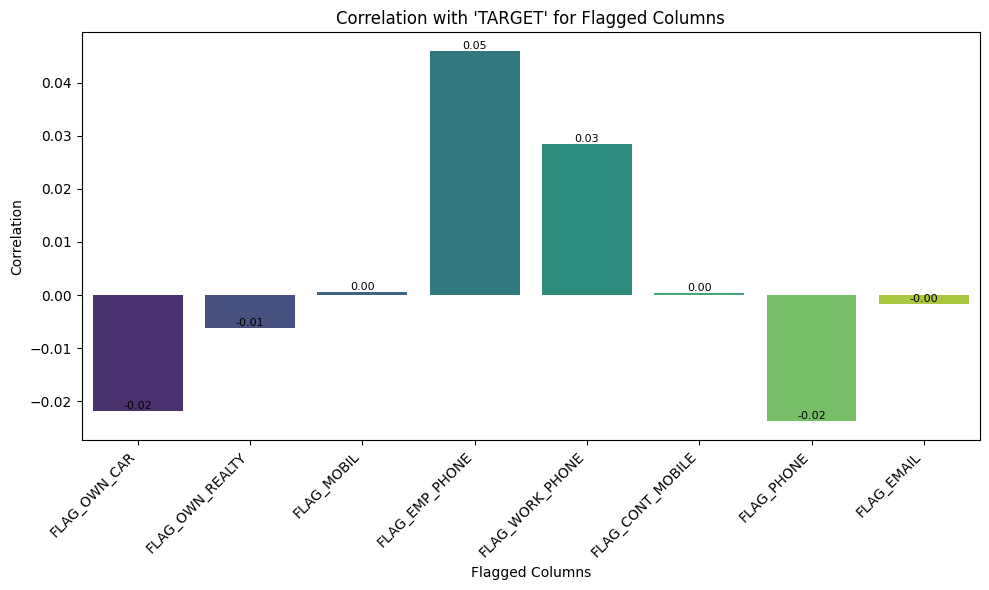

In [ ]:
correlation_results = {}

# Iterate through each column in flag_filtered_columns
for col in flag_filtered_columns:
    # Calculate the correlation with the "TARGET" column
    correlation_value = application_data_df[col].corr(application_data_df['TARGET'])

    # Store the correlation value in the dictionary
    correlation_results[col] = correlation_value

# Visualize the results in a bar plot with correlation values
plt.figure(figsize=(10, 6))
bar_plot = sns.barplot(x=list(correlation_results.keys()), y=list(correlation_results.values()), palette="viridis")

# Add correlation values as text on the bars
for i, v in enumerate(correlation_results.values()):
    bar_plot.text(i, v, f"{v:.2f}", ha="center", va="bottom", fontsize=8)

plt.title("Correlation with 'TARGET' for Flagged Columns")
plt.xlabel("Flagged Columns")
plt.ylabel("Correlation")
plt.xticks(rotation=45, ha="right")
plt.tight_layout()
plt.show()


**Inference :** A column is positively related to the "TARGET" variable if its correlation value is close to 1, and negatively related if close to -1. A correlation value close to 0 suggests a weak or no linear relationship. Here as correlation values are closer to 0, they doesn't seems to be related to "TARGET" column and can be dropped.

In [ ]:
#Add flag_filtered_columns to list of columns to be dropped
cols_to_be_dropped.extend(flag_filtered_columns)

**1.4.7) All columns starting with 'DAYS_':**

In [ ]:
# Find all column names that start with "DAYS_"
days_filtered_columns = [col for col in application_data_df if col.startswith('DAYS_')]
print(days_filtered_columns)

['DAYS_BIRTH', 'DAYS_EMPLOYED', 'DAYS_REGISTRATION', 'DAYS_ID_PUBLISH', 'DAYS_LAST_PHONE_CHANGE']


In [ ]:
application_data_df[days_filtered_columns]

,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,DAYS_LAST_PHONE_CHANGE
0,-9461,-637,-3648.0,-2120,-1134.0
1,-16765,-1188,-1186.0,-291,-828.0
2,-19046,-225,-4260.0,-2531,-815.0
3,-19005,-3039,-9833.0,-2437,-617.0
4,-19932,-3038,-4311.0,-3458,-1106.0
...,...,...,...,...,...
307506,-9327,-236,-8456.0,-1982,-273.0
307507,-20775,365243,-4388.0,-4090,0.0
307508,-14966,-7921,-6737.0,-5150,-1909.0
307509,-11961,-4786,-2562.0,-931,-322.0


**Inference  :** "days_filtered_columns" contains list of columns of continuos numerical type data. Also, there are values in negative range, which would be better to convert into positive.

In [ ]:
# Convert days_filtered_columns to its absolute value
for col in days_filtered_columns:
        application_data_df[col] = application_data_df[col].abs()

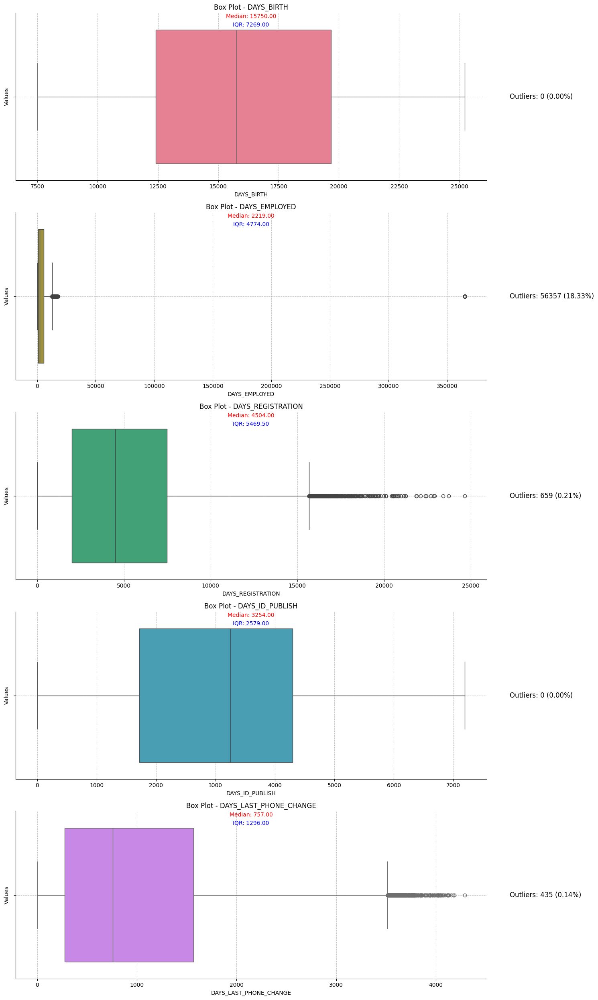


--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------



In [ ]:

plot_box_and_outliers(days_filtered_columns)


In [ ]:
# Calculate the number of missing values for each column
missing_values_count = application_data_df[days_filtered_columns].isnull().sum()

# Print the number of missing values for each column
for col, missing_count in missing_values_count.iteritems():
    print(f"Column: {col}, Missing Values: {missing_count}")

Column: DAYS_BIRTH, Missing Values: 0
Column: DAYS_EMPLOYED, Missing Values: 0
Column: DAYS_REGISTRATION, Missing Values: 0
Column: DAYS_ID_PUBLISH, Missing Values: 0
Column: DAYS_LAST_PHONE_CHANGE, Missing Values: 1


**Inference :** DAYS_LAST_PHONE_CHANGE has 1 missing value.

Filling missing values with the mode can be a reasonable approach, as it represents the most frequently occurring value in the column.

In [ ]:
# Calculate the mode value of the column
mode_value = application_data_df["DAYS_LAST_PHONE_CHANGE"].mode().iloc[0]

# Fill missing values with the mode value
application_data_df["DAYS_LAST_PHONE_CHANGE"].fillna(mode_value, inplace=True)

**1.4.8) OCCUPATION_TYPE**

In [ ]:
# Explore the column
application_data_df.OCCUPATION_TYPE

0            Laborers
1          Core staff
2            Laborers
3            Laborers
4          Core staff
             ...     
307506    Sales staff
307507            NaN
307508       Managers
307509       Laborers
307510       Laborers
Name: OCCUPATION_TYPE, Length: 307511, dtype: object

In [ ]:
nan_count = application_data_df['OCCUPATION_TYPE'].isna().sum()
print(f"Number of NaN values in OCCUPATION_TYPE column: {nan_count}")


Number of NaN values in OCCUPATION_TYPE column: 96391


**Inference :** As there are lot of "Nan" values, can replace them with a new category, "Unknown", to clearly indicate that the occupation type is unknown.

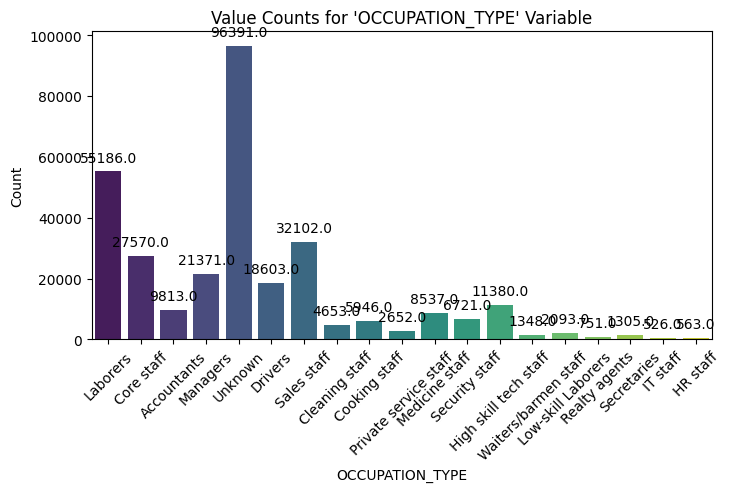


--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------



In [ ]:
application_data_df['OCCUPATION_TYPE'].fillna('Unknown', inplace=True)
plot_value_counts('OCCUPATION_TYPE')

**Inference :** The most common occupation Type is "LAborers" although there are lot of "Unknown"data.

**1.4.9) CNT_CHILDREN**

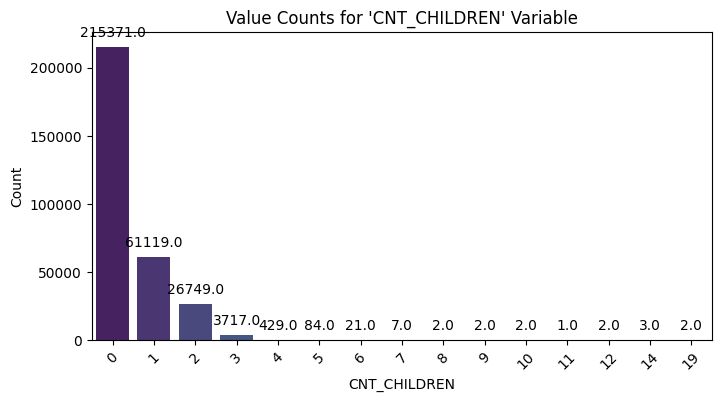


--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------



In [ ]:
plot_value_counts('CNT_CHILDREN')

**Inference :** Most clients have no children.

In [ ]:
# Find columns with NaN values
columns_with_nan = application_data_df.columns[application_data_df.isnull().any()]

# Create a DataFrame to store the results
nan_info = pd.DataFrame(columns=['Column', 'NaN Count', 'NaN Percentage'])

# Populate the DataFrame with information about NaN values
for column in columns_with_nan:
    nan_count = application_data_df[column].isnull().sum()
    nan_percentage = (nan_count / len(application_data_df)) * 100
    nan_info = nan_info.append({'Column': column, 'NaN Count': nan_count, 'NaN Percentage': nan_percentage}, ignore_index=True)

# Display the results using tabulate
print("Columns with NaN values:")
print(tabulate(nan_info, headers='keys', tablefmt='pretty', showindex=False))


Columns with NaN values:
+----------------------------+-----------+-----------------------+
|           Column           | NaN Count |    NaN Percentage     |
+----------------------------+-----------+-----------------------+
|        AMT_ANNUITY         |    12     | 0.003902299429939092  |
|      AMT_GOODS_PRICE       |    278    |  0.09040327012692229  |
|      NAME_TYPE_SUITE       |   1292    |  0.42014757195677555  |
|      CNT_FAM_MEMBERS       |     2     | 0.0006503832383231819 |
|        EXT_SOURCE_2        |    660    |  0.21462646864665005  |
|        EXT_SOURCE_3        |   60965   |  19.825307062186393   |
|  OBS_30_CNT_SOCIAL_CIRCLE  |   1021    |  0.3320206431639844   |
|  DEF_30_CNT_SOCIAL_CIRCLE  |   1021    |  0.3320206431639844   |
|  OBS_60_CNT_SOCIAL_CIRCLE  |   1021    |  0.3320206431639844   |
|  DEF_60_CNT_SOCIAL_CIRCLE  |   1021    |  0.3320206431639844   |
| AMT_REQ_CREDIT_BUREAU_HOUR |   41519   |  13.501630835970097   |
| AMT_REQ_CREDIT_BUREAU_DAY  |   4151

**1.4.10) All columns starting with 'AMT_':**

In [ ]:
# Find all column names that start with "AMT_"
amt_filtered_columns = [col for col in application_data_df if col.startswith('AMT_')]
application_data_df[amt_filtered_columns]

,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
0,202500.0,406597.5,24700.5,351000.0,0.0,0.0,0.0,0.0,0.0,1.0
1,270000.0,1293502.5,35698.5,1129500.0,0.0,0.0,0.0,0.0,0.0,0.0
2,67500.0,135000.0,6750.0,135000.0,0.0,0.0,0.0,0.0,0.0,0.0
3,135000.0,312682.5,29686.5,297000.0,NaN,NaN,NaN,NaN,NaN,NaN
4,121500.0,513000.0,21865.5,513000.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...
307506,157500.0,254700.0,27558.0,225000.0,NaN,NaN,NaN,NaN,NaN,NaN
307507,72000.0,269550.0,12001.5,225000.0,NaN,NaN,NaN,NaN,NaN,NaN
307508,153000.0,677664.0,29979.0,585000.0,1.0,0.0,0.0,1.0,0.0,1.0
307509,171000.0,370107.0,20205.0,319500.0,0.0,0.0,0.0,0.0,0.0,0.0


In [ ]:
application_data_df[amt_filtered_columns].describe()

,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
count,3.075110e+05,3.075110e+05,307499.000000,3.072330e+05,265992.000000,265992.000000,265992.000000,265992.000000,265992.000000,265992.000000
mean,1.687979e+05,5.990260e+05,27108.573909,5.383962e+05,0.006402,0.007000,0.034362,0.267395,0.265474,1.899974
std,2.371231e+05,4.024908e+05,14493.737315,3.694465e+05,0.083849,0.110757,0.204685,0.916002,0.794056,1.869295
min,2.565000e+04,4.500000e+04,1615.500000,4.050000e+04,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,1.125000e+05,2.700000e+05,16524.000000,2.385000e+05,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,1.471500e+05,5.135310e+05,24903.000000,4.500000e+05,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000
75%,2.025000e+05,8.086500e+05,34596.000000,6.795000e+05,0.000000,0.000000,0.000000,0.000000,0.000000,3.000000
max,1.170000e+08,4.050000e+06,258025.500000,4.050000e+06,4.000000,9.000000,8.000000,27.000000,261.000000,25.000000


**Inference :** AMT_REQ_CREDIT_BUREAU_HOUR,	AMT_REQ_CREDIT_BUREAU_DAY,	AMT_REQ_CREDIT_BUREAU_WEEK,	AMT_REQ_CREDIT_BUREAU_MON,	AMT_REQ_CREDIT_BUREAU_QRT,	AMT_REQ_CREDIT_BUREAU_YEAR seems to be non continuos numerical columns.

In [ ]:

amt_non_continuos_numerical = ['AMT_REQ_CREDIT_BUREAU_HOUR', 'AMT_REQ_CREDIT_BUREAU_DAY', 'AMT_REQ_CREDIT_BUREAU_WEEK', 'AMT_REQ_CREDIT_BUREAU_MON', 'AMT_REQ_CREDIT_BUREAU_QRT', 'AMT_REQ_CREDIT_BUREAU_YEAR']
amt_continuos_numerical = ['AMT_INCOME_TOTAL','AMT_CREDIT',	'AMT_ANNUITY',	'AMT_GOODS_PRICE']


Unique values, counts, and data type for AMT_REQ_CREDIT_BUREAU_HOUR:

+-------+----------------------------+--------+-----------+
| Index | AMT_REQ_CREDIT_BUREAU_HOUR | Count  | Data Type |
+-------+----------------------------+--------+-----------+
|   0   |            0.0             | 264366 |  float64  |
|   1   |            nan             | 41519  |  float64  |
|   2   |            1.0             |  1560  |  float64  |
|   3   |            2.0             |   56   |  float64  |
|   4   |            3.0             |   9    |  float64  |
|   5   |            4.0             |   1    |  float64  |
+-------+----------------------------+--------+-----------+




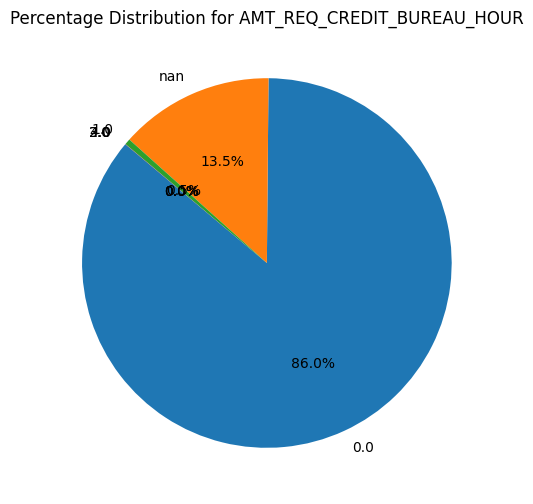


--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------

Unique values, counts, and data type for AMT_REQ_CREDIT_BUREAU_DAY:

+-------+---------------------------+--------+-----------+
| Index | AMT_REQ_CREDIT_BUREAU_DAY | Count  | Data Type |
+-------+---------------------------+--------+-----------+
|   0   |            0.0            | 264503 |  float64  |
|   1   |            nan            | 41519  |  float64  |
|   2   |            1.0            |  1292  |  float64  |
|   3   |            2.0            |  106   |  float64  |
|   4   |            3.0            |   45   |  float64  |
|   5   |            4.0            |   26   |  float64  |
|   6   |            5.0            |   9    |  float64  |
|   7   |            6.0            |   8    |  float64  |
|   8   |            9.0            |   2    |  float64  |
|   9   |           

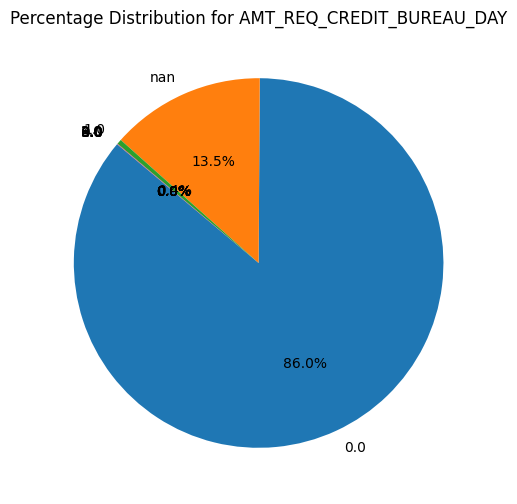


--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------

Unique values, counts, and data type for AMT_REQ_CREDIT_BUREAU_WEEK:

+-------+----------------------------+--------+-----------+
| Index | AMT_REQ_CREDIT_BUREAU_WEEK | Count  | Data Type |
+-------+----------------------------+--------+-----------+
|   0   |            0.0             | 257456 |  float64  |
|   1   |            nan             | 41519  |  float64  |
|   2   |            1.0             |  8208  |  float64  |
|   3   |            2.0             |  199   |  float64  |
|   4   |            3.0             |   58   |  float64  |
|   5   |            4.0             |   34   |  float64  |
|   6   |            6.0             |   20   |  float64  |
|   7   |            5.0             |   10   |  float64  |
|   8   |            8.0             |   5    |  float64  |
|   9  

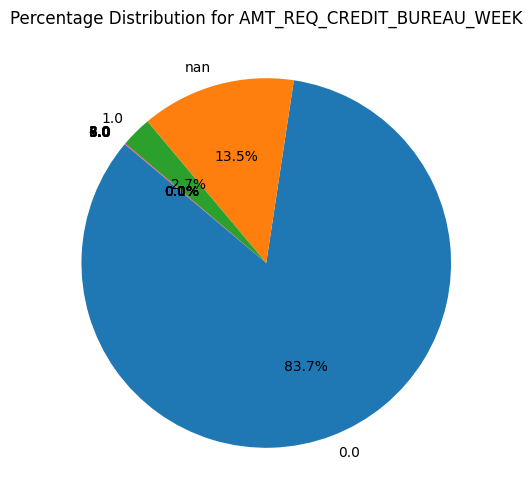


--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------

Unique values, counts, and data type for AMT_REQ_CREDIT_BUREAU_MON:

+-------+---------------------------+--------+-----------+
| Index | AMT_REQ_CREDIT_BUREAU_MON | Count  | Data Type |
+-------+---------------------------+--------+-----------+
|   0   |            0.0            | 222233 |  float64  |
|   1   |            nan            | 41519  |  float64  |
|   2   |            1.0            | 33147  |  float64  |
|   3   |            2.0            |  5386  |  float64  |
|   4   |            3.0            |  1991  |  float64  |
|   5   |            4.0            |  1076  |  float64  |
|   6   |            5.0            |  602   |  float64  |
|   7   |            6.0            |  343   |  float64  |
|   8   |            7.0            |  298   |  float64  |
|   9   |           

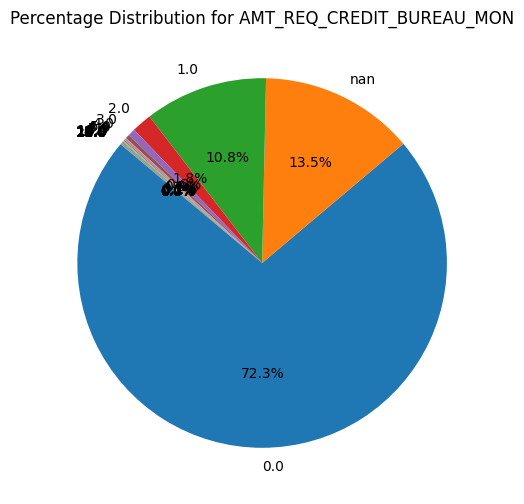


--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------

Unique values, counts, and data type for AMT_REQ_CREDIT_BUREAU_QRT:

+-------+---------------------------+--------+-----------+
| Index | AMT_REQ_CREDIT_BUREAU_QRT | Count  | Data Type |
+-------+---------------------------+--------+-----------+
|   0   |            0.0            | 215417 |  float64  |
|   1   |            nan            | 41519  |  float64  |
|   2   |            1.0            | 33862  |  float64  |
|   3   |            2.0            | 14412  |  float64  |
|   4   |            3.0            |  1717  |  float64  |
|   5   |            4.0            |  476   |  float64  |
|   6   |            5.0            |   64   |  float64  |
|   7   |            6.0            |   28   |  float64  |
|   8   |            8.0            |   7    |  float64  |
|   9   |           

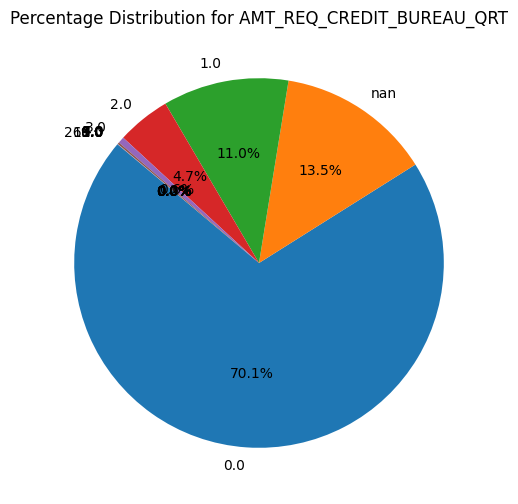


--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------

Unique values, counts, and data type for AMT_REQ_CREDIT_BUREAU_YEAR:

+-------+----------------------------+-------+-----------+
| Index | AMT_REQ_CREDIT_BUREAU_YEAR | Count | Data Type |
+-------+----------------------------+-------+-----------+
|   0   |            0.0             | 71801 |  float64  |
|   1   |            1.0             | 63405 |  float64  |
|   2   |            2.0             | 50192 |  float64  |
|   3   |            nan             | 41519 |  float64  |
|   4   |            3.0             | 33628 |  float64  |
|   5   |            4.0             | 20714 |  float64  |
|   6   |            5.0             | 12052 |  float64  |
|   7   |            6.0             | 6967  |  float64  |
|   8   |            7.0             | 3869  |  float64  |
|   9   |          

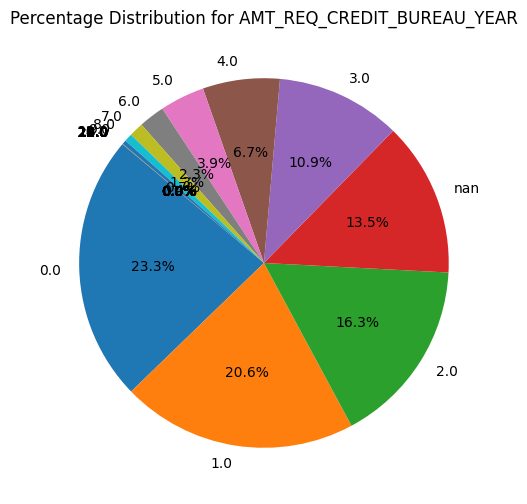


--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------



In [ ]:
display_column_info(amt_non_continuos_numerical)

**Inference :** 'AMT_REQ_CREDIT_BUREAU_QRT' column seems to have an outlier of value 261.0

In [ ]:
# Drop the outliner column
application_data_df = application_data_df[application_data_df['AMT_REQ_CREDIT_BUREAU_QRT'] != 261.0]

In [ ]:
# Replacing "Nan" values with mode value for non_continuos_numerical
for col in amt_non_continuos_numerical:
    # Calculate the mode of the column
    mode_value = application_data_df[col].mode()[0]

    # Replace NaN values with the mode
    application_data_df[col].fillna(mode_value, inplace=True)

In [ ]:
# Replacing "Nan" values with median value
for col in amt_continuos_numerical:
    # Calculate the mode of the column
    median_value = application_data_df[col].median()

    # Replace NaN values with the mode
    application_data_df[col].fillna(median_value, inplace=True)

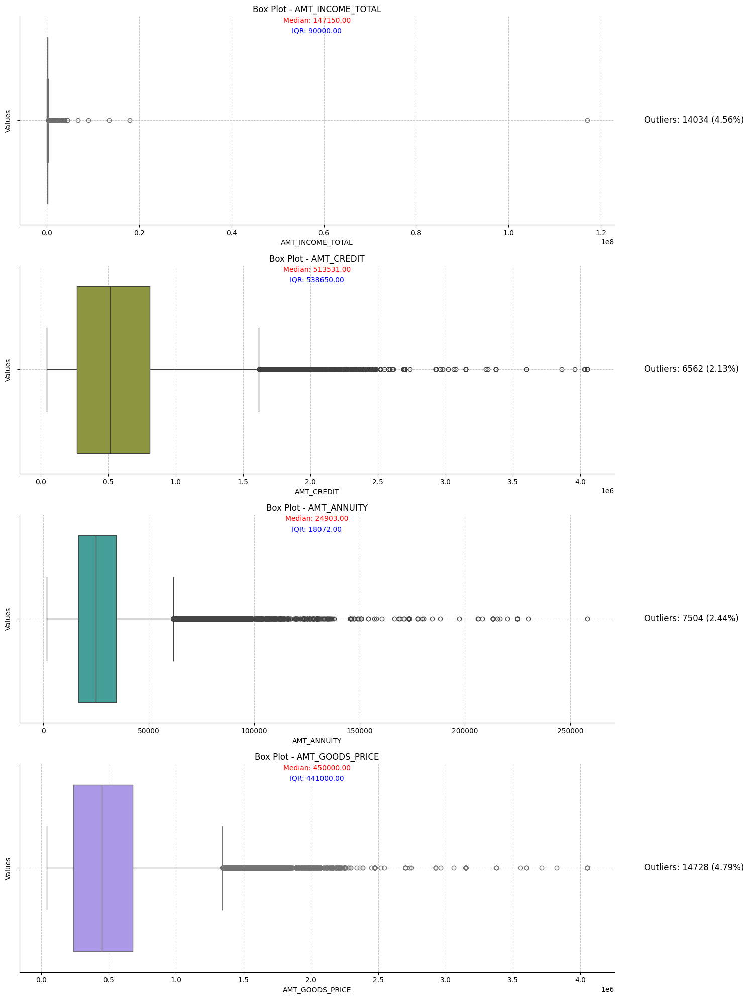


--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------



In [ ]:
plot_box_and_outliers(amt_continuos_numerical)

In [ ]:
application_data_df[amt_continuos_numerical].describe()

,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE
count,3.075100e+05,3.075100e+05,307510.000000,3.075100e+05
mean,1.687973e+05,5.990246e+05,27108.477160,5.383147e+05
std,2.371233e+05,4.024907e+05,14493.483421,3.692885e+05
min,2.565000e+04,4.500000e+04,1615.500000,4.050000e+04
25%,1.125000e+05,2.700000e+05,16524.000000,2.385000e+05
50%,1.471500e+05,5.135310e+05,24903.000000,4.500000e+05
75%,2.025000e+05,8.086500e+05,34596.000000,6.795000e+05
max,1.170000e+08,4.050000e+06,258025.500000,4.050000e+06


**1.4.11) All columns having 'SOCIAL_CIRCLE':**

In [ ]:
# Find column names with "SOCIAL_CIRCLE"
social_circle_columns = [col for col in application_data_df.columns if 'SOCIAL_CIRCLE' in col]

# Print the column names
print(social_circle_columns)


['OBS_30_CNT_SOCIAL_CIRCLE', 'DEF_30_CNT_SOCIAL_CIRCLE', 'OBS_60_CNT_SOCIAL_CIRCLE', 'DEF_60_CNT_SOCIAL_CIRCLE']


In [ ]:
application_data_df[social_circle_columns].describe()

,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE
count,306489.000000,306489.000000,306489.000000,306489.000000
mean,1.422240,0.143421,1.405287,0.100049
std,2.400991,0.446699,2.379805,0.362291
min,0.000000,0.000000,0.000000,0.000000
25%,0.000000,0.000000,0.000000,0.000000
50%,0.000000,0.000000,0.000000,0.000000
75%,2.000000,0.000000,2.000000,0.000000
max,348.000000,34.000000,344.000000,24.000000


**Inference :** social_circle_columns are columns of non continuos numerical category.

Unique values, counts, and data type for OBS_30_CNT_SOCIAL_CIRCLE:

+-------+--------------------------+--------+-----------+
| Index | OBS_30_CNT_SOCIAL_CIRCLE | Count  | Data Type |
+-------+--------------------------+--------+-----------+
|   0   |           0.0            | 163910 |  float64  |
|   1   |           1.0            | 48783  |  float64  |
|   2   |           2.0            | 29808  |  float64  |
|   3   |           3.0            | 20321  |  float64  |
|   4   |           4.0            | 14143  |  float64  |
|   5   |           5.0            |  9553  |  float64  |
|   6   |           6.0            |  6453  |  float64  |
|   7   |           7.0            |  4390  |  float64  |
|   8   |           8.0            |  2967  |  float64  |
|   9   |           9.0            |  2003  |  float64  |
|  10   |           10.0           |  1376  |  float64  |
|  11   |           nan            |  1021  |  float64  |
|  12   |           11.0           |  852   |  float64  |
|  1

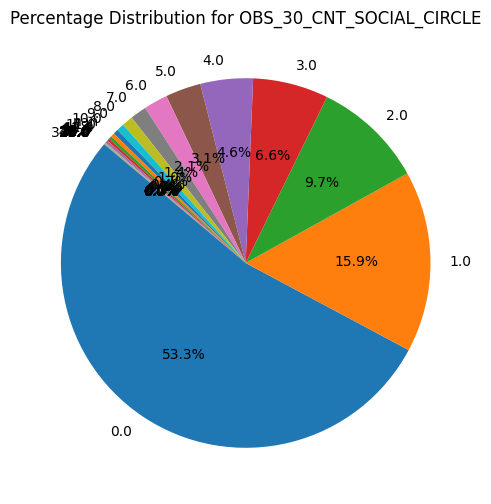


--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------

Unique values, counts, and data type for DEF_30_CNT_SOCIAL_CIRCLE:

+-------+--------------------------+--------+-----------+
| Index | DEF_30_CNT_SOCIAL_CIRCLE | Count  | Data Type |
+-------+--------------------------+--------+-----------+
|   0   |           0.0            | 271323 |  float64  |
|   1   |           1.0            | 28328  |  float64  |
|   2   |           2.0            |  5323  |  float64  |
|   3   |           3.0            |  1192  |  float64  |
|   4   |           nan            |  1021  |  float64  |
|   5   |           4.0            |  253   |  float64  |
|   6   |           5.0            |   56   |  float64  |
|   7   |           6.0            |   11   |  float64  |
|   8   |           7.0            |   1    |  float64  |
|   9   |           34.0         

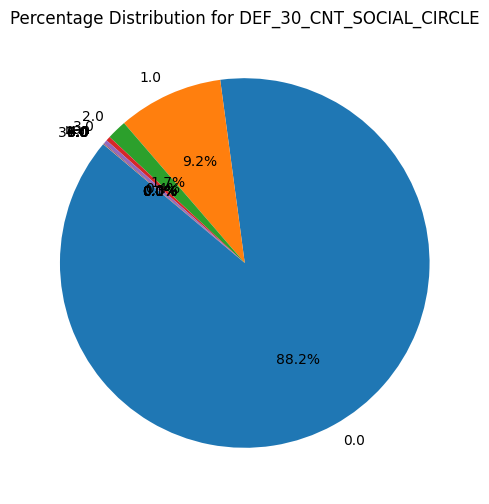


--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------

Unique values, counts, and data type for OBS_60_CNT_SOCIAL_CIRCLE:

+-------+--------------------------+--------+-----------+
| Index | OBS_60_CNT_SOCIAL_CIRCLE | Count  | Data Type |
+-------+--------------------------+--------+-----------+
|   0   |           0.0            | 164666 |  float64  |
|   1   |           1.0            | 48870  |  float64  |
|   2   |           2.0            | 29766  |  float64  |
|   3   |           3.0            | 20214  |  float64  |
|   4   |           4.0            | 13946  |  float64  |
|   5   |           5.0            |  9463  |  float64  |
|   6   |           6.0            |  6349  |  float64  |
|   7   |           7.0            |  4344  |  float64  |
|   8   |           8.0            |  2886  |  float64  |
|   9   |           9.0          

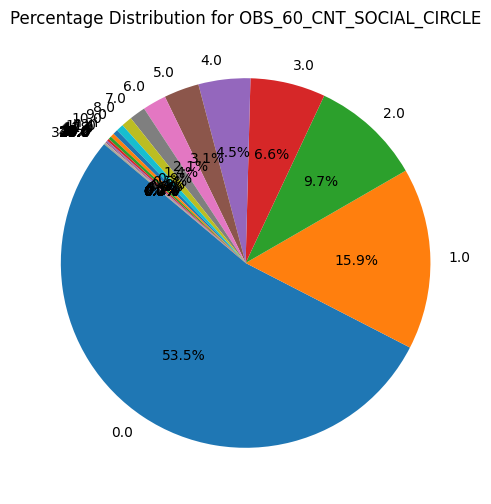


--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------

Unique values, counts, and data type for DEF_60_CNT_SOCIAL_CIRCLE:

+-------+--------------------------+--------+-----------+
| Index | DEF_60_CNT_SOCIAL_CIRCLE | Count  | Data Type |
+-------+--------------------------+--------+-----------+
|   0   |           0.0            | 280720 |  float64  |
|   1   |           1.0            | 21841  |  float64  |
|   2   |           2.0            |  3170  |  float64  |
|   3   |           nan            |  1021  |  float64  |
|   4   |           3.0            |  598   |  float64  |
|   5   |           4.0            |  135   |  float64  |
|   6   |           5.0            |   20   |  float64  |
|   7   |           6.0            |   3    |  float64  |
|   8   |           7.0            |   1    |  float64  |
|   9   |           24.0         

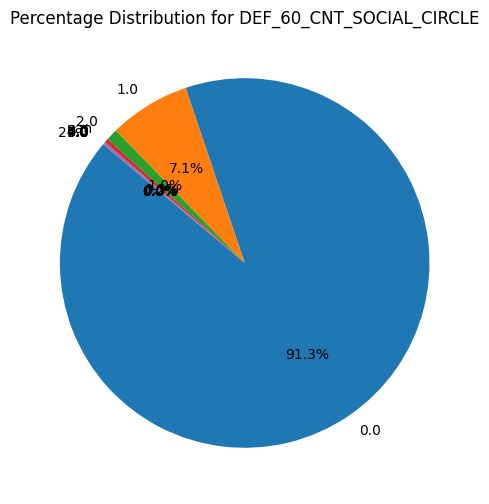


--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------



In [ ]:
display_column_info(social_circle_columns)

**Inference :**


*   'OBS_30_CNT_SOCIAL_CIRCLE' column seems to have an outlier of value 348.0
*   'DEF_30_CNT_SOCIAL_CIRCLE'column seems to have an outlier of value 34.0
*   'OBS_60_CNT_SOCIAL_CIRCLE' column seems to have an outlier of value 344.0
*   'DEF_60_CNT_SOCIAL_CIRCLE' column seems to have an outlier of value 24.0



In [ ]:
# Drop the outliners
application_data_df = application_data_df[application_data_df['OBS_30_CNT_SOCIAL_CIRCLE'] != 348.0]
application_data_df = application_data_df[application_data_df['DEF_30_CNT_SOCIAL_CIRCLE'] != 34.0]
application_data_df = application_data_df[application_data_df['OBS_60_CNT_SOCIAL_CIRCLE'] != 344.0]
application_data_df = application_data_df[application_data_df['DEF_60_CNT_SOCIAL_CIRCLE'] != 24.0]

In [ ]:
# Replacing "Nan" values with mode value for non_continuos_numerical
for col in social_circle_columns:
    # Calculate the mode of the column
    mode_value = application_data_df[col].mode()[0]

    # Replace NaN values with the mode
    application_data_df[col].fillna(mode_value, inplace=True)

**1.4.12) WEEKDAY_APPR_PROCESS_START**

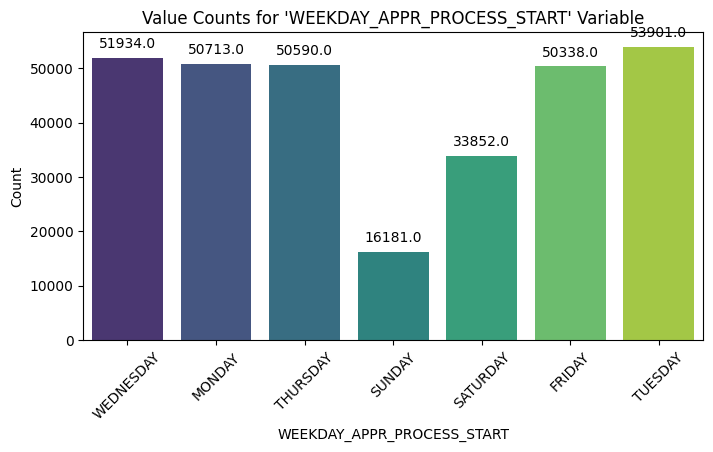


--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------



In [ ]:
# Check cardinality
unique_elements_count = application_data_df['WEEKDAY_APPR_PROCESS_START'].value_counts()
plot_value_counts('WEEKDAY_APPR_PROCESS_START')

**Inference** : Less number of applicants are in weekends understandably as its holiday usually.


**1.4.13) CNT_FAM_MEMBERS**

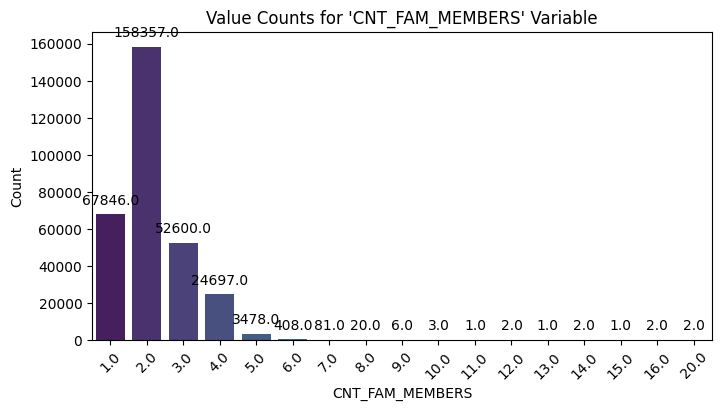


--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------



In [ ]:
# Check cardinality
unique_elements_count = application_data_df['CNT_FAM_MEMBERS'].value_counts()
plot_value_counts('CNT_FAM_MEMBERS')

**Inference** : More applicants belons to 2 member category.

In [ ]:
# Count NaN values
nan_count = application_data_df['CNT_FAM_MEMBERS'].isna().sum()

# Print the count
print("Number of NaN values in 'CNT_FAM_MEMBERS':", nan_count)

Number of NaN values in 'CNT_FAM_MEMBERS': 2


In [ ]:
# Replacing "Nan" values with mode value for non_continuos_numerical
# Calculate the mode of the column
mode_value = application_data_df['CNT_FAM_MEMBERS'].mode()[0]

# Replace NaN values with the mode
application_data_df['CNT_FAM_MEMBERS'].fillna(mode_value, inplace=True)

**1.4.14) EXT_SOURCE_3 & EXT_SOURCE_2**

In [ ]:
# Count NaN values
nan_count = application_data_df['EXT_SOURCE_3'].isna().sum()

# Print the count
print("Number of NaN values in 'EXT_SOURCE_3':", nan_count)


Number of NaN values in 'EXT_SOURCE_3': 60964


In [ ]:
# Replacing "Nan" values with median value

# Calculate the mode of the column
median_value = application_data_df['EXT_SOURCE_3'].median()

# Replace NaN values with the mode
application_data_df['EXT_SOURCE_3'].fillna(median_value, inplace=True)

In [ ]:

# Count NaN values
nan_count = application_data_df['EXT_SOURCE_2'].isna().sum()

# Print the count
print("Number of NaN values in 'EXT_SOURCE_2':", nan_count)


Number of NaN values in 'EXT_SOURCE_2': 660


In [ ]:
# Replacing "Nan" values with median value

# Calculate the mode of the column
median_value = application_data_df['EXT_SOURCE_2'].median()

# Replace NaN values with the mode
application_data_df['EXT_SOURCE_2'].fillna(median_value, inplace=True)

In [ ]:
# Find all column names that start with "EXT_"
ext_filtered_columns = [col for col in application_data_df if col.startswith('EXT_')]
print(ext_filtered_columns)

['EXT_SOURCE_2', 'EXT_SOURCE_3']


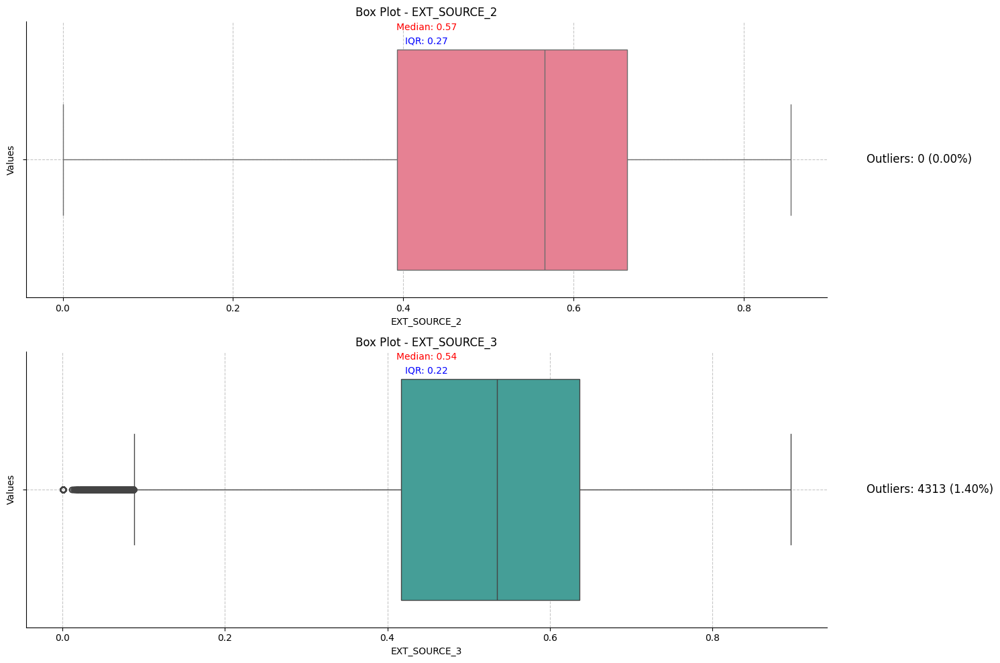


--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------



In [ ]:
plot_box_and_outliers(ext_filtered_columns)

In [ ]:
# Replacing "Nan" values with median value
for col in ext_filtered_columns:
    # Calculate the mode of the column
    median_value = application_data_df[col].median()

    # Replace NaN values with the mode
    application_data_df[col].fillna(median_value, inplace=True)

In [ ]:
# Drop columns from the DataFrame
application_data_df.drop(columns=cols_to_be_dropped, inplace=True)

In [ ]:
# Convert all columns of type 'object' to 'category'
object_columns = application_data_df.select_dtypes(include=['object']).columns
application_data_df[object_columns] = application_data_df[object_columns].astype('category')

In [ ]:
# Select columns of data type 'category' and store their names in a list
category_columns = list(application_data_df.select_dtypes(include='category').columns)
print(category_columns)

# Identify numerical columns
numerical_columns = list(application_data_df.select_dtypes(include=['number']).columns)
print(numerical_columns )

['NAME_CONTRACT_TYPE', 'CODE_GENDER', 'NAME_TYPE_SUITE', 'NAME_INCOME_TYPE', 'NAME_EDUCATION_TYPE', 'NAME_FAMILY_STATUS', 'NAME_HOUSING_TYPE', 'OCCUPATION_TYPE', 'WEEKDAY_APPR_PROCESS_START', 'ORGANIZATION_TYPE']
['SK_ID_CURR', 'TARGET', 'CNT_CHILDREN', 'AMT_INCOME_TOTAL', 'AMT_CREDIT', 'AMT_ANNUITY', 'AMT_GOODS_PRICE', 'REGION_POPULATION_RELATIVE', 'DAYS_BIRTH', 'DAYS_EMPLOYED', 'DAYS_REGISTRATION', 'DAYS_ID_PUBLISH', 'CNT_FAM_MEMBERS', 'REGION_RATING_CLIENT', 'REGION_RATING_CLIENT_W_CITY', 'HOUR_APPR_PROCESS_START', 'REG_REGION_NOT_LIVE_REGION', 'REG_REGION_NOT_WORK_REGION', 'LIVE_REGION_NOT_WORK_REGION', 'REG_CITY_NOT_LIVE_CITY', 'REG_CITY_NOT_WORK_CITY', 'LIVE_CITY_NOT_WORK_CITY', 'EXT_SOURCE_2', 'EXT_SOURCE_3', 'OBS_30_CNT_SOCIAL_CIRCLE', 'DEF_30_CNT_SOCIAL_CIRCLE', 'OBS_60_CNT_SOCIAL_CIRCLE', 'DEF_60_CNT_SOCIAL_CIRCLE', 'DAYS_LAST_PHONE_CHANGE', 'FLAG_DOCUMENT_3', 'AMT_REQ_CREDIT_BUREAU_HOUR', 'AMT_REQ_CREDIT_BUREAU_DAY', 'AMT_REQ_CREDIT_BUREAU_WEEK', 'AMT_REQ_CREDIT_BUREAU_MON',

In [ ]:
application_data_df[numerical_columns].describe()

,SK_ID_CURR,TARGET,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,...,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_3,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
count,307509.000000,307509.000000,307509.000000,3.075090e+05,3.075090e+05,307509.000000,3.075090e+05,307509.000000,307509.000000,307509.000000,...,307509.000000,307509.000000,307509.000000,307509.000000,307509.000000,307509.000000,307509.000000,307509.000000,307509.000000,307509.000000
mean,278180.216042,0.080729,0.417051,1.687972e+05,5.990259e+05,27108.536048,5.383158e+05,0.020868,16037.022295,67725.165540,...,1.399507,0.099639,962.857490,0.710025,0.005538,0.006055,0.029719,0.231288,0.228784,1.643448
std,102790.353546,0.272419,0.722123,2.371237e+05,4.024906e+05,14493.470199,3.692885e+05,0.013831,4363.987508,139444.106428,...,2.295545,0.359159,826.811341,0.453751,0.078014,0.103037,0.190721,0.856811,0.576620,1.855823
min,100002.000000,0.000000,0.000000,2.565000e+04,4.500000e+04,1615.500000,4.050000e+04,0.000290,7489.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,189145.000000,0.000000,0.000000,1.125000e+05,2.700000e+05,16524.000000,2.385000e+05,0.010006,12413.000000,933.000000,...,0.000000,0.000000,274.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,278202.000000,0.000000,0.000000,1.471500e+05,5.135310e+05,24903.000000,4.500000e+05,0.018850,15750.000000,2219.000000,...,0.000000,0.000000,757.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000
75%,367142.000000,0.000000,1.000000,2.025000e+05,8.086500e+05,34596.000000,6.795000e+05,0.028663,19682.000000,5707.000000,...,2.000000,0.000000,1570.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,3.000000
max,456255.000000,1.000000,19.000000,1.170000e+08,4.050000e+06,258025.500000,4.050000e+06,0.072508,25229.000000,365243.000000,...,47.000000,7.000000,4292.000000,1.000000,4.000000,9.000000,8.000000,27.000000,19.000000,25.000000


In [ ]:
# Initialize lists for numerical continuous, non-continuous, and categorical columns
numerical_continuous_columns = []
numerical_non_continuous_columns = []
categorical_columns = []



# Get a list of all column names in the DataFrame
all_columns = application_data_df.columns

# Iterate through each column in numerical_columns
for col in all_columns:
    if col in numerical_columns:
        # Check if it is numerical
        unique_values = application_data_df[col].unique()

        # Check the number of distinct values
        if len(unique_values) < 50:
            numerical_non_continuous_columns.append(col)
        else:
            numerical_continuous_columns.append(col)
    else:
        # If not in numerical_columns, consider it as categorical
        categorical_columns.append(col)

# Print or use the identified columns as needed
print("Numerical Continuous Columns:", numerical_continuous_columns)
print("Numerical Non-Continuous Columns:", numerical_non_continuous_columns)
print("Categorical Columns:", categorical_columns)


Numerical Continuous Columns: ['SK_ID_CURR', 'AMT_INCOME_TOTAL', 'AMT_CREDIT', 'AMT_ANNUITY', 'AMT_GOODS_PRICE', 'REGION_POPULATION_RELATIVE', 'DAYS_BIRTH', 'DAYS_EMPLOYED', 'DAYS_REGISTRATION', 'DAYS_ID_PUBLISH', 'EXT_SOURCE_2', 'EXT_SOURCE_3', 'DAYS_LAST_PHONE_CHANGE']
Numerical Non-Continuous Columns: ['TARGET', 'CNT_CHILDREN', 'CNT_FAM_MEMBERS', 'REGION_RATING_CLIENT', 'REGION_RATING_CLIENT_W_CITY', 'HOUR_APPR_PROCESS_START', 'REG_REGION_NOT_LIVE_REGION', 'REG_REGION_NOT_WORK_REGION', 'LIVE_REGION_NOT_WORK_REGION', 'REG_CITY_NOT_LIVE_CITY', 'REG_CITY_NOT_WORK_CITY', 'LIVE_CITY_NOT_WORK_CITY', 'OBS_30_CNT_SOCIAL_CIRCLE', 'DEF_30_CNT_SOCIAL_CIRCLE', 'OBS_60_CNT_SOCIAL_CIRCLE', 'DEF_60_CNT_SOCIAL_CIRCLE', 'FLAG_DOCUMENT_3', 'AMT_REQ_CREDIT_BUREAU_HOUR', 'AMT_REQ_CREDIT_BUREAU_DAY', 'AMT_REQ_CREDIT_BUREAU_WEEK', 'AMT_REQ_CREDIT_BUREAU_MON', 'AMT_REQ_CREDIT_BUREAU_QRT', 'AMT_REQ_CREDIT_BUREAU_YEAR']
Categorical Columns: ['NAME_CONTRACT_TYPE', 'CODE_GENDER', 'NAME_TYPE_SUITE', 'NAME_INCO

**Inference :** SK_ID_CURR' is ID of loan in our sample and can be dropped from further analysis

In [ ]:
element_to_drop = 'SK_ID_CURR'
numerical_continuous_columns.remove(element_to_drop)

In [ ]:
numerical_continuous_columns

['AMT_INCOME_TOTAL',
 'AMT_CREDIT',
 'AMT_ANNUITY',
 'AMT_GOODS_PRICE',
 'REGION_POPULATION_RELATIVE',
 'DAYS_BIRTH',
 'DAYS_EMPLOYED',
 'DAYS_REGISTRATION',
 'DAYS_ID_PUBLISH',
 'EXT_SOURCE_2',
 'EXT_SOURCE_3',
 'DAYS_LAST_PHONE_CHANGE']

In [ ]:
# replace all outliers of continuos numerical columns with median
replace_outliers_with_median( numerical_continuous_columns)

**Note** : EVen though all outliers are replaced with median values, we may still see outliers in box plots. The appearance of outliers in a box plot is influenced by the length of the whiskers. The whiskers are calculated based on the interquartile range, and points beyond the whiskers are considered potential outliers. If the whisker length is relatively long, points that are not actual outliers may still appear as such.

Unique values, counts, and data type for TARGET:

+-------+--------+--------+-----------+
| Index | TARGET | Count  | Data Type |
+-------+--------+--------+-----------+
|   0   |   0    | 282684 |   int64   |
|   1   |   1    | 24825  |   int64   |
+-------+--------+--------+-----------+




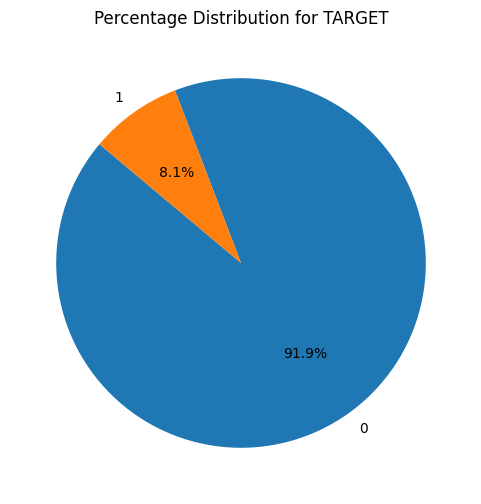


--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------

Unique values, counts, and data type for CNT_CHILDREN:

+-------+--------------+--------+-----------+
| Index | CNT_CHILDREN | Count  | Data Type |
+-------+--------------+--------+-----------+
|   0   |      0       | 215370 |   int64   |
|   1   |      1       | 61118  |   int64   |
|   2   |      2       | 26749  |   int64   |
|   3   |      3       |  3717  |   int64   |
|   4   |      4       |  429   |   int64   |
|   5   |      5       |   84   |   int64   |
|   6   |      6       |   21   |   int64   |
|   7   |      7       |   7    |   int64   |
|   8   |      14      |   3    |   int64   |
|   9   |      8       |   2    |   int64   |
|  10   |      9       |   2    |   int64   |
|  11   |      12      |   2    |   int64   |
|  12   |      10      |   2    |   int64   |
|  13

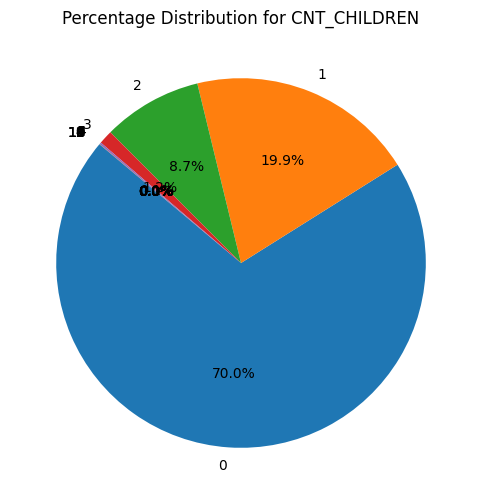


--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------

Unique values, counts, and data type for CNT_FAM_MEMBERS:

+-------+-----------------+--------+-----------+
| Index | CNT_FAM_MEMBERS | Count  | Data Type |
+-------+-----------------+--------+-----------+
|   0   |       2.0       | 158359 |  float64  |
|   1   |       1.0       | 67846  |  float64  |
|   2   |       3.0       | 52600  |  float64  |
|   3   |       4.0       | 24697  |  float64  |
|   4   |       5.0       |  3478  |  float64  |
|   5   |       6.0       |  408   |  float64  |
|   6   |       7.0       |   81   |  float64  |
|   7   |       8.0       |   20   |  float64  |
|   8   |       9.0       |   6    |  float64  |
|   9   |      10.0       |   3    |  float64  |
|  10   |      14.0       |   2    |  float64  |
|  11   |      12.0       |   2    |  float64  |
|  

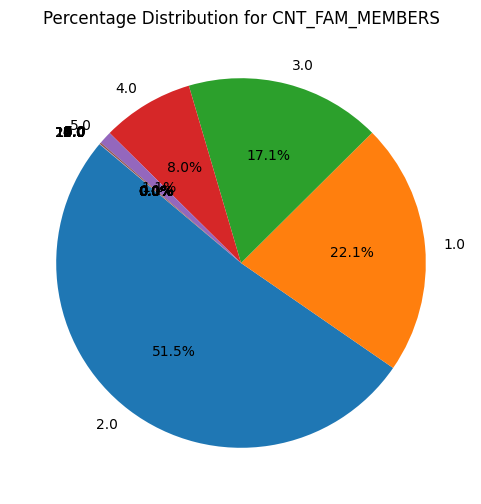


--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------

Unique values, counts, and data type for REGION_RATING_CLIENT:

+-------+----------------------+--------+-----------+
| Index | REGION_RATING_CLIENT | Count  | Data Type |
+-------+----------------------+--------+-----------+
|   0   |          2           | 226983 |   int64   |
|   1   |          3           | 48329  |   int64   |
|   2   |          1           | 32197  |   int64   |
+-------+----------------------+--------+-----------+




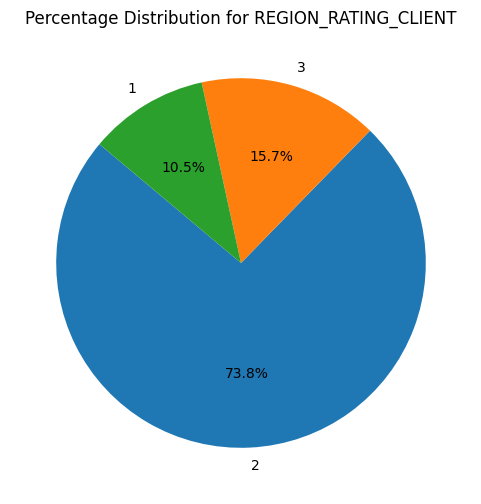


--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------

Unique values, counts, and data type for REGION_RATING_CLIENT_W_CITY:

+-------+-----------------------------+--------+-----------+
| Index | REGION_RATING_CLIENT_W_CITY | Count  | Data Type |
+-------+-----------------------------+--------+-----------+
|   0   |              2              | 229483 |   int64   |
|   1   |              3              | 43859  |   int64   |
|   2   |              1              | 34167  |   int64   |
+-------+-----------------------------+--------+-----------+




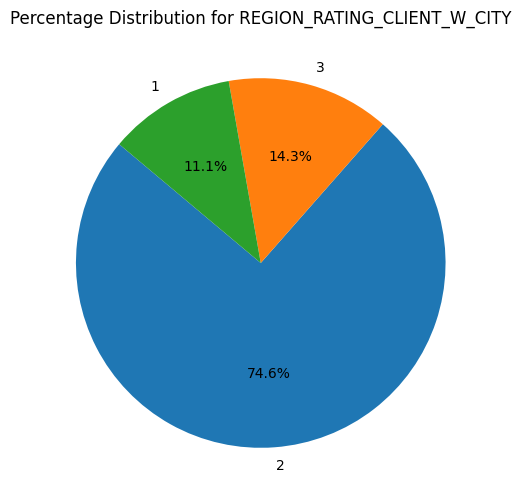


--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------

Unique values, counts, and data type for HOUR_APPR_PROCESS_START:

+-------+-------------------------+-------+-----------+
| Index | HOUR_APPR_PROCESS_START | Count | Data Type |
+-------+-------------------------+-------+-----------+
|   0   |           10            | 37722 |   int64   |
|   1   |           11            | 37229 |   int64   |
|   2   |           12            | 34233 |   int64   |
|   3   |           13            | 30959 |   int64   |
|   4   |           14            | 27682 |   int64   |
|   5   |            9            | 27383 |   int64   |
|   6   |           15            | 24839 |   int64   |
|   7   |           16            | 20385 |   int64   |
|   8   |            8            | 15127 |   int64   |
|   9   |           17            | 14900 |   int64   |
| 

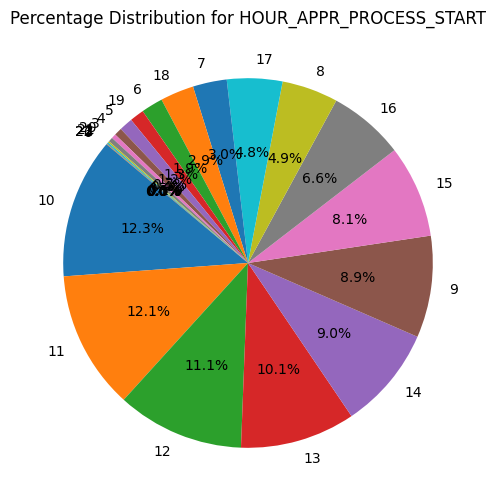


--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------

Unique values, counts, and data type for REG_REGION_NOT_LIVE_REGION:

+-------+----------------------------+--------+-----------+
| Index | REG_REGION_NOT_LIVE_REGION | Count  | Data Type |
+-------+----------------------------+--------+-----------+
|   0   |             0              | 302852 |   int64   |
|   1   |             1              |  4657  |   int64   |
+-------+----------------------------+--------+-----------+




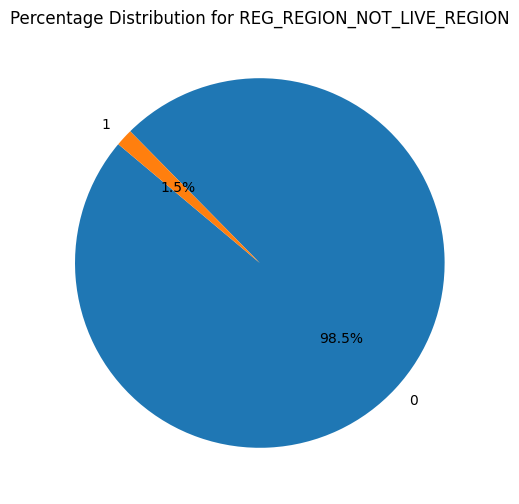


--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------

Unique values, counts, and data type for REG_REGION_NOT_WORK_REGION:

+-------+----------------------------+--------+-----------+
| Index | REG_REGION_NOT_WORK_REGION | Count  | Data Type |
+-------+----------------------------+--------+-----------+
|   0   |             0              | 291897 |   int64   |
|   1   |             1              | 15612  |   int64   |
+-------+----------------------------+--------+-----------+




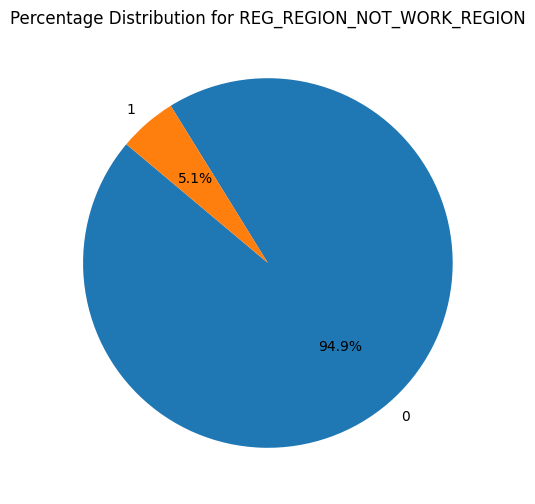


--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------

Unique values, counts, and data type for LIVE_REGION_NOT_WORK_REGION:

+-------+-----------------------------+--------+-----------+
| Index | LIVE_REGION_NOT_WORK_REGION | Count  | Data Type |
+-------+-----------------------------+--------+-----------+
|   0   |              0              | 295006 |   int64   |
|   1   |              1              | 12503  |   int64   |
+-------+-----------------------------+--------+-----------+




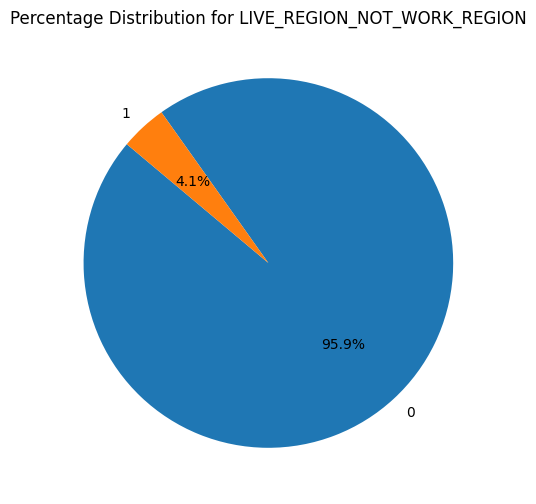


--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------

Unique values, counts, and data type for REG_CITY_NOT_LIVE_CITY:

+-------+------------------------+--------+-----------+
| Index | REG_CITY_NOT_LIVE_CITY | Count  | Data Type |
+-------+------------------------+--------+-----------+
|   0   |           0            | 283470 |   int64   |
|   1   |           1            | 24039  |   int64   |
+-------+------------------------+--------+-----------+




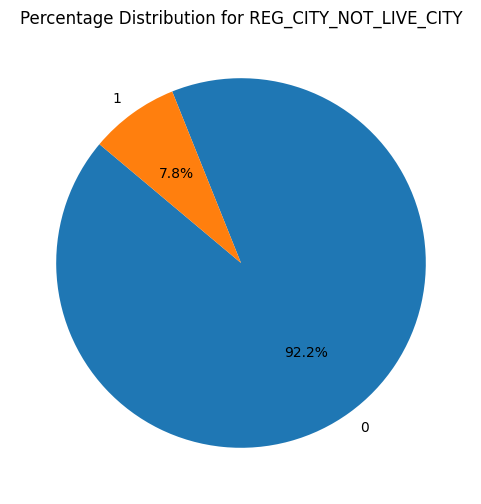


--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------

Unique values, counts, and data type for REG_CITY_NOT_WORK_CITY:

+-------+------------------------+--------+-----------+
| Index | REG_CITY_NOT_WORK_CITY | Count  | Data Type |
+-------+------------------------+--------+-----------+
|   0   |           0            | 236643 |   int64   |
|   1   |           1            | 70866  |   int64   |
+-------+------------------------+--------+-----------+




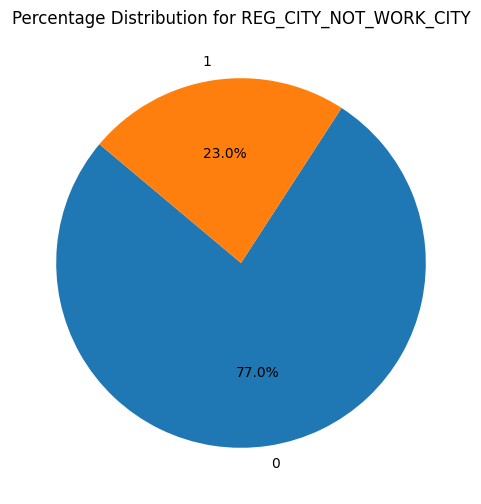


--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------

Unique values, counts, and data type for LIVE_CITY_NOT_WORK_CITY:

+-------+-------------------------+--------+-----------+
| Index | LIVE_CITY_NOT_WORK_CITY | Count  | Data Type |
+-------+-------------------------+--------+-----------+
|   0   |            0            | 252295 |   int64   |
|   1   |            1            | 55214  |   int64   |
+-------+-------------------------+--------+-----------+




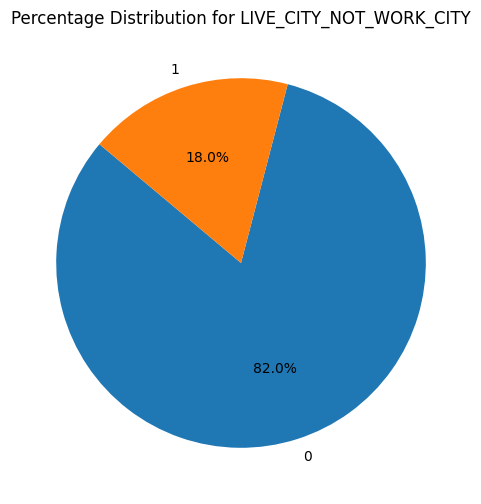


--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------

Unique values, counts, and data type for OBS_30_CNT_SOCIAL_CIRCLE:

+-------+--------------------------+--------+-----------+
| Index | OBS_30_CNT_SOCIAL_CIRCLE | Count  | Data Type |
+-------+--------------------------+--------+-----------+
|   0   |           0.0            | 164931 |  float64  |
|   1   |           1.0            | 48783  |  float64  |
|   2   |           2.0            | 29808  |  float64  |
|   3   |           3.0            | 20321  |  float64  |
|   4   |           4.0            | 14143  |  float64  |
|   5   |           5.0            |  9553  |  float64  |
|   6   |           6.0            |  6453  |  float64  |
|   7   |           7.0            |  4390  |  float64  |
|   8   |           8.0            |  2967  |  float64  |
|   9   |           9.0          

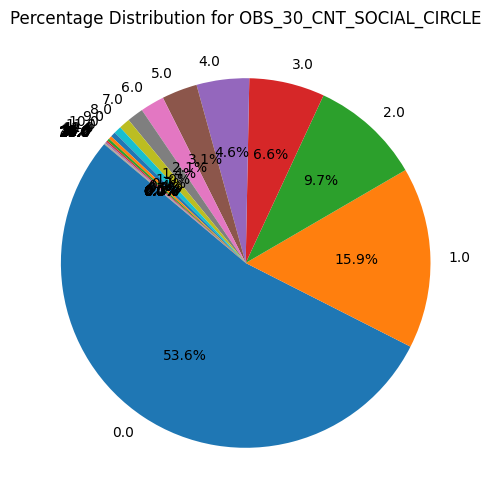


--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------

Unique values, counts, and data type for DEF_30_CNT_SOCIAL_CIRCLE:

+-------+--------------------------+--------+-----------+
| Index | DEF_30_CNT_SOCIAL_CIRCLE | Count  | Data Type |
+-------+--------------------------+--------+-----------+
|   0   |           0.0            | 272344 |  float64  |
|   1   |           1.0            | 28328  |  float64  |
|   2   |           2.0            |  5323  |  float64  |
|   3   |           3.0            |  1192  |  float64  |
|   4   |           4.0            |  253   |  float64  |
|   5   |           5.0            |   56   |  float64  |
|   6   |           6.0            |   11   |  float64  |
|   7   |           7.0            |   1    |  float64  |
|   8   |           8.0            |   1    |  float64  |
+-------+------------------------

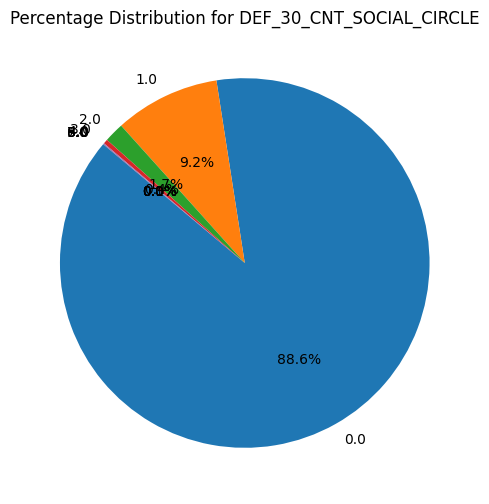


--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------

Unique values, counts, and data type for OBS_60_CNT_SOCIAL_CIRCLE:

+-------+--------------------------+--------+-----------+
| Index | OBS_60_CNT_SOCIAL_CIRCLE | Count  | Data Type |
+-------+--------------------------+--------+-----------+
|   0   |           0.0            | 165687 |  float64  |
|   1   |           1.0            | 48870  |  float64  |
|   2   |           2.0            | 29766  |  float64  |
|   3   |           3.0            | 20214  |  float64  |
|   4   |           4.0            | 13946  |  float64  |
|   5   |           5.0            |  9463  |  float64  |
|   6   |           6.0            |  6349  |  float64  |
|   7   |           7.0            |  4344  |  float64  |
|   8   |           8.0            |  2886  |  float64  |
|   9   |           9.0          

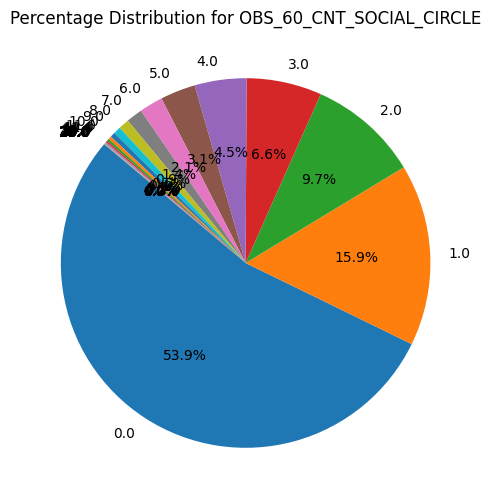


--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------

Unique values, counts, and data type for DEF_60_CNT_SOCIAL_CIRCLE:

+-------+--------------------------+--------+-----------+
| Index | DEF_60_CNT_SOCIAL_CIRCLE | Count  | Data Type |
+-------+--------------------------+--------+-----------+
|   0   |           0.0            | 281741 |  float64  |
|   1   |           1.0            | 21841  |  float64  |
|   2   |           2.0            |  3170  |  float64  |
|   3   |           3.0            |  598   |  float64  |
|   4   |           4.0            |  135   |  float64  |
|   5   |           5.0            |   20   |  float64  |
|   6   |           6.0            |   3    |  float64  |
|   7   |           7.0            |   1    |  float64  |
+-------+--------------------------+--------+-----------+




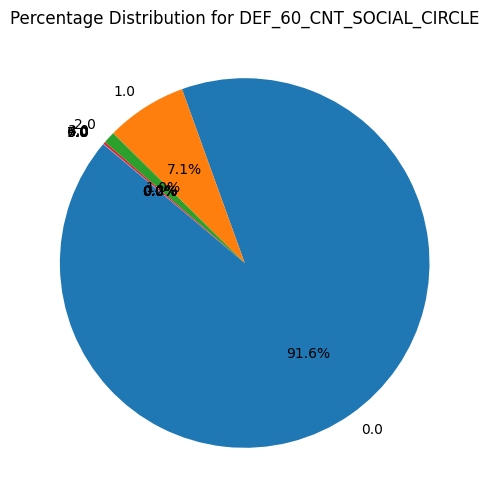


--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------

Unique values, counts, and data type for FLAG_DOCUMENT_3:

+-------+-----------------+--------+-----------+
| Index | FLAG_DOCUMENT_3 | Count  | Data Type |
+-------+-----------------+--------+-----------+
|   0   |        1        | 218339 |   int64   |
|   1   |        0        | 89170  |   int64   |
+-------+-----------------+--------+-----------+




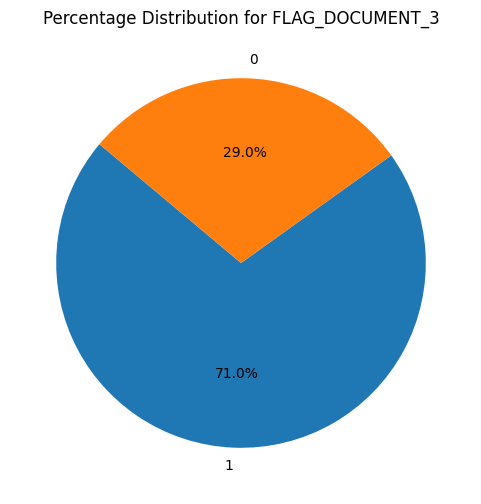


--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------

Unique values, counts, and data type for AMT_REQ_CREDIT_BUREAU_HOUR:

+-------+----------------------------+--------+-----------+
| Index | AMT_REQ_CREDIT_BUREAU_HOUR | Count  | Data Type |
+-------+----------------------------+--------+-----------+
|   0   |            0.0             | 305883 |  float64  |
|   1   |            1.0             |  1560  |  float64  |
|   2   |            2.0             |   56   |  float64  |
|   3   |            3.0             |   9    |  float64  |
|   4   |            4.0             |   1    |  float64  |
+-------+----------------------------+--------+-----------+




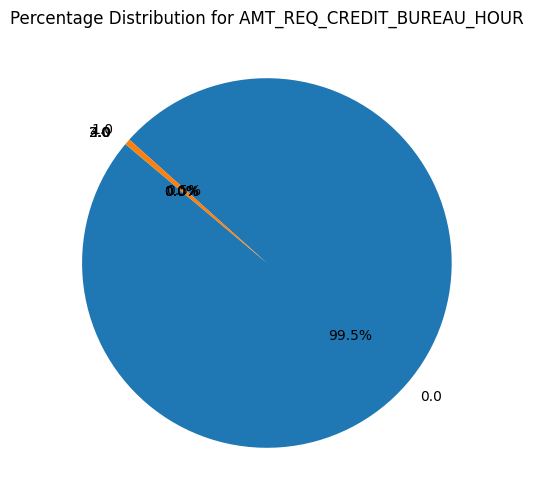


--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------

Unique values, counts, and data type for AMT_REQ_CREDIT_BUREAU_DAY:

+-------+---------------------------+--------+-----------+
| Index | AMT_REQ_CREDIT_BUREAU_DAY | Count  | Data Type |
+-------+---------------------------+--------+-----------+
|   0   |            0.0            | 306020 |  float64  |
|   1   |            1.0            |  1292  |  float64  |
|   2   |            2.0            |  106   |  float64  |
|   3   |            3.0            |   45   |  float64  |
|   4   |            4.0            |   26   |  float64  |
|   5   |            5.0            |   9    |  float64  |
|   6   |            6.0            |   8    |  float64  |
|   7   |            9.0            |   2    |  float64  |
|   8   |            8.0            |   1    |  float64  |
+-------+-----------

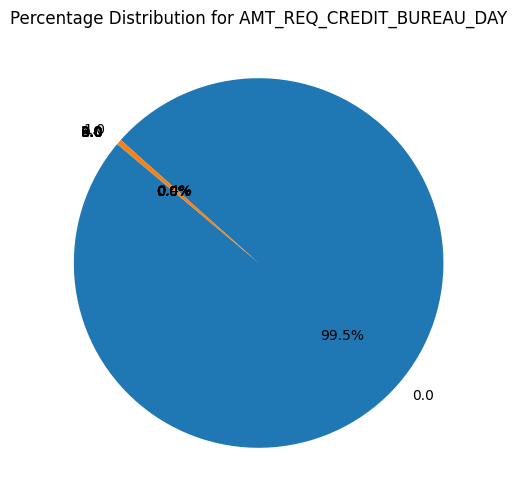


--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------

Unique values, counts, and data type for AMT_REQ_CREDIT_BUREAU_WEEK:

+-------+----------------------------+--------+-----------+
| Index | AMT_REQ_CREDIT_BUREAU_WEEK | Count  | Data Type |
+-------+----------------------------+--------+-----------+
|   0   |            0.0             | 298974 |  float64  |
|   1   |            1.0             |  8207  |  float64  |
|   2   |            2.0             |  199   |  float64  |
|   3   |            3.0             |   58   |  float64  |
|   4   |            4.0             |   34   |  float64  |
|   5   |            6.0             |   20   |  float64  |
|   6   |            5.0             |   10   |  float64  |
|   7   |            8.0             |   5    |  float64  |
|   8   |            7.0             |   2    |  float64  |
+------

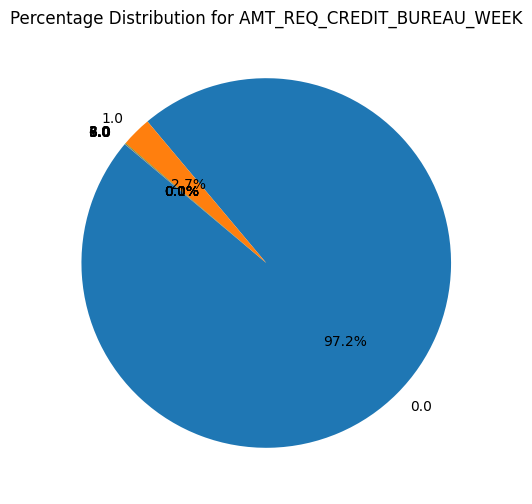


--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------

Unique values, counts, and data type for AMT_REQ_CREDIT_BUREAU_MON:

+-------+---------------------------+--------+-----------+
| Index | AMT_REQ_CREDIT_BUREAU_MON | Count  | Data Type |
+-------+---------------------------+--------+-----------+
|   0   |            0.0            | 263752 |  float64  |
|   1   |            1.0            | 33145  |  float64  |
|   2   |            2.0            |  5386  |  float64  |
|   3   |            3.0            |  1991  |  float64  |
|   4   |            4.0            |  1076  |  float64  |
|   5   |            5.0            |  602   |  float64  |
|   6   |            6.0            |  343   |  float64  |
|   7   |            7.0            |  298   |  float64  |
|   8   |            9.0            |  206   |  float64  |
|   9   |           

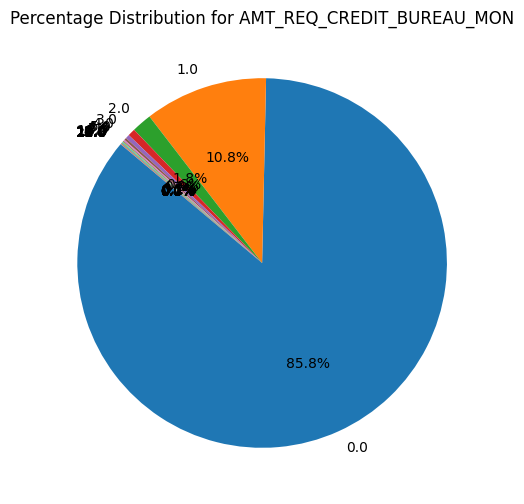


--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------

Unique values, counts, and data type for AMT_REQ_CREDIT_BUREAU_QRT:

+-------+---------------------------+--------+-----------+
| Index | AMT_REQ_CREDIT_BUREAU_QRT | Count  | Data Type |
+-------+---------------------------+--------+-----------+
|   0   |            0.0            | 256935 |  float64  |
|   1   |            1.0            | 33862  |  float64  |
|   2   |            2.0            | 14412  |  float64  |
|   3   |            3.0            |  1717  |  float64  |
|   4   |            4.0            |  476   |  float64  |
|   5   |            5.0            |   64   |  float64  |
|   6   |            6.0            |   28   |  float64  |
|   7   |            8.0            |   7    |  float64  |
|   8   |            7.0            |   7    |  float64  |
|   9   |           

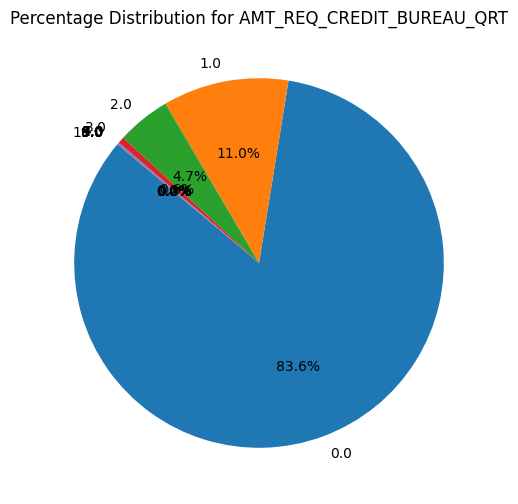


--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------

Unique values, counts, and data type for AMT_REQ_CREDIT_BUREAU_YEAR:

+-------+----------------------------+--------+-----------+
| Index | AMT_REQ_CREDIT_BUREAU_YEAR | Count  | Data Type |
+-------+----------------------------+--------+-----------+
|   0   |            0.0             | 113319 |  float64  |
|   1   |            1.0             | 63405  |  float64  |
|   2   |            2.0             | 50192  |  float64  |
|   3   |            3.0             | 33627  |  float64  |
|   4   |            4.0             | 20714  |  float64  |
|   5   |            5.0             | 12052  |  float64  |
|   6   |            6.0             |  6967  |  float64  |
|   7   |            7.0             |  3869  |  float64  |
|   8   |            8.0             |  2127  |  float64  |
|   9  

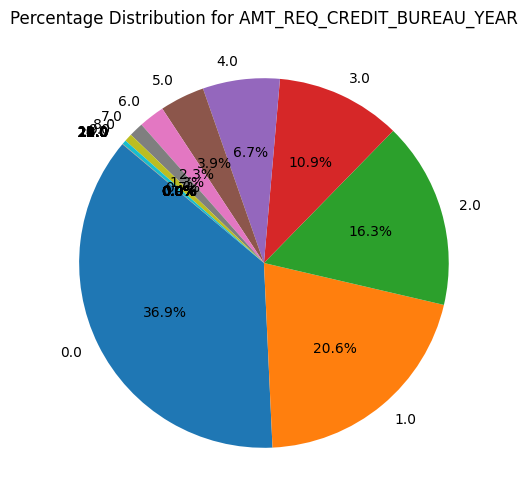


--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------



In [ ]:
# A look at numerical_non_continuous_columns
display_column_info(numerical_non_continuous_columns)

# **2. Segmented Univariate Analysis with respect to TARGET**
**A. Numerical Continuous Columns**

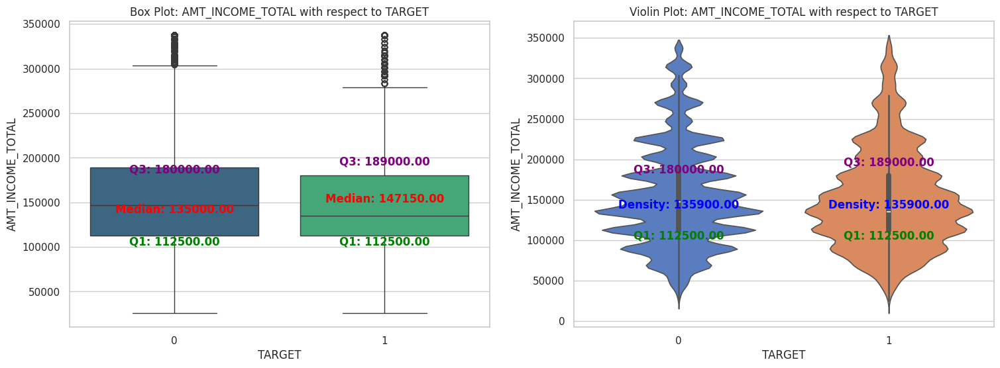

Summary Statistics for AMT_INCOME_TOTAL with respect to TARGET:
|   TARGET |   count |   mean |     std |   min |    25% |    50% |    75% |    max |
|---------:|--------:|-------:|--------:|------:|-------:|-------:|-------:|-------:|
|        0 |  282684 | 154214 | 62765.8 | 25650 | 112500 | 147150 | 189000 | 337500 |
|        1 |   24825 | 150814 | 60012.7 | 25650 | 112500 | 135000 | 180000 | 337500 |

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------



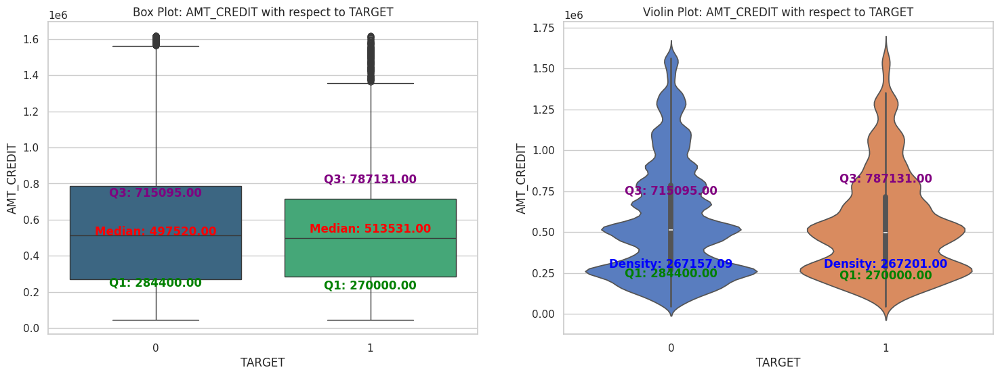

Summary Statistics for AMT_CREDIT with respect to TARGET:
|   TARGET |   count |   mean |    std |   min |    25% |    50% |    75% |         max |
|---------:|--------:|-------:|-------:|------:|-------:|-------:|-------:|------------:|
|        0 |  282684 | 571081 | 351821 | 45000 | 270000 | 513531 | 787131 | 1.61628e+06 |
|        1 |   24825 | 542498 | 314460 | 45000 | 284400 | 497520 | 715095 | 1.61597e+06 |

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------



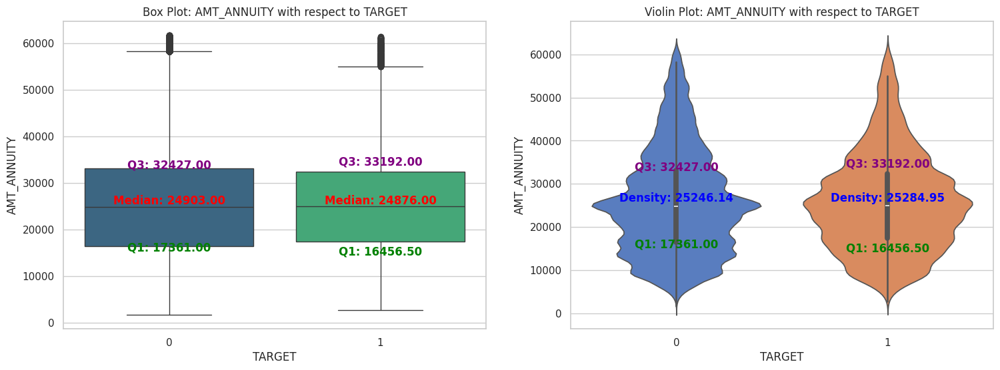

Summary Statistics for AMT_ANNUITY with respect to TARGET:
|   TARGET |   count |    mean |     std |    min |     25% |   50% |   75% |     max |
|---------:|--------:|--------:|--------:|-------:|--------:|------:|------:|--------:|
|        0 |  282684 | 25898.8 | 12144.1 | 1615.5 | 16456.5 | 24876 | 33192 | 61699.5 |
|        1 |   24825 | 25909.6 | 11332.4 | 2722.5 | 17361   | 24903 | 32427 | 61402.5 |

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------



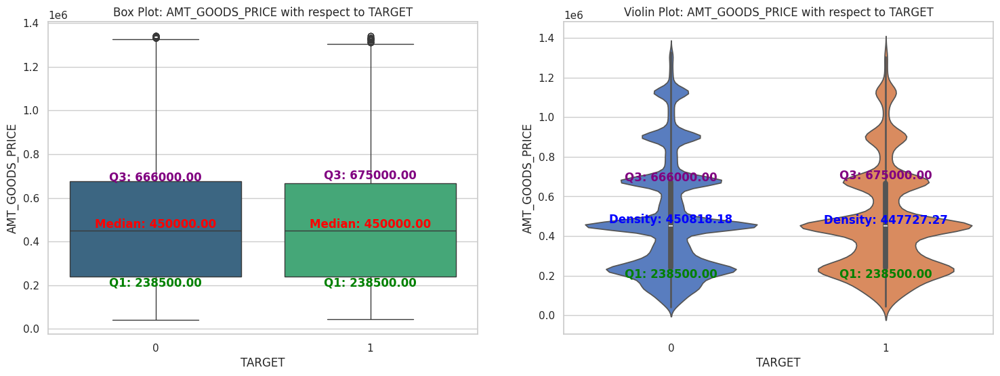

Summary Statistics for AMT_GOODS_PRICE with respect to TARGET:
|   TARGET |   count |   mean |    std |   min |    25% |    50% |    75% |       max |
|---------:|--------:|-------:|-------:|------:|-------:|-------:|-------:|----------:|
|        0 |  282684 | 487185 | 285387 | 40500 | 238500 | 450000 | 675000 | 1.341e+06 |
|        1 |   24825 | 462357 | 260067 | 45000 | 238500 | 450000 | 666000 | 1.341e+06 |

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------



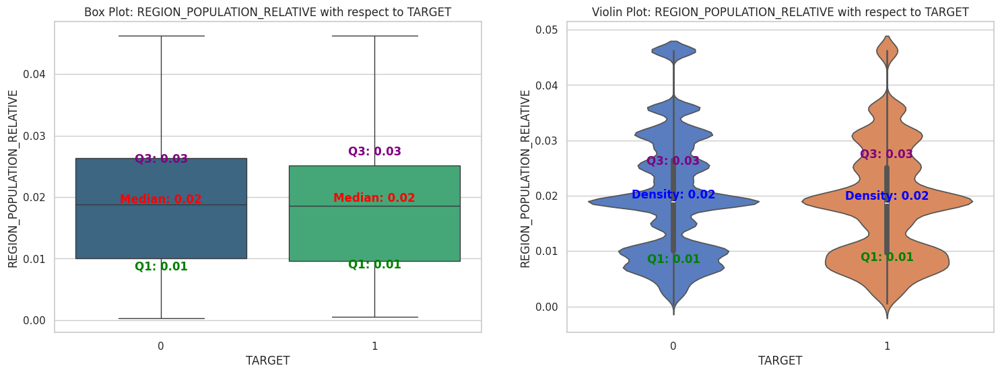

Summary Statistics for REGION_POPULATION_RELATIVE with respect to TARGET:
|   TARGET |   count |      mean |       std |      min |      25% |      50% |      75% |     max |
|---------:|--------:|----------:|----------:|---------:|---------:|---------:|---------:|--------:|
|        0 |  282684 | 0.0194873 | 0.0108352 | 0.00029  | 0.010006 | 0.01885  | 0.026392 | 0.04622 |
|        1 |   24825 | 0.0184087 | 0.0101421 | 0.000533 | 0.00963  | 0.018634 | 0.025164 | 0.04622 |

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------



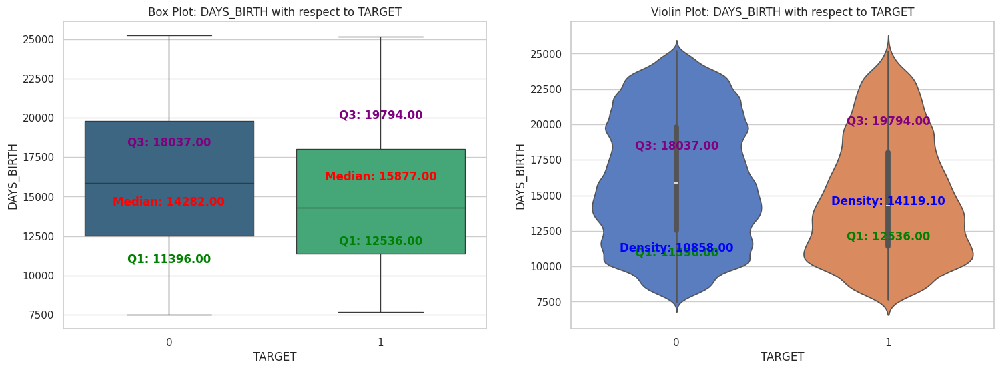

Summary Statistics for DAYS_BIRTH with respect to TARGET:
|   TARGET |   count |    mean |     std |   min |   25% |   50% |   75% |   max |
|---------:|--------:|--------:|--------:|------:|------:|------:|------:|------:|
|        0 |  282684 | 16138.2 | 4364.2  |  7489 | 12536 | 15877 | 19794 | 25229 |
|        1 |   24825 | 14884.8 | 4192.84 |  7678 | 11396 | 14282 | 18037 | 25168 |

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------



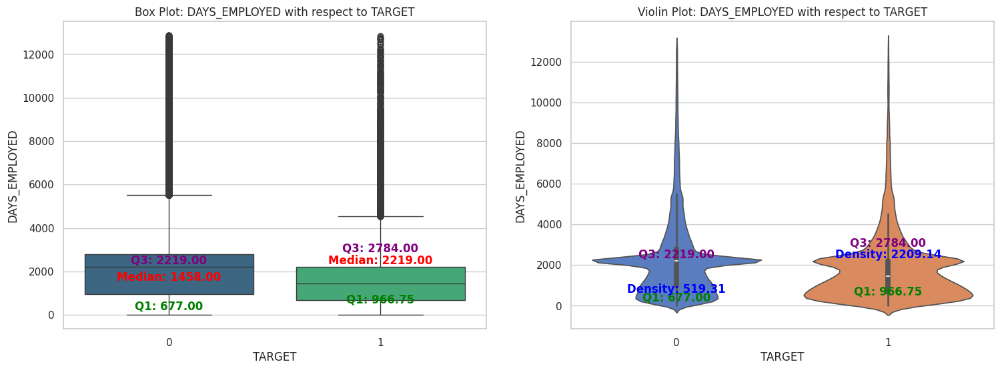

Summary Statistics for DAYS_EMPLOYED with respect to TARGET:
|   TARGET |   count |    mean |     std |   min |    25% |   50% |   75% |   max |
|---------:|--------:|--------:|--------:|------:|-------:|------:|------:|------:|
|        0 |  282684 | 2357.02 | 2030.53 |     0 | 966.75 |  2219 |  2784 | 12865 |
|        1 |   24825 | 1856.56 | 1714.49 |     0 | 677    |  1458 |  2219 | 12853 |

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------



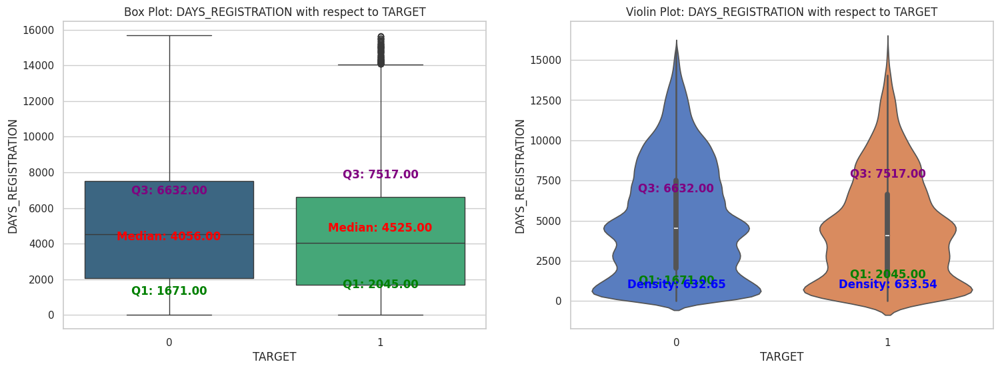

Summary Statistics for DAYS_REGISTRATION with respect to TARGET:
|   TARGET |   count |    mean |     std |   min |   25% |   50% |   75% |   max |
|---------:|--------:|--------:|--------:|------:|------:|------:|------:|------:|
|        0 |  282684 | 5002.25 | 3493.08 |     0 |  2045 |  4525 |  7517 | 15680 |
|        1 |   24825 | 4473.56 | 3273.41 |     0 |  1671 |  4056 |  6632 | 15658 |

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------



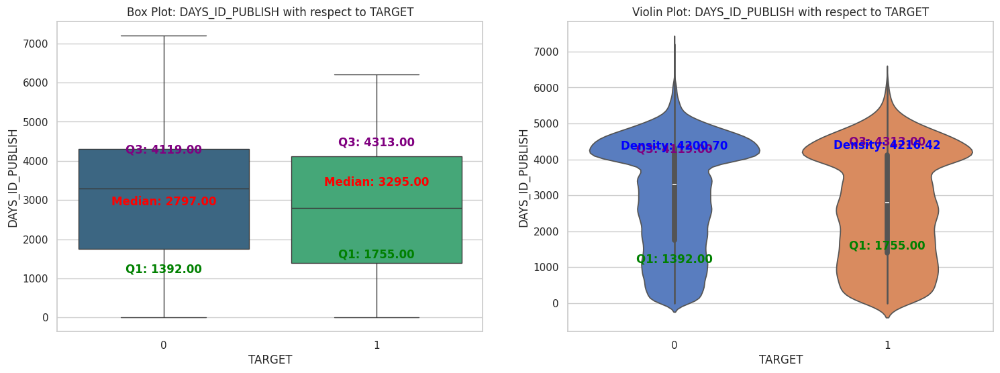

Summary Statistics for DAYS_ID_PUBLISH with respect to TARGET:
|   TARGET |   count |    mean |     std |   min |   25% |   50% |   75% |   max |
|---------:|--------:|--------:|--------:|------:|------:|------:|------:|------:|
|        0 |  282684 | 3017.22 | 1506.62 |     0 |  1755 |  3295 |  4313 |  7197 |
|        1 |   24825 | 2732.1  | 1516.98 |     0 |  1392 |  2797 |  4119 |  6207 |

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------



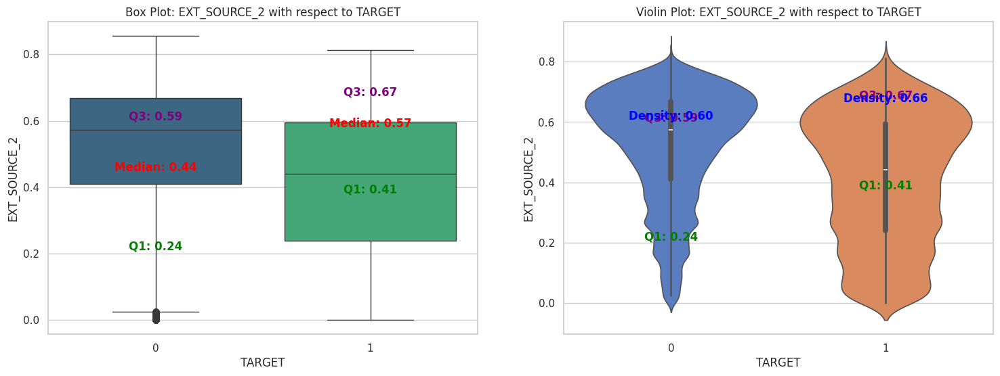

Summary Statistics for EXT_SOURCE_2 with respect to TARGET:
|   TARGET |   count |    mean |      std |         min |      25% |      50% |      75% |     max |
|---------:|--------:|--------:|---------:|------------:|---------:|---------:|---------:|--------:|
|        0 |  282684 | 0.52357 | 0.186087 | 8.17362e-08 | 0.410347 | 0.573402 | 0.667521 | 0.855   |
|        1 |   24825 | 0.41126 | 0.213002 | 5.00211e-06 | 0.239084 | 0.441076 | 0.593937 | 0.81187 |

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------



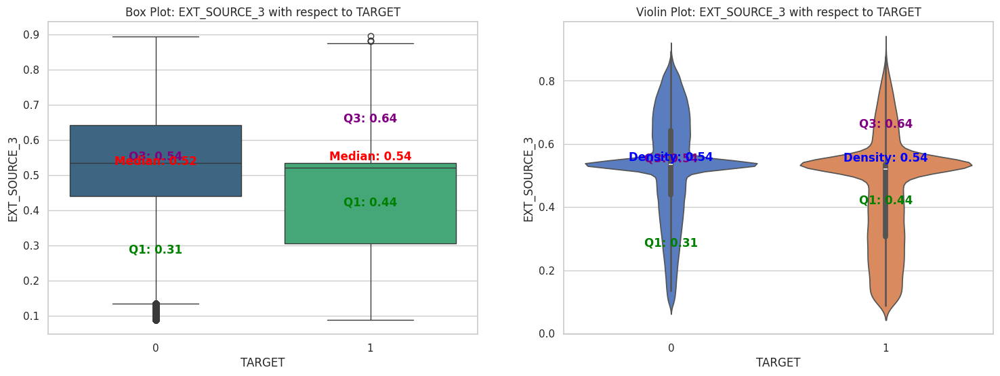

Summary Statistics for EXT_SOURCE_3 with respect to TARGET:
|   TARGET |   count |     mean |      std |       min |      25% |      50% |      75% |      max |
|---------:|--------:|---------:|---------:|----------:|---------:|---------:|---------:|---------:|
|        0 |  282684 | 0.529164 | 0.163345 | 0.0884606 | 0.440058 | 0.535276 | 0.643026 | 0.893976 |
|        1 |   24825 | 0.446452 | 0.172998 | 0.0884606 | 0.306202 | 0.520898 | 0.535276 | 0.89601  |

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------



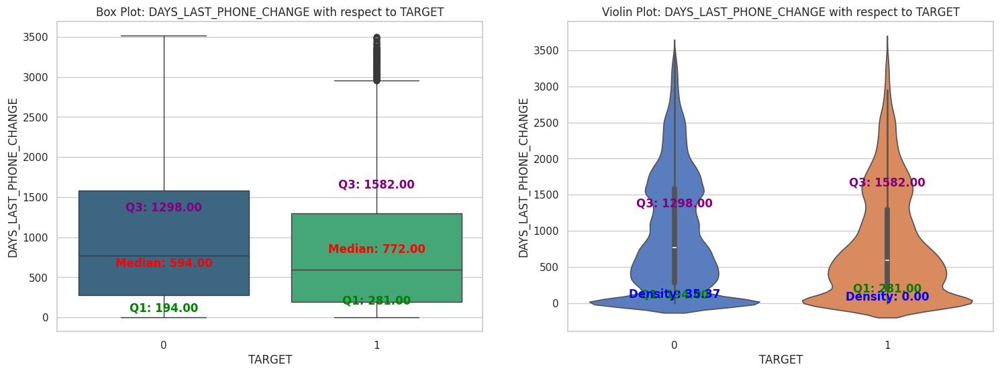

Summary Statistics for DAYS_LAST_PHONE_CHANGE with respect to TARGET:
|   TARGET |   count |    mean |     std |   min |   25% |   50% |   75% |   max |
|---------:|--------:|--------:|--------:|------:|------:|------:|------:|------:|
|        0 |  282684 | 972.068 | 824.672 |     0 |   281 |   772 |  1582 |  3514 |
|        1 |   24825 | 806.539 | 753.822 |     0 |   194 |   594 |  1298 |  3502 |

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------



In [ ]:
# Set the style for the plots
sns.set(style="whitegrid")

# Import necessary libraries
import numpy as np
from scipy.stats import gaussian_kde

# Iterate through each numerical continuous column
for col in numerical_continuous_columns:
    # Create a figure with two subplots (box plot and violin plot) side by side
    fig, axes = plt.subplots(1, 2, figsize=(18, 6))

    # Box Plot
    sns.boxplot(x='TARGET', y=col, data=application_data_df, palette="viridis", ax=axes[0])

    # Annotate quartile values on the box plot
    for i, target_value in enumerate(application_data_df['TARGET'].unique()):
        quartiles = application_data_df[application_data_df['TARGET'] == target_value][col].quantile([0.25, 0.75])
        axes[0].text(i, quartiles[0.25], f'Q1: {quartiles[0.25]:.2f}', ha='center', va='top', fontweight='bold', color='green')
        axes[0].text(i, quartiles[0.75], f'Q3: {quartiles[0.75]:.2f}', ha='center', va='bottom', fontweight='bold', color='purple')

        # Annotate median dynamically
        median_val = application_data_df[application_data_df['TARGET'] == target_value][col].median()
        axes[0].text(i, median_val, f'Median: {median_val:.2f}', ha='center', va='bottom', fontweight='bold', color='red')

    axes[0].set_title(f'Box Plot: {col} with respect to TARGET')
    axes[0].set_xlabel('TARGET')
    axes[0].set_ylabel(col)

    # Violin Plot
    sns.violinplot(x='TARGET', y=col, data=application_data_df, palette="muted", ax=axes[1])

    # Annotate quartile values on the violin plot
    for i, target_value in enumerate(application_data_df['TARGET'].unique()):
        quartiles = application_data_df[application_data_df['TARGET'] == target_value][col].quantile([0.25, 0.75])
        axes[1].text(i, quartiles[0.25], f'Q1: {quartiles[0.25]:.2f}', ha='center', va='top', fontweight='bold', color='green')
        axes[1].text(i, quartiles[0.75], f'Q3: {quartiles[0.75]:.2f}', ha='center', va='bottom', fontweight='bold', color='purple')

    # Annotate width of the violin plot dynamically
    for i, target_value in enumerate(application_data_df['TARGET'].unique()):
        x = application_data_df[application_data_df['TARGET'] == target_value][col]
        density = gaussian_kde(x)
        xs = np.linspace(x.min(), x.max(), 100)
        ys = density(xs)
        max_density_index = np.argmax(ys)
        max_density_value = xs[max_density_index]
        axes[1].text(i, max_density_value, f'Density: {max_density_value:.2f}', ha='center', va='bottom', fontweight='bold', color='blue')

    axes[1].set_title(f'Violin Plot: {col} with respect to TARGET')
    axes[1].set_xlabel('TARGET')
    axes[1].set_ylabel(col)

    plt.show()

    # Display summary statistics
    summary_stats = application_data_df.groupby('TARGET')[col].describe()
    print(f'Summary Statistics for {col} with respect to TARGET:')
    print(summary_stats.to_markdown())
    print('\n' + '-'*200 + '\n')


**Inference :**

TARGET - Target variable (1 - client with payment difficulties, 0 - all other cases)

DAYS_BIRTH - Client's age in days at the time of application

*   Surprisingly, Median of  AMT_INCOME_TOTAL,AMT_CREDIT for TARGET = 1 for > AMT_INCOME_TOTAL for TARGET = 1
*   For Older people(DAYS_BIRTH) paying back loans looks easier





**B.Categorical Columns**

In [ ]:
category_columns

['NAME_CONTRACT_TYPE',
 'CODE_GENDER',
 'NAME_TYPE_SUITE',
 'NAME_INCOME_TYPE',
 'NAME_EDUCATION_TYPE',
 'NAME_FAMILY_STATUS',
 'NAME_HOUSING_TYPE',
 'OCCUPATION_TYPE',
 'WEEKDAY_APPR_PROCESS_START',
 'ORGANIZATION_TYPE']

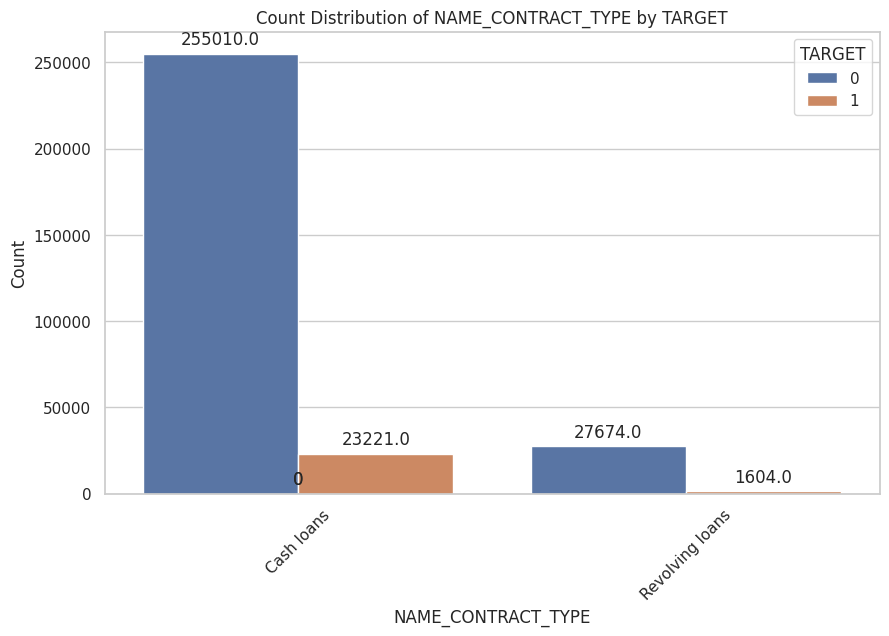

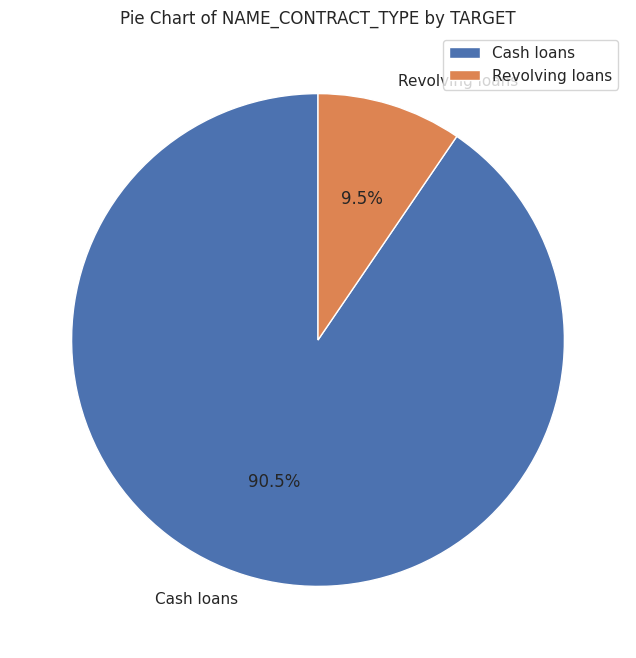

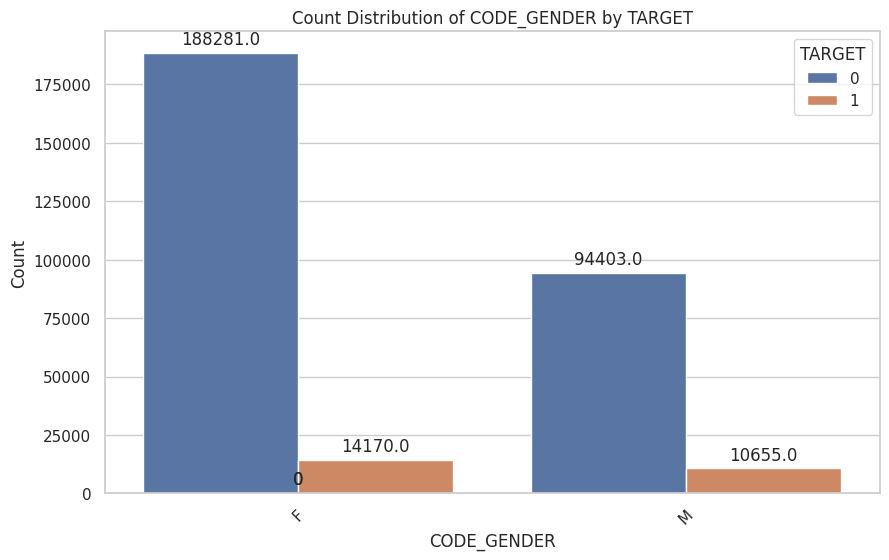

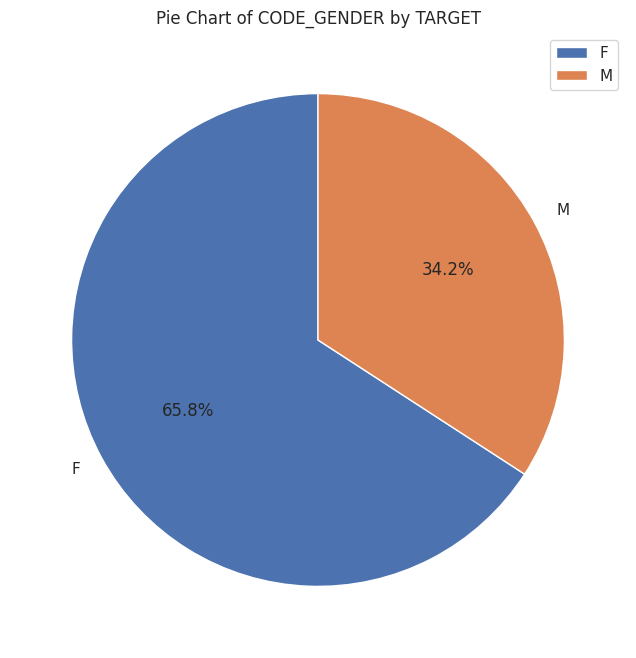

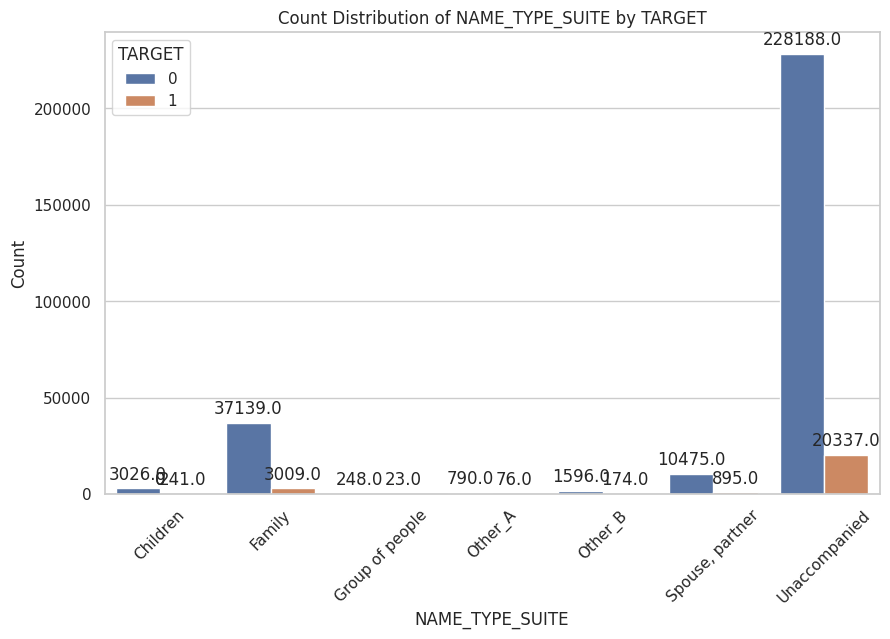

...

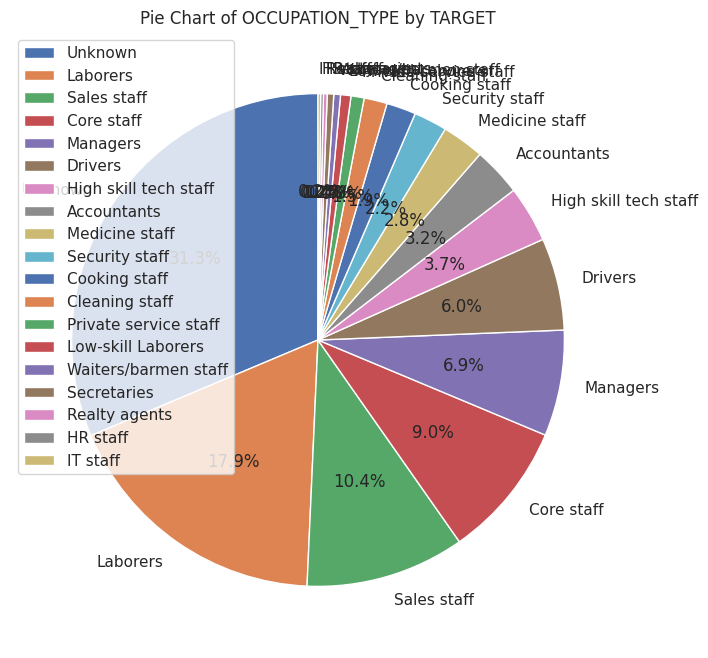

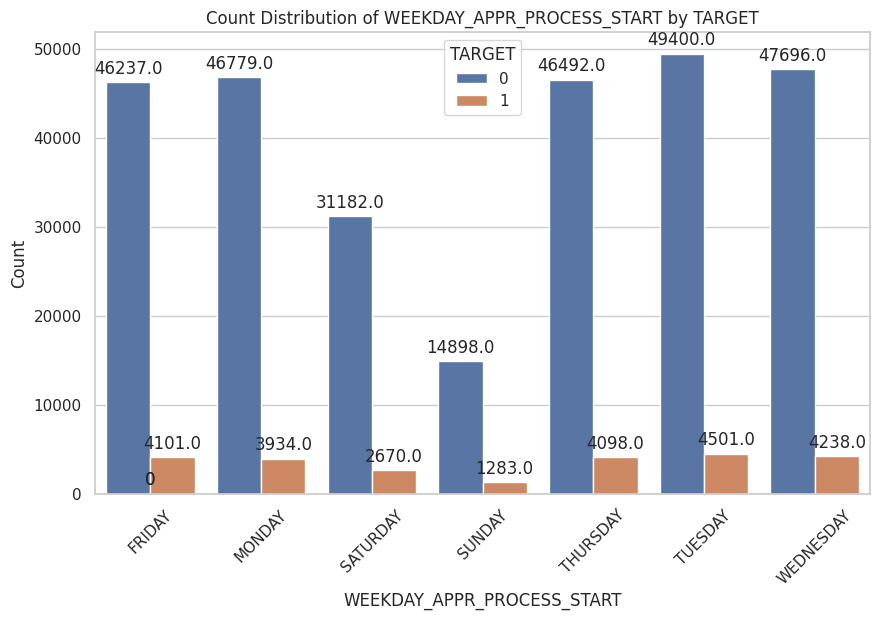

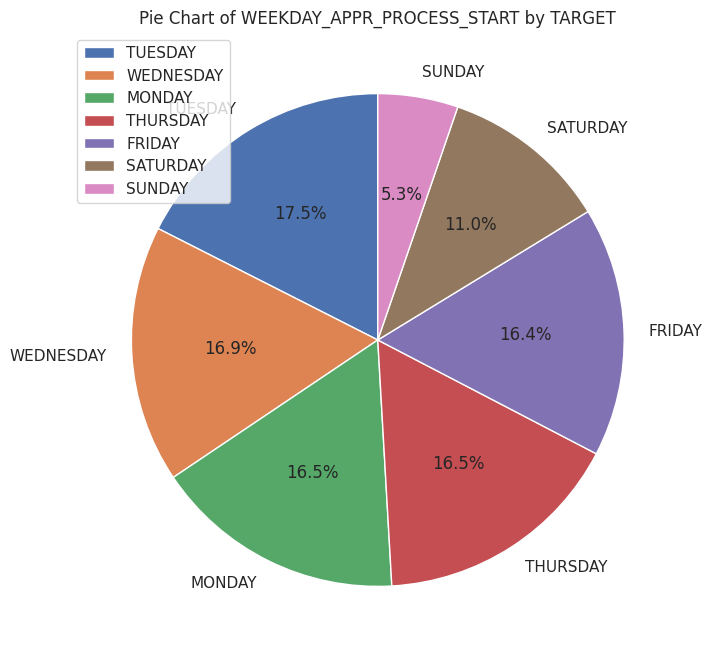

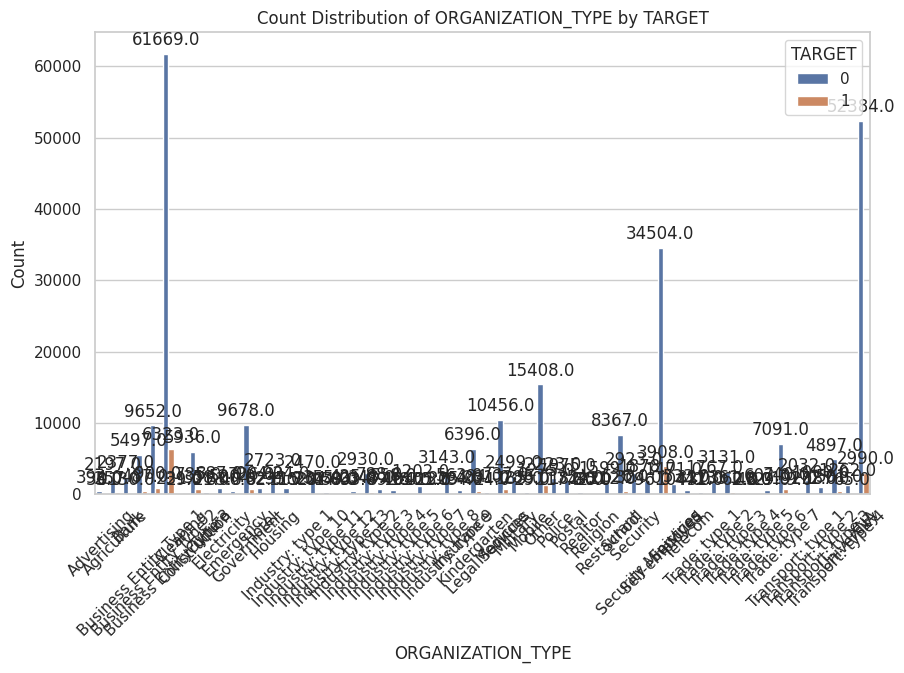

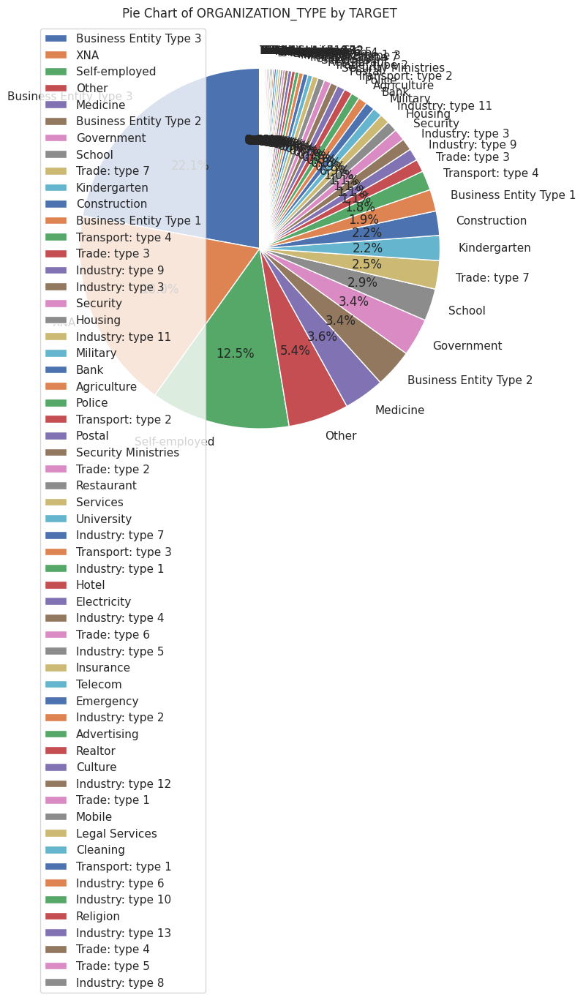

+-----+----------------------------+-------------------------------+----------------+----------------+---------------------+---------------------+
|     |           Column           |           Category            | Count_TARGET_0 | Count_TARGET_1 | Percentage_TARGET_0 | Percentage_TARGET_1 |
+-----+----------------------------+-------------------------------+----------------+----------------+---------------------+---------------------+
|  0  |     NAME_CONTRACT_TYPE     |          Cash loans           |    255010.0    |    23221.0     |  91.65405724020688  |  8.345942759793122  |
|  1  |     NAME_CONTRACT_TYPE     |        Revolving loans        |    27674.0     |     1604.0     |  94.52148370790354  | 5.4785162920964545  |
|  2  |        CODE_GENDER         |               F               |    188281.0    |    14170.0     |  93.00077549629293  |  6.999224503707071  |
|  3  |        CODE_GENDER         |               M               |    94403.0     |    10655.0     |  89.85798320927

In [ ]:
# Create a DataFrame to store summary statistics
summary_statistics = pd.DataFrame(columns=['Column', 'Category', 'Count_TARGET_0', 'Count_TARGET_1', 'Percentage_TARGET_0', 'Percentage_TARGET_1'])

# Loop through each categorical column
for column in category_columns:

    # Drop rows with NaN values in the categorical column
    application_data_cleaned = application_data_df.dropna(subset=[column])

    # 1. Count Plot
    plt.figure(figsize=(10, 6))
    count_plot = sns.countplot(x=column, hue='TARGET', data=application_data_cleaned)

    # Annotate count on each bar
    for p in count_plot.patches:
        count_plot.annotate(f'{p.get_height()}', (p.get_x() + p.get_width() / 2., p.get_height()),
                             ha='center', va='center', xytext=(0, 10), textcoords='offset points')

    # Calculate and annotate the count and percentage of each category
    total_counts = application_data_cleaned.groupby(column)['TARGET'].count().reset_index()

    category_percentage_data = []

    for i, value in enumerate(total_counts['TARGET']):
        count_target_0 = application_data_cleaned[(application_data_cleaned[column] == total_counts[column][i]) & (application_data_cleaned['TARGET'] == 0)].shape[0]
        count_target_1 = application_data_cleaned[(application_data_cleaned[column] == total_counts[column][i]) & (application_data_cleaned['TARGET'] == 1)].shape[0]

        percentage_target_0 = (count_target_0 / value) * 100
        percentage_target_1 = (count_target_1 / value) * 100

        category_percentage_data.append([column, total_counts[column][i], count_target_0, count_target_1, percentage_target_0, percentage_target_1])

        # Annotate tabulated data on the graph
        #plt.text(i, count_plot.get_ylim()[1]/2, f'{total_counts[column][i]}\nTARGET=0: {percentage_target_0:.2f}%\nTARGET=1: {percentage_target_1:.2f}%', rotation=90, ha='center', va='center', color='black')

    plt.title(f'Count Distribution of {column} by TARGET')
    plt.xlabel(column)
    plt.ylabel('Count')
    plt.xticks(rotation=45)
    plt.show()

    # 2. Pie Chart
    plt.figure(figsize=(8, 8))
    target_pie_data = application_data_cleaned[column].value_counts()
    plt.pie(target_pie_data, labels=target_pie_data.index, autopct='%1.1f%%', startangle=90)

    plt.legend()  # Add this line to create the legend

    plt.title(f'Pie Chart of {column} by TARGET')

    plt.show()

    summary_statistics = summary_statistics.append(category_percentage_data, ignore_index=True)
summary_statistics = summary_statistics.drop(summary_statistics.columns[:6], axis=1)
# Print the summary statistics using tabulate
headers = ['Column', 'Category', 'Count_TARGET_0', 'Count_TARGET_1', 'Percentage_TARGET_0', 'Percentage_TARGET_1']
print(tabulate(summary_statistics, headers=headers, tablefmt='pretty'))

**Inference**:


*   Most contracts are "Cash loans".
*   There are more females than males applying for loans.
*   Loans are commonly taken by individuals without a co-applicant
*   The majority of applicants have income from "Working" and "Commercial associate" categories
*   No significant variation in repayment rates based on the day of the week.
*   "IT staff" and "HR staff" show higher repayment rates."Low-skill Laborers" and "Waiters/barmen staff" have lower repayment rates.
*   Widows have the highest repayment rate (94.18%).



In [ ]:
summary_statistics.shape

(119, 6)

**C. Numerical Non Continuous Columns**

In [ ]:
numerical_non_continuous_columns

['TARGET',
 'CNT_CHILDREN',
 'CNT_FAM_MEMBERS',
 'REGION_RATING_CLIENT',
 'REGION_RATING_CLIENT_W_CITY',
 'HOUR_APPR_PROCESS_START',
 'REG_REGION_NOT_LIVE_REGION',
 'REG_REGION_NOT_WORK_REGION',
 'LIVE_REGION_NOT_WORK_REGION',
 'REG_CITY_NOT_LIVE_CITY',
 'REG_CITY_NOT_WORK_CITY',
 'LIVE_CITY_NOT_WORK_CITY',
 'OBS_30_CNT_SOCIAL_CIRCLE',
 'DEF_30_CNT_SOCIAL_CIRCLE',
 'OBS_60_CNT_SOCIAL_CIRCLE',
 'DEF_60_CNT_SOCIAL_CIRCLE',
 'FLAG_DOCUMENT_3',
 'AMT_REQ_CREDIT_BUREAU_HOUR',
 'AMT_REQ_CREDIT_BUREAU_DAY',
 'AMT_REQ_CREDIT_BUREAU_WEEK',
 'AMT_REQ_CREDIT_BUREAU_MON',
 'AMT_REQ_CREDIT_BUREAU_QRT',
 'AMT_REQ_CREDIT_BUREAU_YEAR']

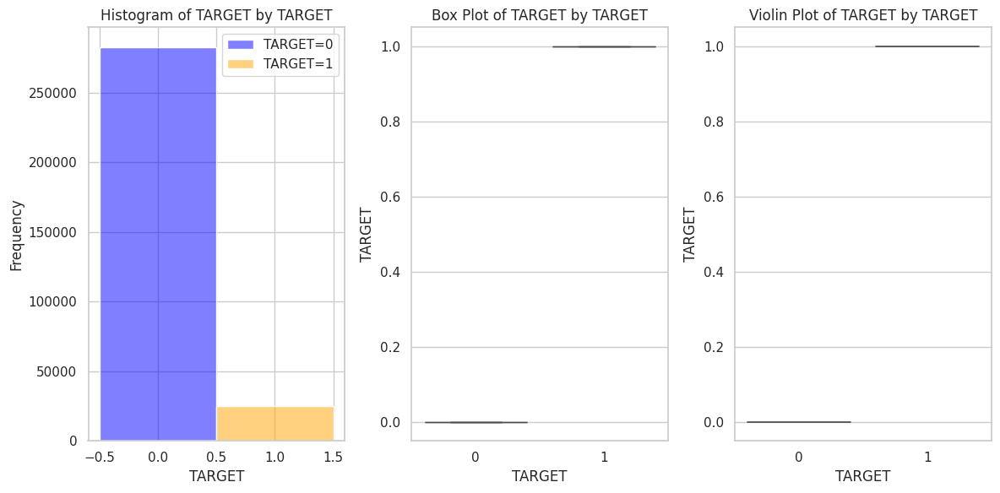

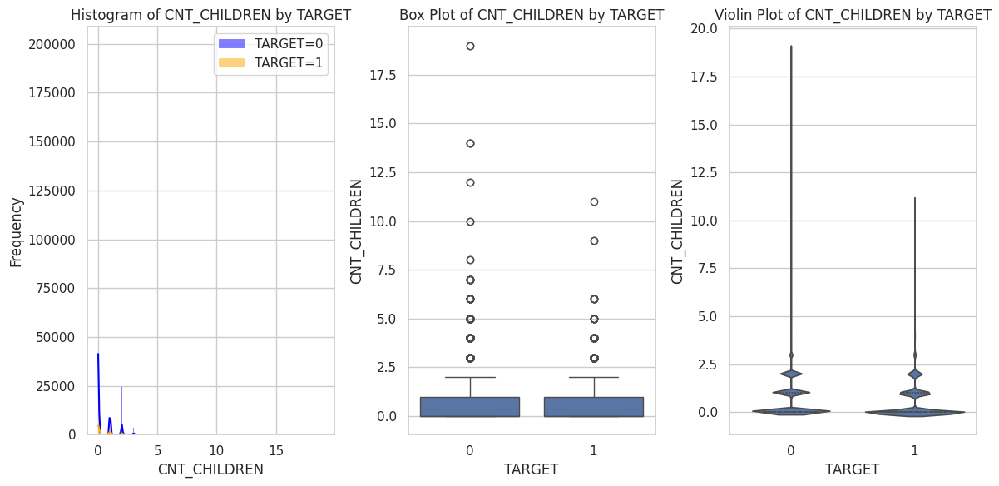

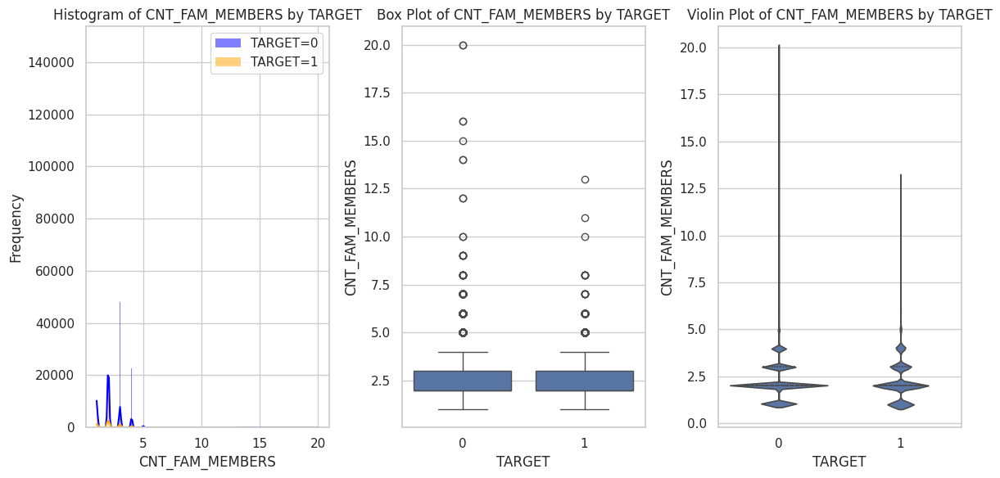

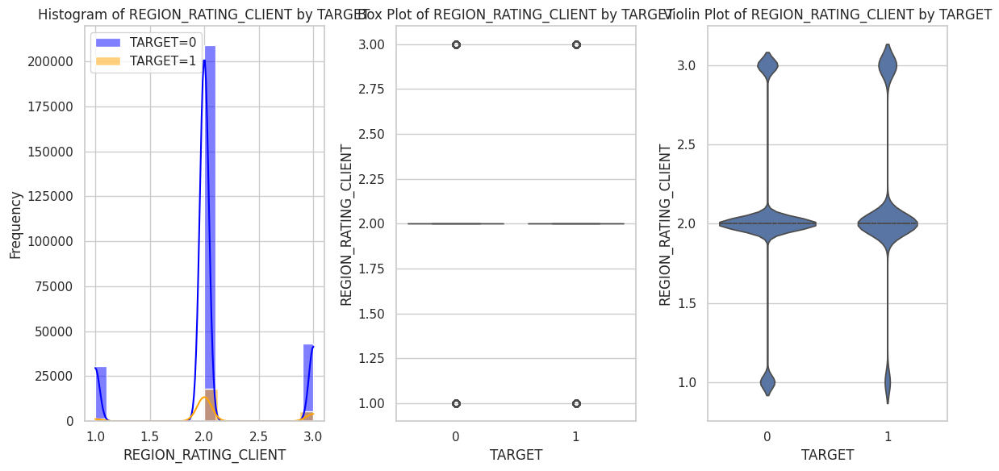

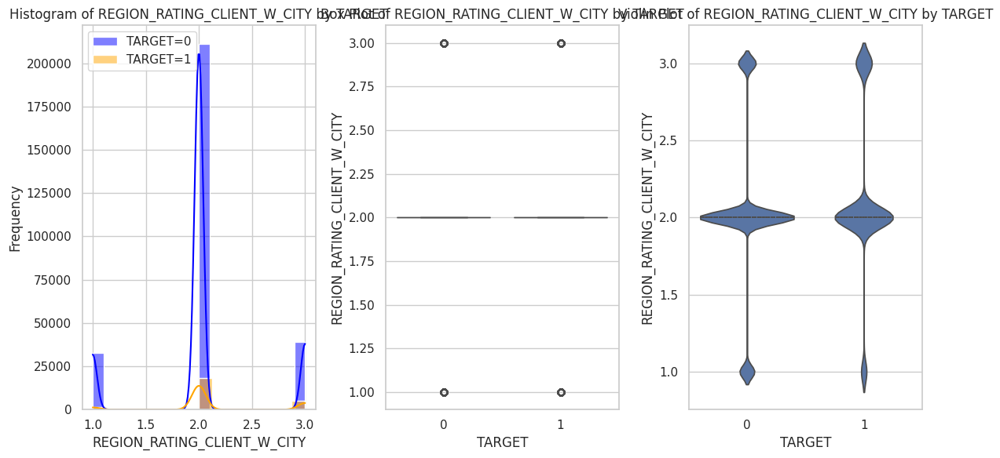

...

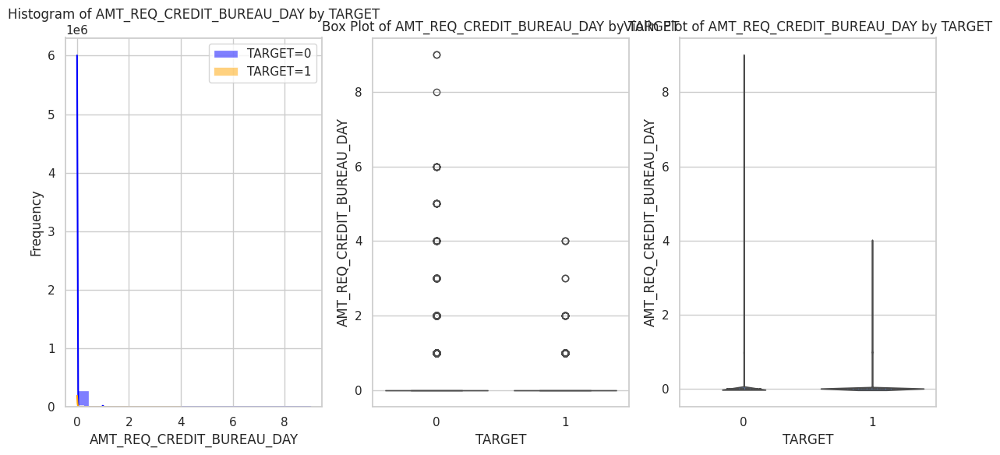

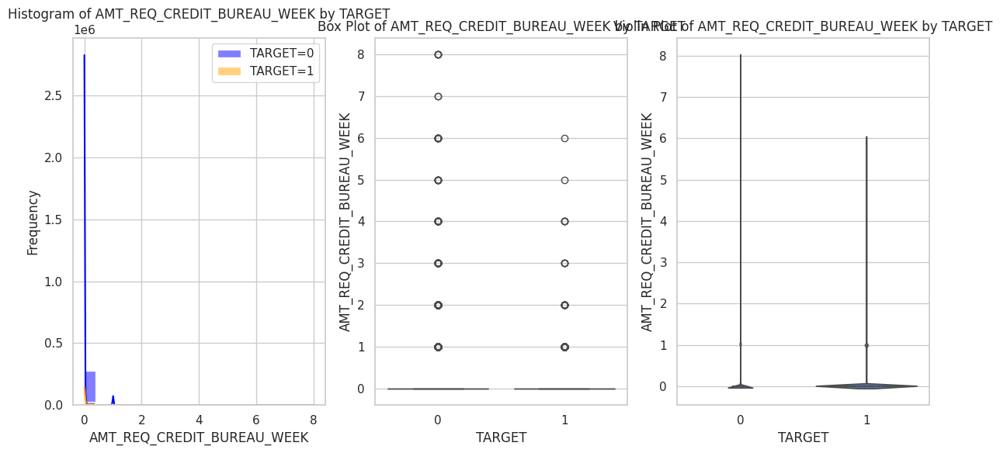

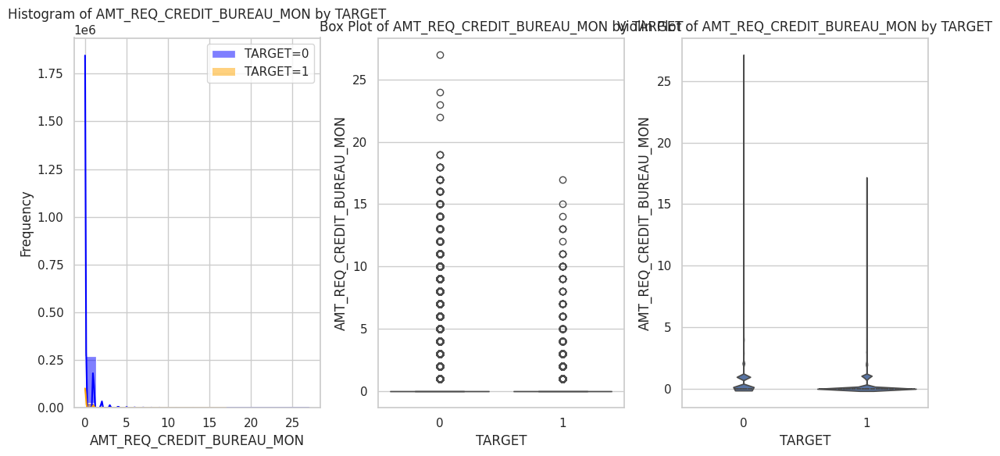

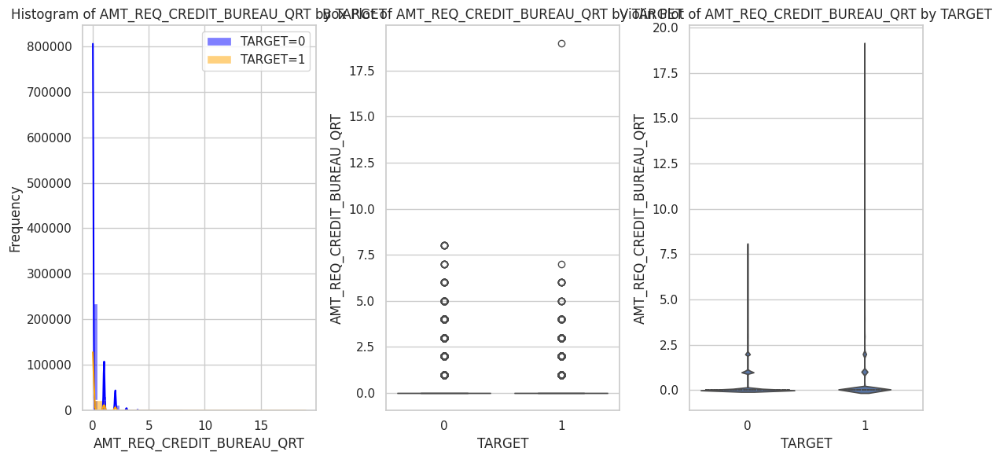

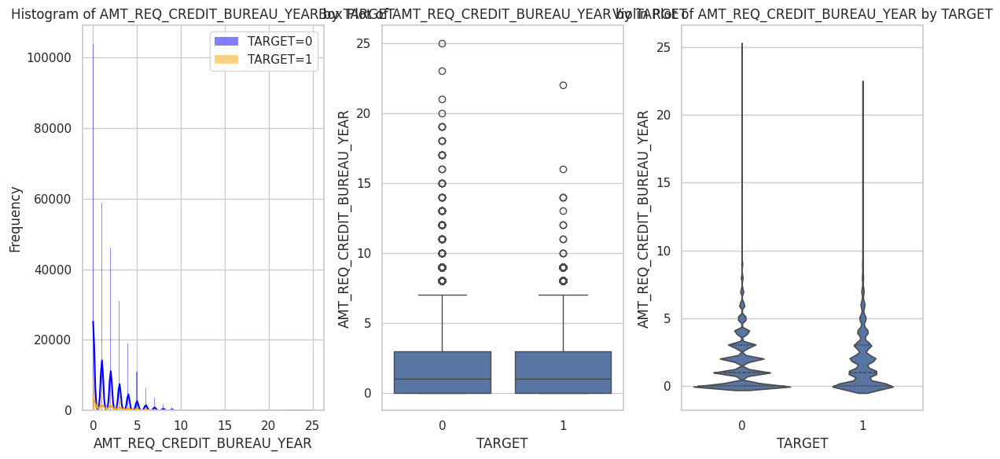

+----+-----------------------------+-----------------------+----------------------+-----------------+-----------------+---------------------+---------------------+
|    |           Column            |     Mean_TARGET_0     |    Mean_TARGET_1     | Median_TARGET_0 | Median_TARGET_1 |    Std_TARGET_0     |    Std_TARGET_1     |
+----+-----------------------------+-----------------------+----------------------+-----------------+-----------------+---------------------+---------------------+
| 0  |           TARGET            |          0.0          |         1.0          |       0.0       |       1.0       |         0.0         |         0.0         |
| 1  |        CNT_CHILDREN         |  0.41294519675680263  | 0.46380664652567977  |       0.0       |       0.0       | 0.7188439724825602  | 0.7569031933361581  |
| 2  |       CNT_FAM_MEMBERS       |  2.1501535283213764   |  2.1812688821752264  |       2.0       |       2.0       | 0.9069799057990284  | 0.9513269484604351  |
| 3  |    REGION

In [ ]:


# Create a DataFrame to store summary statistics
summary_statistics = pd.DataFrame(columns=['Column', 'Mean_TARGET_0', 'Mean_TARGET_1', 'Median_TARGET_0', 'Median_TARGET_1', 'Std_TARGET_0', 'Std_TARGET_1'])

# Loop through each numerical non-continuous column
for column in numerical_non_continuous_columns:

    # 1. Histogram
    plt.figure(figsize=(12, 6))
    plt.subplot(1, 3, 1)
    sns.histplot(application_data_df[application_data_df['TARGET'] == 0][column], color='blue', label='TARGET=0', kde=True)
    sns.histplot(application_data_df[application_data_df['TARGET'] == 1][column], color='orange', label='TARGET=1', kde=True)
    plt.title(f'Histogram of {column} by TARGET')
    plt.xlabel(column)
    plt.ylabel('Frequency')
    plt.legend()

    # 2. Box Plot
    plt.subplot(1, 3, 2)
    sns.boxplot(x='TARGET', y=column, data=application_data_df)
    plt.title(f'Box Plot of {column} by TARGET')
    plt.xlabel('TARGET')
    plt.ylabel(column)

    # 3. Violin Plot
    plt.subplot(1, 3, 3)
    sns.violinplot(x='TARGET', y=column, data=application_data_df, inner='quartile')
    plt.title(f'Violin Plot of {column} by TARGET')
    plt.xlabel('TARGET')
    plt.ylabel(column)

    plt.tight_layout()
    plt.show()

    # 4. Mathematical Univariate Analysis
    mean_target_0 = application_data_df[application_data_df['TARGET'] == 0][column].mean()
    mean_target_1 = application_data_df[application_data_df['TARGET'] == 1][column].mean()

    median_target_0 = application_data_df[application_data_df['TARGET'] == 0][column].median()
    median_target_1 = application_data_df[application_data_df['TARGET'] == 1][column].median()

    std_target_0 = application_data_df[application_data_df['TARGET'] == 0][column].std()
    std_target_1 = application_data_df[application_data_df['TARGET'] == 1][column].std()

    summary_statistics = summary_statistics.append({
        'Column': column,
        'Mean_TARGET_0': mean_target_0,
        'Mean_TARGET_1': mean_target_1,
        'Median_TARGET_0': median_target_0,
        'Median_TARGET_1': median_target_1,
        'Std_TARGET_0': std_target_0,
        'Std_TARGET_1': std_target_1
    }, ignore_index=True)

# Print the summary statistics using tabulate
print(tabulate(summary_statistics, headers='keys', tablefmt='pretty'))


**Inference**:


*   The average number of children is slightly higher for those with "TARGET=1" compared to "TARGET=0."
*   Similar to the number of children, the average family size is slightly higher for those with "TARGET=1."
* The regional rating shows a slight increase for "TARGET=1," both for the city and without the city.
* OBS_30_CNT_SOCIAL_CIRCLE / DEF_30_CNT_SOCIAL_CIRCLE / OBS_60_CNT_SOCIAL_CIRCLE / DEF_60_CNT_SOCIAL_CIRCLE:The social circle-related features show slightly higher values for "TARGET=1," especially for observations.The standard deviations are higher, indicating more spread in the distributions.



In [ ]:
print(categorical_columns)
print(numerical_non_continuous_columns)
print(numerical_continuous_columns)

['NAME_CONTRACT_TYPE', 'CODE_GENDER', 'NAME_TYPE_SUITE', 'NAME_INCOME_TYPE', 'NAME_EDUCATION_TYPE', 'NAME_FAMILY_STATUS', 'NAME_HOUSING_TYPE', 'OCCUPATION_TYPE', 'WEEKDAY_APPR_PROCESS_START', 'ORGANIZATION_TYPE']
['TARGET', 'CNT_CHILDREN', 'CNT_FAM_MEMBERS', 'REGION_RATING_CLIENT', 'REGION_RATING_CLIENT_W_CITY', 'HOUR_APPR_PROCESS_START', 'REG_REGION_NOT_LIVE_REGION', 'REG_REGION_NOT_WORK_REGION', 'LIVE_REGION_NOT_WORK_REGION', 'REG_CITY_NOT_LIVE_CITY', 'REG_CITY_NOT_WORK_CITY', 'LIVE_CITY_NOT_WORK_CITY', 'OBS_30_CNT_SOCIAL_CIRCLE', 'DEF_30_CNT_SOCIAL_CIRCLE', 'OBS_60_CNT_SOCIAL_CIRCLE', 'DEF_60_CNT_SOCIAL_CIRCLE', 'FLAG_DOCUMENT_3', 'AMT_REQ_CREDIT_BUREAU_HOUR', 'AMT_REQ_CREDIT_BUREAU_DAY', 'AMT_REQ_CREDIT_BUREAU_WEEK', 'AMT_REQ_CREDIT_BUREAU_MON', 'AMT_REQ_CREDIT_BUREAU_QRT', 'AMT_REQ_CREDIT_BUREAU_YEAR']
['AMT_INCOME_TOTAL', 'AMT_CREDIT', 'AMT_ANNUITY', 'AMT_GOODS_PRICE', 'REGION_POPULATION_RELATIVE', 'DAYS_BIRTH', 'DAYS_EMPLOYED', 'DAYS_REGISTRATION', 'DAYS_ID_PUBLISH', 'EXT_SOURCE

# **3. Bi/Multivariate Analysis with respect to TARGET**


In [ ]:
# FUnction to compare 2 features
def compare_features_plot(feature1, feature2):
    plt.figure(figsize=(16, 12))

    # Plot 1 - Count of each category for Feature 1
    plt.subplot(3, 2, 1)
    sns.countplot(x=feature1, data=application_data_df, hue=feature2, palette="Set1")
    plt.title("Count of {} by {}".format(feature1, feature2))
    plt.xlabel(feature1)
    plt.ylabel("Count")
    plt.xticks(rotation=45)  # Rotate x-axis ticks by 45 degrees
    plt.legend()

    # Plot 2 - Count of each category for Feature 2
    plt.subplot(3, 2, 2)
    sns.countplot(x=feature2, data=application_data_df, hue=feature1, palette="Set2")
    plt.title("Count of {} by {}".format(feature2, feature1))
    plt.xlabel(feature2)
    plt.ylabel("Count")
    plt.xticks(rotation=45)  # Rotate x-axis ticks by 45 degrees
    plt.legend()

    # Plot 3 - Heatmap for correlation
    plt.subplot(3, 2, 3)
    sns.heatmap(pd.crosstab(application_data_df[feature1], application_data_df[feature2]), annot=True, fmt='d', cmap="coolwarm")
    plt.title("Heatmap for {} and {}".format(feature1, feature2))

    # Plot 4 - Boxplot for Feature 1 by Feature 2
    plt.subplot(3, 2, 4)
    sns.boxplot(x=feature2, y=application_data_df[feature1], data=application_data_df, palette="Set3")
    plt.title("{} by {}".format(feature1, feature2))
    plt.xlabel(feature2)
    plt.ylabel(feature1)
    plt.xticks(rotation=45)  # Rotate x-axis ticks by 45 degrees


    plt.tight_layout()
    plt.show()



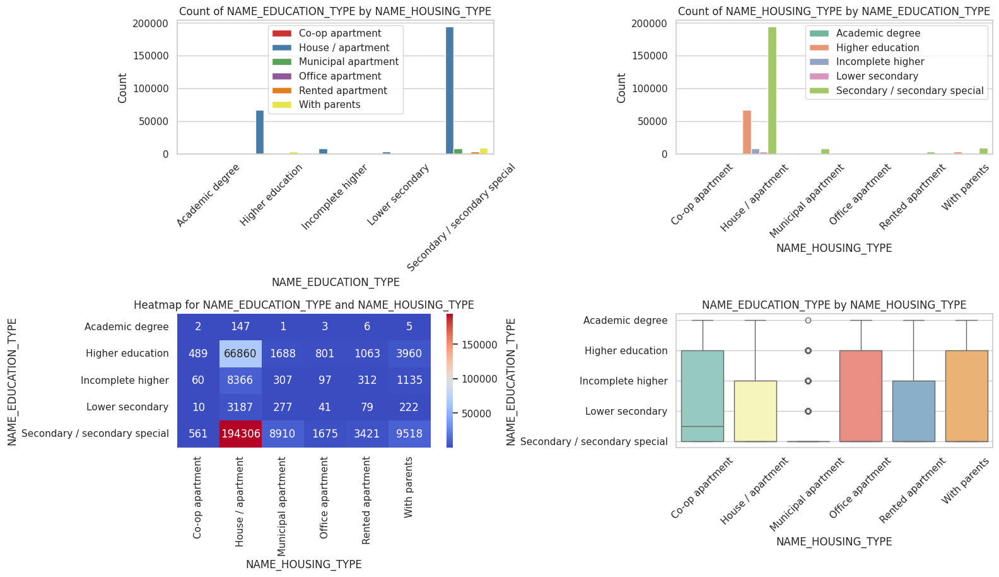

In [ ]:

compare_features_plot('NAME_EDUCATION_TYPE', 'NAME_HOUSING_TYPE')

**Inference**:
* Clients who have House/apartment mostly have secondary education and some may go till Higher education
* Clients who are having Co-op apartment have Higher Education


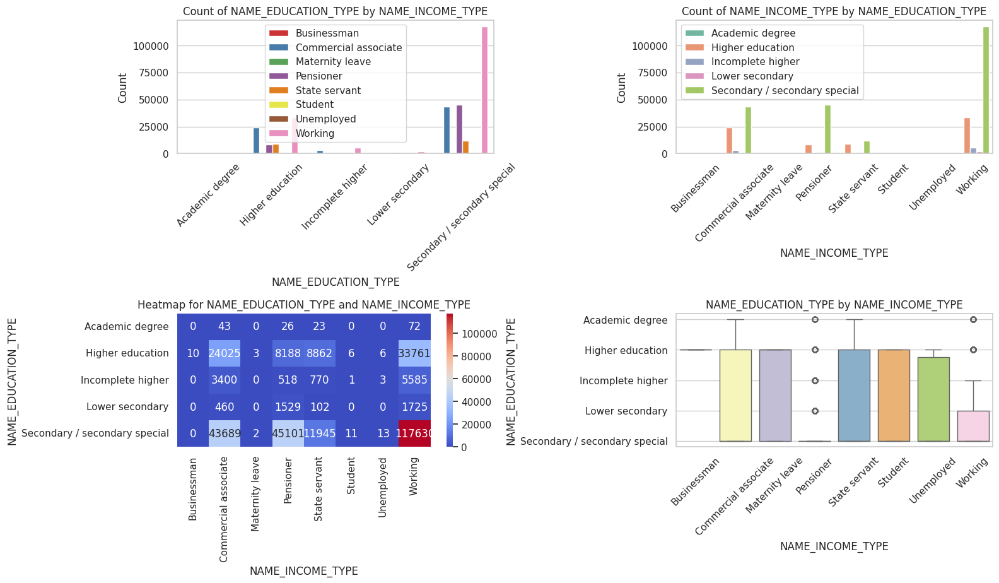

In [ ]:
compare_features_plot('NAME_EDUCATION_TYPE', 'NAME_INCOME_TYPE')

**Inference**:


*   All the Businessman are having Higher Education.
*   Most clients are from Working class who are mostly having Secondary Education.



**A. Numerical NOn Continuos COlumns**

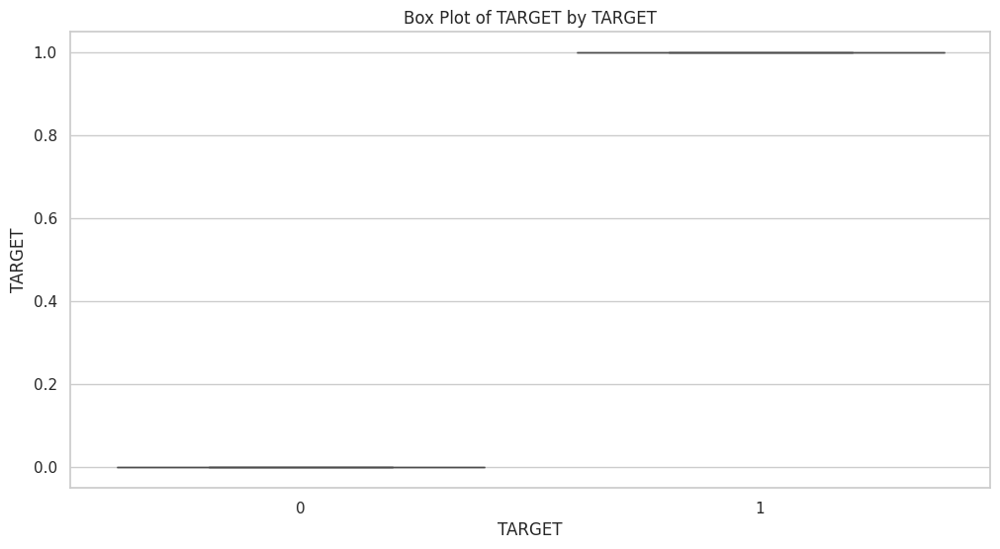

Box Plot Summary for TARGET by TARGET:

╒══════════╤═════════╤════════╤═══════╤═══════╤═══════╤═══════╤═══════╤═══════╕
│   TARGET │   count │   mean │   std │   min │   25% │   50% │   75% │   max │
╞══════════╪═════════╪════════╪═══════╪═══════╪═══════╪═══════╪═══════╪═══════╡
│        0 │  282684 │      0 │     0 │     0 │     0 │     0 │     0 │     0 │
├──────────┼─────────┼────────┼───────┼───────┼───────┼───────┼───────┼───────┤
│        1 │   24825 │      1 │     0 │     1 │     1 │     1 │     1 │     1 │
╘══════════╧═════════╧════════╧═══════╧═══════╧═══════╧═══════╧═══════╧═══════╛

--------------------------------------------------------------------------------



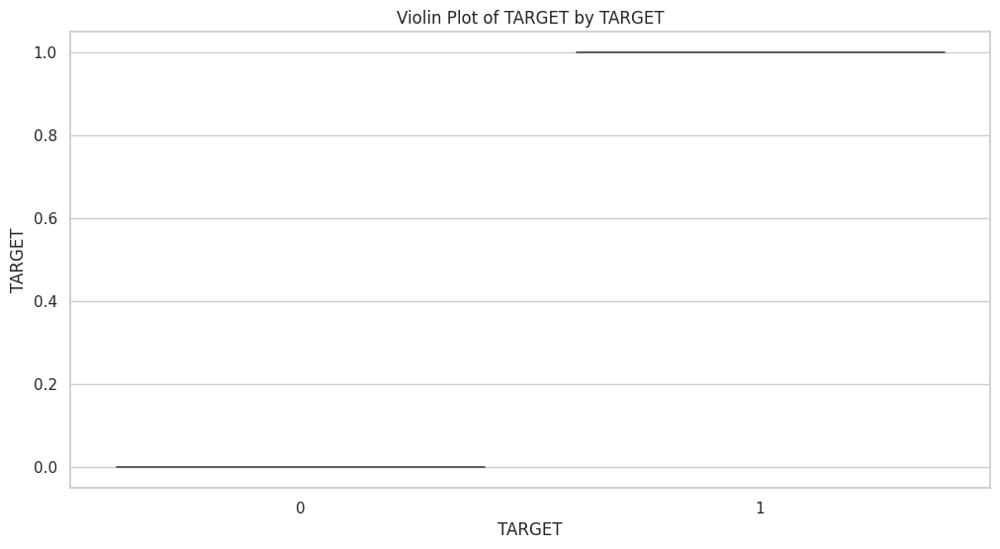

Violin Plot Summary for TARGET by TARGET:

╒══════════╤═════════╤════════╤═══════╤═══════╤═══════╤═══════╤═══════╤═══════╕
│   TARGET │   count │   mean │   std │   min │   25% │   50% │   75% │   max │
╞══════════╪═════════╪════════╪═══════╪═══════╪═══════╪═══════╪═══════╪═══════╡
│        0 │  282684 │      0 │     0 │     0 │     0 │     0 │     0 │     0 │
├──────────┼─────────┼────────┼───────┼───────┼───────┼───────┼───────┼───────┤
│        1 │   24825 │      1 │     0 │     1 │     1 │     1 │     1 │     1 │
╘══════════╧═════════╧════════╧═══════╧═══════╧═══════╧═══════╧═══════╧═══════╛

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------



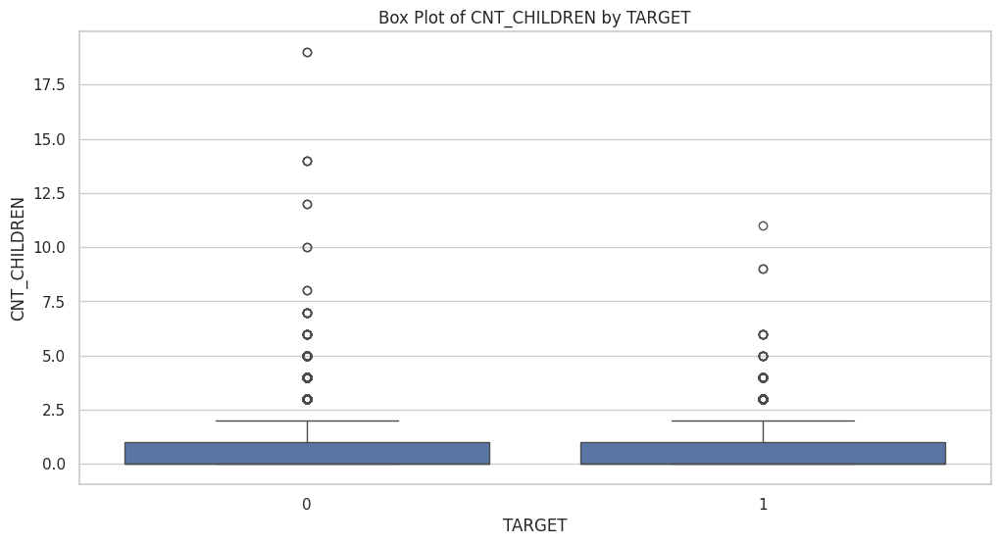

Box Plot Summary for CNT_CHILDREN by TARGET:

╒══════════╤═════════╤══════════╤══════════╤═══════╤═══════╤═══════╤═══════╤═══════╕
│   TARGET │   count │     mean │      std │   min │   25% │   50% │   75% │   max │
╞══════════╪═════════╪══════════╪══════════╪═══════╪═══════╪═══════╪═══════╪═══════╡
│        0 │  282684 │ 0.412945 │ 0.718844 │     0 │     0 │     0 │     1 │    19 │
├──────────┼─────────┼──────────┼──────────┼───────┼───────┼───────┼───────┼───────┤
│        1 │   24825 │ 0.463807 │ 0.756903 │     0 │     0 │     0 │     1 │    11 │
╘══════════╧═════════╧══════════╧══════════╧═══════╧═══════╧═══════╧═══════╧═══════╛

--------------------------------------------------------------------------------



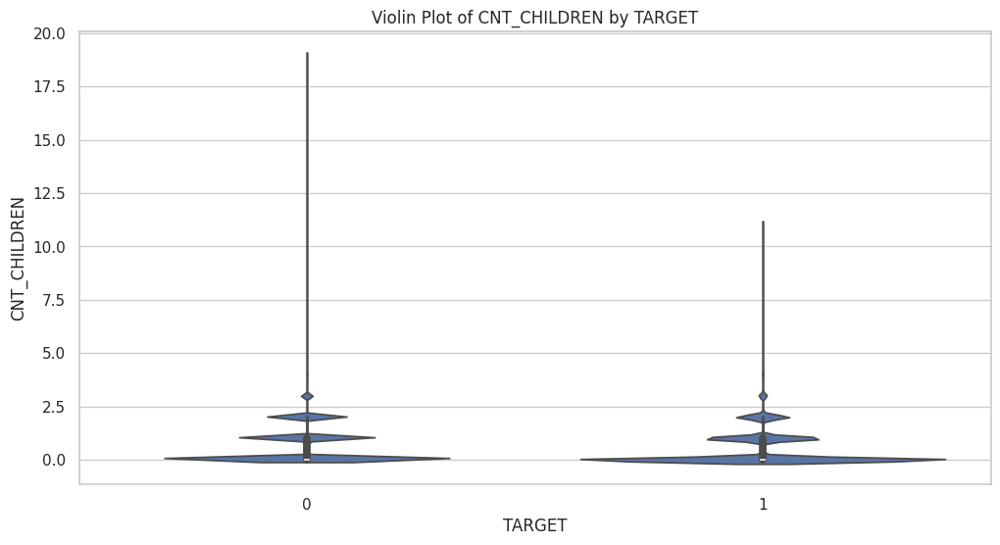

Violin Plot Summary for CNT_CHILDREN by TARGET:

╒══════════╤═════════╤══════════╤══════════╤═══════╤═══════╤═══════╤═══════╤═══════╕
│   TARGET │   count │     mean │      std │   min │   25% │   50% │   75% │   max │
╞══════════╪═════════╪══════════╪══════════╪═══════╪═══════╪═══════╪═══════╪═══════╡
│        0 │  282684 │ 0.412945 │ 0.718844 │     0 │     0 │     0 │     1 │    19 │
├──────────┼─────────┼──────────┼──────────┼───────┼───────┼───────┼───────┼───────┤
│        1 │   24825 │ 0.463807 │ 0.756903 │     0 │     0 │     0 │     1 │    11 │
╘══════════╧═════════╧══════════╧══════════╧═══════╧═══════╧═══════╧═══════╧═══════╛

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------



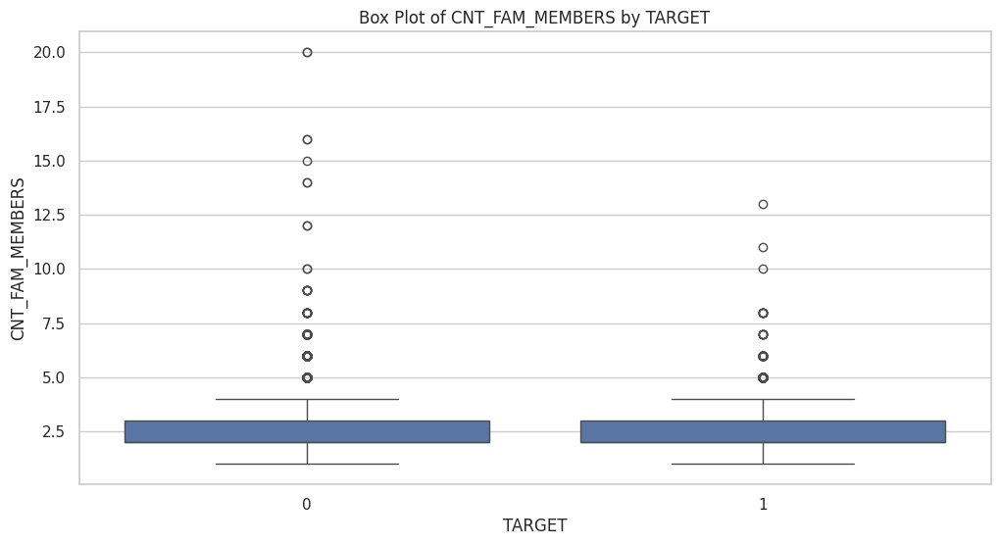

Box Plot Summary for CNT_FAM_MEMBERS by TARGET:

╒══════════╤═════════╤═════════╤══════════╤═══════╤═══════╤═══════╤═══════╤═══════╕
│   TARGET │   count │    mean │      std │   min │   25% │   50% │   75% │   max │
╞══════════╪═════════╪═════════╪══════════╪═══════╪═══════╪═══════╪═══════╪═══════╡
│        0 │  282684 │ 2.15015 │ 0.90698  │     1 │     2 │     2 │     3 │    20 │
├──────────┼─────────┼─────────┼──────────┼───────┼───────┼───────┼───────┼───────┤
│        1 │   24825 │ 2.18127 │ 0.951327 │     1 │     2 │     2 │     3 │    13 │
╘══════════╧═════════╧═════════╧══════════╧═══════╧═══════╧═══════╧═══════╧═══════╛

--------------------------------------------------------------------------------



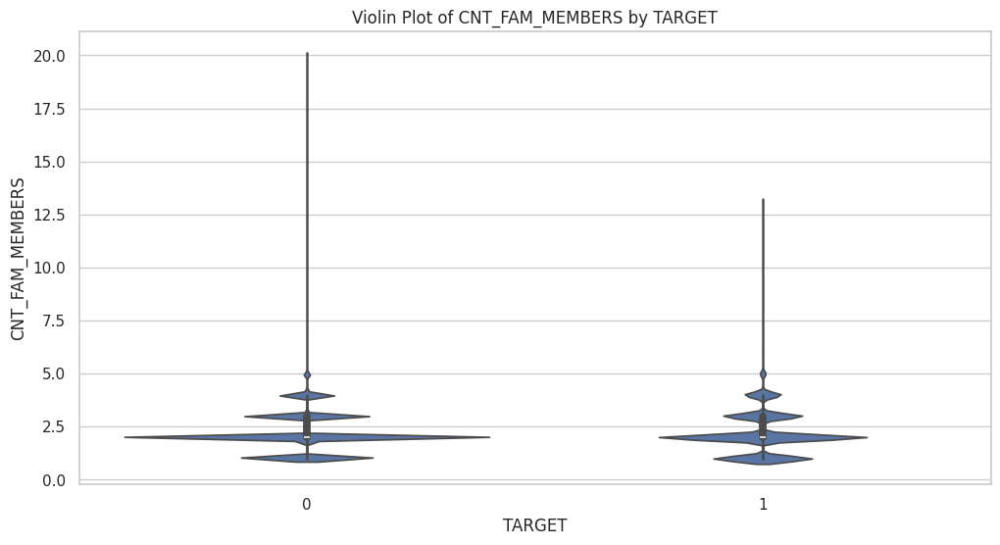

Violin Plot Summary for CNT_FAM_MEMBERS by TARGET:

╒══════════╤═════════╤═════════╤══════════╤═══════╤═══════╤═══════╤═══════╤═══════╕
│   TARGET │   count │    mean │      std │   min │   25% │   50% │   75% │   max │
╞══════════╪═════════╪═════════╪══════════╪═══════╪═══════╪═══════╪═══════╪═══════╡
│        0 │  282684 │ 2.15015 │ 0.90698  │     1 │     2 │     2 │     3 │    20 │
├──────────┼─────────┼─────────┼──────────┼───────┼───────┼───────┼───────┼───────┤
│        1 │   24825 │ 2.18127 │ 0.951327 │     1 │     2 │     2 │     3 │    13 │
╘══════════╧═════════╧═════════╧══════════╧═══════╧═══════╧═══════╧═══════╧═══════╛

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------



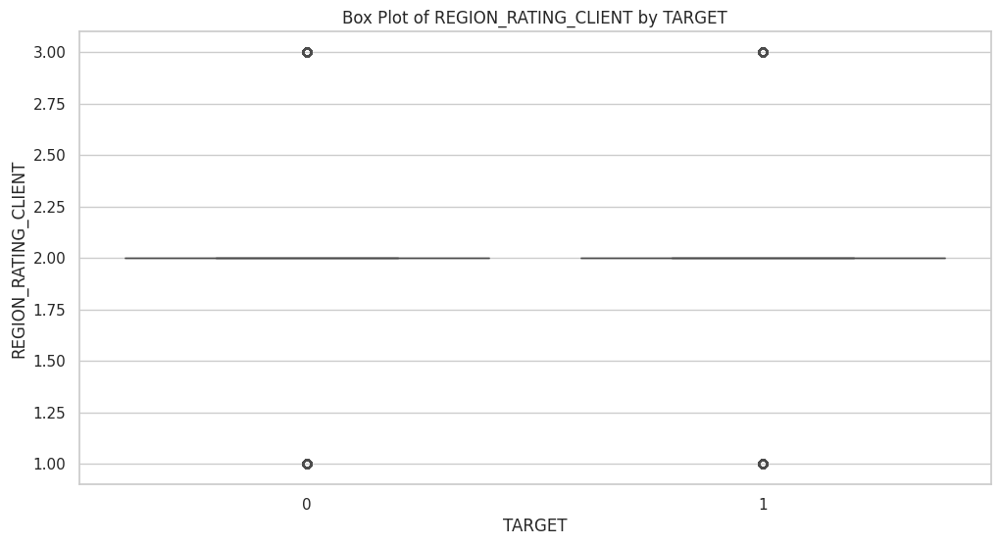

Box Plot Summary for REGION_RATING_CLIENT by TARGET:

╒══════════╤═════════╤═════════╤══════════╤═══════╤═══════╤═══════╤═══════╤═══════╕
│   TARGET │   count │    mean │      std │   min │   25% │   50% │   75% │   max │
╞══════════╪═════════╪═════════╪══════════╪═══════╪═══════╪═══════╪═══════╪═══════╡
│        0 │  282684 │ 2.04358 │ 0.508421 │     1 │     2 │     2 │     2 │     3 │
├──────────┼─────────┼─────────┼──────────┼───────┼───────┼───────┼───────┼───────┤
│        1 │   24825 │ 2.15364 │ 0.505052 │     1 │     2 │     2 │     2 │     3 │
╘══════════╧═════════╧═════════╧══════════╧═══════╧═══════╧═══════╧═══════╧═══════╛

--------------------------------------------------------------------------------



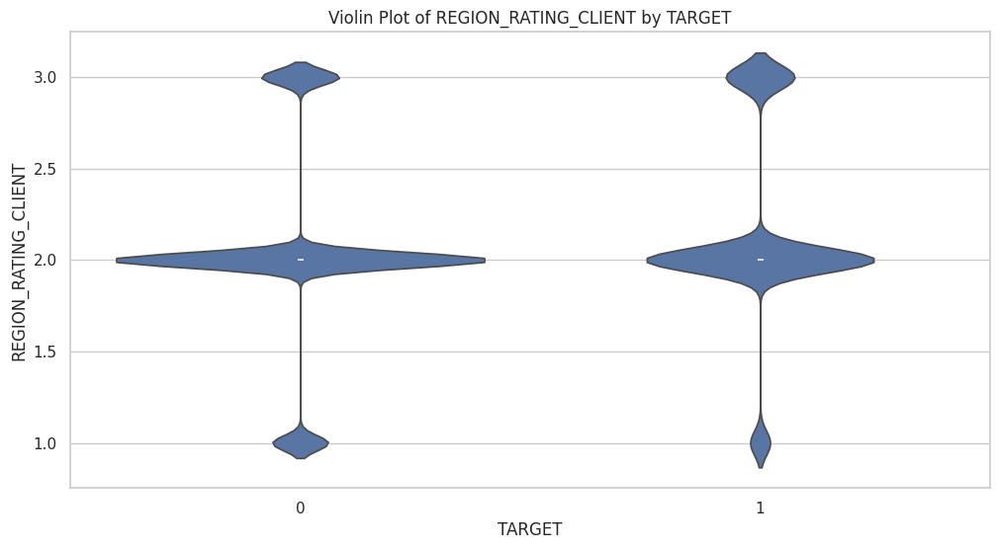

Violin Plot Summary for REGION_RATING_CLIENT by TARGET:

╒══════════╤═════════╤═════════╤══════════╤═══════╤═══════╤═══════╤═══════╤═══════╕
│   TARGET │   count │    mean │      std │   min │   25% │   50% │   75% │   max │
╞══════════╪═════════╪═════════╪══════════╪═══════╪═══════╪═══════╪═══════╪═══════╡
│        0 │  282684 │ 2.04358 │ 0.508421 │     1 │     2 │     2 │     2 │     3 │
├──────────┼─────────┼─────────┼──────────┼───────┼───────┼───────┼───────┼───────┤
│        1 │   24825 │ 2.15364 │ 0.505052 │     1 │     2 │     2 │     2 │     3 │
╘══════════╧═════════╧═════════╧══════════╧═══════╧═══════╧═══════╧═══════╧═══════╛

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------



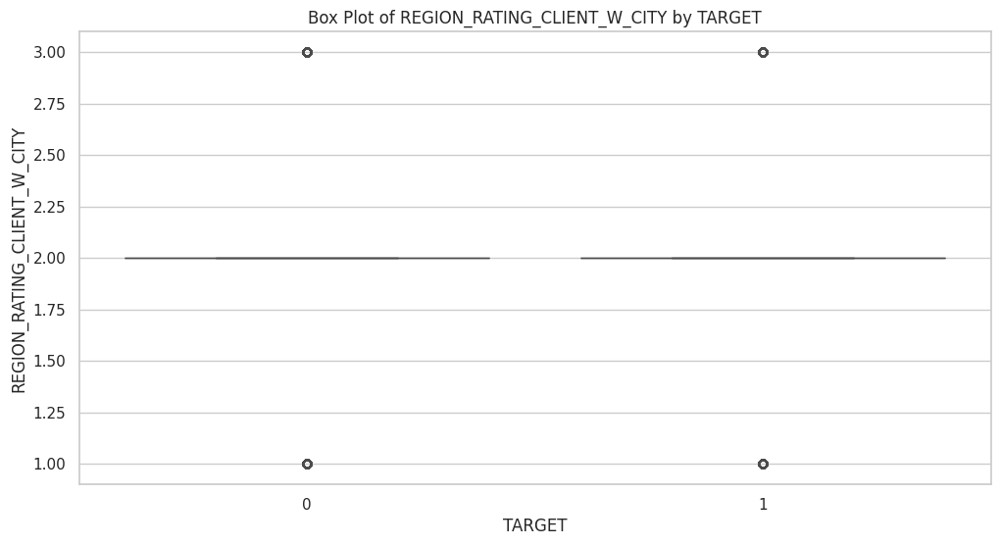

Box Plot Summary for REGION_RATING_CLIENT_W_CITY by TARGET:

╒══════════╤═════════╤═════════╤══════════╤═══════╤═══════╤═══════╤═══════╤═══════╕
│   TARGET │   count │    mean │      std │   min │   25% │   50% │   75% │   max │
╞══════════╪═════════╪═════════╪══════════╪═══════╪═══════╪═══════╪═══════╪═══════╡
│        0 │  282684 │ 2.02245 │ 0.501969 │     1 │     2 │     2 │     2 │     3 │
├──────────┼─────────┼─────────┼──────────┼───────┼───────┼───────┼───────┼───────┤
│        1 │   24825 │ 2.13482 │ 0.499909 │     1 │     2 │     2 │     2 │     3 │
╘══════════╧═════════╧═════════╧══════════╧═══════╧═══════╧═══════╧═══════╧═══════╛

--------------------------------------------------------------------------------



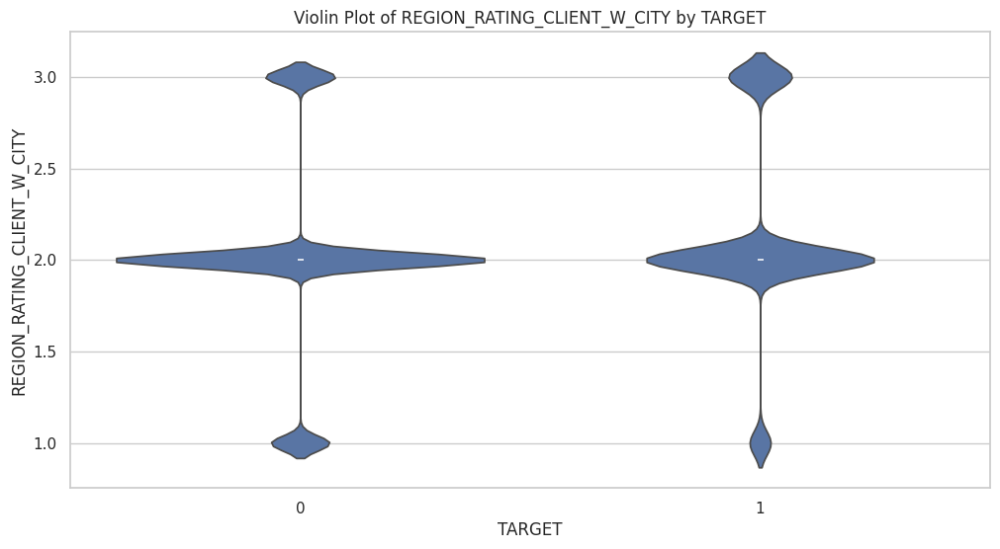

Violin Plot Summary for REGION_RATING_CLIENT_W_CITY by TARGET:

╒══════════╤═════════╤═════════╤══════════╤═══════╤═══════╤═══════╤═══════╤═══════╕
│   TARGET │   count │    mean │      std │   min │   25% │   50% │   75% │   max │
╞══════════╪═════════╪═════════╪══════════╪═══════╪═══════╪═══════╪═══════╪═══════╡
│        0 │  282684 │ 2.02245 │ 0.501969 │     1 │     2 │     2 │     2 │     3 │
├──────────┼─────────┼─────────┼──────────┼───────┼───────┼───────┼───────┼───────┤
│        1 │   24825 │ 2.13482 │ 0.499909 │     1 │     2 │     2 │     2 │     3 │
╘══════════╧═════════╧═════════╧══════════╧═══════╧═══════╧═══════╧═══════╧═══════╛

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------



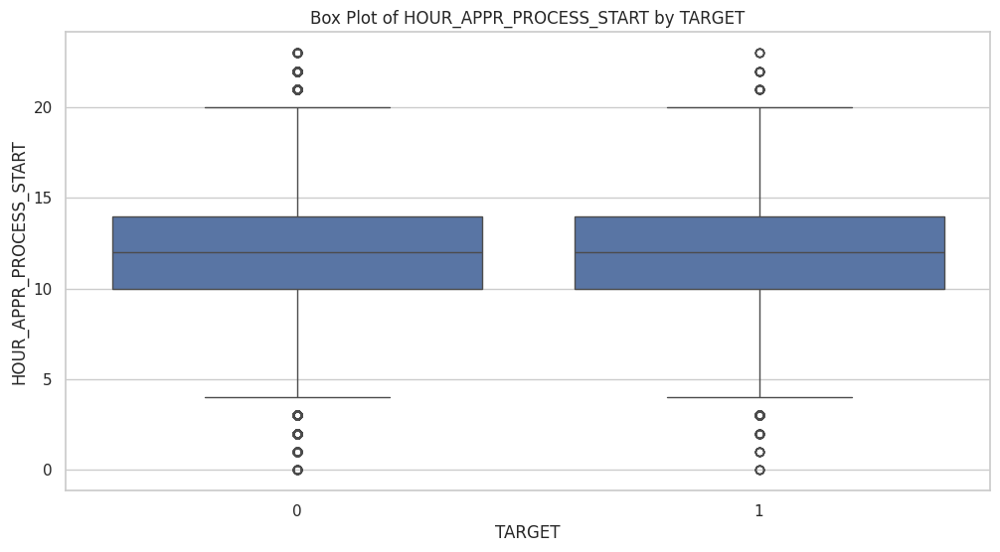

Box Plot Summary for HOUR_APPR_PROCESS_START by TARGET:

╒══════════╤═════════╤═════════╤═════════╤═══════╤═══════╤═══════╤═══════╤═══════╕
│   TARGET │   count │    mean │     std │   min │   25% │   50% │   75% │   max │
╞══════════╪═════════╪═════════╪═════════╪═══════╪═══════╪═══════╪═══════╪═══════╡
│        0 │  282684 │ 12.0868 │ 3.26315 │     0 │    10 │    12 │    14 │    23 │
├──────────┼─────────┼─────────┼─────────┼───────┼───────┼───────┼───────┼───────┤
│        1 │   24825 │ 11.7971 │ 3.2843  │     0 │    10 │    12 │    14 │    23 │
╘══════════╧═════════╧═════════╧═════════╧═══════╧═══════╧═══════╧═══════╧═══════╛

--------------------------------------------------------------------------------



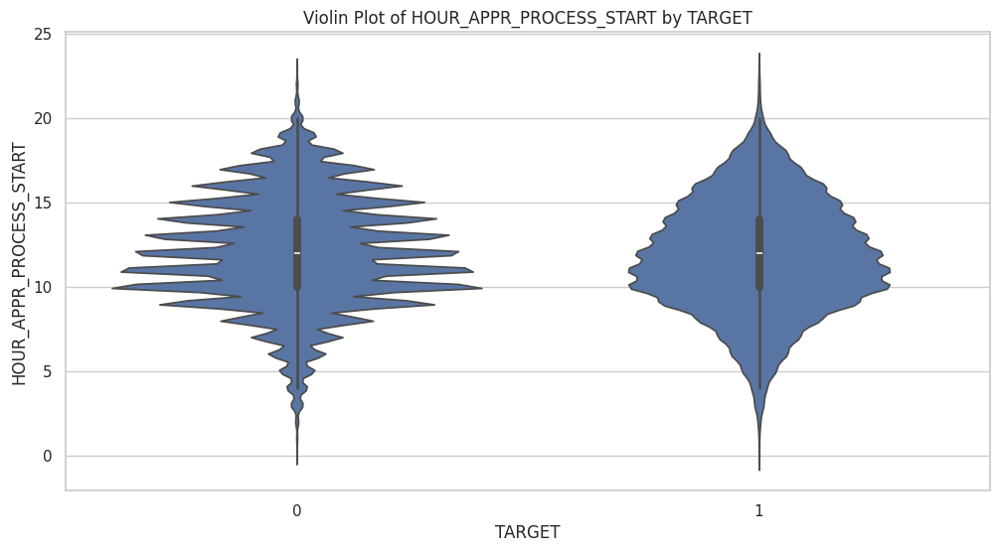

Violin Plot Summary for HOUR_APPR_PROCESS_START by TARGET:

╒══════════╤═════════╤═════════╤═════════╤═══════╤═══════╤═══════╤═══════╤═══════╕
│   TARGET │   count │    mean │     std │   min │   25% │   50% │   75% │   max │
╞══════════╪═════════╪═════════╪═════════╪═══════╪═══════╪═══════╪═══════╪═══════╡
│        0 │  282684 │ 12.0868 │ 3.26315 │     0 │    10 │    12 │    14 │    23 │
├──────────┼─────────┼─────────┼─────────┼───────┼───────┼───────┼───────┼───────┤
│        1 │   24825 │ 11.7971 │ 3.2843  │     0 │    10 │    12 │    14 │    23 │
╘══════════╧═════════╧═════════╧═════════╧═══════╧═══════╧═══════╧═══════╧═══════╛

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------



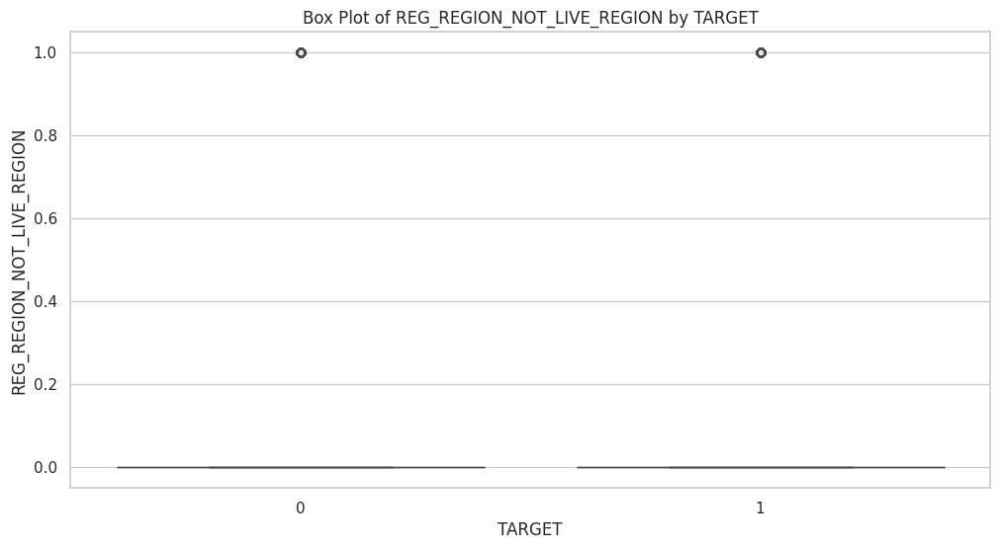

Box Plot Summary for REG_REGION_NOT_LIVE_REGION by TARGET:

╒══════════╤═════════╤═══════════╤══════════╤═══════╤═══════╤═══════╤═══════╤═══════╕
│   TARGET │   count │      mean │      std │   min │   25% │   50% │   75% │   max │
╞══════════╪═════════╪═══════════╪══════════╪═══════╪═══════╪═══════╪═══════╪═══════╡
│        0 │  282684 │ 0.0149425 │ 0.121323 │     0 │     0 │     0 │     0 │     1 │
├──────────┼─────────┼───────────┼──────────┼───────┼───────┼───────┼───────┼───────┤
│        1 │   24825 │ 0.0174421 │ 0.130914 │     0 │     0 │     0 │     0 │     1 │
╘══════════╧═════════╧═══════════╧══════════╧═══════╧═══════╧═══════╧═══════╧═══════╛

--------------------------------------------------------------------------------



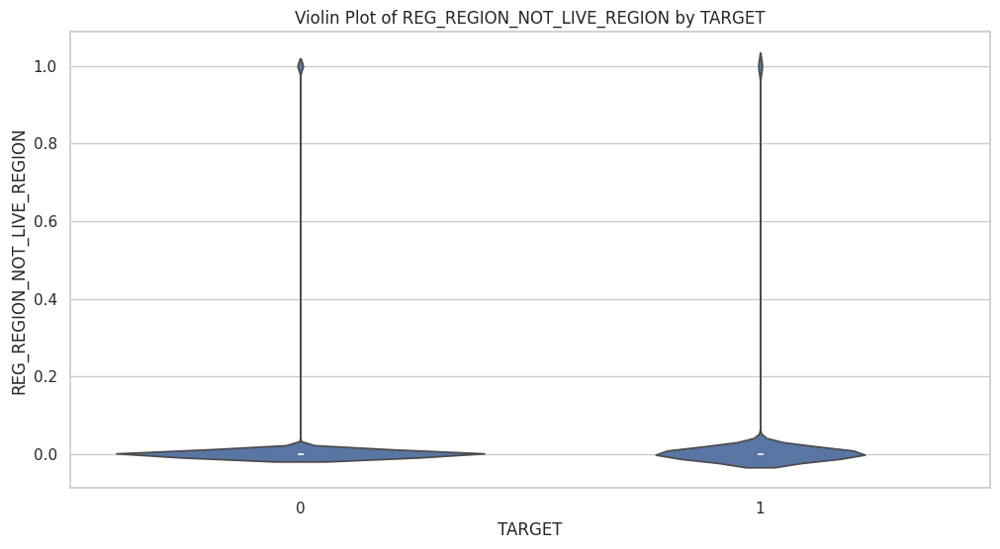

Violin Plot Summary for REG_REGION_NOT_LIVE_REGION by TARGET:

╒══════════╤═════════╤═══════════╤══════════╤═══════╤═══════╤═══════╤═══════╤═══════╕
│   TARGET │   count │      mean │      std │   min │   25% │   50% │   75% │   max │
╞══════════╪═════════╪═══════════╪══════════╪═══════╪═══════╪═══════╪═══════╪═══════╡
│        0 │  282684 │ 0.0149425 │ 0.121323 │     0 │     0 │     0 │     0 │     1 │
├──────────┼─────────┼───────────┼──────────┼───────┼───────┼───────┼───────┼───────┤
│        1 │   24825 │ 0.0174421 │ 0.130914 │     0 │     0 │     0 │     0 │     1 │
╘══════════╧═════════╧═══════════╧══════════╧═══════╧═══════╧═══════╧═══════╧═══════╛

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------



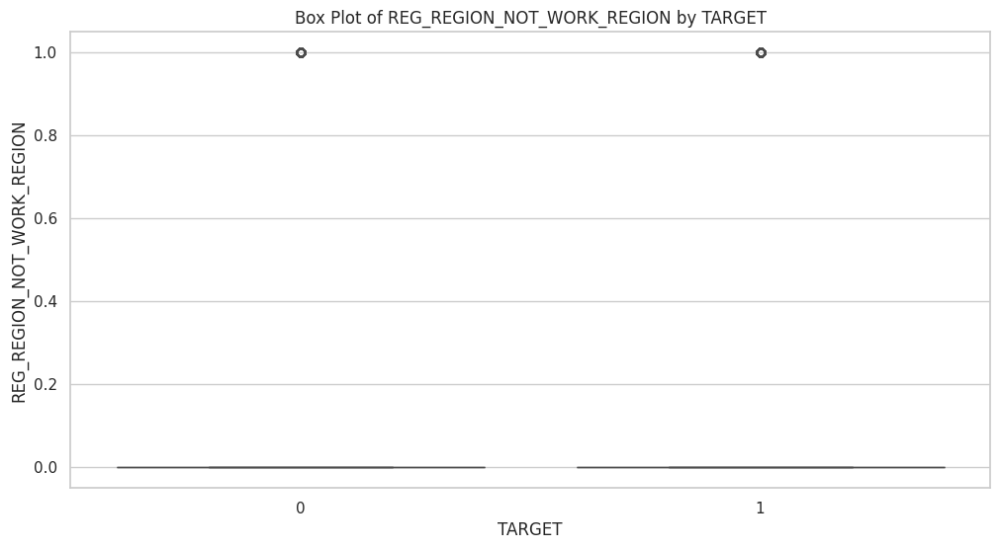

Box Plot Summary for REG_REGION_NOT_WORK_REGION by TARGET:

╒══════════╤═════════╤═══════════╤══════════╤═══════╤═══════╤═══════╤═══════╤═══════╕
│   TARGET │   count │      mean │      std │   min │   25% │   50% │   75% │   max │
╞══════════╪═════════╪═══════════╪══════════╪═══════╪═══════╪═══════╪═══════╪═══════╡
│        0 │  282684 │ 0.0503177 │ 0.2186   │     0 │     0 │     0 │     0 │     1 │
├──────────┼─────────┼───────────┼──────────┼───────┼───────┼───────┼───────┼───────┤
│        1 │   24825 │ 0.0559114 │ 0.229755 │     0 │     0 │     0 │     0 │     1 │
╘══════════╧═════════╧═══════════╧══════════╧═══════╧═══════╧═══════╧═══════╧═══════╛

--------------------------------------------------------------------------------



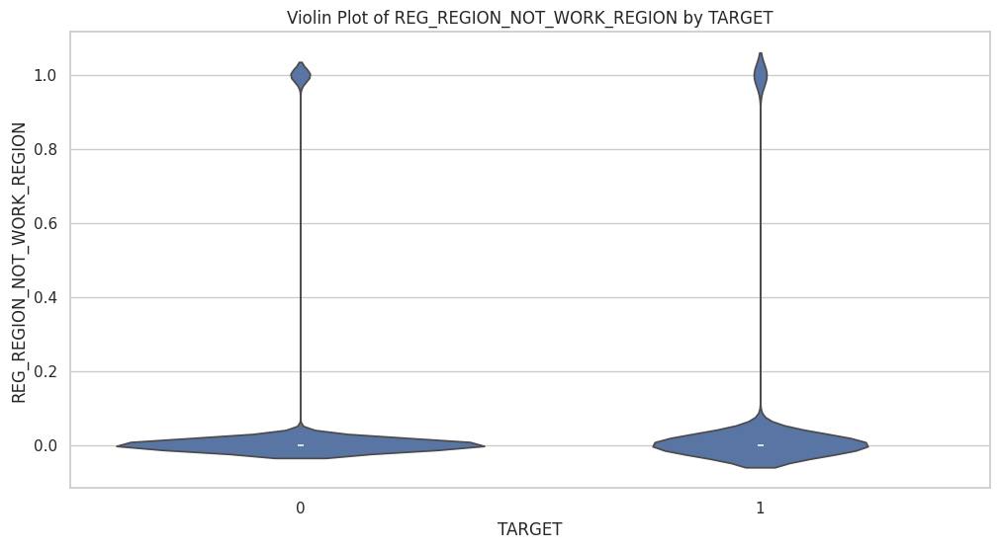

Violin Plot Summary for REG_REGION_NOT_WORK_REGION by TARGET:

╒══════════╤═════════╤═══════════╤══════════╤═══════╤═══════╤═══════╤═══════╤═══════╕
│   TARGET │   count │      mean │      std │   min │   25% │   50% │   75% │   max │
╞══════════╪═════════╪═══════════╪══════════╪═══════╪═══════╪═══════╪═══════╪═══════╡
│        0 │  282684 │ 0.0503177 │ 0.2186   │     0 │     0 │     0 │     0 │     1 │
├──────────┼─────────┼───────────┼──────────┼───────┼───────┼───────┼───────┼───────┤
│        1 │   24825 │ 0.0559114 │ 0.229755 │     0 │     0 │     0 │     0 │     1 │
╘══════════╧═════════╧═══════════╧══════════╧═══════╧═══════╧═══════╧═══════╧═══════╛

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------



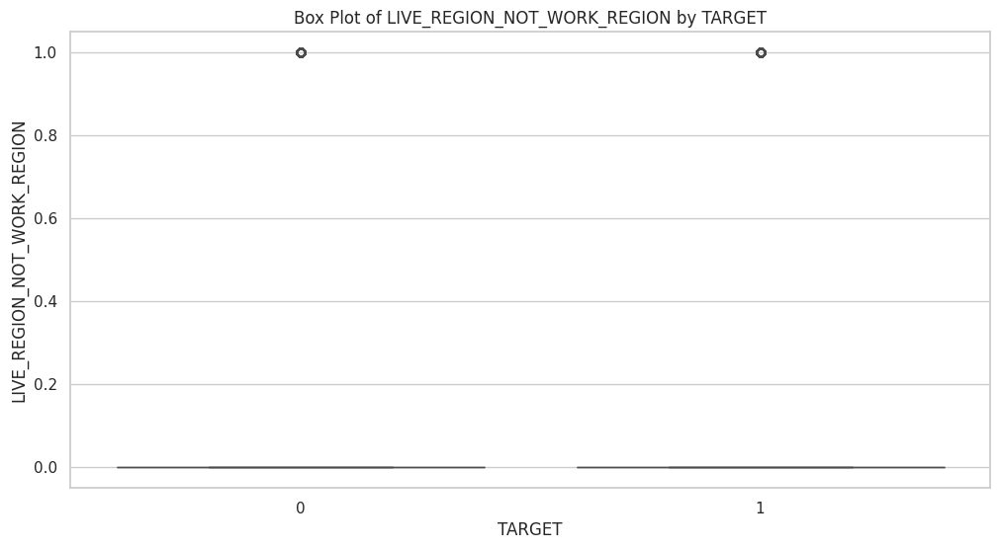

Box Plot Summary for LIVE_REGION_NOT_WORK_REGION by TARGET:

╒══════════╤═════════╤═══════════╤══════════╤═══════╤═══════╤═══════╤═══════╤═══════╕
│   TARGET │   count │      mean │      std │   min │   25% │   50% │   75% │   max │
╞══════════╪═════════╪═══════════╪══════════╪═══════╪═══════╪═══════╪═══════╪═══════╡
│        0 │  282684 │ 0.040494  │ 0.197115 │     0 │     0 │     0 │     0 │     1 │
├──────────┼─────────┼───────────┼──────────┼───────┼───────┼───────┼───────┼───────┤
│        1 │   24825 │ 0.0425378 │ 0.201817 │     0 │     0 │     0 │     0 │     1 │
╘══════════╧═════════╧═══════════╧══════════╧═══════╧═══════╧═══════╧═══════╧═══════╛

--------------------------------------------------------------------------------



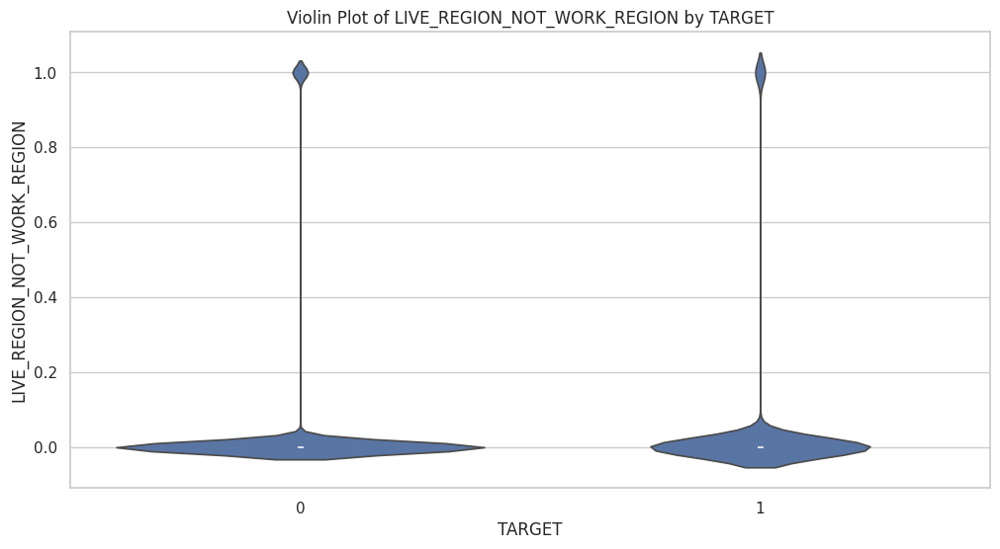

Violin Plot Summary for LIVE_REGION_NOT_WORK_REGION by TARGET:

╒══════════╤═════════╤═══════════╤══════════╤═══════╤═══════╤═══════╤═══════╤═══════╕
│   TARGET │   count │      mean │      std │   min │   25% │   50% │   75% │   max │
╞══════════╪═════════╪═══════════╪══════════╪═══════╪═══════╪═══════╪═══════╪═══════╡
│        0 │  282684 │ 0.040494  │ 0.197115 │     0 │     0 │     0 │     0 │     1 │
├──────────┼─────────┼───────────┼──────────┼───────┼───────┼───────┼───────┼───────┤
│        1 │   24825 │ 0.0425378 │ 0.201817 │     0 │     0 │     0 │     0 │     1 │
╘══════════╧═════════╧═══════════╧══════════╧═══════╧═══════╧═══════╧═══════╧═══════╛

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------



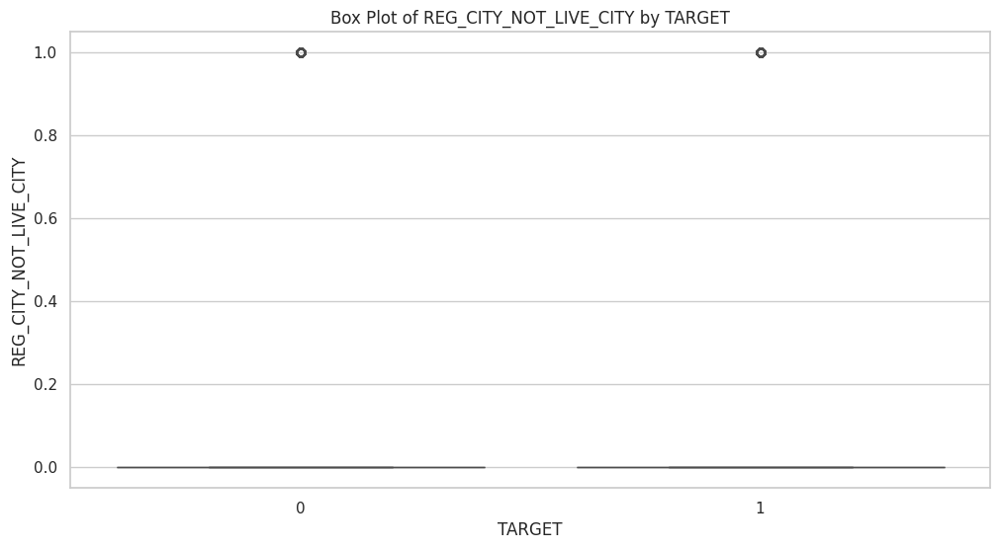

Box Plot Summary for REG_CITY_NOT_LIVE_CITY by TARGET:

╒══════════╤═════════╤═══════════╤══════════╤═══════╤═══════╤═══════╤═══════╤═══════╕
│   TARGET │   count │      mean │      std │   min │   25% │   50% │   75% │   max │
╞══════════╪═════════╪═══════════╪══════════╪═══════╪═══════╪═══════╪═══════╪═══════╡
│        0 │  282684 │ 0.0746416 │ 0.262813 │     0 │     0 │     0 │     0 │     1 │
├──────────┼─────────┼───────────┼──────────┼───────┼───────┼───────┼───────┼───────┤
│        1 │   24825 │ 0.118389  │ 0.323074 │     0 │     0 │     0 │     0 │     1 │
╘══════════╧═════════╧═══════════╧══════════╧═══════╧═══════╧═══════╧═══════╧═══════╛

--------------------------------------------------------------------------------



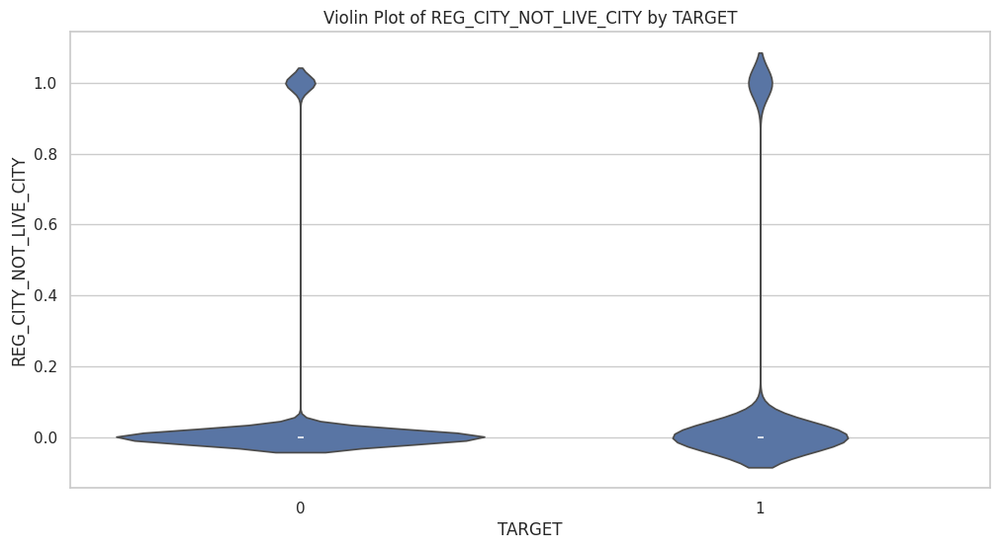

Violin Plot Summary for REG_CITY_NOT_LIVE_CITY by TARGET:

╒══════════╤═════════╤═══════════╤══════════╤═══════╤═══════╤═══════╤═══════╤═══════╕
│   TARGET │   count │      mean │      std │   min │   25% │   50% │   75% │   max │
╞══════════╪═════════╪═══════════╪══════════╪═══════╪═══════╪═══════╪═══════╪═══════╡
│        0 │  282684 │ 0.0746416 │ 0.262813 │     0 │     0 │     0 │     0 │     1 │
├──────────┼─────────┼───────────┼──────────┼───────┼───────┼───────┼───────┼───────┤
│        1 │   24825 │ 0.118389  │ 0.323074 │     0 │     0 │     0 │     0 │     1 │
╘══════════╧═════════╧═══════════╧══════════╧═══════╧═══════╧═══════╧═══════╧═══════╛

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------



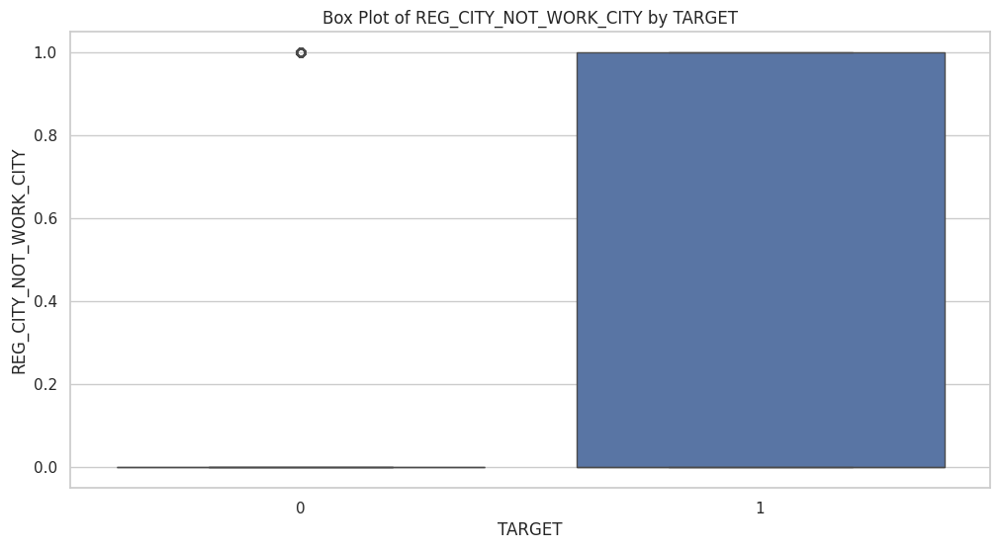

Box Plot Summary for REG_CITY_NOT_WORK_CITY by TARGET:

╒══════════╤═════════╤══════════╤══════════╤═══════╤═══════╤═══════╤═══════╤═══════╕
│   TARGET │   count │     mean │      std │   min │   25% │   50% │   75% │   max │
╞══════════╪═════════╪══════════╪══════════╪═══════╪═══════╪═══════╪═══════╪═══════╡
│        0 │  282684 │ 0.224088 │ 0.416981 │     0 │     0 │     0 │     0 │     1 │
├──────────┼─────────┼──────────┼──────────┼───────┼───────┼───────┼───────┼───────┤
│        1 │   24825 │ 0.30292  │ 0.45953  │     0 │     0 │     0 │     1 │     1 │
╘══════════╧═════════╧══════════╧══════════╧═══════╧═══════╧═══════╧═══════╧═══════╛

--------------------------------------------------------------------------------



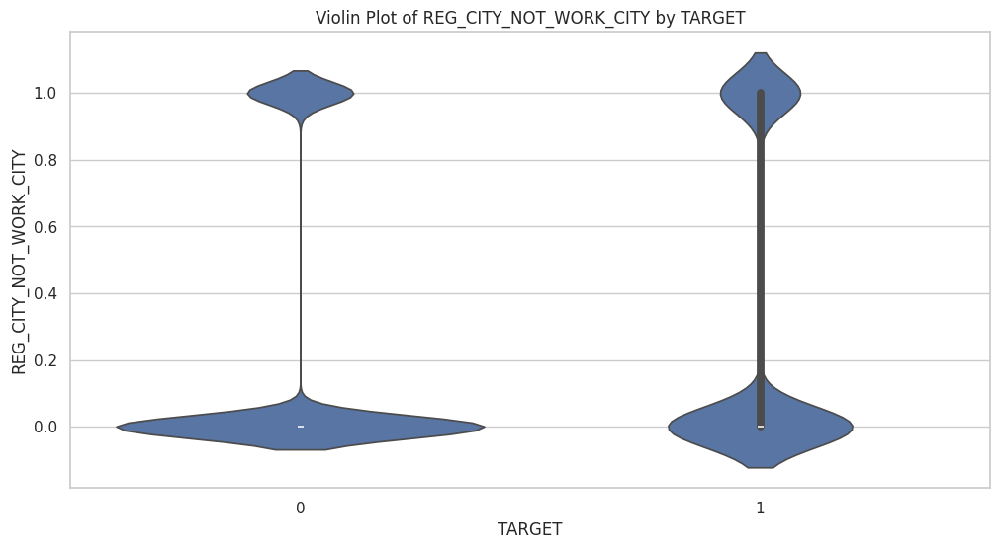

Violin Plot Summary for REG_CITY_NOT_WORK_CITY by TARGET:

╒══════════╤═════════╤══════════╤══════════╤═══════╤═══════╤═══════╤═══════╤═══════╕
│   TARGET │   count │     mean │      std │   min │   25% │   50% │   75% │   max │
╞══════════╪═════════╪══════════╪══════════╪═══════╪═══════╪═══════╪═══════╪═══════╡
│        0 │  282684 │ 0.224088 │ 0.416981 │     0 │     0 │     0 │     0 │     1 │
├──────────┼─────────┼──────────┼──────────┼───────┼───────┼───────┼───────┼───────┤
│        1 │   24825 │ 0.30292  │ 0.45953  │     0 │     0 │     0 │     1 │     1 │
╘══════════╧═════════╧══════════╧══════════╧═══════╧═══════╧═══════╧═══════╧═══════╛

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------



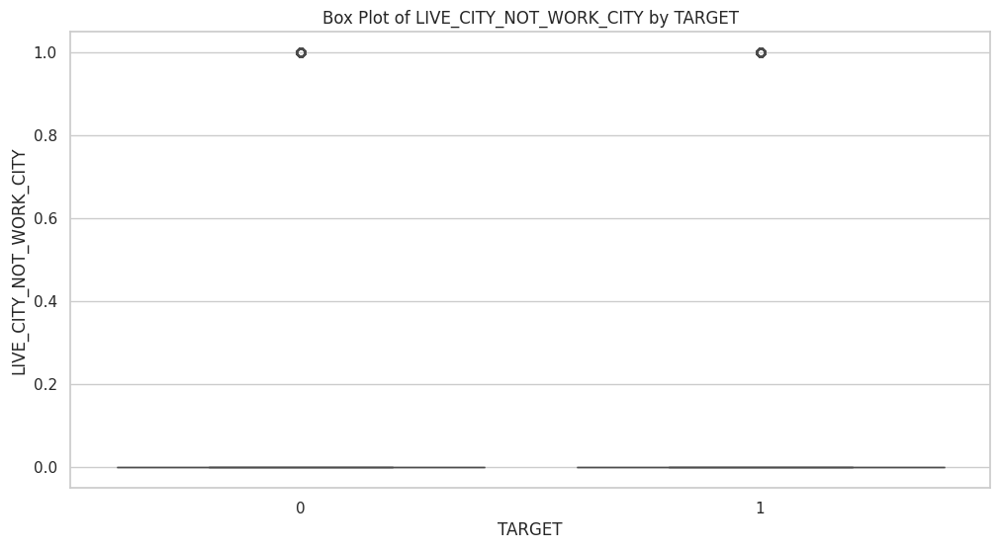

Box Plot Summary for LIVE_CITY_NOT_WORK_CITY by TARGET:

╒══════════╤═════════╤══════════╤══════════╤═══════╤═══════╤═══════╤═══════╤═══════╕
│   TARGET │   count │     mean │      std │   min │   25% │   50% │   75% │   max │
╞══════════╪═════════╪══════════╪══════════╪═══════╪═══════╪═══════╪═══════╪═══════╡
│        0 │  282684 │ 0.175854 │ 0.380696 │     0 │     0 │     0 │     0 │     1 │
├──────────┼─────────┼──────────┼──────────┼───────┼───────┼───────┼───────┼───────┤
│        1 │   24825 │ 0.221672 │ 0.41538  │     0 │     0 │     0 │     0 │     1 │
╘══════════╧═════════╧══════════╧══════════╧═══════╧═══════╧═══════╧═══════╧═══════╛

--------------------------------------------------------------------------------



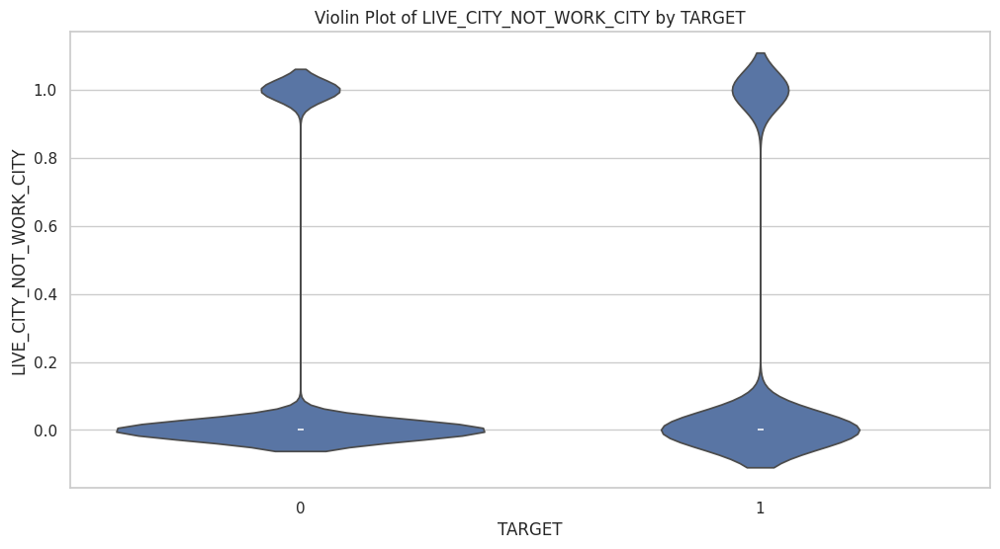

Violin Plot Summary for LIVE_CITY_NOT_WORK_CITY by TARGET:

╒══════════╤═════════╤══════════╤══════════╤═══════╤═══════╤═══════╤═══════╤═══════╕
│   TARGET │   count │     mean │      std │   min │   25% │   50% │   75% │   max │
╞══════════╪═════════╪══════════╪══════════╪═══════╪═══════╪═══════╪═══════╪═══════╡
│        0 │  282684 │ 0.175854 │ 0.380696 │     0 │     0 │     0 │     0 │     1 │
├──────────┼─────────┼──────────┼──────────┼───────┼───────┼───────┼───────┼───────┤
│        1 │   24825 │ 0.221672 │ 0.41538  │     0 │     0 │     0 │     0 │     1 │
╘══════════╧═════════╧══════════╧══════════╧═══════╧═══════╧═══════╧═══════╧═══════╛

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------



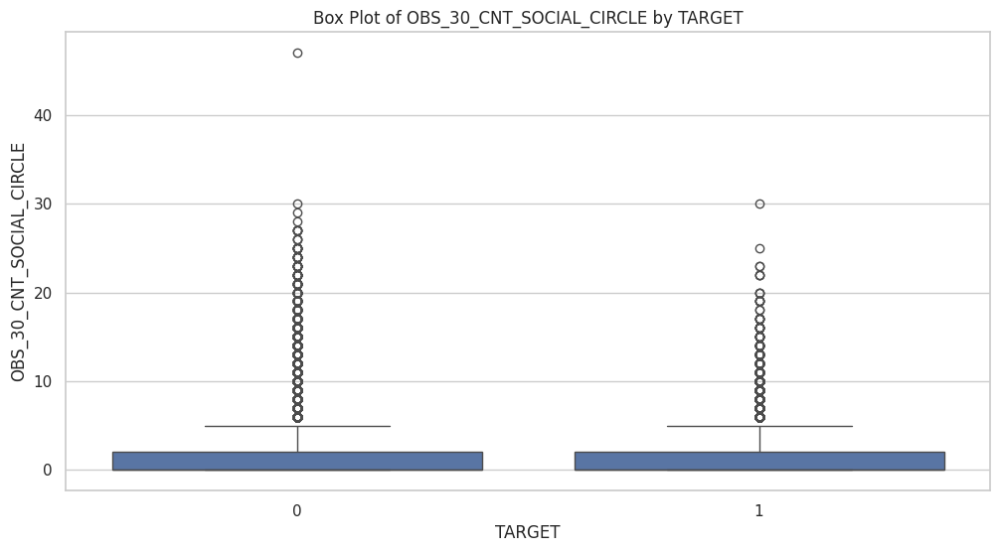

Box Plot Summary for OBS_30_CNT_SOCIAL_CIRCLE by TARGET:

╒══════════╤═════════╤═════════╤═════════╤═══════╤═══════╤═══════╤═══════╤═══════╕
│   TARGET │   count │    mean │     std │   min │   25% │   50% │   75% │   max │
╞══════════╪═════════╪═════════╪═════════╪═══════╪═══════╪═══════╪═══════╪═══════╡
│        0 │  282684 │ 1.40958 │ 2.3099  │     0 │     0 │     0 │     2 │    47 │
├──────────┼─────────┼─────────┼─────────┼───────┼───────┼───────┼───────┼───────┤
│        1 │   24825 │ 1.49398 │ 2.37739 │     0 │     0 │     0 │     2 │    30 │
╘══════════╧═════════╧═════════╧═════════╧═══════╧═══════╧═══════╧═══════╧═══════╛

--------------------------------------------------------------------------------



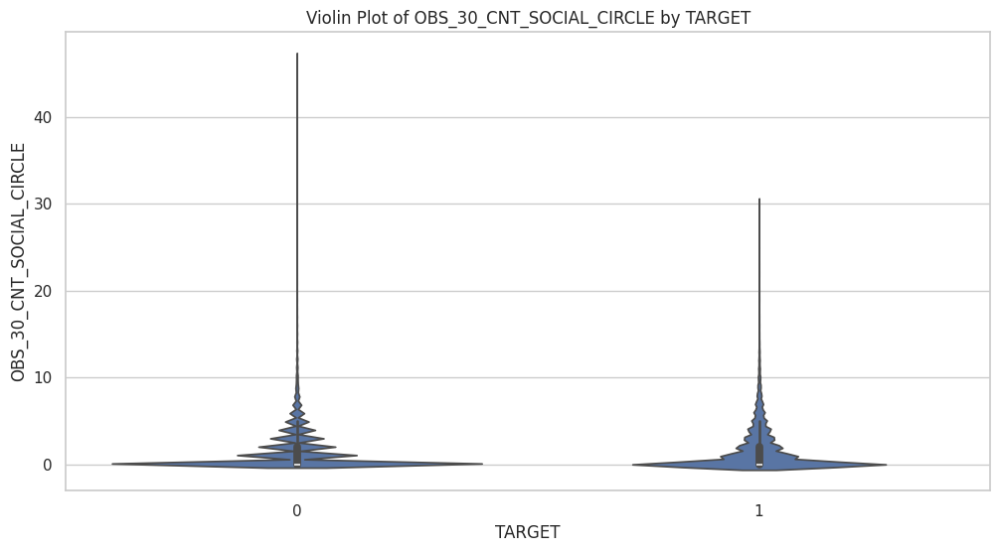

Violin Plot Summary for OBS_30_CNT_SOCIAL_CIRCLE by TARGET:

╒══════════╤═════════╤═════════╤═════════╤═══════╤═══════╤═══════╤═══════╤═══════╕
│   TARGET │   count │    mean │     std │   min │   25% │   50% │   75% │   max │
╞══════════╪═════════╪═════════╪═════════╪═══════╪═══════╪═══════╪═══════╪═══════╡
│        0 │  282684 │ 1.40958 │ 2.3099  │     0 │     0 │     0 │     2 │    47 │
├──────────┼─────────┼─────────┼─────────┼───────┼───────┼───────┼───────┼───────┤
│        1 │   24825 │ 1.49398 │ 2.37739 │     0 │     0 │     0 │     2 │    30 │
╘══════════╧═════════╧═════════╧═════════╧═══════╧═══════╧═══════╧═══════╧═══════╛

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------



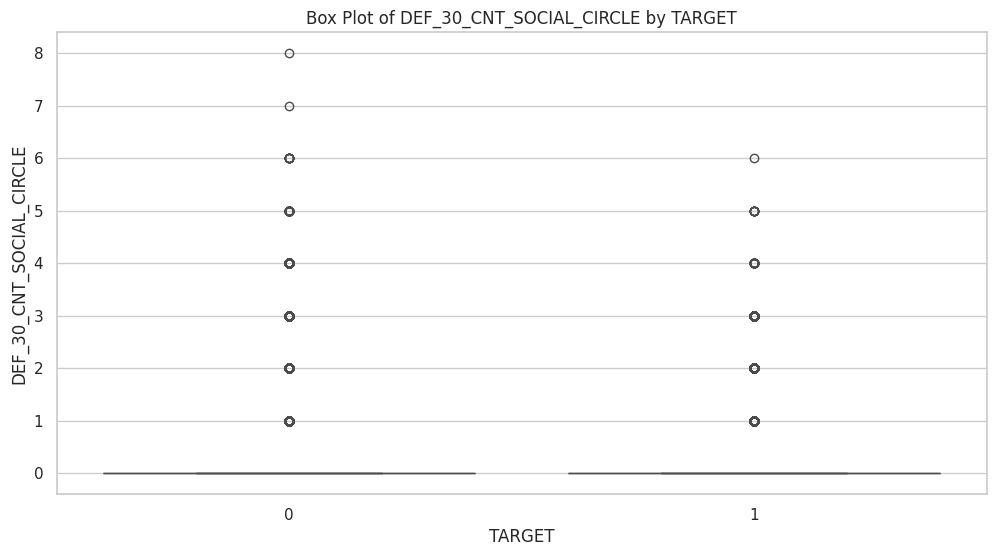

Box Plot Summary for DEF_30_CNT_SOCIAL_CIRCLE by TARGET:

╒══════════╤═════════╤══════════╤══════════╤═══════╤═══════╤═══════╤═══════╤═══════╕
│   TARGET │   count │     mean │      std │   min │   25% │   50% │   75% │   max │
╞══════════╪═════════╪══════════╪══════════╪═══════╪═══════╪═══════╪═══════╪═══════╡
│        0 │  282684 │ 0.138543 │ 0.434436 │     0 │     0 │     0 │     0 │     8 │
├──────────┼─────────┼──────────┼──────────┼───────┼───────┼───────┼───────┼───────┤
│        1 │   24825 │ 0.191702 │ 0.516201 │     0 │     0 │     0 │     0 │     6 │
╘══════════╧═════════╧══════════╧══════════╧═══════╧═══════╧═══════╧═══════╧═══════╛

--------------------------------------------------------------------------------



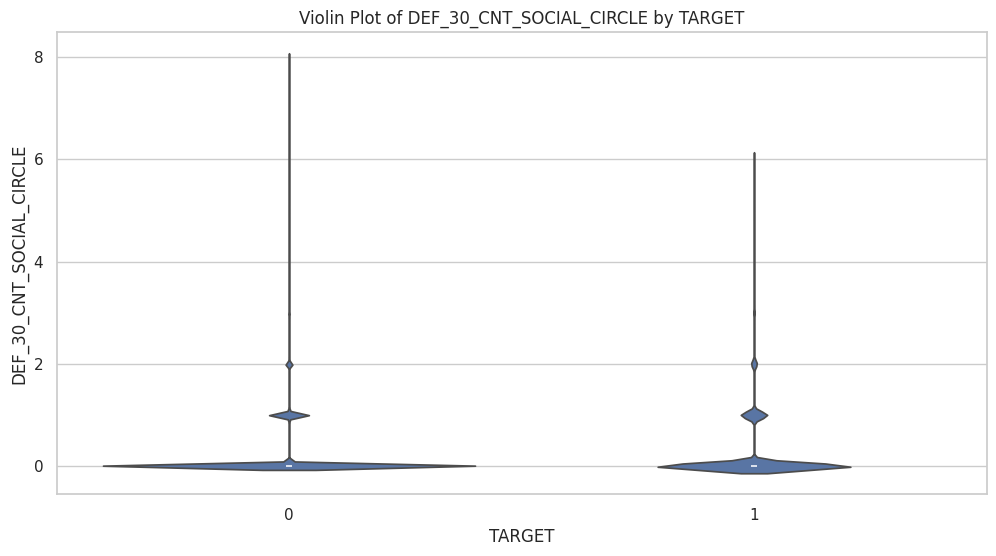

Violin Plot Summary for DEF_30_CNT_SOCIAL_CIRCLE by TARGET:

╒══════════╤═════════╤══════════╤══════════╤═══════╤═══════╤═══════╤═══════╤═══════╕
│   TARGET │   count │     mean │      std │   min │   25% │   50% │   75% │   max │
╞══════════╪═════════╪══════════╪══════════╪═══════╪═══════╪═══════╪═══════╪═══════╡
│        0 │  282684 │ 0.138543 │ 0.434436 │     0 │     0 │     0 │     0 │     8 │
├──────────┼─────────┼──────────┼──────────┼───────┼───────┼───────┼───────┼───────┤
│        1 │   24825 │ 0.191702 │ 0.516201 │     0 │     0 │     0 │     0 │     6 │
╘══════════╧═════════╧══════════╧══════════╧═══════╧═══════╧═══════╧═══════╧═══════╛

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------



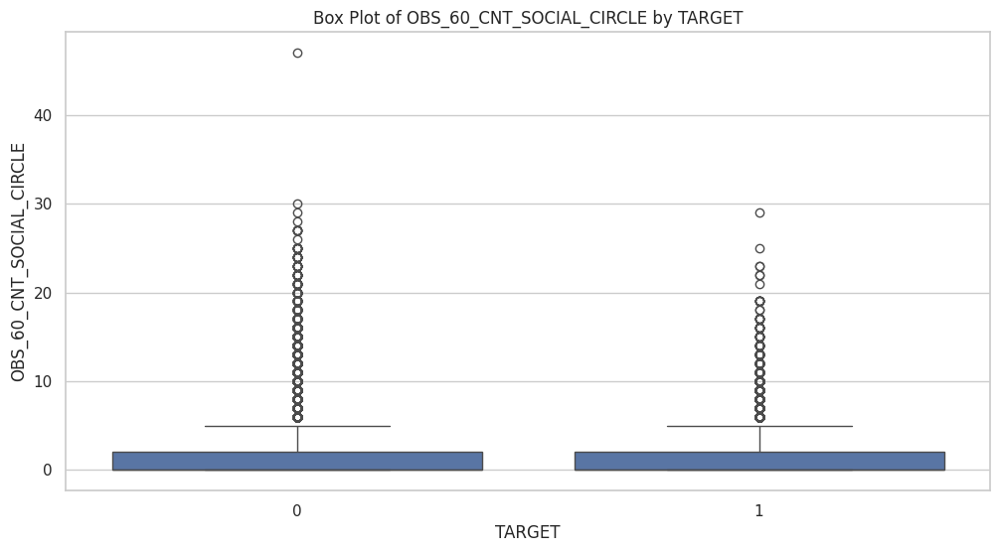

Box Plot Summary for OBS_60_CNT_SOCIAL_CIRCLE by TARGET:

╒══════════╤═════════╤═════════╤═════════╤═══════╤═══════╤═══════╤═══════╤═══════╕
│   TARGET │   count │    mean │     std │   min │   25% │   50% │   75% │   max │
╞══════════╪═════════╪═════════╪═════════╪═══════╪═══════╪═══════╪═══════╪═══════╡
│        0 │  282684 │ 1.39283 │ 2.29015 │     0 │     0 │     0 │     2 │    47 │
├──────────┼─────────┼─────────┼─────────┼───────┼───────┼───────┼───────┼───────┤
│        1 │   24825 │ 1.47553 │ 2.35487 │     0 │     0 │     0 │     2 │    29 │
╘══════════╧═════════╧═════════╧═════════╧═══════╧═══════╧═══════╧═══════╧═══════╛

--------------------------------------------------------------------------------



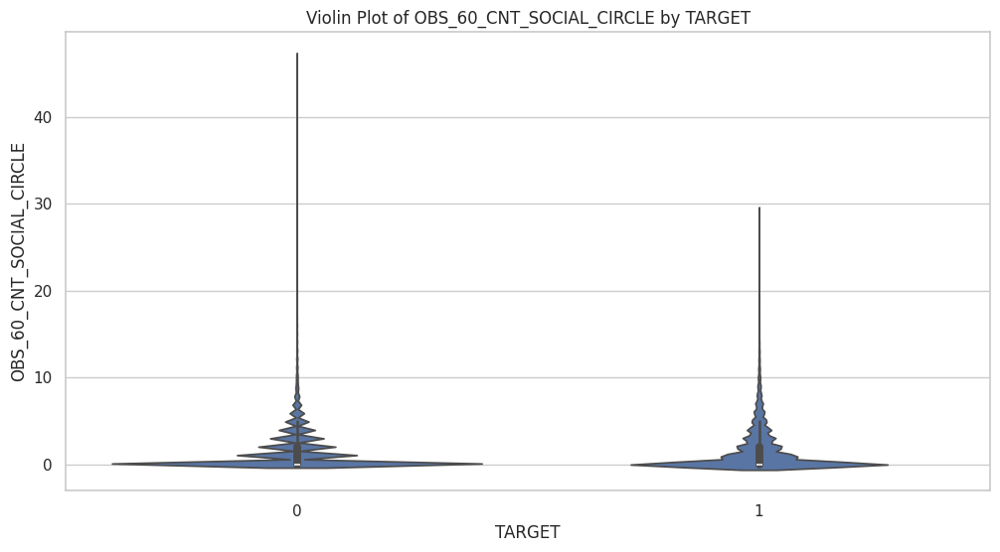

Violin Plot Summary for OBS_60_CNT_SOCIAL_CIRCLE by TARGET:

╒══════════╤═════════╤═════════╤═════════╤═══════╤═══════╤═══════╤═══════╤═══════╕
│   TARGET │   count │    mean │     std │   min │   25% │   50% │   75% │   max │
╞══════════╪═════════╪═════════╪═════════╪═══════╪═══════╪═══════╪═══════╪═══════╡
│        0 │  282684 │ 1.39283 │ 2.29015 │     0 │     0 │     0 │     2 │    47 │
├──────────┼─────────┼─────────┼─────────┼───────┼───────┼───────┼───────┼───────┤
│        1 │   24825 │ 1.47553 │ 2.35487 │     0 │     0 │     0 │     2 │    29 │
╘══════════╧═════════╧═════════╧═════════╧═══════╧═══════╧═══════╧═══════╧═══════╛

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------



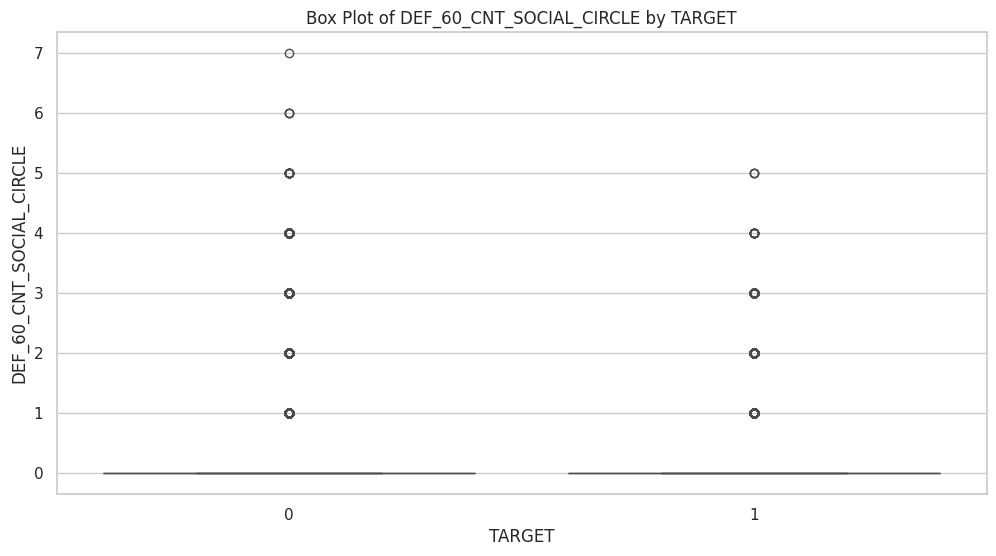

Box Plot Summary for DEF_60_CNT_SOCIAL_CIRCLE by TARGET:

╒══════════╤═════════╤═══════════╤══════════╤═══════╤═══════╤═══════╤═══════╤═══════╕
│   TARGET │   count │      mean │      std │   min │   25% │   50% │   75% │   max │
╞══════════╪═════════╪═══════════╪══════════╪═══════╪═══════╪═══════╪═══════╪═══════╡
│        0 │  282684 │ 0.0962665 │ 0.35234  │     0 │     0 │     0 │     0 │     7 │
├──────────┼─────────┼───────────┼──────────┼───────┼───────┼───────┼───────┼───────┤
│        1 │   24825 │ 0.138046  │ 0.427367 │     0 │     0 │     0 │     0 │     5 │
╘══════════╧═════════╧═══════════╧══════════╧═══════╧═══════╧═══════╧═══════╧═══════╛

--------------------------------------------------------------------------------



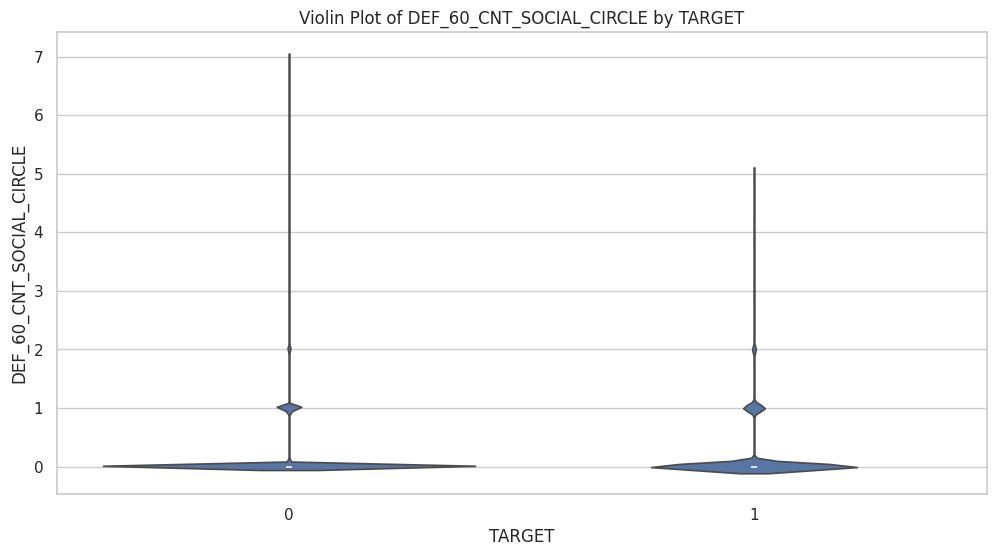

Violin Plot Summary for DEF_60_CNT_SOCIAL_CIRCLE by TARGET:

╒══════════╤═════════╤═══════════╤══════════╤═══════╤═══════╤═══════╤═══════╤═══════╕
│   TARGET │   count │      mean │      std │   min │   25% │   50% │   75% │   max │
╞══════════╪═════════╪═══════════╪══════════╪═══════╪═══════╪═══════╪═══════╪═══════╡
│        0 │  282684 │ 0.0962665 │ 0.35234  │     0 │     0 │     0 │     0 │     7 │
├──────────┼─────────┼───────────┼──────────┼───────┼───────┼───────┼───────┼───────┤
│        1 │   24825 │ 0.138046  │ 0.427367 │     0 │     0 │     0 │     0 │     5 │
╘══════════╧═════════╧═══════════╧══════════╧═══════╧═══════╧═══════╧═══════╧═══════╛

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------



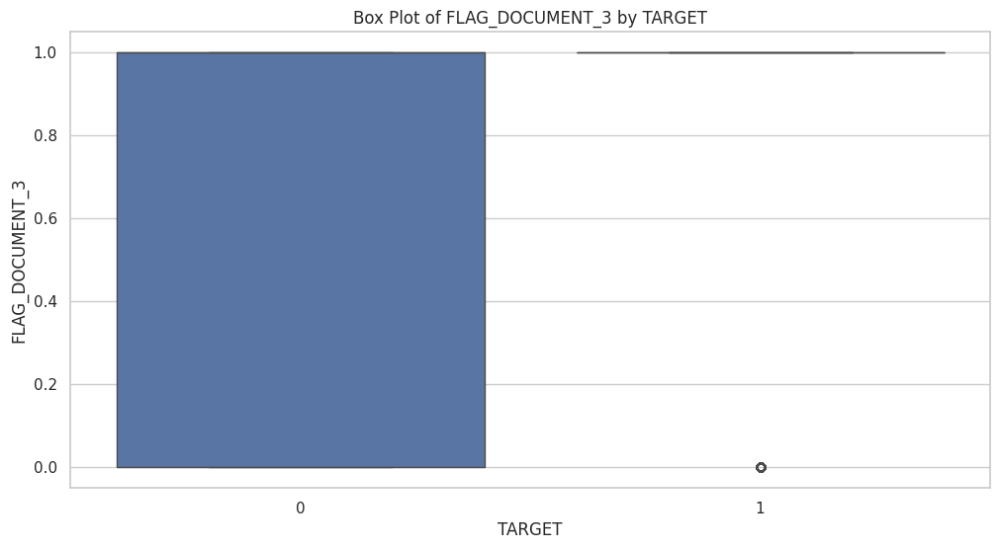

Box Plot Summary for FLAG_DOCUMENT_3 by TARGET:

╒══════════╤═════════╤══════════╤══════════╤═══════╤═══════╤═══════╤═══════╤═══════╕
│   TARGET │   count │     mean │      std │   min │   25% │   50% │   75% │   max │
╞══════════╪═════════╪══════════╪══════════╪═══════╪═══════╪═══════╪═══════╪═══════╡
│        0 │  282684 │ 0.704062 │ 0.456464 │     0 │     0 │     1 │     1 │     1 │
├──────────┼─────────┼──────────┼──────────┼───────┼───────┼───────┼───────┼───────┤
│        1 │   24825 │ 0.777925 │ 0.415649 │     0 │     1 │     1 │     1 │     1 │
╘══════════╧═════════╧══════════╧══════════╧═══════╧═══════╧═══════╧═══════╧═══════╛

--------------------------------------------------------------------------------



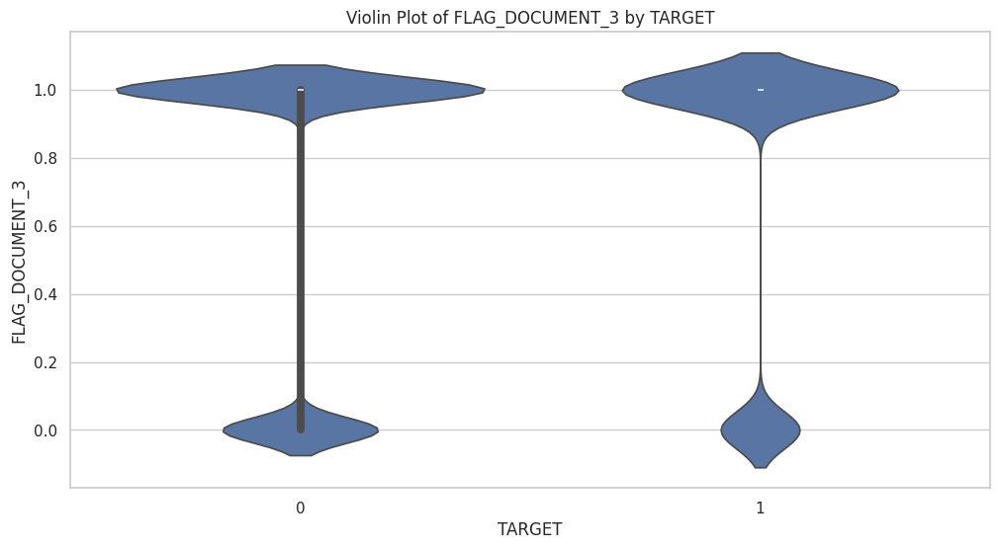

Violin Plot Summary for FLAG_DOCUMENT_3 by TARGET:

╒══════════╤═════════╤══════════╤══════════╤═══════╤═══════╤═══════╤═══════╤═══════╕
│   TARGET │   count │     mean │      std │   min │   25% │   50% │   75% │   max │
╞══════════╪═════════╪══════════╪══════════╪═══════╪═══════╪═══════╪═══════╪═══════╡
│        0 │  282684 │ 0.704062 │ 0.456464 │     0 │     0 │     1 │     1 │     1 │
├──────────┼─────────┼──────────┼──────────┼───────┼───────┼───────┼───────┼───────┤
│        1 │   24825 │ 0.777925 │ 0.415649 │     0 │     1 │     1 │     1 │     1 │
╘══════════╧═════════╧══════════╧══════════╧═══════╧═══════╧═══════╧═══════╧═══════╛

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------



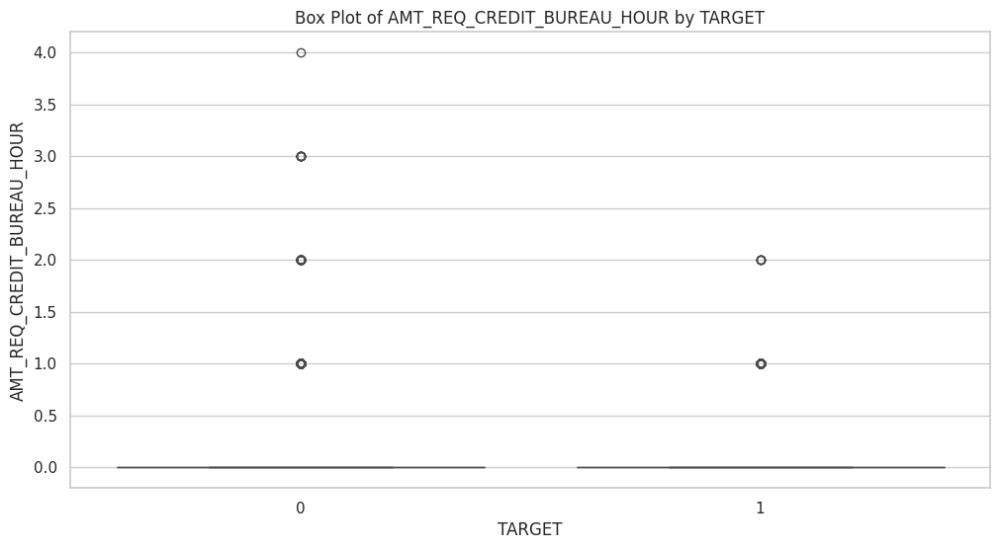

Box Plot Summary for AMT_REQ_CREDIT_BUREAU_HOUR by TARGET:

╒══════════╤═════════╤════════════╤═══════════╤═══════╤═══════╤═══════╤═══════╤═══════╕
│   TARGET │   count │       mean │       std │   min │   25% │   50% │   75% │   max │
╞══════════╪═════════╪════════════╪═══════════╪═══════╪═══════╪═══════╪═══════╪═══════╡
│        0 │  282684 │ 0.00553975 │ 0.0780789 │     0 │     0 │     0 │     0 │     4 │
├──────────┼─────────┼────────────┼───────────┼───────┼───────┼───────┼───────┼───────┤
│        1 │   24825 │ 0.00551863 │ 0.0772774 │     0 │     0 │     0 │     0 │     2 │
╘══════════╧═════════╧════════════╧═══════════╧═══════╧═══════╧═══════╧═══════╧═══════╛

--------------------------------------------------------------------------------



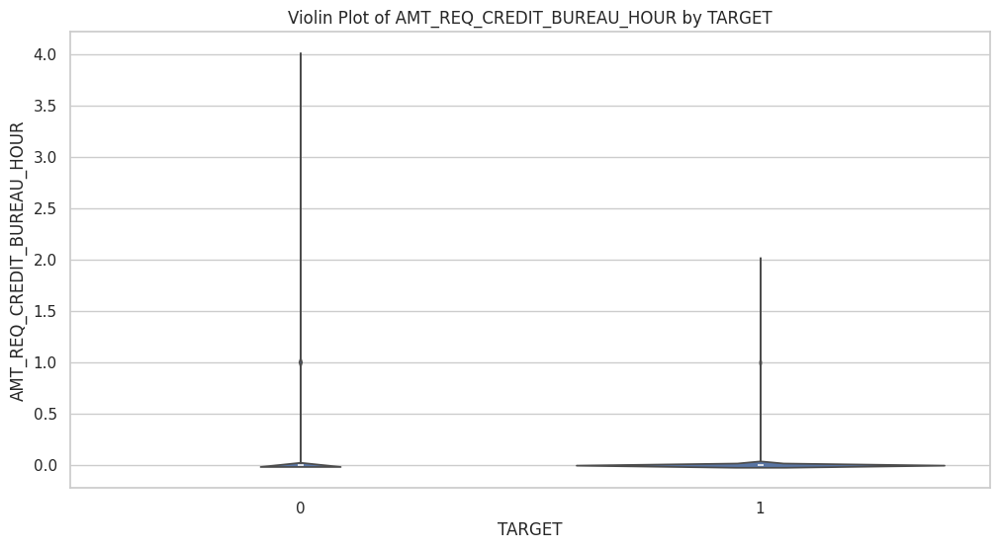

Violin Plot Summary for AMT_REQ_CREDIT_BUREAU_HOUR by TARGET:

╒══════════╤═════════╤════════════╤═══════════╤═══════╤═══════╤═══════╤═══════╤═══════╕
│   TARGET │   count │       mean │       std │   min │   25% │   50% │   75% │   max │
╞══════════╪═════════╪════════════╪═══════════╪═══════╪═══════╪═══════╪═══════╪═══════╡
│        0 │  282684 │ 0.00553975 │ 0.0780789 │     0 │     0 │     0 │     0 │     4 │
├──────────┼─────────┼────────────┼───────────┼───────┼───────┼───────┼───────┼───────┤
│        1 │   24825 │ 0.00551863 │ 0.0772774 │     0 │     0 │     0 │     0 │     2 │
╘══════════╧═════════╧════════════╧═══════════╧═══════╧═══════╧═══════╧═══════╧═══════╛

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------



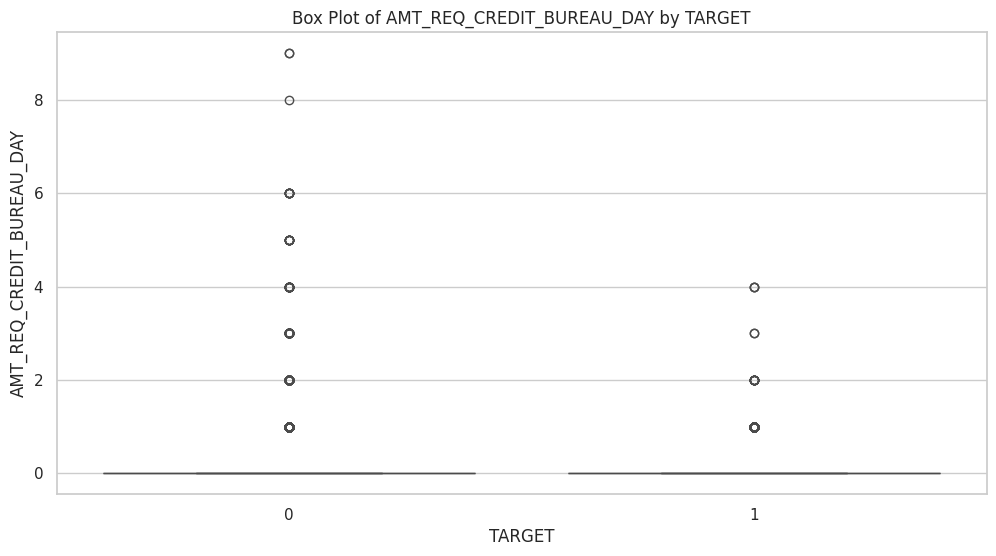

Box Plot Summary for AMT_REQ_CREDIT_BUREAU_DAY by TARGET:

╒══════════╤═════════╤════════════╤═══════════╤═══════╤═══════╤═══════╤═══════╤═══════╕
│   TARGET │   count │       mean │       std │   min │   25% │   50% │   75% │   max │
╞══════════╪═════════╪════════════╪═══════════╪═══════╪═══════╪═══════╪═══════╪═══════╡
│        0 │  282684 │ 0.00600317 │ 0.103545  │     0 │     0 │     0 │     0 │     9 │
├──────────┼─────────┼────────────┼───────────┼───────┼───────┼───────┼───────┼───────┤
│        1 │   24825 │ 0.00664653 │ 0.0970694 │     0 │     0 │     0 │     0 │     4 │
╘══════════╧═════════╧════════════╧═══════════╧═══════╧═══════╧═══════╧═══════╧═══════╛

--------------------------------------------------------------------------------



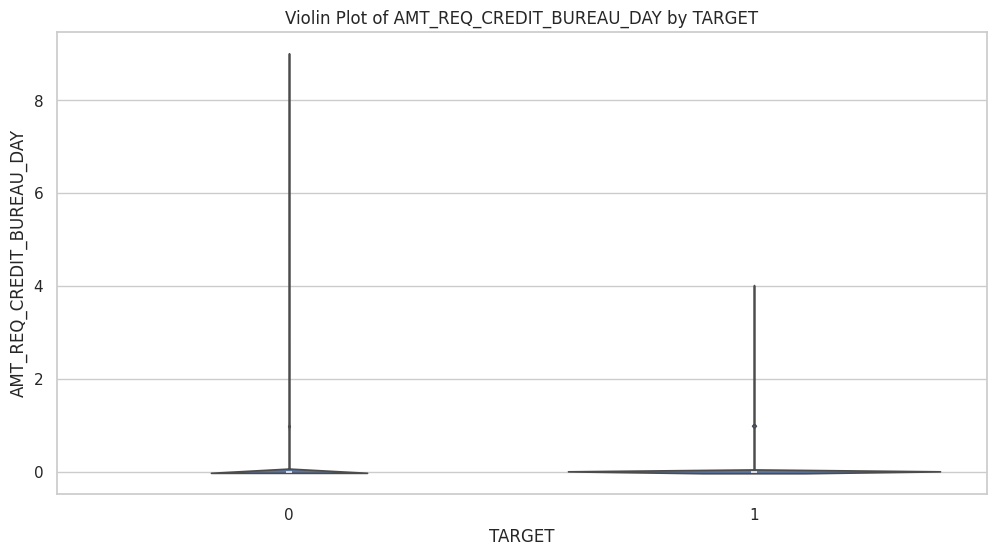

Violin Plot Summary for AMT_REQ_CREDIT_BUREAU_DAY by TARGET:

╒══════════╤═════════╤════════════╤═══════════╤═══════╤═══════╤═══════╤═══════╤═══════╕
│   TARGET │   count │       mean │       std │   min │   25% │   50% │   75% │   max │
╞══════════╪═════════╪════════════╪═══════════╪═══════╪═══════╪═══════╪═══════╪═══════╡
│        0 │  282684 │ 0.00600317 │ 0.103545  │     0 │     0 │     0 │     0 │     9 │
├──────────┼─────────┼────────────┼───────────┼───────┼───────┼───────┼───────┼───────┤
│        1 │   24825 │ 0.00664653 │ 0.0970694 │     0 │     0 │     0 │     0 │     4 │
╘══════════╧═════════╧════════════╧═══════════╧═══════╧═══════╧═══════╧═══════╧═══════╛

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------



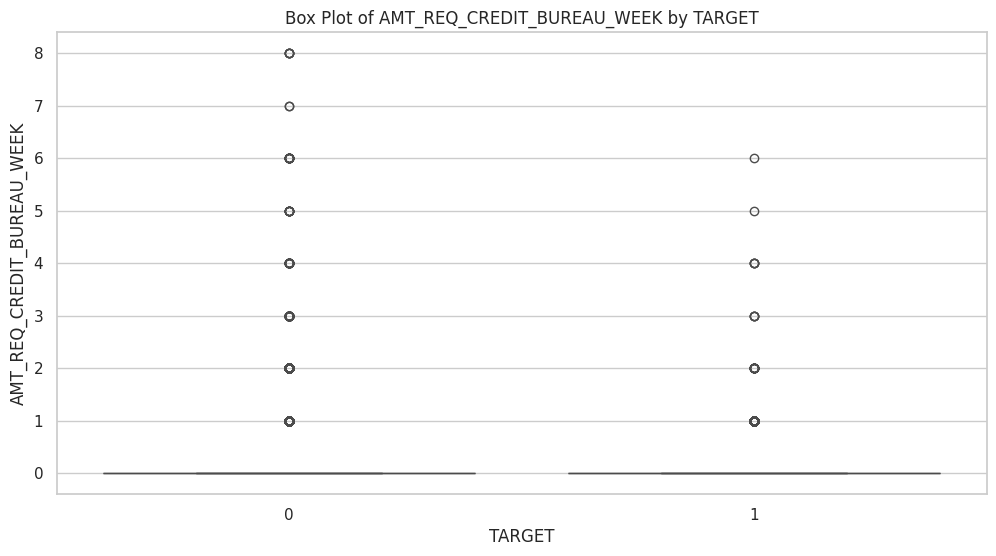

Box Plot Summary for AMT_REQ_CREDIT_BUREAU_WEEK by TARGET:

╒══════════╤═════════╤═══════════╤══════════╤═══════╤═══════╤═══════╤═══════╤═══════╕
│   TARGET │   count │      mean │      std │   min │   25% │   50% │   75% │   max │
╞══════════╪═════════╪═══════════╪══════════╪═══════╪═══════╪═══════╪═══════╪═══════╡
│        0 │  282684 │ 0.029793  │ 0.191134 │     0 │     0 │     0 │     0 │     8 │
├──────────┼─────────┼───────────┼──────────┼───────┼───────┼───────┼───────┼───────┤
│        1 │   24825 │ 0.0288822 │ 0.185944 │     0 │     0 │     0 │     0 │     6 │
╘══════════╧═════════╧═══════════╧══════════╧═══════╧═══════╧═══════╧═══════╧═══════╛

--------------------------------------------------------------------------------



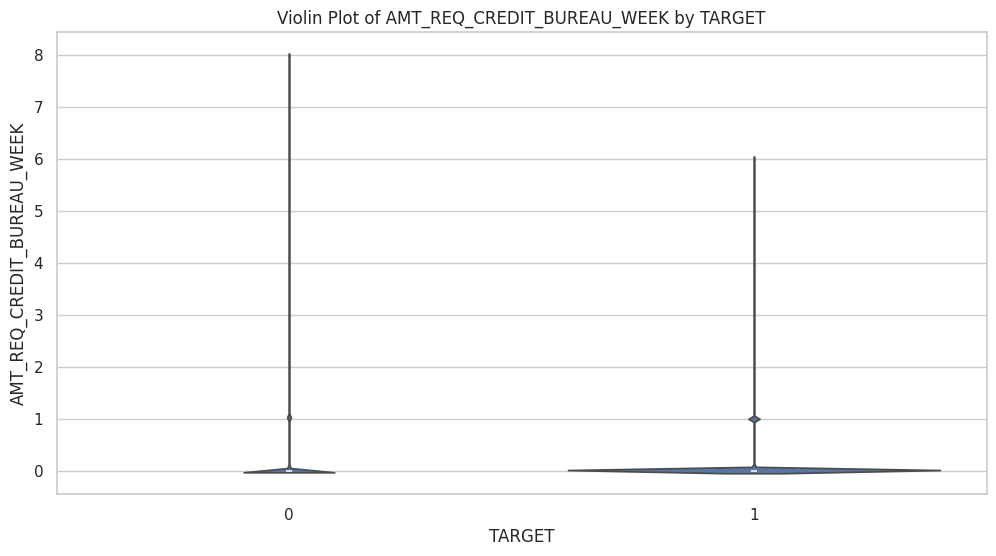

Violin Plot Summary for AMT_REQ_CREDIT_BUREAU_WEEK by TARGET:

╒══════════╤═════════╤═══════════╤══════════╤═══════╤═══════╤═══════╤═══════╤═══════╕
│   TARGET │   count │      mean │      std │   min │   25% │   50% │   75% │   max │
╞══════════╪═════════╪═══════════╪══════════╪═══════╪═══════╪═══════╪═══════╪═══════╡
│        0 │  282684 │ 0.029793  │ 0.191134 │     0 │     0 │     0 │     0 │     8 │
├──────────┼─────────┼───────────┼──────────┼───────┼───────┼───────┼───────┼───────┤
│        1 │   24825 │ 0.0288822 │ 0.185944 │     0 │     0 │     0 │     0 │     6 │
╘══════════╧═════════╧═══════════╧══════════╧═══════╧═══════╧═══════╧═══════╧═══════╛

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------



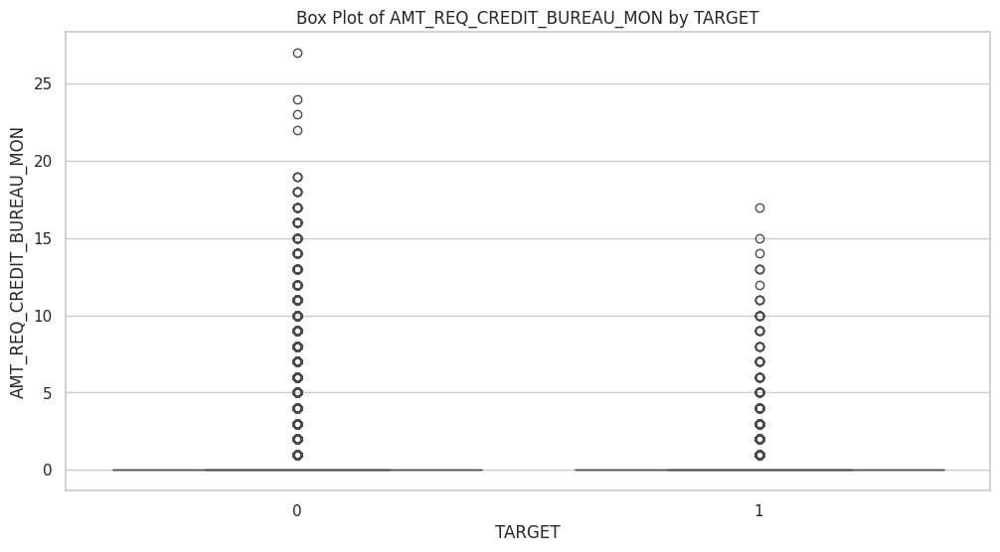

Box Plot Summary for AMT_REQ_CREDIT_BUREAU_MON by TARGET:

╒══════════╤═════════╤══════════╤══════════╤═══════╤═══════╤═══════╤═══════╤═══════╕
│   TARGET │   count │     mean │      std │   min │   25% │   50% │   75% │   max │
╞══════════╪═════════╪══════════╪══════════╪═══════╪═══════╪═══════╪═══════╪═══════╡
│        0 │  282684 │ 0.235043 │ 0.870312 │     0 │     0 │     0 │     0 │    27 │
├──────────┼─────────┼──────────┼──────────┼───────┼───────┼───────┼───────┼───────┤
│        1 │   24825 │ 0.18852  │ 0.683106 │     0 │     0 │     0 │     0 │    17 │
╘══════════╧═════════╧══════════╧══════════╧═══════╧═══════╧═══════╧═══════╧═══════╛

--------------------------------------------------------------------------------



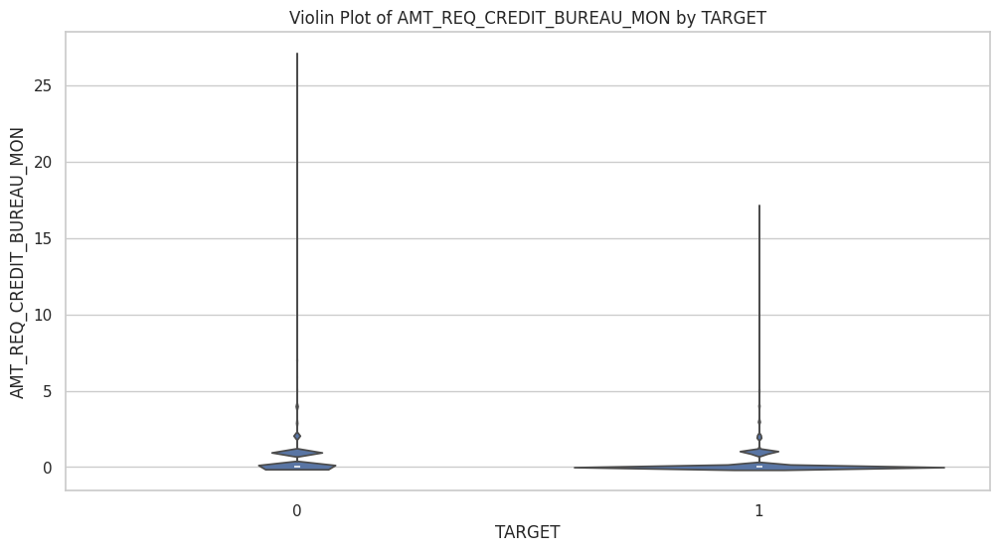

Violin Plot Summary for AMT_REQ_CREDIT_BUREAU_MON by TARGET:

╒══════════╤═════════╤══════════╤══════════╤═══════╤═══════╤═══════╤═══════╤═══════╕
│   TARGET │   count │     mean │      std │   min │   25% │   50% │   75% │   max │
╞══════════╪═════════╪══════════╪══════════╪═══════╪═══════╪═══════╪═══════╪═══════╡
│        0 │  282684 │ 0.235043 │ 0.870312 │     0 │     0 │     0 │     0 │    27 │
├──────────┼─────────┼──────────┼──────────┼───────┼───────┼───────┼───────┼───────┤
│        1 │   24825 │ 0.18852  │ 0.683106 │     0 │     0 │     0 │     0 │    17 │
╘══════════╧═════════╧══════════╧══════════╧═══════╧═══════╧═══════╧═══════╧═══════╛

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------



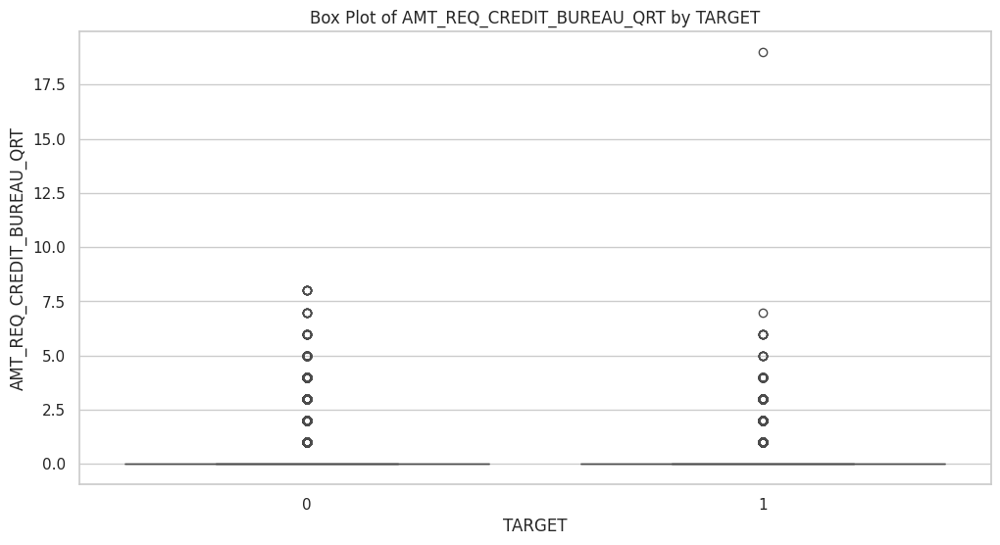

Box Plot Summary for AMT_REQ_CREDIT_BUREAU_QRT by TARGET:

╒══════════╤═════════╤══════════╤══════════╤═══════╤═══════╤═══════╤═══════╤═══════╕
│   TARGET │   count │     mean │      std │   min │   25% │   50% │   75% │   max │
╞══════════╪═════════╪══════════╪══════════╪═══════╪═══════╪═══════╪═══════╪═══════╡
│        0 │  282684 │ 0.229995 │ 0.575082 │     0 │     0 │     0 │     0 │     8 │
├──────────┼─────────┼──────────┼──────────┼───────┼───────┼───────┼───────┼───────┤
│        1 │   24825 │ 0.214985 │ 0.593689 │     0 │     0 │     0 │     0 │    19 │
╘══════════╧═════════╧══════════╧══════════╧═══════╧═══════╧═══════╧═══════╧═══════╛

--------------------------------------------------------------------------------



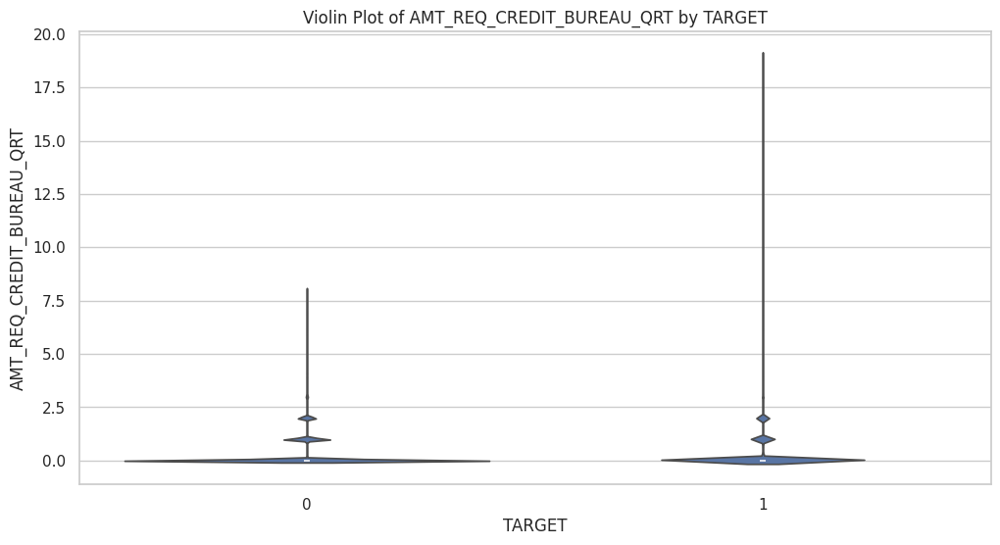

Violin Plot Summary for AMT_REQ_CREDIT_BUREAU_QRT by TARGET:

╒══════════╤═════════╤══════════╤══════════╤═══════╤═══════╤═══════╤═══════╤═══════╕
│   TARGET │   count │     mean │      std │   min │   25% │   50% │   75% │   max │
╞══════════╪═════════╪══════════╪══════════╪═══════╪═══════╪═══════╪═══════╪═══════╡
│        0 │  282684 │ 0.229995 │ 0.575082 │     0 │     0 │     0 │     0 │     8 │
├──────────┼─────────┼──────────┼──────────┼───────┼───────┼───────┼───────┼───────┤
│        1 │   24825 │ 0.214985 │ 0.593689 │     0 │     0 │     0 │     0 │    19 │
╘══════════╧═════════╧══════════╧══════════╧═══════╧═══════╧═══════╧═══════╧═══════╛

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------



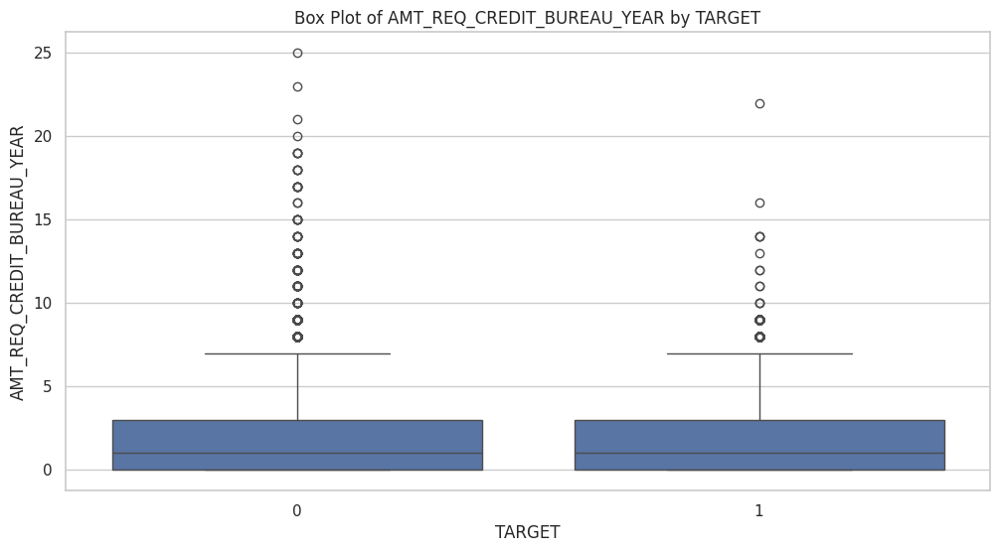

Box Plot Summary for AMT_REQ_CREDIT_BUREAU_YEAR by TARGET:

╒══════════╤═════════╤═════════╤═════════╤═══════╤═══════╤═══════╤═══════╤═══════╕
│   TARGET │   count │    mean │     std │   min │   25% │   50% │   75% │   max │
╞══════════╪═════════╪═════════╪═════════╪═══════╪═══════╪═══════╪═══════╪═══════╡
│        0 │  282684 │ 1.64041 │ 1.85015 │     0 │     0 │     1 │     3 │    25 │
├──────────┼─────────┼─────────┼─────────┼───────┼───────┼───────┼───────┼───────┤
│        1 │   24825 │ 1.67803 │ 1.91897 │     0 │     0 │     1 │     3 │    22 │
╘══════════╧═════════╧═════════╧═════════╧═══════╧═══════╧═══════╧═══════╧═══════╛

--------------------------------------------------------------------------------



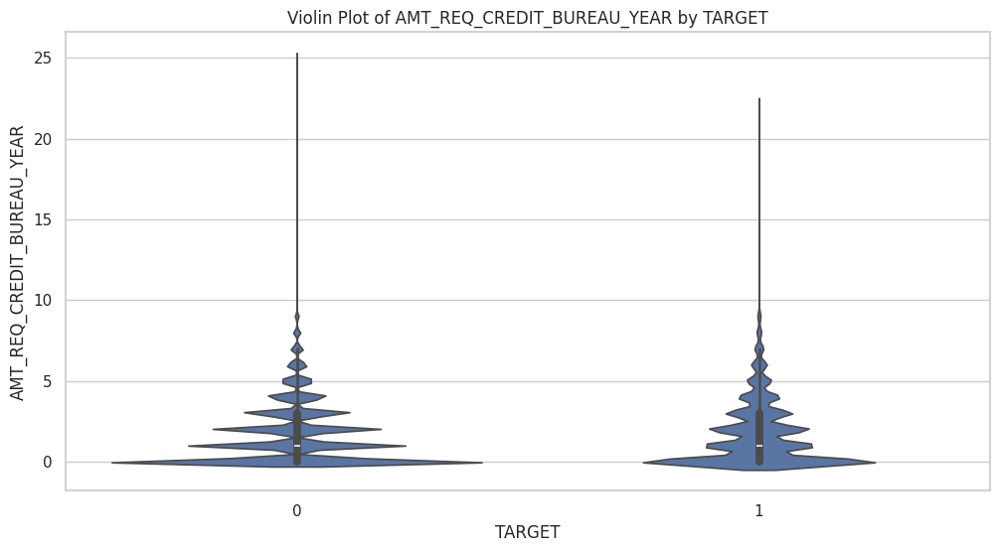

Violin Plot Summary for AMT_REQ_CREDIT_BUREAU_YEAR by TARGET:

╒══════════╤═════════╤═════════╤═════════╤═══════╤═══════╤═══════╤═══════╤═══════╕
│   TARGET │   count │    mean │     std │   min │   25% │   50% │   75% │   max │
╞══════════╪═════════╪═════════╪═════════╪═══════╪═══════╪═══════╪═══════╪═══════╡
│        0 │  282684 │ 1.64041 │ 1.85015 │     0 │     0 │     1 │     3 │    25 │
├──────────┼─────────┼─────────┼─────────┼───────┼───────┼───────┼───────┼───────┤
│        1 │   24825 │ 1.67803 │ 1.91897 │     0 │     0 │     1 │     3 │    22 │
╘══════════╧═════════╧═════════╧═════════╧═══════╧═══════╧═══════╧═══════╧═══════╛

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------



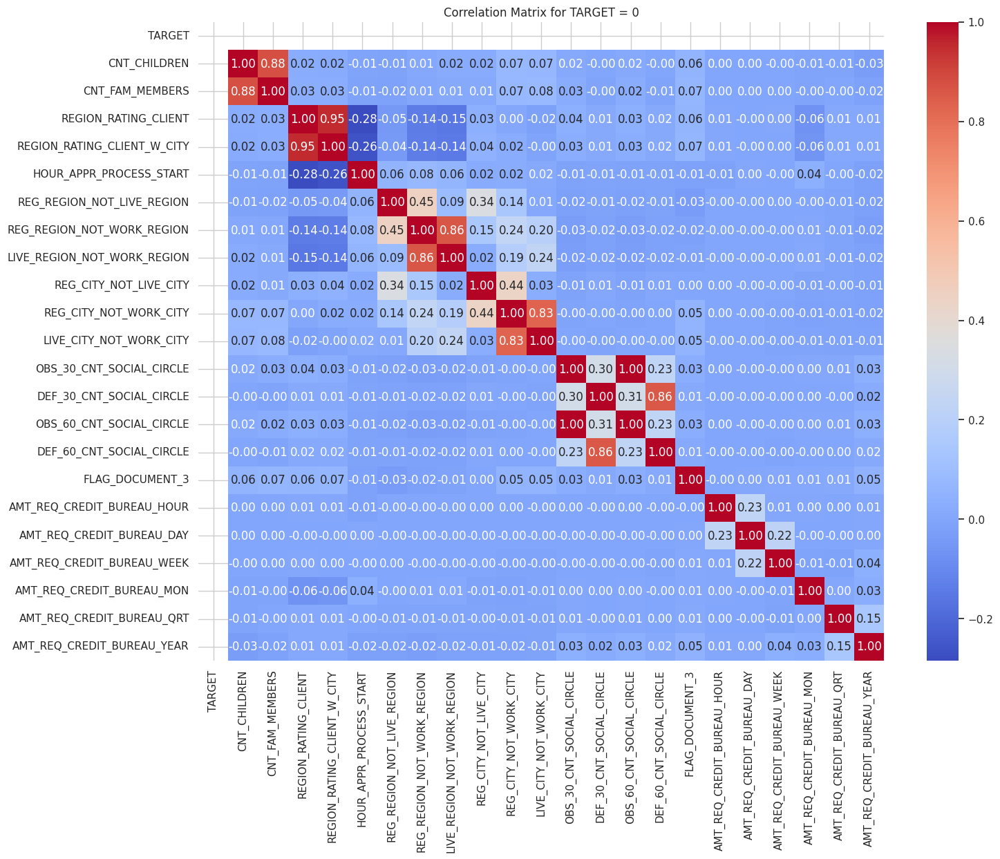

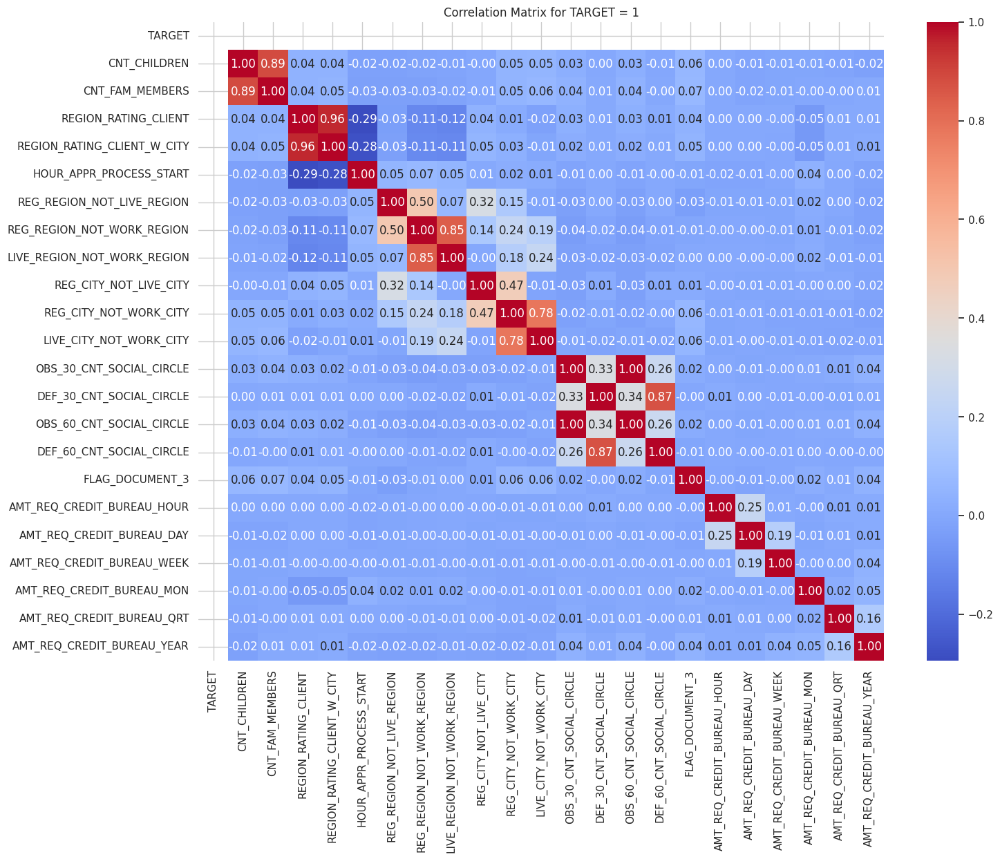


Top 10 columns with high correlation for TARGET = 0:

╒═══════════════════════════════════════════════════════════════╤═══════════════╕
│                                                               │   Correlation │
╞═══════════════════════════════════════════════════════════════╪═══════════════╡
│ ('CNT_CHILDREN', 'CNT_CHILDREN')                              │      1        │
├───────────────────────────────────────────────────────────────┼───────────────┤
│ ('OBS_30_CNT_SOCIAL_CIRCLE', 'OBS_60_CNT_SOCIAL_CIRCLE')      │      0.998392 │
├───────────────────────────────────────────────────────────────┼───────────────┤
│ ('REGION_RATING_CLIENT', 'REGION_RATING_CLIENT_W_CITY')       │      0.950148 │
├───────────────────────────────────────────────────────────────┼───────────────┤
│ ('CNT_FAM_MEMBERS', 'CNT_CHILDREN')                           │      0.878571 │
├───────────────────────────────────────────────────────────────┼───────────────┤
│ ('LIVE_REGION_NOT_WORK_REGION', 'REG_REGI

In [ ]:
# Function to do Bivariate Analysis on Numerical NOn Continuos COlumns with respect to TARGET
def bivariate_analysis_numerical_non_continuous(application_data_df, numerical_non_continuous_columns):
    for column in numerical_non_continuous_columns:
        # Box Plot
        plt.figure(figsize=(12, 6))
        sns.boxplot(x='TARGET', y=column, data=application_data_df)
        plt.title(f'Box Plot of {column} by TARGET')
        plt.xlabel('TARGET')
        plt.ylabel(column)
        plt.show()

        # Display relevant information using tabulate
        boxplot_info = application_data_df.groupby('TARGET')[column].describe().reset_index()
        print(f"Box Plot Summary for {column} by TARGET:\n")
        print(tabulate(boxplot_info, headers='keys', tablefmt='fancy_grid', showindex=False))
        print("\n" + "-"*80 + "\n")

        # Violin Plot
        plt.figure(figsize=(12, 6))
        sns.violinplot(x='TARGET', y=column, data=application_data_df)
        plt.title(f'Violin Plot of {column} by TARGET')
        plt.xlabel('TARGET')
        plt.ylabel(column)
        plt.show()

        # Display relevant information using tabulate
        violinplot_info = application_data_df.groupby('TARGET')[column].describe().reset_index()
        print(f"Violin Plot Summary for {column} by TARGET:\n")
        print(tabulate(violinplot_info, headers='keys', tablefmt='fancy_grid', showindex=False))
        print("\n" + "-"*200 + "\n")


    # Filter data for TARGET = 0
    correlation_matrix_0 = application_data_df[application_data_df['TARGET'] == 0][numerical_non_continuous_columns].corr()

    # Filter data for TARGET = 1
    correlation_matrix_1 = application_data_df[application_data_df['TARGET'] == 1][numerical_non_continuous_columns].corr()

    # Plot correlation matrix for TARGET = 0
    plt.figure(figsize=(16, 12))
    sns.heatmap(correlation_matrix_0, annot=True, cmap='coolwarm', fmt='.2f')
    plt.title('Correlation Matrix for TARGET = 0')
    plt.show()

    # Plot correlation matrix for TARGET = 1
    plt.figure(figsize=(16, 12))
    sns.heatmap(correlation_matrix_1, annot=True, cmap='coolwarm', fmt='.2f')
    plt.title('Correlation Matrix for TARGET = 1')
    plt.show()

    # Identify top 10 columns with high correlation for TARGET = 0
    top_correlation_table_0 = pd.DataFrame(correlation_matrix_0.unstack().sort_values(ascending=False).drop_duplicates().head(10),
                                          columns=['Correlation'])
    print("\nTop 10 columns with high correlation for TARGET = 0:\n")
    print(tabulate(top_correlation_table_0, headers='keys', tablefmt='fancy_grid'))

    # Identify top 10 columns with high correlation for TARGET = 1
    top_correlation_table_1 = pd.DataFrame(correlation_matrix_1.unstack().sort_values(ascending=False).drop_duplicates().head(10),
                                          columns=['Correlation'])
    print("\nTop 10 columns with high correlation for TARGET = 1:\n")
    print(tabulate(top_correlation_table_1, headers='keys', tablefmt='fancy_grid'))




bivariate_analysis_numerical_non_continuous(application_data_df, numerical_non_continuous_columns)


**B. Numerical Continuous Columns**

In [ ]:
numerical_continuous_columns

['AMT_INCOME_TOTAL',
 'AMT_CREDIT',
 'AMT_ANNUITY',
 'AMT_GOODS_PRICE',
 'REGION_POPULATION_RELATIVE',
 'DAYS_BIRTH',
 'DAYS_EMPLOYED',
 'DAYS_REGISTRATION',
 'DAYS_ID_PUBLISH',
 'EXT_SOURCE_2',
 'EXT_SOURCE_3',
 'DAYS_LAST_PHONE_CHANGE']

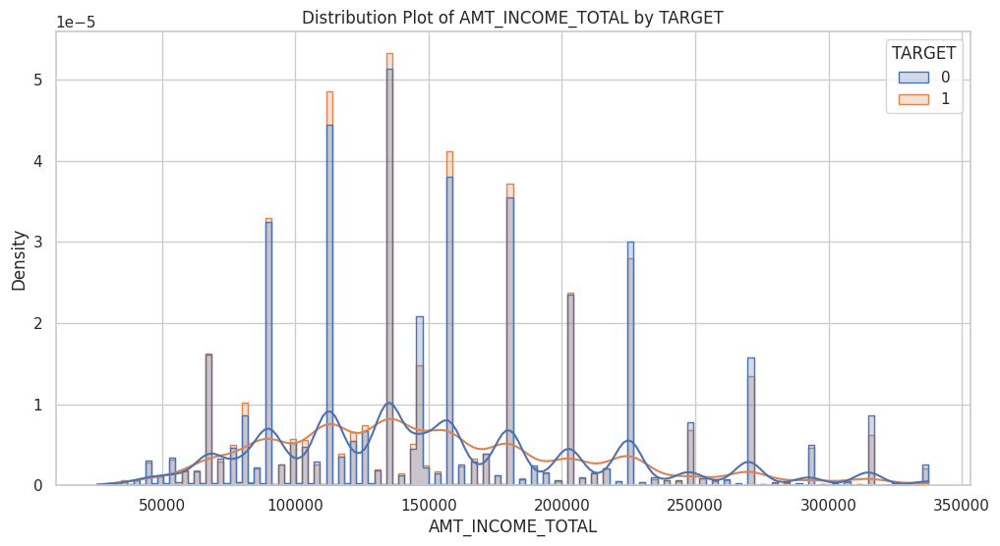

Distribution Plot Summary for AMT_INCOME_TOTAL by TARGET:

╒══════════╤═════════╤════════╤═════════╤═══════╤════════╤════════╤════════╤════════╕
│   TARGET │   count │   mean │     std │   min │    25% │    50% │    75% │    max │
╞══════════╪═════════╪════════╪═════════╪═══════╪════════╪════════╪════════╪════════╡
│        0 │  282684 │ 154214 │ 62765.8 │ 25650 │ 112500 │ 147150 │ 189000 │ 337500 │
├──────────┼─────────┼────────┼─────────┼───────┼────────┼────────┼────────┼────────┤
│        1 │   24825 │ 150814 │ 60012.7 │ 25650 │ 112500 │ 135000 │ 180000 │ 337500 │
╘══════════╧═════════╧════════╧═════════╧═══════╧════════╧════════╧════════╧════════╛

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------



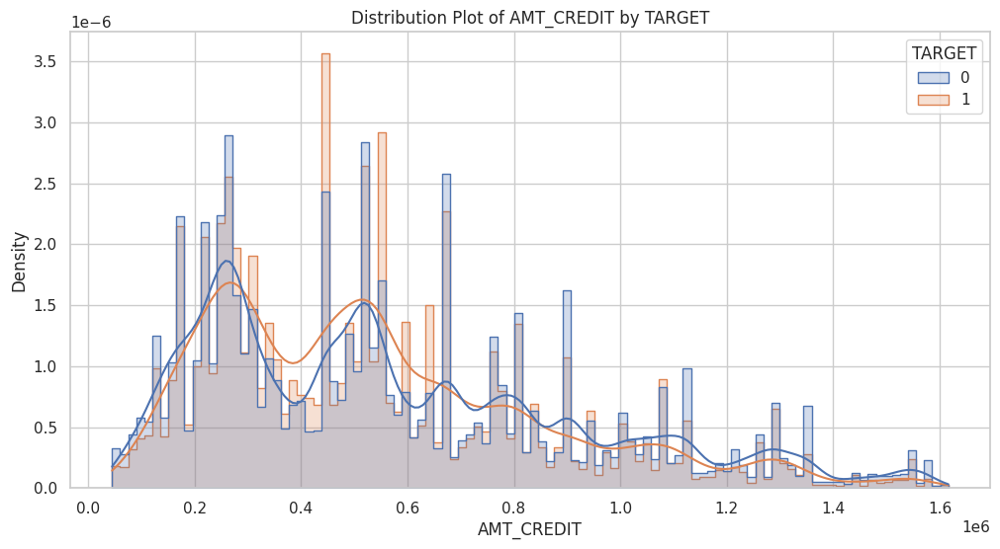

Distribution Plot Summary for AMT_CREDIT by TARGET:

╒══════════╤═════════╤════════╤════════╤═══════╤════════╤════════╤════════╤═════════════╕
│   TARGET │   count │   mean │    std │   min │    25% │    50% │    75% │         max │
╞══════════╪═════════╪════════╪════════╪═══════╪════════╪════════╪════════╪═════════════╡
│        0 │  282684 │ 571081 │ 351821 │ 45000 │ 270000 │ 513531 │ 787131 │ 1.61628e+06 │
├──────────┼─────────┼────────┼────────┼───────┼────────┼────────┼────────┼─────────────┤
│        1 │   24825 │ 542498 │ 314460 │ 45000 │ 284400 │ 497520 │ 715095 │ 1.61597e+06 │
╘══════════╧═════════╧════════╧════════╧═══════╧════════╧════════╧════════╧═════════════╛

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------



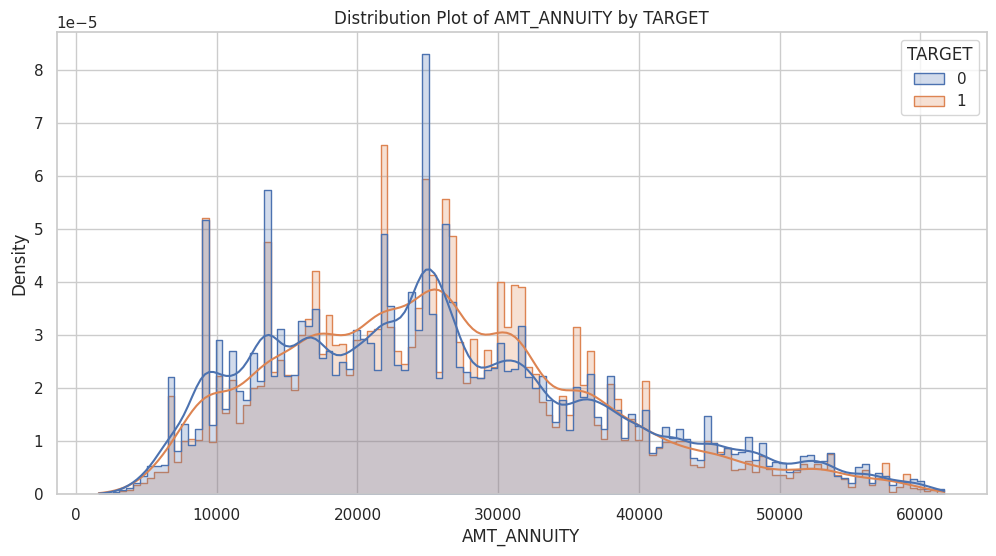

Distribution Plot Summary for AMT_ANNUITY by TARGET:

╒══════════╤═════════╤═════════╤═════════╤════════╤═════════╤═══════╤═══════╤═════════╕
│   TARGET │   count │    mean │     std │    min │     25% │   50% │   75% │     max │
╞══════════╪═════════╪═════════╪═════════╪════════╪═════════╪═══════╪═══════╪═════════╡
│        0 │  282684 │ 25898.8 │ 12144.1 │ 1615.5 │ 16456.5 │ 24876 │ 33192 │ 61699.5 │
├──────────┼─────────┼─────────┼─────────┼────────┼─────────┼───────┼───────┼─────────┤
│        1 │   24825 │ 25909.6 │ 11332.4 │ 2722.5 │ 17361   │ 24903 │ 32427 │ 61402.5 │
╘══════════╧═════════╧═════════╧═════════╧════════╧═════════╧═══════╧═══════╧═════════╛

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------



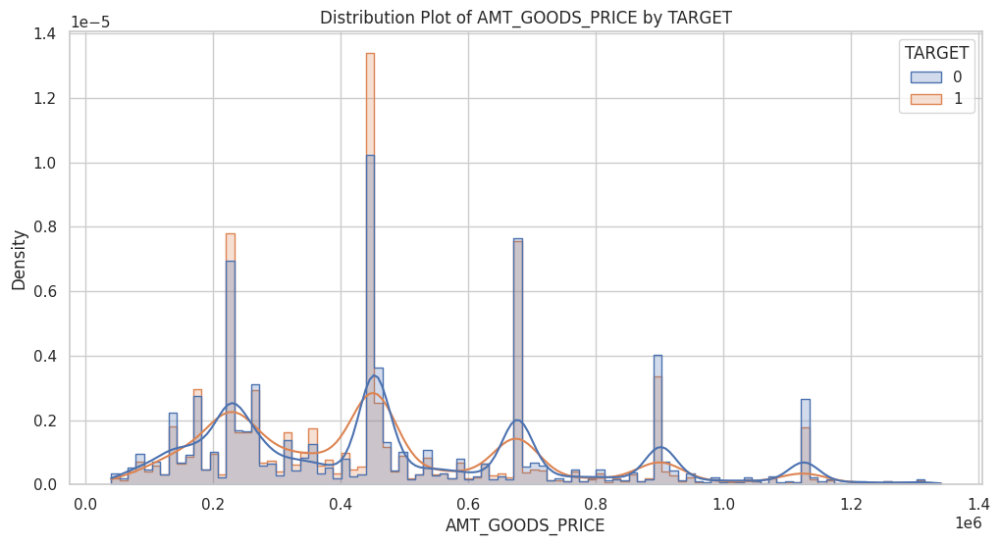

Distribution Plot Summary for AMT_GOODS_PRICE by TARGET:

╒══════════╤═════════╤════════╤════════╤═══════╤════════╤════════╤════════╤═══════════╕
│   TARGET │   count │   mean │    std │   min │    25% │    50% │    75% │       max │
╞══════════╪═════════╪════════╪════════╪═══════╪════════╪════════╪════════╪═══════════╡
│        0 │  282684 │ 487185 │ 285387 │ 40500 │ 238500 │ 450000 │ 675000 │ 1.341e+06 │
├──────────┼─────────┼────────┼────────┼───────┼────────┼────────┼────────┼───────────┤
│        1 │   24825 │ 462357 │ 260067 │ 45000 │ 238500 │ 450000 │ 666000 │ 1.341e+06 │
╘══════════╧═════════╧════════╧════════╧═══════╧════════╧════════╧════════╧═══════════╛

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------



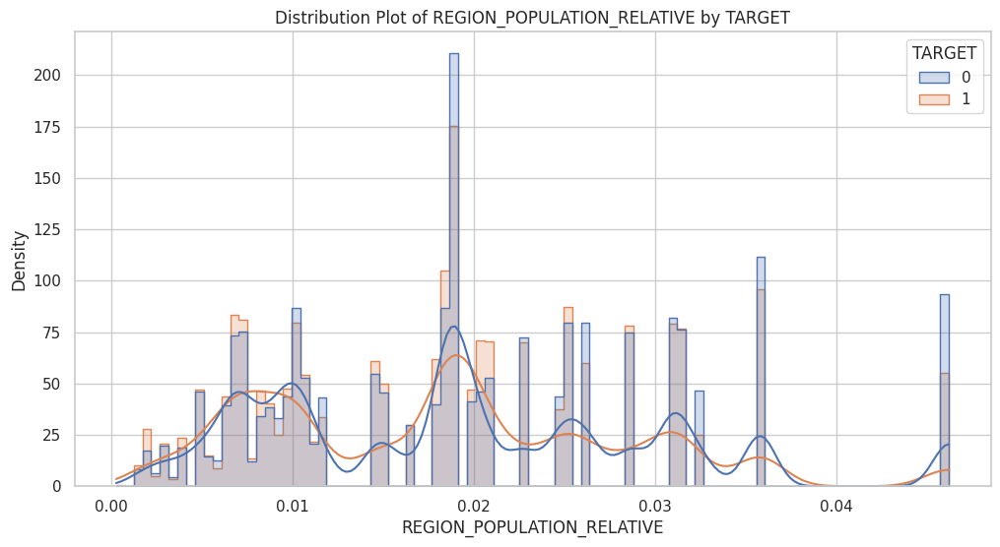

Distribution Plot Summary for REGION_POPULATION_RELATIVE by TARGET:

╒══════════╤═════════╤═══════════╤═══════════╤══════════╤══════════╤══════════╤══════════╤═════════╕
│   TARGET │   count │      mean │       std │      min │      25% │      50% │      75% │     max │
╞══════════╪═════════╪═══════════╪═══════════╪══════════╪══════════╪══════════╪══════════╪═════════╡
│        0 │  282684 │ 0.0194873 │ 0.0108352 │ 0.00029  │ 0.010006 │ 0.01885  │ 0.026392 │ 0.04622 │
├──────────┼─────────┼───────────┼───────────┼──────────┼──────────┼──────────┼──────────┼─────────┤
│        1 │   24825 │ 0.0184087 │ 0.0101421 │ 0.000533 │ 0.00963  │ 0.018634 │ 0.025164 │ 0.04622 │
╘══════════╧═════════╧═══════════╧═══════════╧══════════╧══════════╧══════════╧══════════╧═════════╛

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------



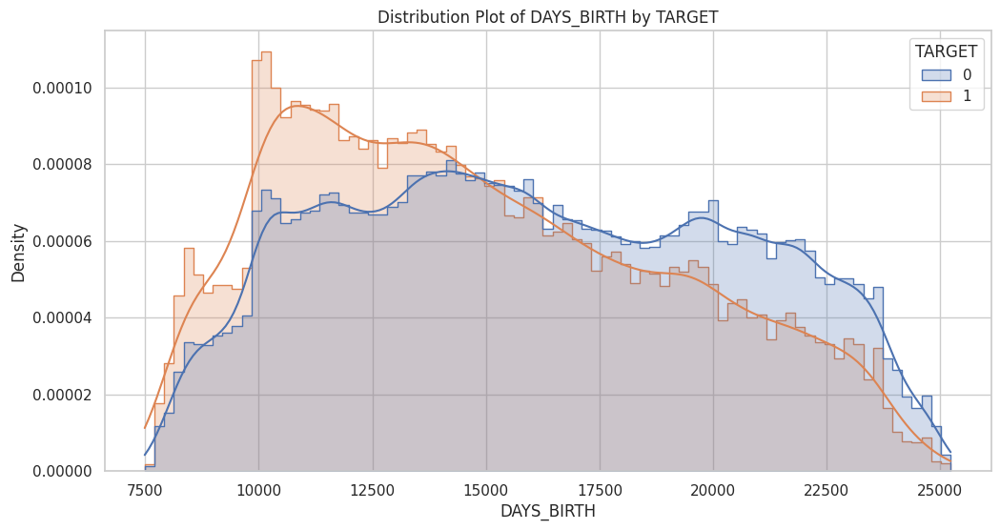

Distribution Plot Summary for DAYS_BIRTH by TARGET:

╒══════════╤═════════╤═════════╤═════════╤═══════╤═══════╤═══════╤═══════╤═══════╕
│   TARGET │   count │    mean │     std │   min │   25% │   50% │   75% │   max │
╞══════════╪═════════╪═════════╪═════════╪═══════╪═══════╪═══════╪═══════╪═══════╡
│        0 │  282684 │ 16138.2 │ 4364.2  │  7489 │ 12536 │ 15877 │ 19794 │ 25229 │
├──────────┼─────────┼─────────┼─────────┼───────┼───────┼───────┼───────┼───────┤
│        1 │   24825 │ 14884.8 │ 4192.84 │  7678 │ 11396 │ 14282 │ 18037 │ 25168 │
╘══════════╧═════════╧═════════╧═════════╧═══════╧═══════╧═══════╧═══════╧═══════╛

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------



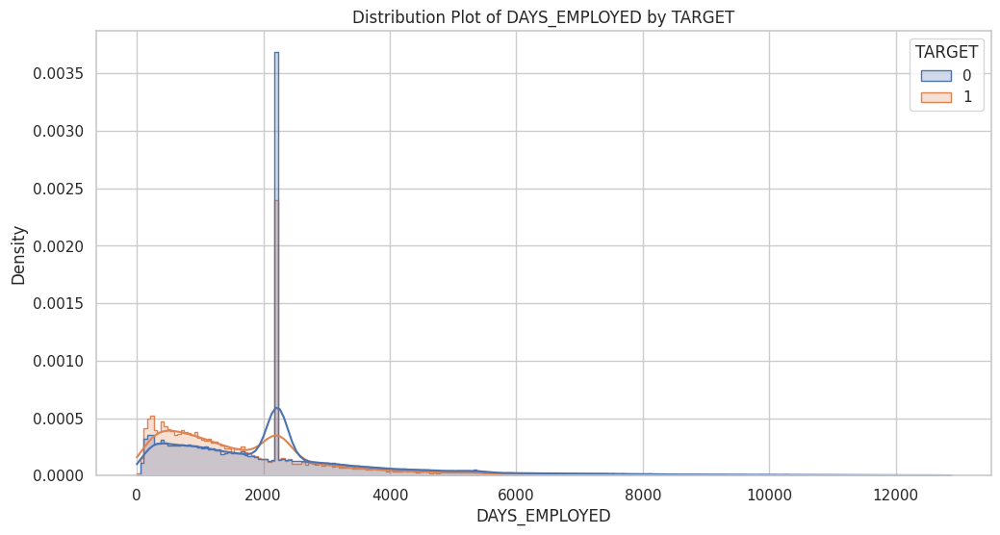

Distribution Plot Summary for DAYS_EMPLOYED by TARGET:

╒══════════╤═════════╤═════════╤═════════╤═══════╤════════╤═══════╤═══════╤═══════╕
│   TARGET │   count │    mean │     std │   min │    25% │   50% │   75% │   max │
╞══════════╪═════════╪═════════╪═════════╪═══════╪════════╪═══════╪═══════╪═══════╡
│        0 │  282684 │ 2357.02 │ 2030.53 │     0 │ 966.75 │  2219 │  2784 │ 12865 │
├──────────┼─────────┼─────────┼─────────┼───────┼────────┼───────┼───────┼───────┤
│        1 │   24825 │ 1856.56 │ 1714.49 │     0 │ 677    │  1458 │  2219 │ 12853 │
╘══════════╧═════════╧═════════╧═════════╧═══════╧════════╧═══════╧═══════╧═══════╛

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------



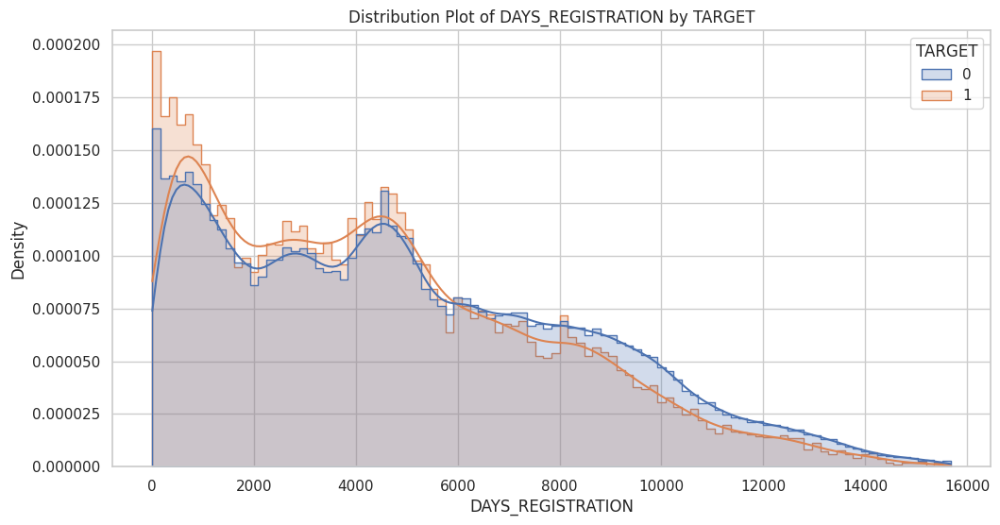

Distribution Plot Summary for DAYS_REGISTRATION by TARGET:

╒══════════╤═════════╤═════════╤═════════╤═══════╤═══════╤═══════╤═══════╤═══════╕
│   TARGET │   count │    mean │     std │   min │   25% │   50% │   75% │   max │
╞══════════╪═════════╪═════════╪═════════╪═══════╪═══════╪═══════╪═══════╪═══════╡
│        0 │  282684 │ 5002.25 │ 3493.08 │     0 │  2045 │  4525 │  7517 │ 15680 │
├──────────┼─────────┼─────────┼─────────┼───────┼───────┼───────┼───────┼───────┤
│        1 │   24825 │ 4473.56 │ 3273.41 │     0 │  1671 │  4056 │  6632 │ 15658 │
╘══════════╧═════════╧═════════╧═════════╧═══════╧═══════╧═══════╧═══════╧═══════╛

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------



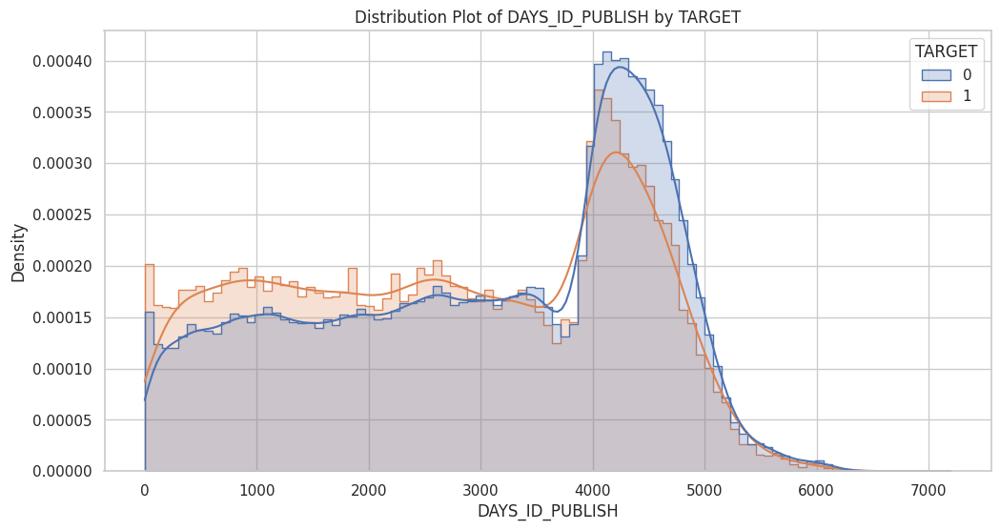

Distribution Plot Summary for DAYS_ID_PUBLISH by TARGET:

╒══════════╤═════════╤═════════╤═════════╤═══════╤═══════╤═══════╤═══════╤═══════╕
│   TARGET │   count │    mean │     std │   min │   25% │   50% │   75% │   max │
╞══════════╪═════════╪═════════╪═════════╪═══════╪═══════╪═══════╪═══════╪═══════╡
│        0 │  282684 │ 3017.22 │ 1506.62 │     0 │  1755 │  3295 │  4313 │  7197 │
├──────────┼─────────┼─────────┼─────────┼───────┼───────┼───────┼───────┼───────┤
│        1 │   24825 │ 2732.1  │ 1516.98 │     0 │  1392 │  2797 │  4119 │  6207 │
╘══════════╧═════════╧═════════╧═════════╧═══════╧═══════╧═══════╧═══════╧═══════╛

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------



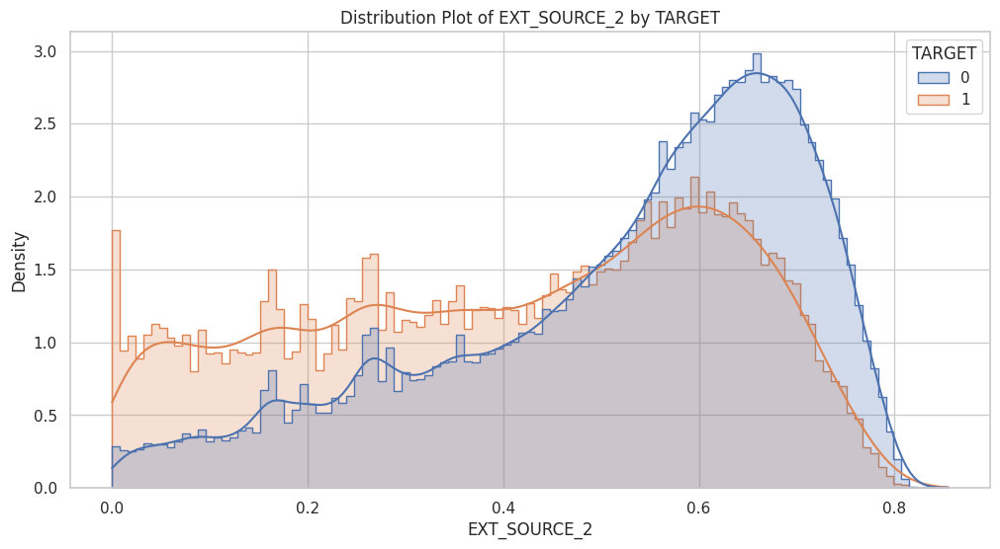

Distribution Plot Summary for EXT_SOURCE_2 by TARGET:

╒══════════╤═════════╤═════════╤══════════╤═════════════╤══════════╤══════════╤══════════╤═════════╕
│   TARGET │   count │    mean │      std │         min │      25% │      50% │      75% │     max │
╞══════════╪═════════╪═════════╪══════════╪═════════════╪══════════╪══════════╪══════════╪═════════╡
│        0 │  282684 │ 0.52357 │ 0.186087 │ 8.17362e-08 │ 0.410347 │ 0.573402 │ 0.667521 │ 0.855   │
├──────────┼─────────┼─────────┼──────────┼─────────────┼──────────┼──────────┼──────────┼─────────┤
│        1 │   24825 │ 0.41126 │ 0.213002 │ 5.00211e-06 │ 0.239084 │ 0.441076 │ 0.593937 │ 0.81187 │
╘══════════╧═════════╧═════════╧══════════╧═════════════╧══════════╧══════════╧══════════╧═════════╛

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------



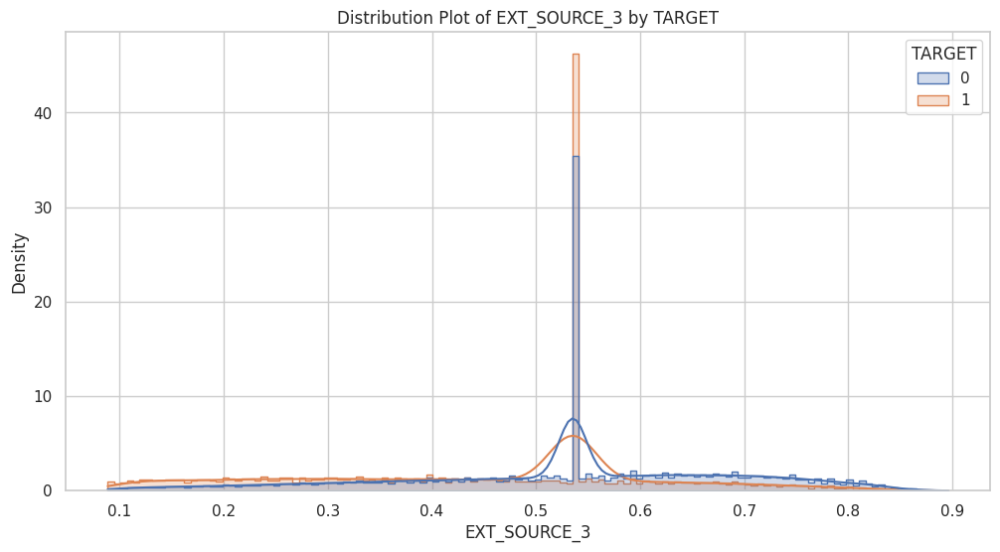

Distribution Plot Summary for EXT_SOURCE_3 by TARGET:

╒══════════╤═════════╤══════════╤══════════╤═══════════╤══════════╤══════════╤══════════╤══════════╕
│   TARGET │   count │     mean │      std │       min │      25% │      50% │      75% │      max │
╞══════════╪═════════╪══════════╪══════════╪═══════════╪══════════╪══════════╪══════════╪══════════╡
│        0 │  282684 │ 0.529164 │ 0.163345 │ 0.0884606 │ 0.440058 │ 0.535276 │ 0.643026 │ 0.893976 │
├──────────┼─────────┼──────────┼──────────┼───────────┼──────────┼──────────┼──────────┼──────────┤
│        1 │   24825 │ 0.446452 │ 0.172998 │ 0.0884606 │ 0.306202 │ 0.520898 │ 0.535276 │ 0.89601  │
╘══════════╧═════════╧══════════╧══════════╧═══════════╧══════════╧══════════╧══════════╧══════════╛

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------



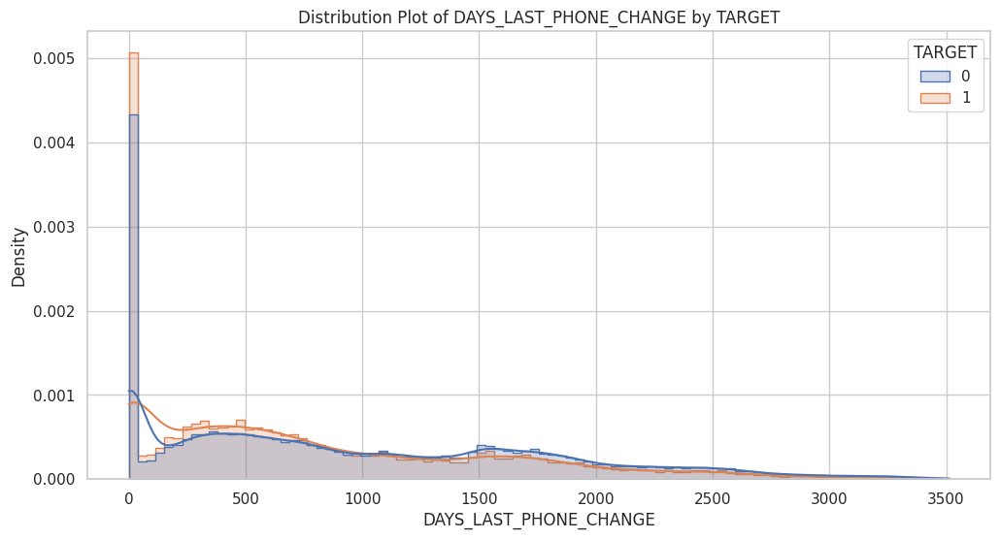

Distribution Plot Summary for DAYS_LAST_PHONE_CHANGE by TARGET:

╒══════════╤═════════╤═════════╤═════════╤═══════╤═══════╤═══════╤═══════╤═══════╕
│   TARGET │   count │    mean │     std │   min │   25% │   50% │   75% │   max │
╞══════════╪═════════╪═════════╪═════════╪═══════╪═══════╪═══════╪═══════╪═══════╡
│        0 │  282684 │ 972.068 │ 824.672 │     0 │   281 │   772 │  1582 │  3514 │
├──────────┼─────────┼─────────┼─────────┼───────┼───────┼───────┼───────┼───────┤
│        1 │   24825 │ 806.539 │ 753.822 │     0 │   194 │   594 │  1298 │  3502 │
╘══════════╧═════════╧═════════╧═════════╧═══════╧═══════╧═══════╧═══════╧═══════╛

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------



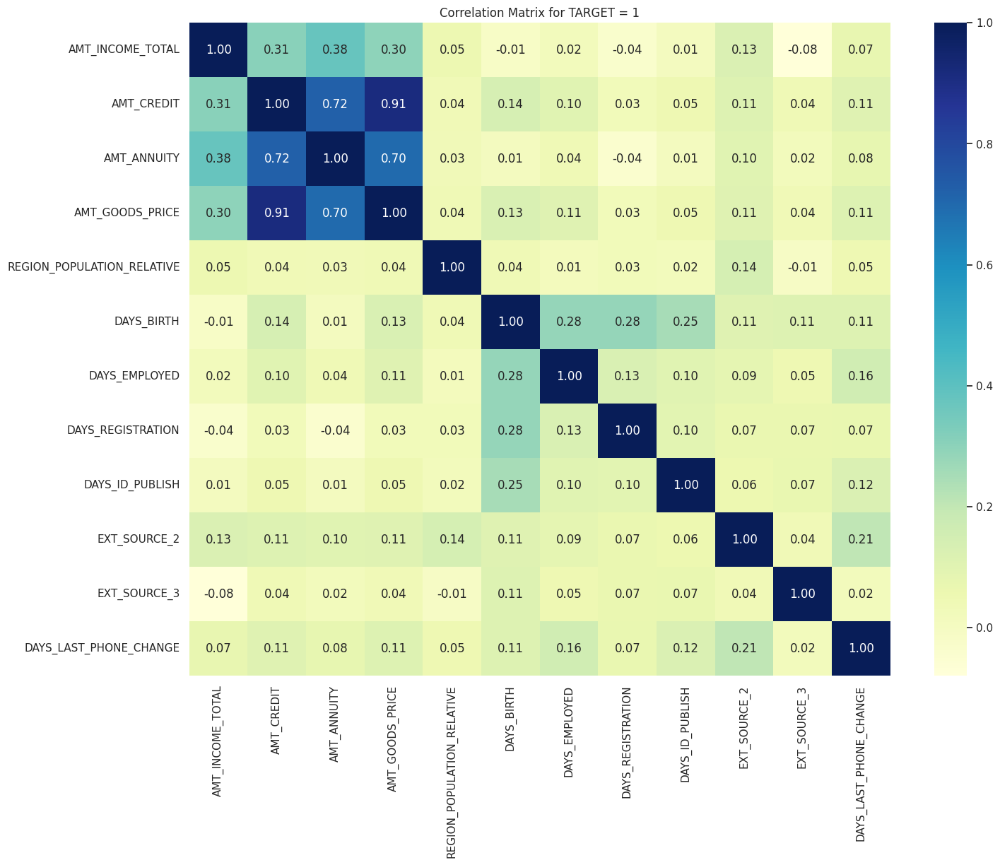

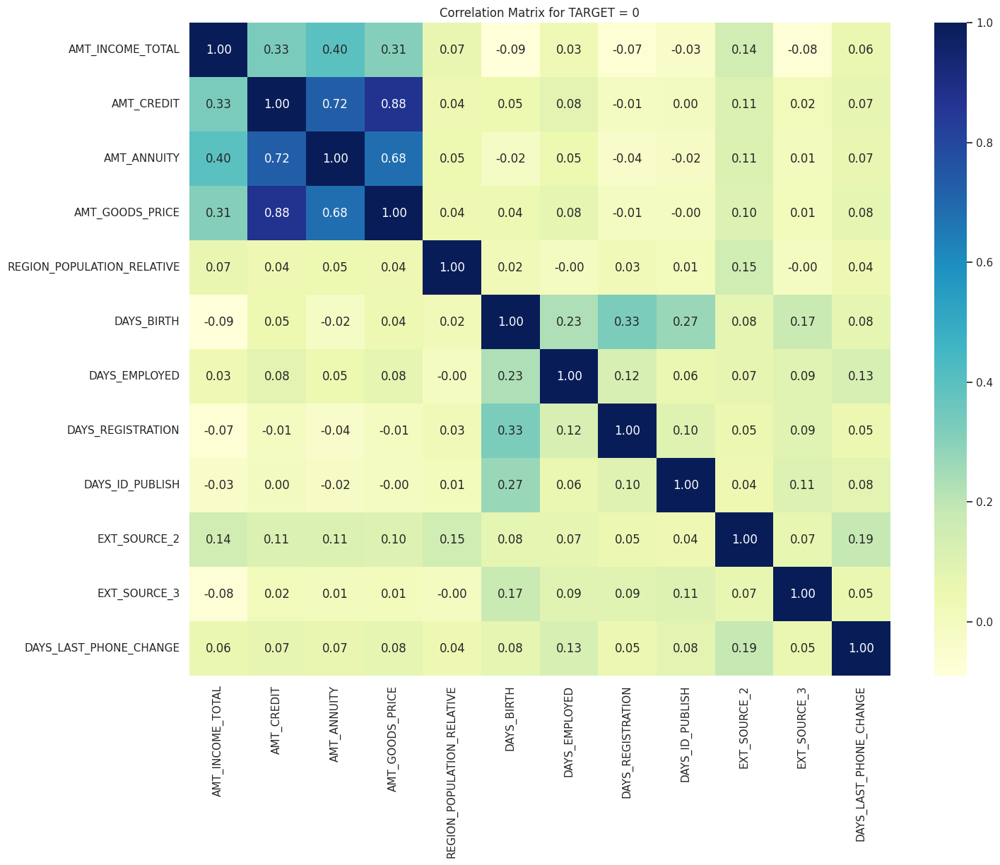

In [ ]:
# Function to do Bi/Multivariate Analysis on Numerical Continuos COlumns with respect to TARGET
def bivariate_analysis_numerical_continuous(application_data_df, numerical_continuous_columns):
    for column in numerical_continuous_columns:
        # Distribution Plot
        plt.figure(figsize=(12, 6))
        sns.histplot(data=application_data_df, x=column, hue='TARGET', element="step", common_norm=False, stat="density", kde=True)
        plt.title(f'Distribution Plot of {column} by TARGET')
        plt.xlabel(column)
        plt.ylabel('Density')
        plt.show()

        # Display relevant information using tabulate
        distplot_info = application_data_df.groupby('TARGET')[column].describe().reset_index()
        print(f'Distribution Plot Summary for {column} by TARGET:\n')
        print(tabulate(distplot_info, headers='keys', tablefmt='fancy_grid', showindex=False))
        print("\n" + "-"*200 + "\n")


    # Separate the dataframe based on TARGET values
    target_1_df = application_data_df[application_data_df['TARGET'] == 1]
    target_0_df = application_data_df[application_data_df['TARGET'] == 0]

    # Correlation Matrix for TARGET = 1
    correlation_matrix_target_1 = target_1_df[numerical_continuous_columns].corr()
    plt.figure(figsize=(16, 12))
    sns.heatmap(correlation_matrix_target_1, annot=True, cmap='YlGnBu', fmt='.2f')  # Use a light color palette, e.g., 'YlGnBu'
    plt.title('Correlation Matrix for TARGET = 1')
    plt.show()

    # Correlation Matrix for TARGET = 0
    correlation_matrix_target_0 = target_0_df[numerical_continuous_columns].corr()
    plt.figure(figsize=(16, 12))
    sns.heatmap(correlation_matrix_target_0, annot=True, cmap='YlGnBu', fmt='.2f')  # Use the same color palette
    plt.title('Correlation Matrix for TARGET = 0')
    plt.show()




bivariate_analysis_numerical_continuous(application_data_df, numerical_continuous_columns)


**Inference**:
* AMT_CREDIT, AMT_ANNUITY, AMT_GOODS_PRICE are having high correlation for both TARGET = 1 and TARGET = 0.


**C.Categorical Columns**

In [ ]:
category_columns

['NAME_CONTRACT_TYPE',
 'CODE_GENDER',
 'NAME_TYPE_SUITE',
 'NAME_INCOME_TYPE',
 'NAME_EDUCATION_TYPE',
 'NAME_FAMILY_STATUS',
 'NAME_HOUSING_TYPE',
 'OCCUPATION_TYPE',
 'WEEKDAY_APPR_PROCESS_START',
 'ORGANIZATION_TYPE']

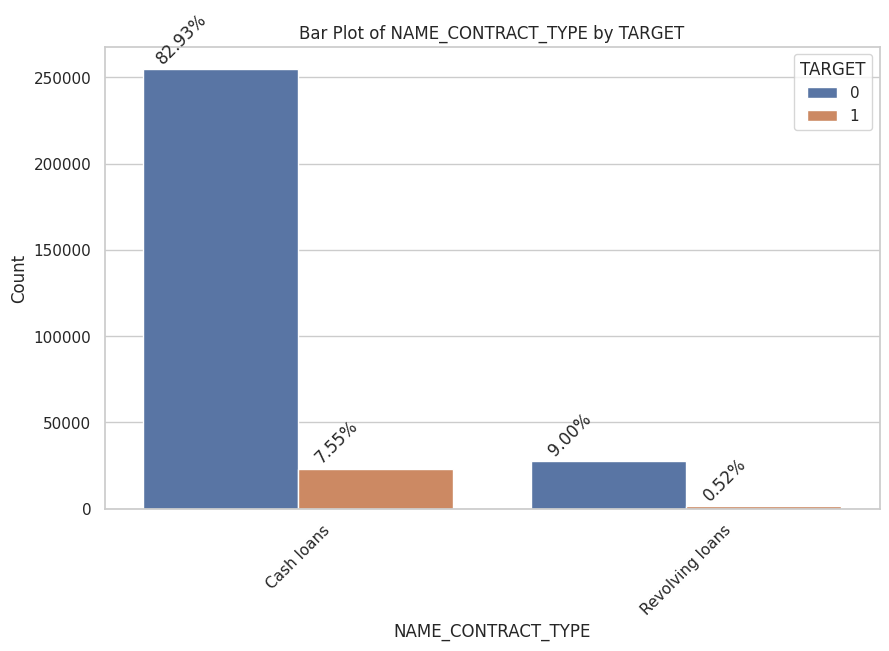

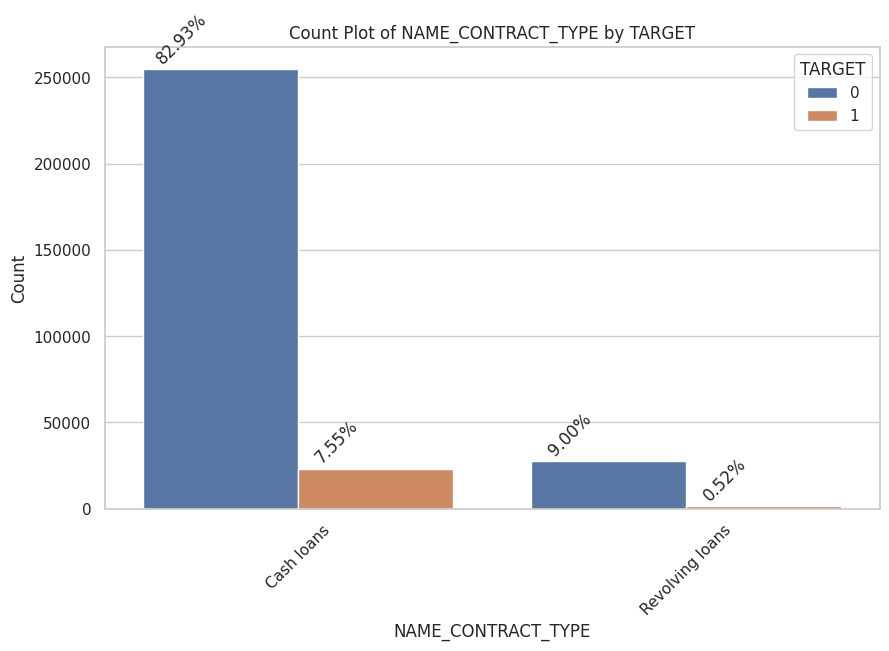

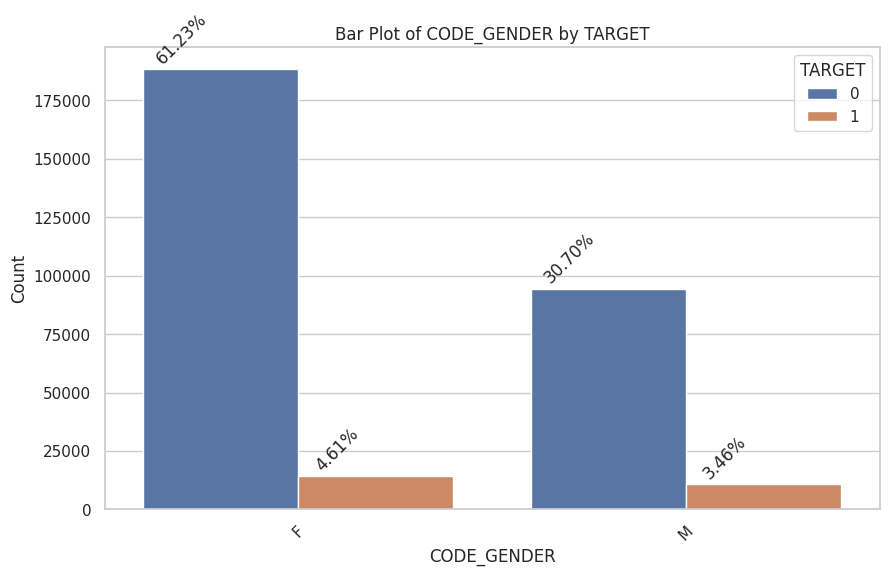

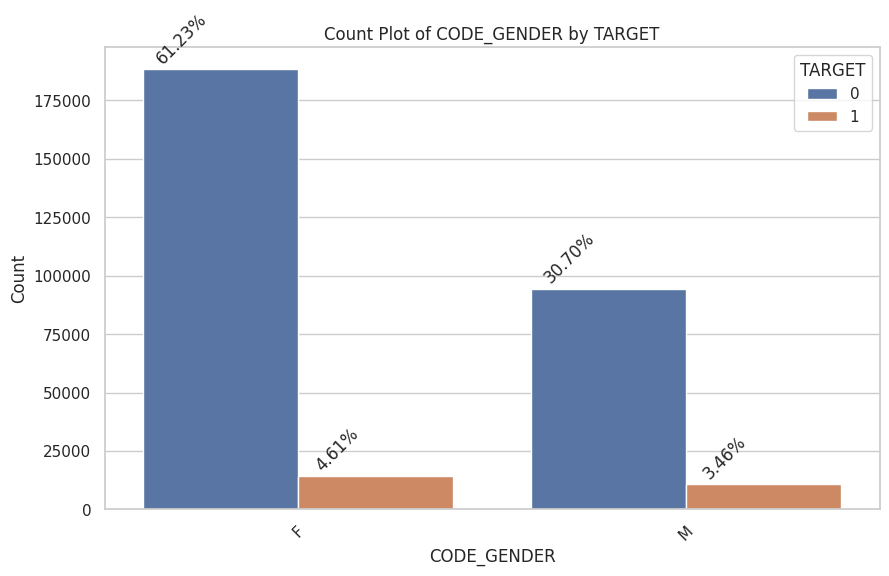

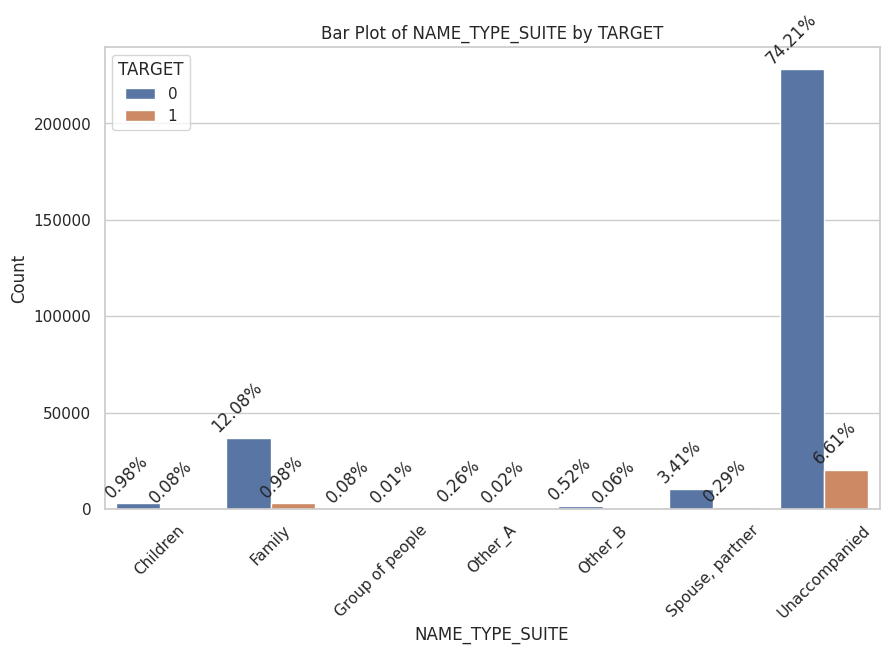

...

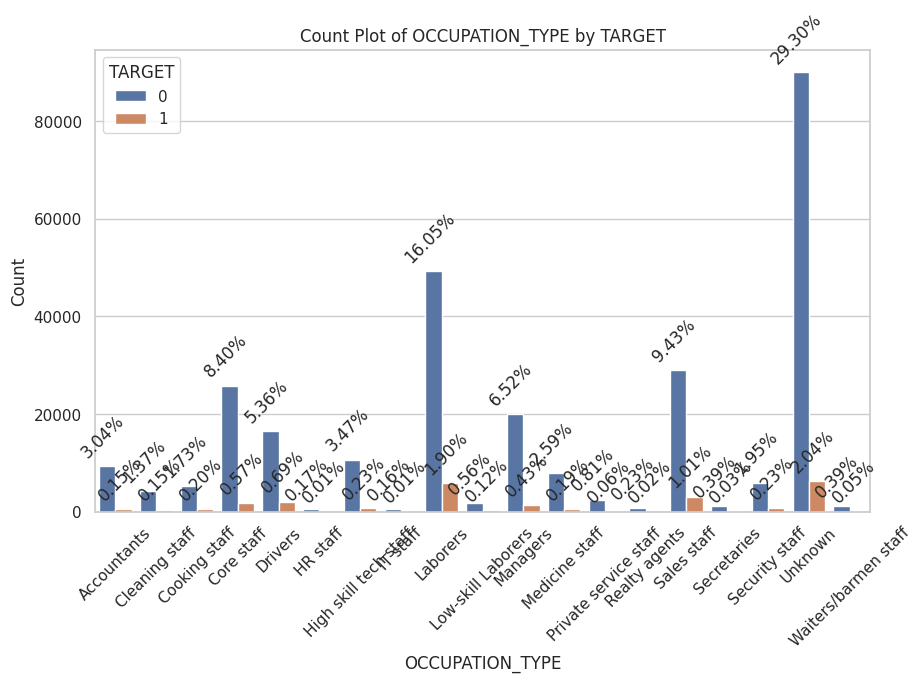

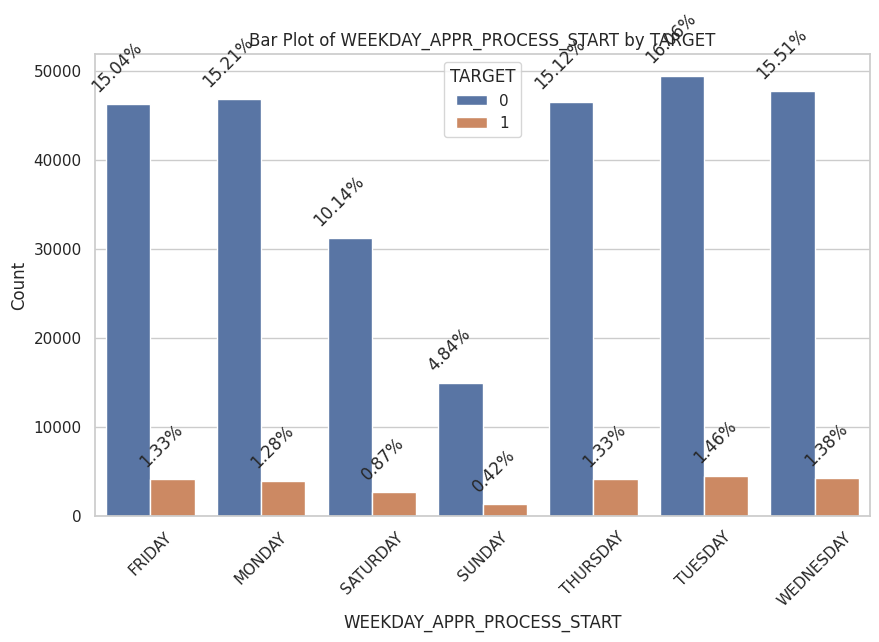

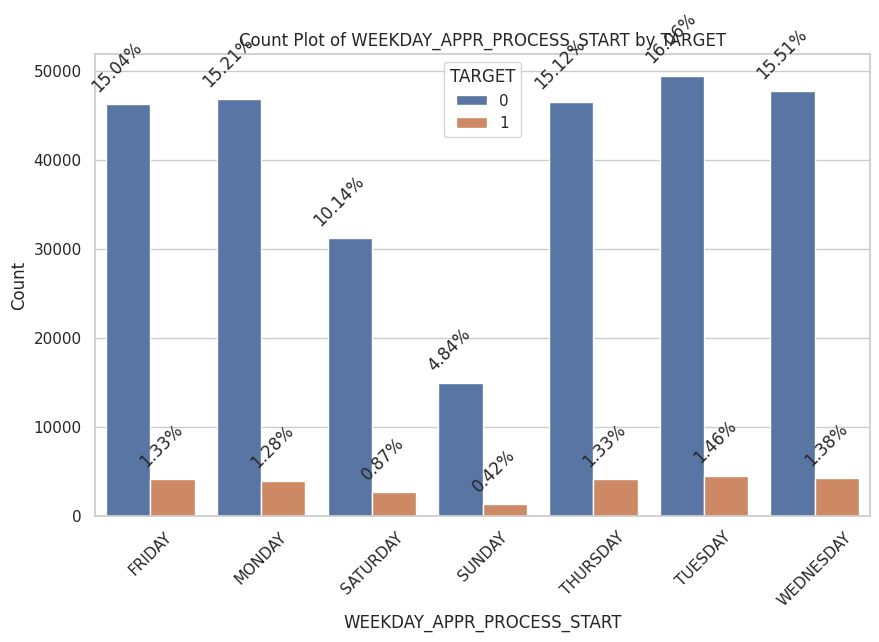

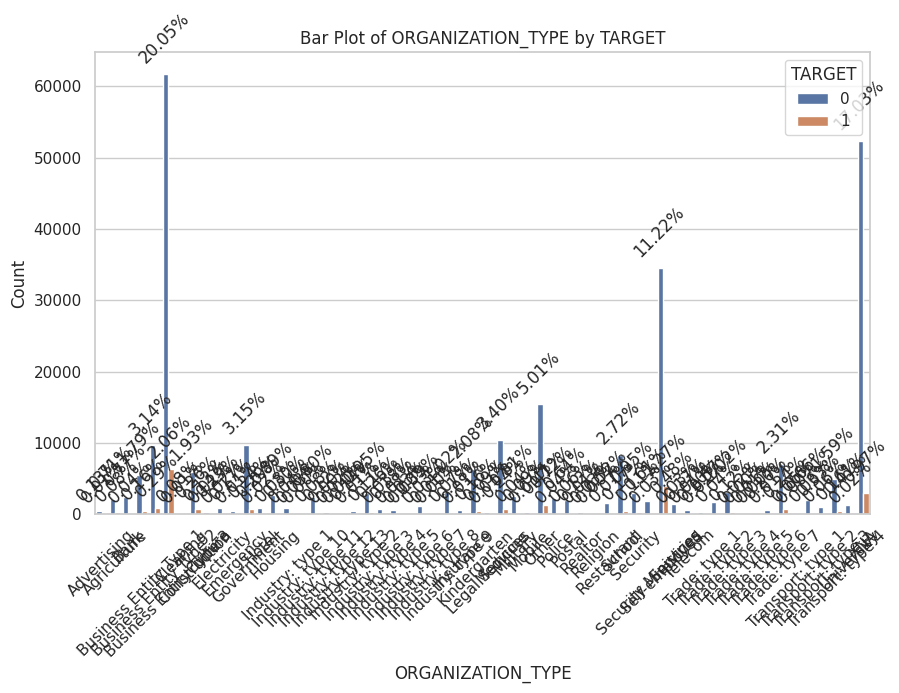

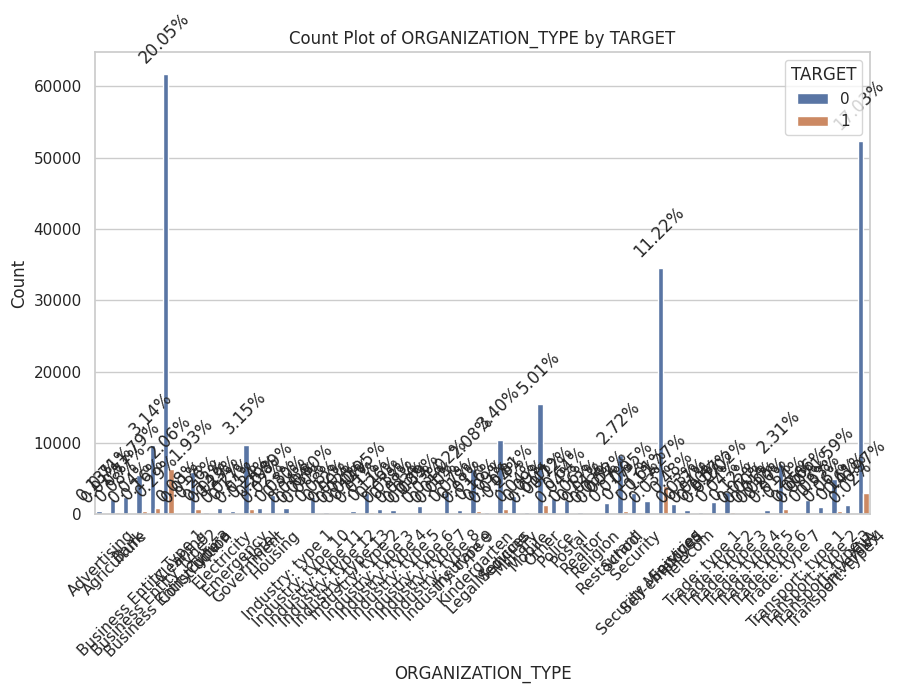

In [ ]:

def bivariate_analysis_categorical(application_data_df, category_columns):
    for column in category_columns:
        # Bar Plot
        plt.figure(figsize=(10, 6))
        sns.countplot(x=column, hue='TARGET', data=application_data_df)
        plt.title(f'Bar Plot of {column} by TARGET')
        plt.xlabel(column)
        plt.ylabel('Count')
        # Rotate x-axis labels by 45 degrees
        plt.xticks(rotation=45)

        # Annotate with percentage information
        total_count = len(application_data_df)
        for p in plt.gca().patches:
            height = p.get_height()
            if height > 0:
                plt.text(p.get_x() + p.get_width() / 2 - 0.1, height + 1000,
                         f'{height/total_count:.2%}', ha='center', va='bottom', rotation=45)

        plt.show()

        # Count Plot
        plt.figure(figsize=(10, 6))
        sns.countplot(x=column, hue='TARGET', data=application_data_df)
        plt.title(f'Count Plot of {column} by TARGET')
        plt.xlabel(column)
        plt.ylabel('Count')
        # Rotate x-axis labels by 45 degrees
        plt.xticks(rotation=45)

        # Annotate with percentage information
        total_count = len(application_data_df)
        for p in plt.gca().patches:
            height = p.get_height()
            if height > 0:
                plt.text(p.get_x() + p.get_width() / 2 - 0.1, height + 1000,
                         f'{height/total_count:.2%}', ha='center', va='bottom', rotation=45)

        plt.show()


bivariate_analysis_categorical(application_data_df, category_columns)


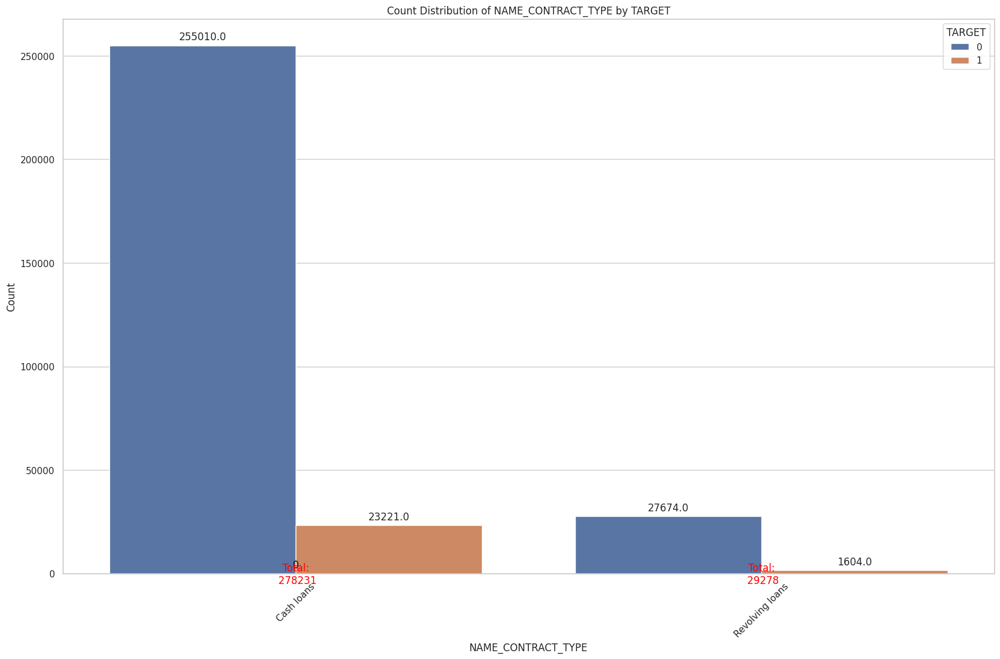

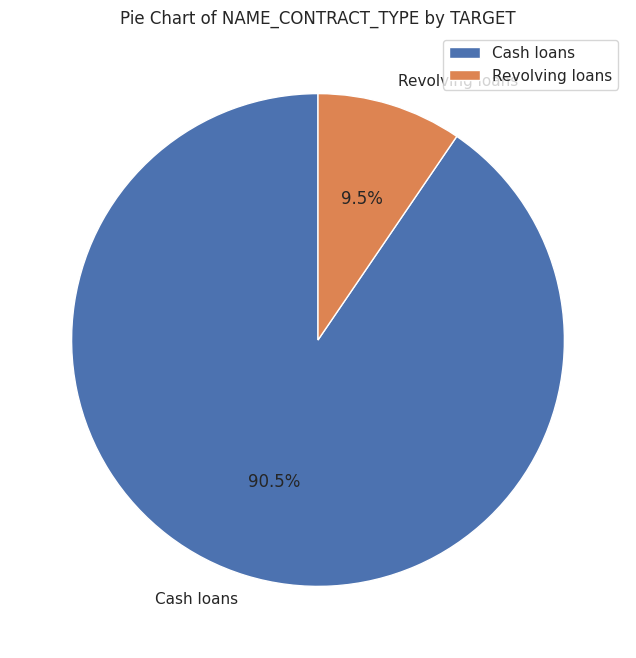

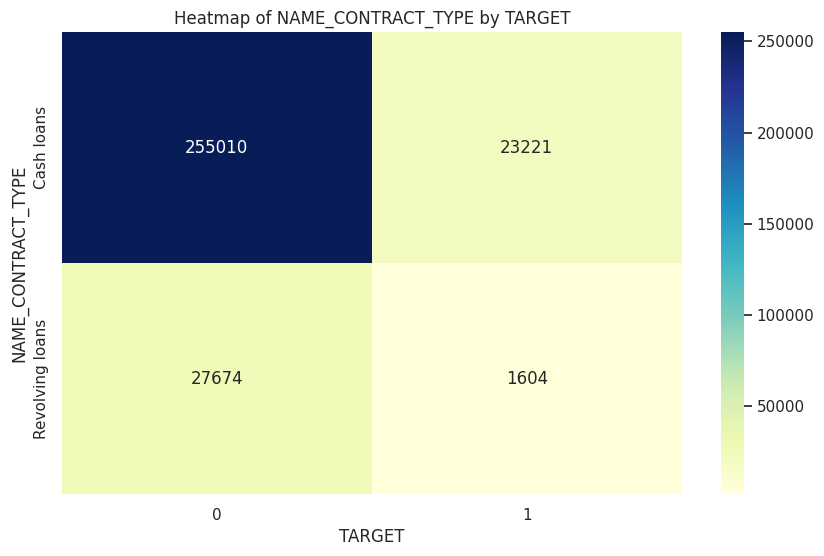


--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------



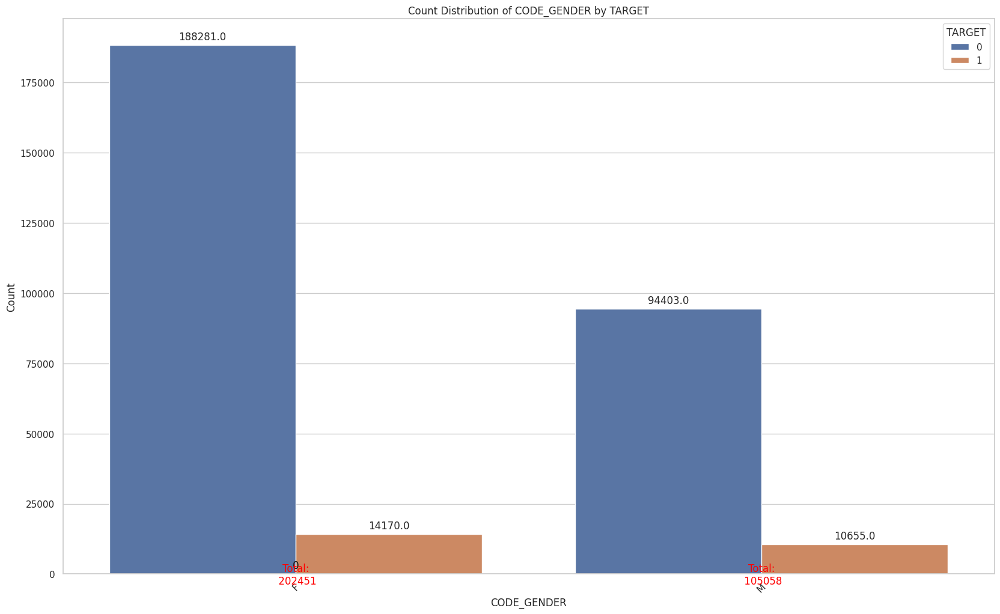

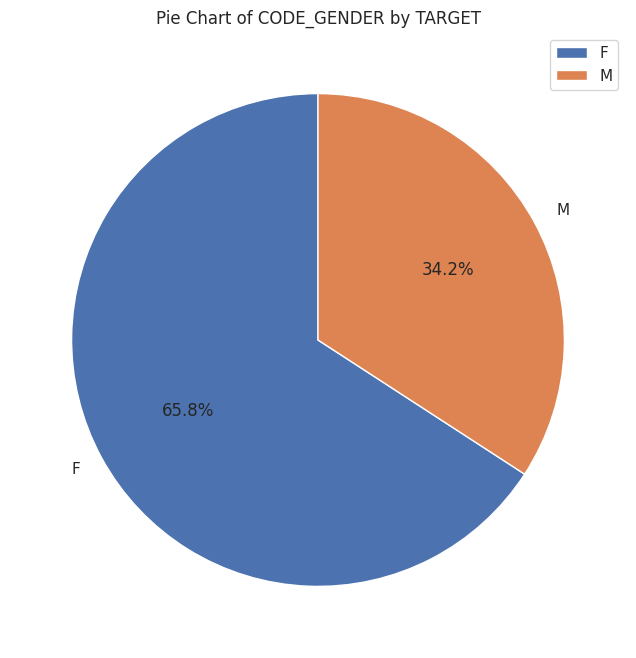

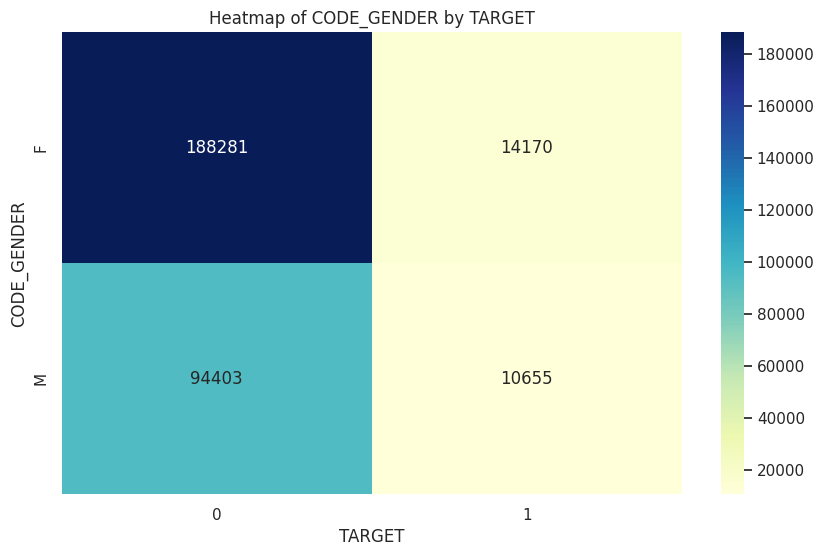


--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------



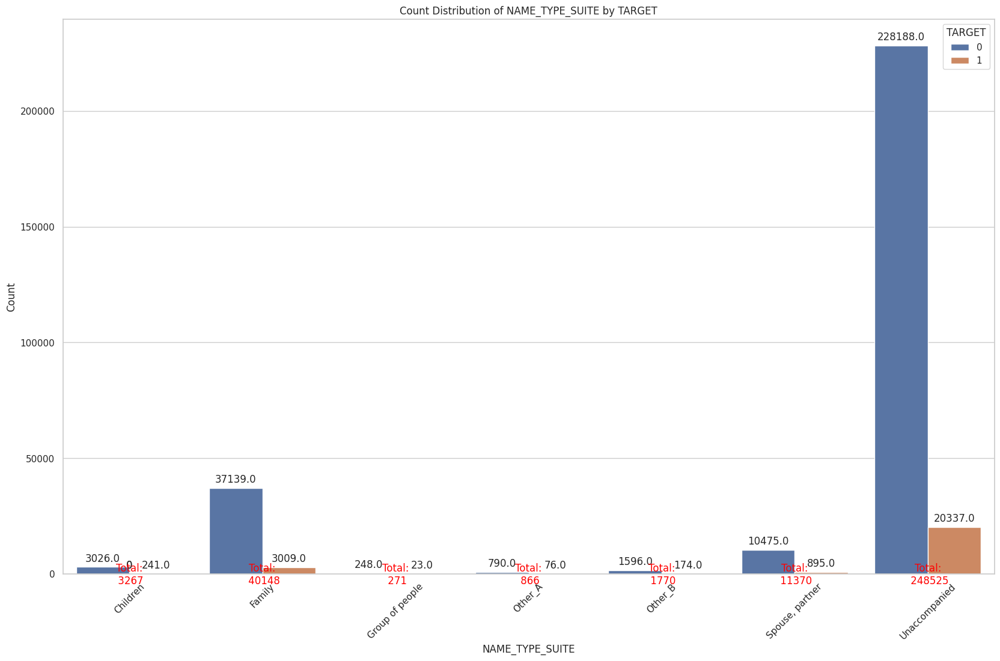

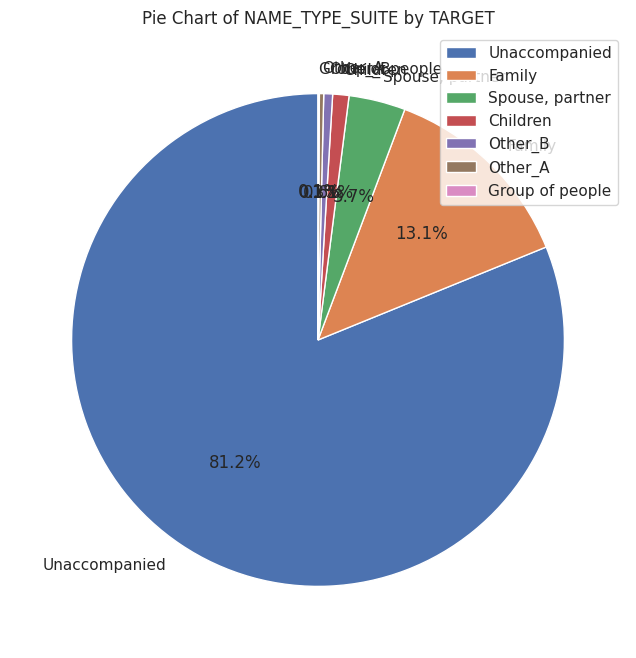

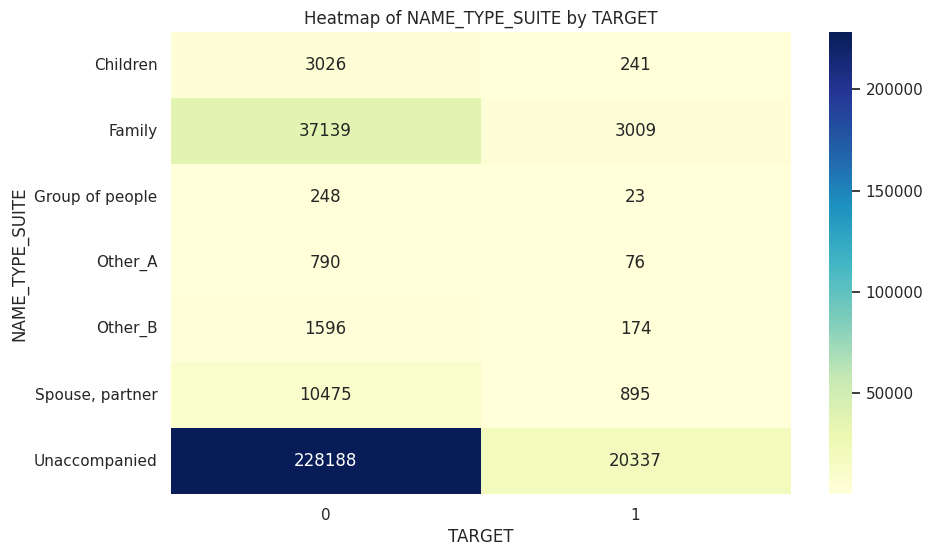


--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------



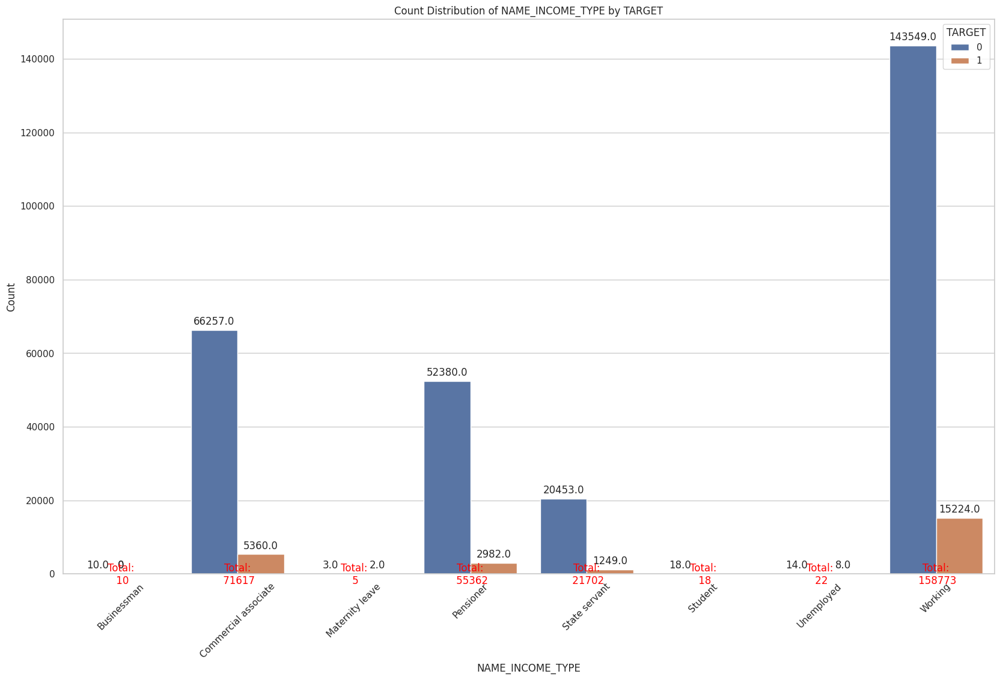

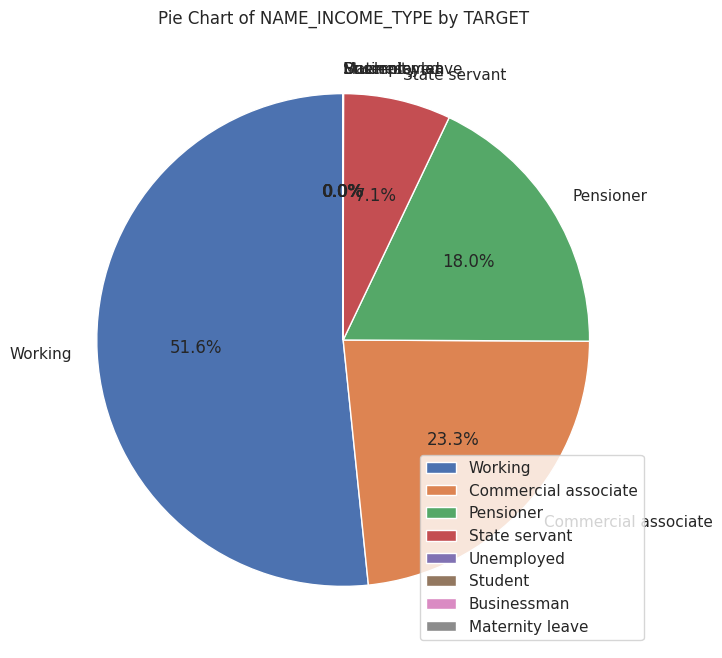

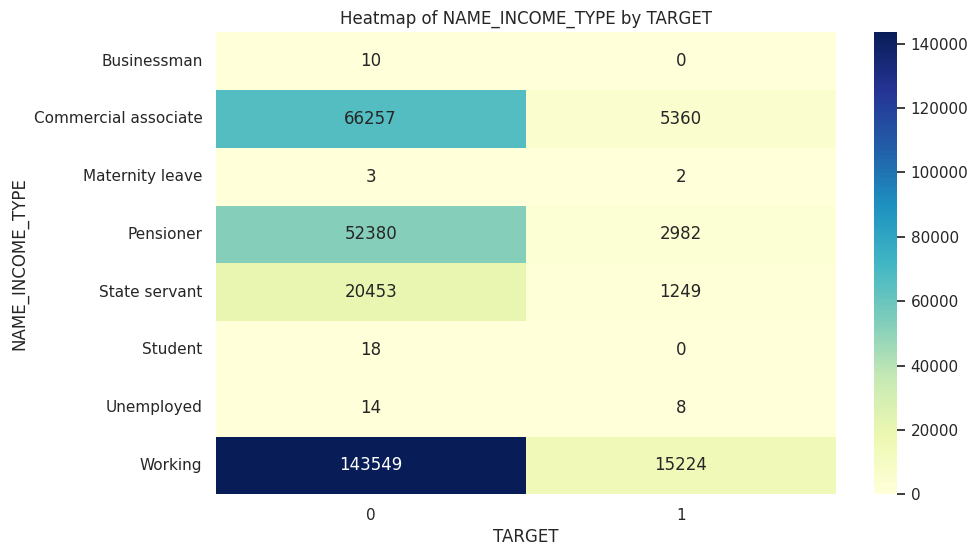


--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------



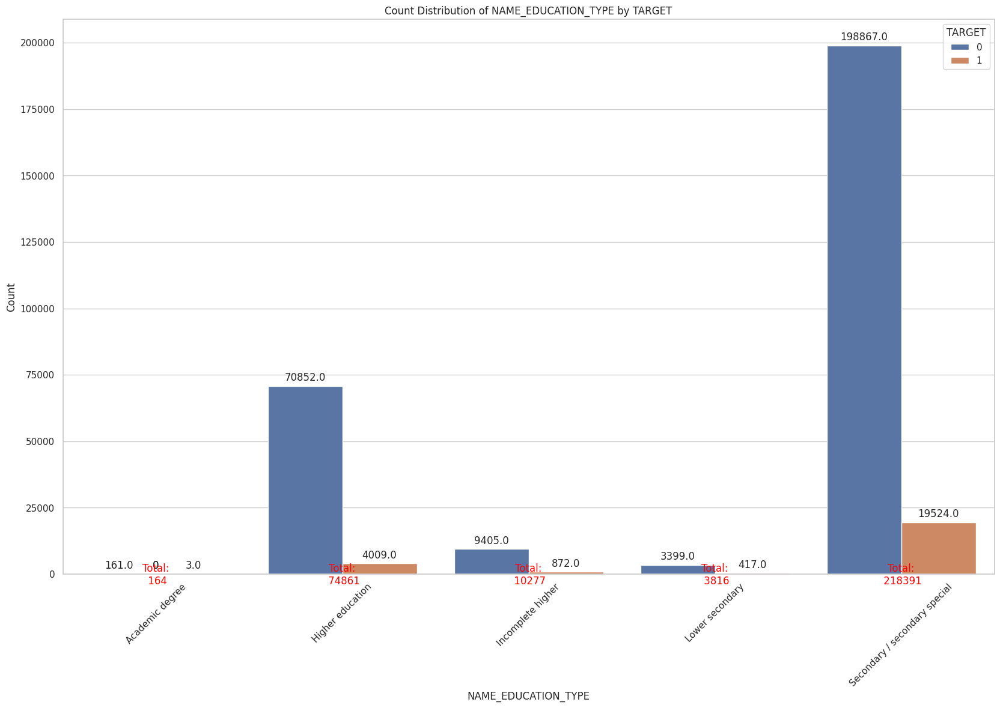

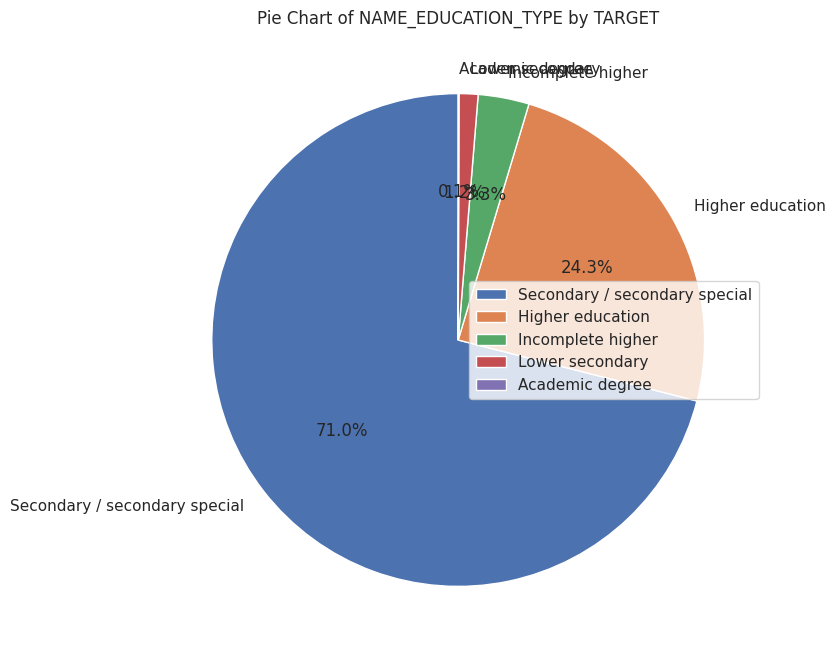

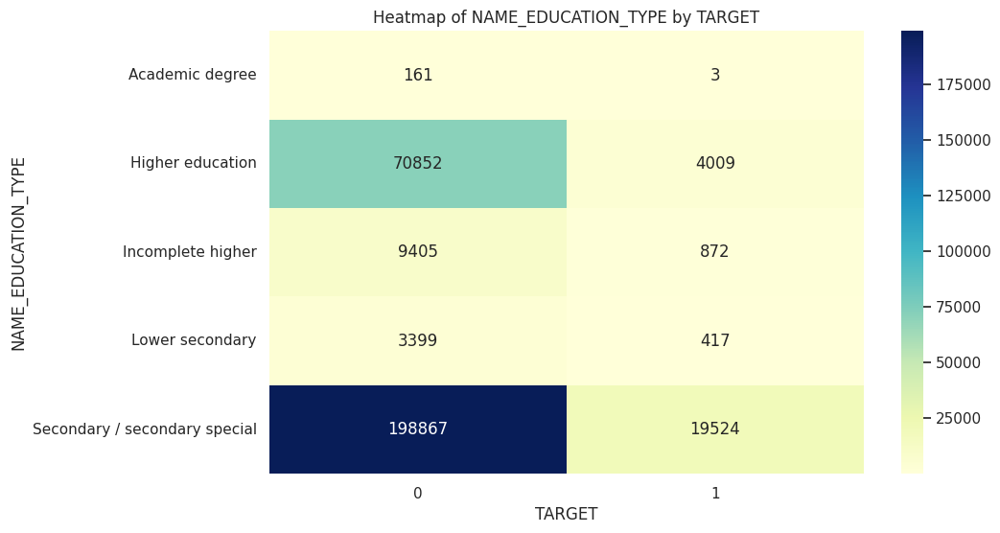


--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------



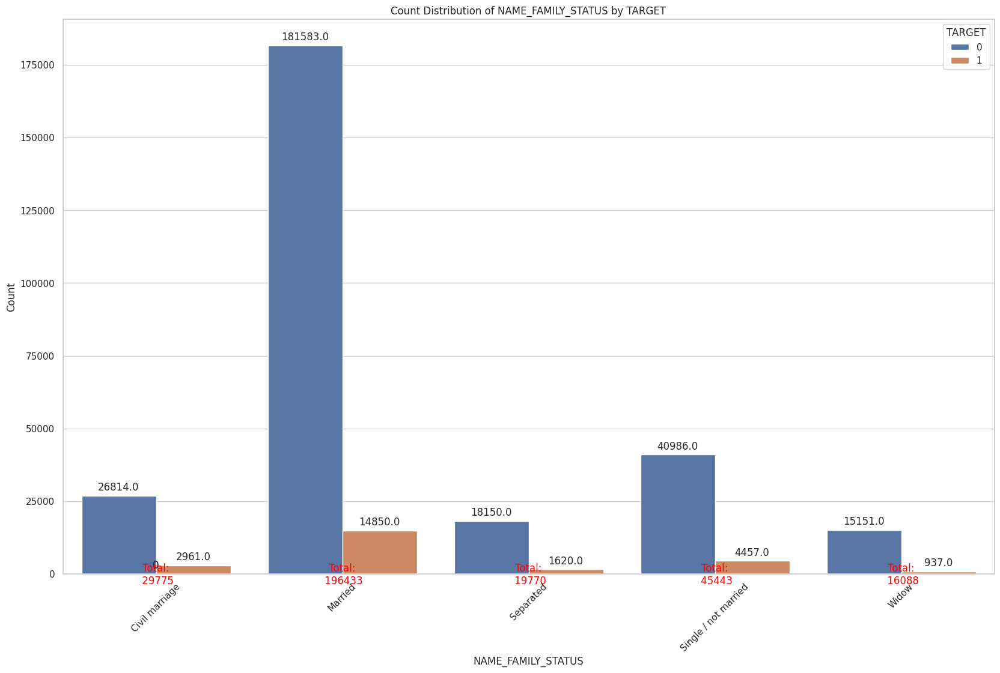

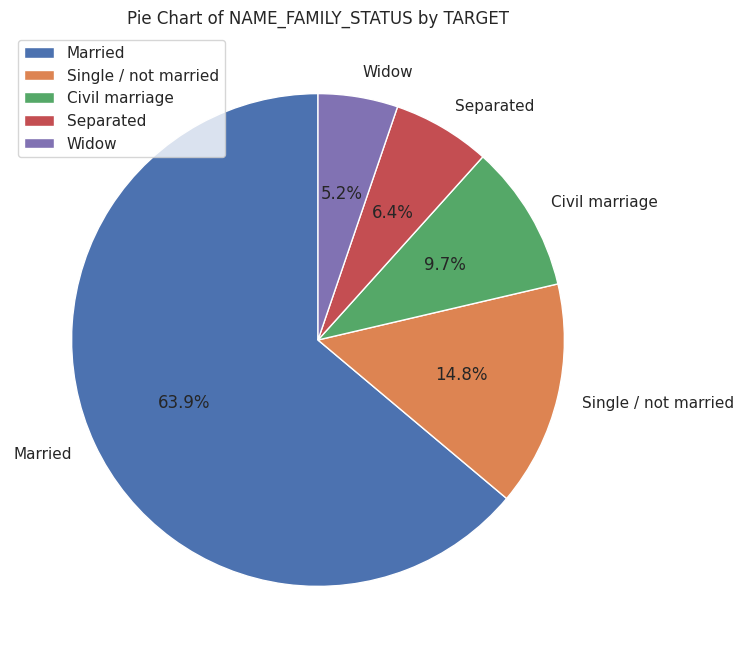

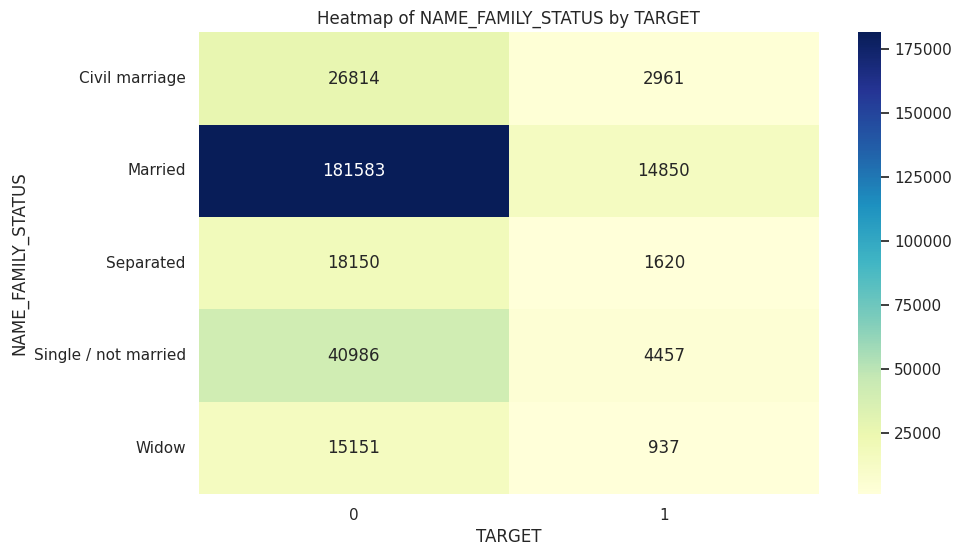


--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------



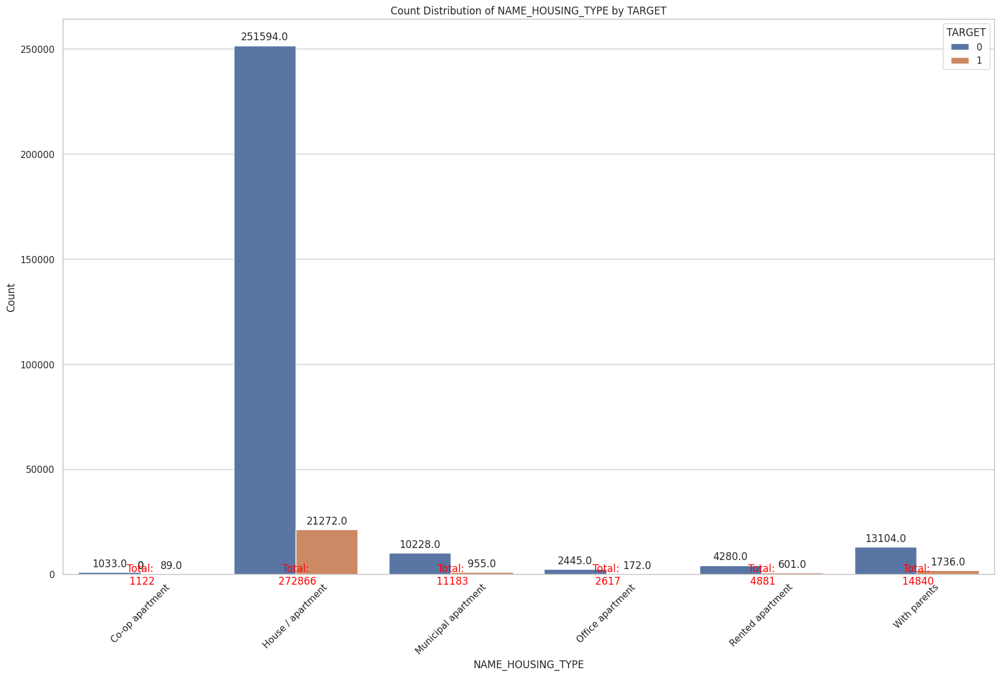

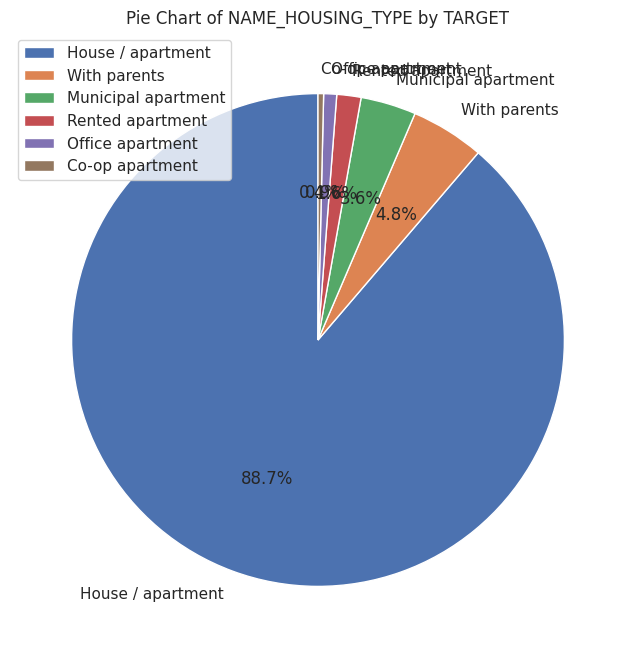

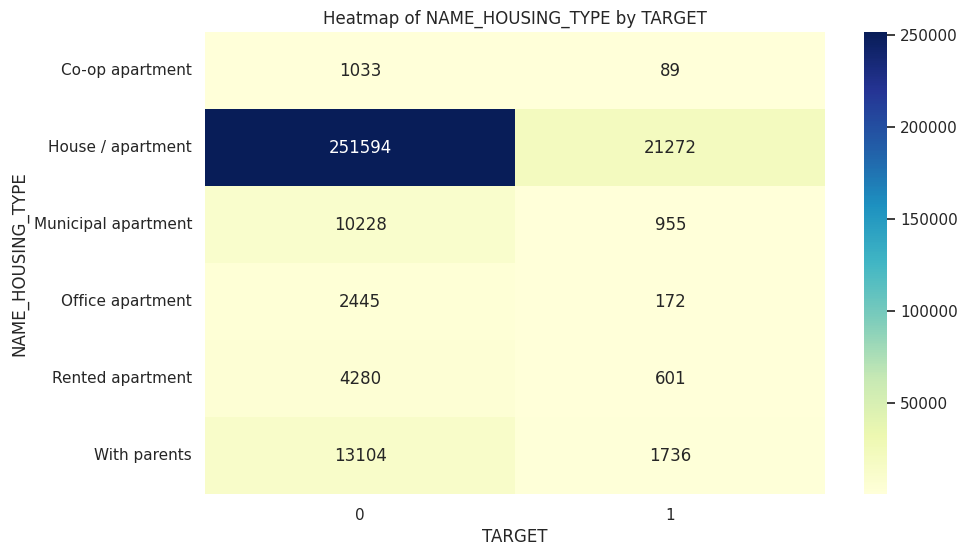


--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------



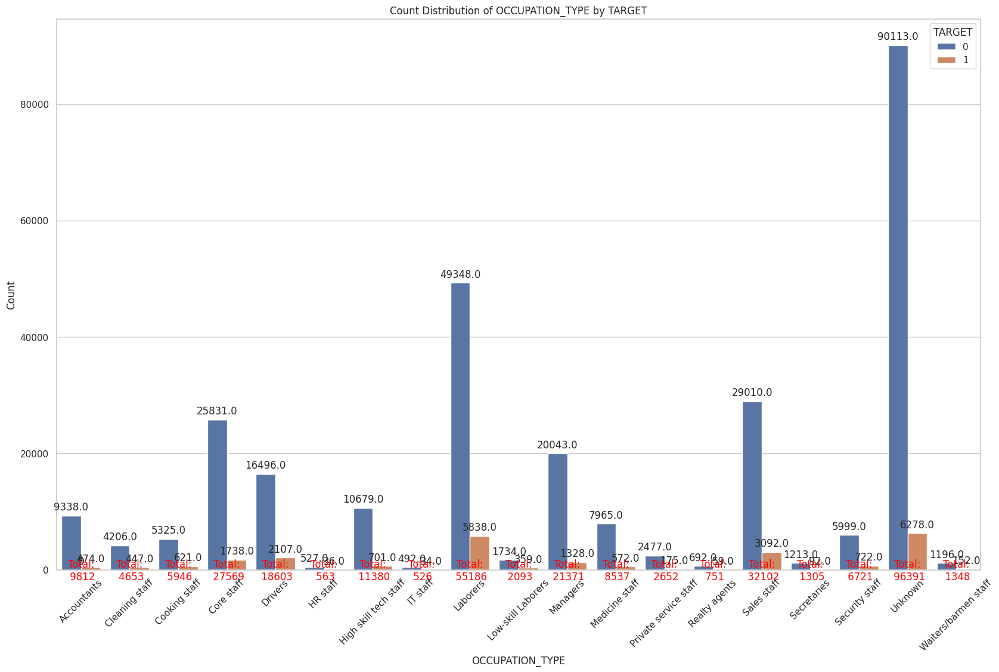

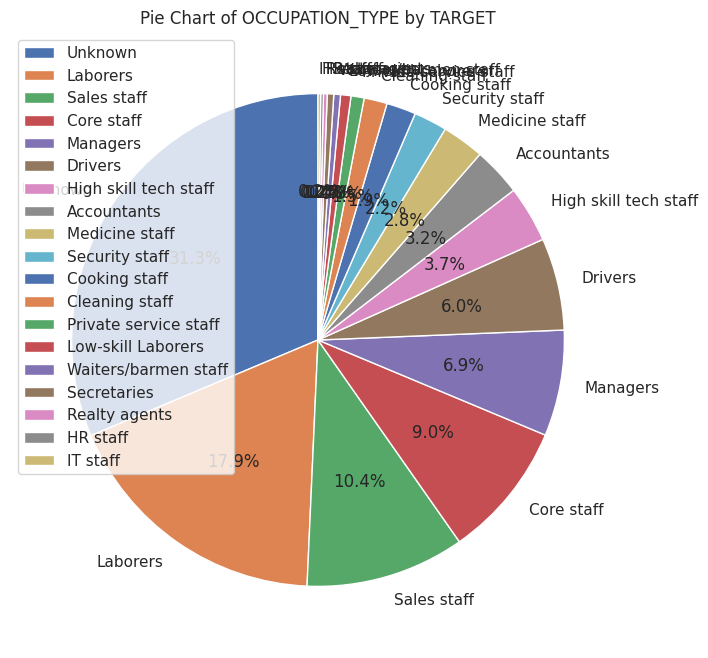

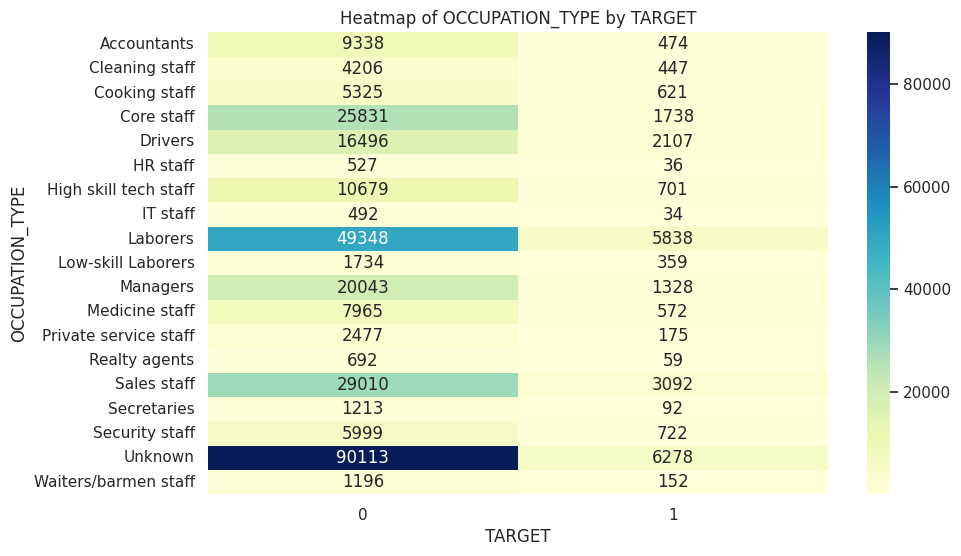


--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------



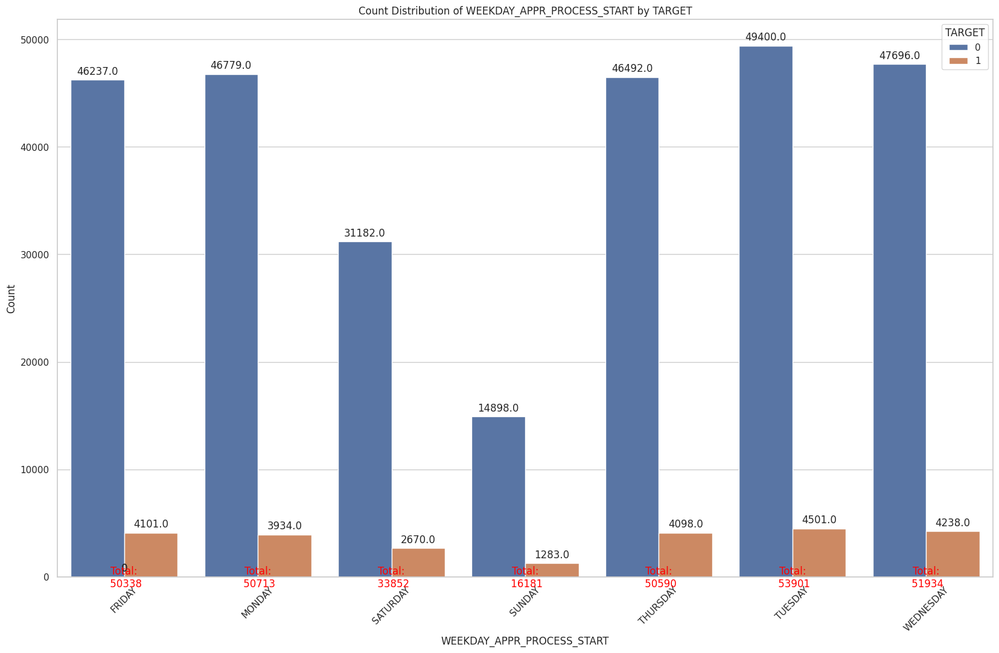

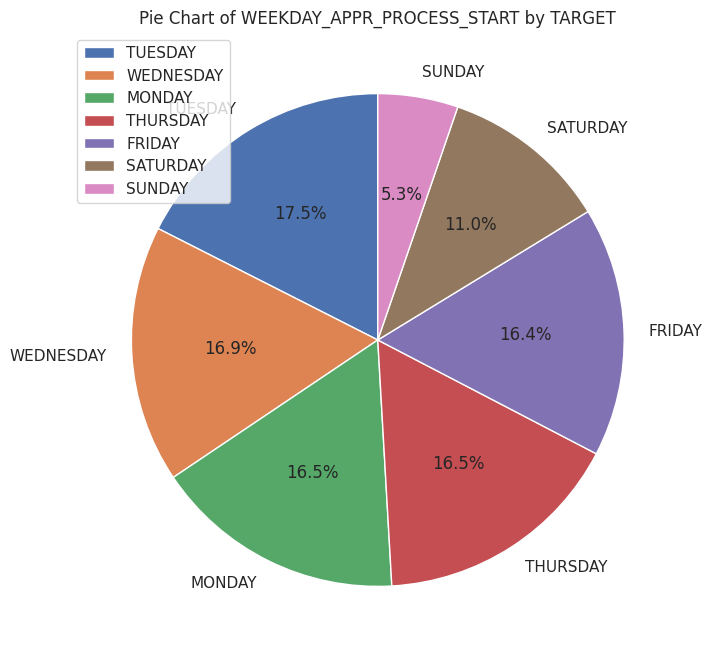

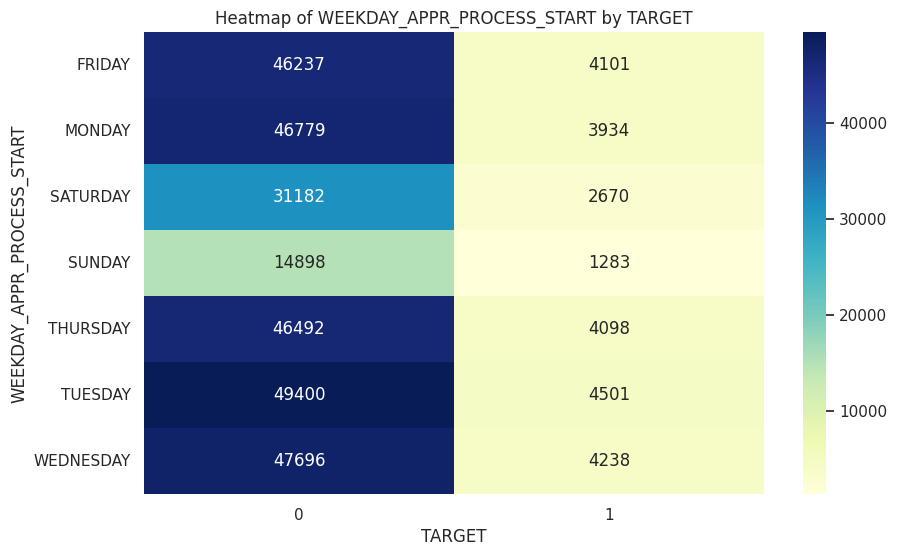


--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------



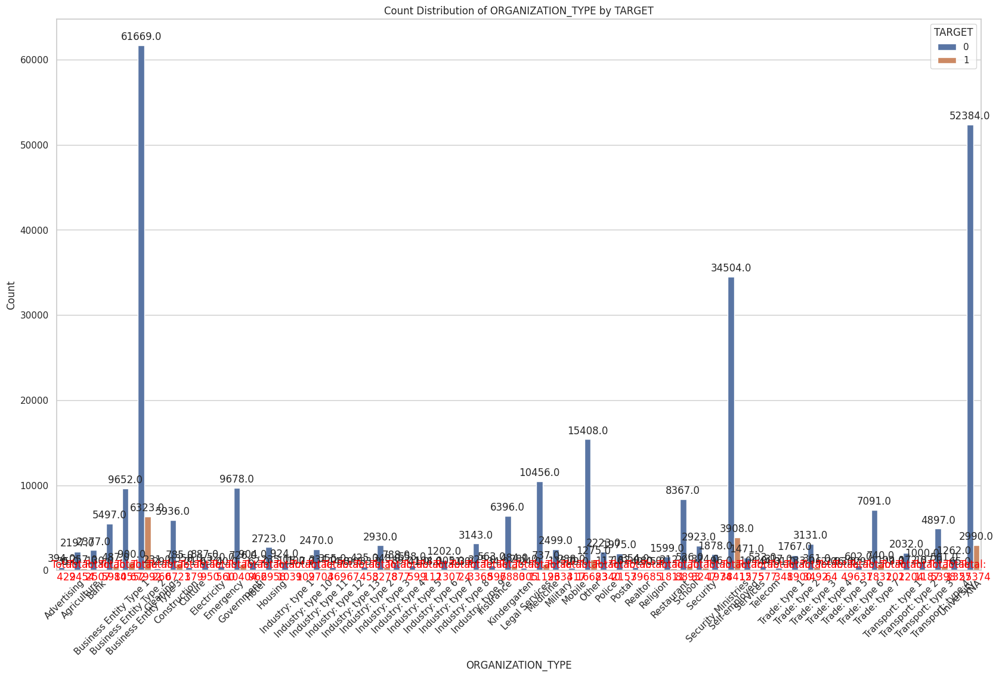

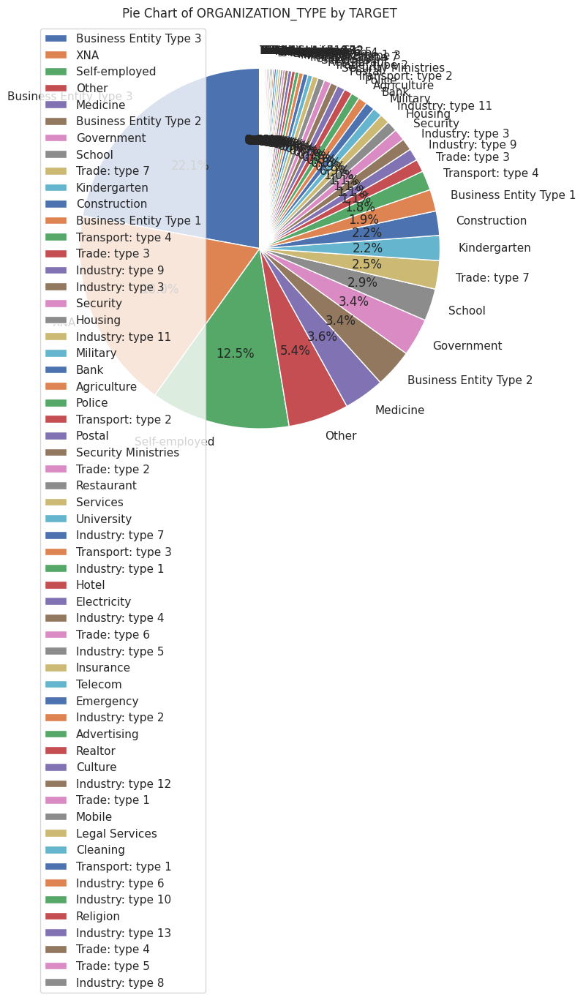

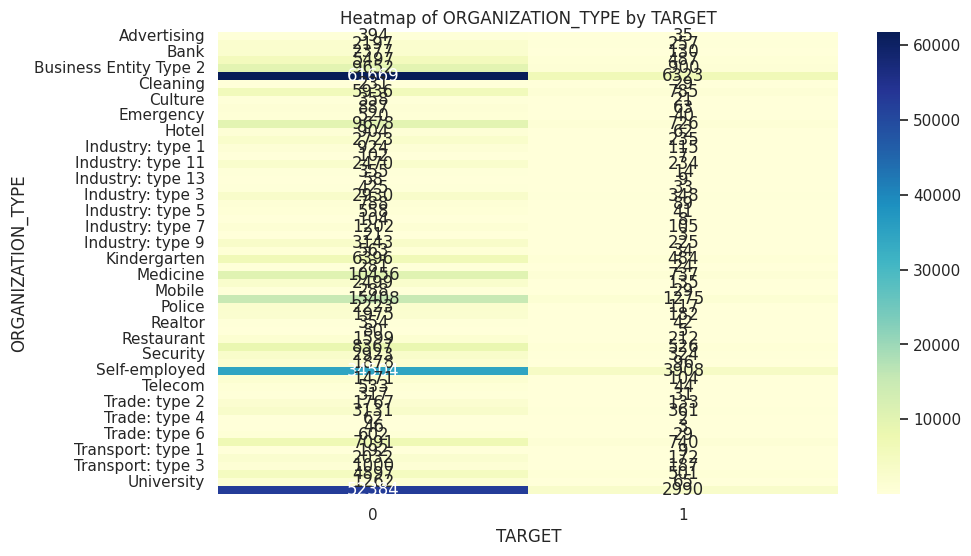


--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------

+----------------------------+-------------------------------+--------------+---------------------+---------------------+
|           Column           |           Category            | Total Counts | TARGET=0 Percentage | TARGET=1 Percentage |
+----------------------------+-------------------------------+--------------+---------------------+---------------------+
|     NAME_CONTRACT_TYPE     |          Cash loans           |    278231    |  91.65405724020688  |  8.345942759793122  |
|     NAME_CONTRACT_TYPE     |        Revolving loans        |    29278     |  94.52148370790354  | 5.4785162920964545  |
|        CODE_GENDER         |               F               |    202451    |  93.00077549629293  |  6.999224503707071  |
|        CODE_GENDER         |               M               |   

In [ ]:

category_percentage_data_all = []

for column in category_columns:

    # 1. Count Plot
    plt.figure(figsize=(20, 12))
    count_plot = sns.countplot(x=column, hue='TARGET', data=application_data_df)

    # Annotate count on each bar
    for p in count_plot.patches:
        count_plot.annotate(f'{p.get_height()}', (p.get_x() + p.get_width() / 2., p.get_height()),
                             ha='center', va='center', xytext=(0, 10), textcoords='offset points')

    # Calculate and annotate the sum of counts for each category
    total_counts = application_data_df.groupby(column)['TARGET'].count().reset_index()

    category_percentage_data = []

    for i, value in enumerate(total_counts['TARGET']):
        target_0_percentage = application_data_df[(application_data_df[column] == total_counts[column][i]) & (application_data_df['TARGET'] == 0)].shape[0] / value * 100
        target_1_percentage = application_data_df[(application_data_df[column] == total_counts[column][i]) & (application_data_df['TARGET'] == 1)].shape[0] / value * 100

        count_plot.annotate(f'Total:\n {value}', (i, 0), ha='center', va='bottom', xytext=(0, -15), textcoords='offset points', color='red')

        category_percentage_data.append([column, total_counts[column][i], value, target_0_percentage, target_1_percentage])

        # Annotate tabulated data on the graph
        #plt.text(i, count_plot.get_ylim()[1]/2, f'{column}: {total_counts[column][i]}\nTARGET=0: {target_0_percentage:.2f}%\nTARGET=1: {target_1_percentage:.2f}%', rotation=90, ha='center', va='center', color='black')

    plt.title(f'Count Distribution of {column} by TARGET')
    plt.xlabel(column)
    plt.ylabel('Count')
    plt.xticks(rotation=45)
    plt.show()

    # 2. Pie Chart
    plt.figure(figsize=(8, 8))
    target_pie_data = application_data_df[column].value_counts()
    plt.pie(target_pie_data, labels=target_pie_data.index, autopct='%1.1f%%', startangle=90)

    plt.legend()  # Add this line to create the legend

    plt.title(f'Pie Chart of {column} by TARGET')

    plt.show()

    # 3. Heatmap
    count_distribution = pd.crosstab(application_data_df[column], application_data_df['TARGET'])
    plt.figure(figsize=(10, 6))
    sns.heatmap(count_distribution, annot=True, fmt='d', cmap='YlGnBu')
    plt.title(f'Heatmap of {column} by TARGET')
    plt.xlabel('TARGET')
    plt.ylabel(column)
    plt.show()

    print("\n" + "-"*200 + "\n")

    category_percentage_data_all.extend(category_percentage_data)

# Print the data using tabulate at the end
headers = ['Column', 'Category', 'Total Counts', 'TARGET=0 Percentage', 'TARGET=1 Percentage']
print(tabulate(category_percentage_data_all, headers=headers, tablefmt='pretty'))

# Find and print the top 5 data based on TARGET=0 Percentage and TARGET=1 Percentage
sorted_data_target_0 = sorted(category_percentage_data_all, key=lambda x: x[3], reverse=True)[:5]
sorted_data_target_1 = sorted(category_percentage_data_all, key=lambda x: x[4], reverse=True)[:5]

print("\nTop 5 based on TARGET=0 Percentage:")
print(tabulate(sorted_data_target_0, headers=headers, tablefmt='pretty'))

print("\nTop 5 based on TARGET=1 Percentage:")
print(tabulate(sorted_data_target_1, headers=headers, tablefmt='pretty'))




**Inference** :

*   Most clients opt for Cash loans than Revolving loans
*   Also most people comes Unaccompanied to apply for loan, although few prefer to take family as well
*  Understandably, Working class people opt for loans compared to other classes
*   Number of clients in Married class is much more than other claasses
*  Although very less in number, Businessman, Student and clients with Academic degree tends to payback loans better
* Clients who are in MAternity leave, Unemployed, and clients who live in Rented apartments are having difficulty i paying back loans
* Females have more chance of paying back loans



**# CORRELATION MATRIX FOR NUMERICAL COLUMNS**


Top 10 Correlation combinations for TARGET=0:

+---+----------------------------+-----------------------------+--------------------+
|   |          Column 1          |          Column 2           |    Correlation     |
+---+----------------------------+-----------------------------+--------------------+
| 0 |  OBS_60_CNT_SOCIAL_CIRCLE  |  OBS_30_CNT_SOCIAL_CIRCLE   | 0.9983922807247713 |
| 1 |    REGION_RATING_CLIENT    | REGION_RATING_CLIENT_W_CITY | 0.9501481450718366 |
| 2 |        CNT_CHILDREN        |       CNT_FAM_MEMBERS       | 0.8785710584665811 |
| 3 |      AMT_GOODS_PRICE       |         AMT_CREDIT          | 0.8751193244133442 |
| 4 | REG_REGION_NOT_WORK_REGION | LIVE_REGION_NOT_WORK_REGION |  0.86186131656604  |
| 5 |  DEF_30_CNT_SOCIAL_CIRCLE  |  DEF_60_CNT_SOCIAL_CIRCLE   | 0.8568925544216597 |
| 6 |   REG_CITY_NOT_WORK_CITY   |   LIVE_CITY_NOT_WORK_CITY   | 0.8303787128775756 |
| 7 |        AMT_ANNUITY         |         AMT_CREDIT          | 0.7245765993895724 |
| 8 | 

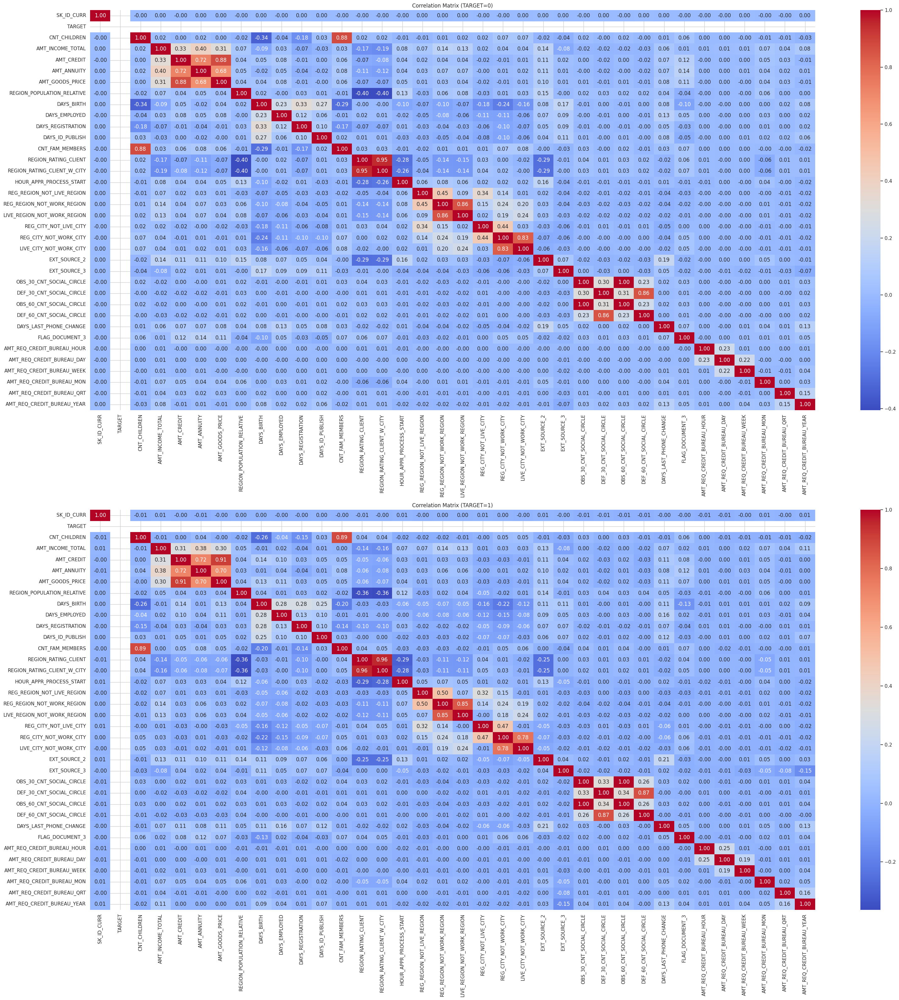

In [ ]:
# Identify numerical columns
numerical_columns = application_data_df.select_dtypes(include=['int64', 'float64']).columns

# Separate data for TARGET=0 and TARGET=1
data_target_0 = application_data_df[application_data_df['TARGET'] == 0]
data_target_1 = application_data_df[application_data_df['TARGET'] == 1]

# Calculate correlations separately for TARGET=0 and TARGET=1
correlation_target_0 = data_target_0[numerical_columns].corr()
correlation_target_1 = data_target_1[numerical_columns].corr()

# Function to get top correlated columns
def get_top_correlations(correlation_matrix, target):
    correlations = correlation_matrix.unstack().sort_values(ascending=False)
    top_correlations = correlations[correlations.index.get_level_values(0) != correlations.index.get_level_values(1)].head(20)

    # Display only even entries
    top_correlations = top_correlations.iloc[1::2]

    print(f"\nTop 10 Correlation combinations for TARGET={target}:\n")
    print(tabulate(top_correlations.reset_index(), headers=['Column 1', 'Column 2', 'Correlation'], tablefmt='pretty'))

# Print top correlations for TARGET=0
get_top_correlations(correlation_target_0, target=0)

# Print top correlations for TARGET=1
get_top_correlations(correlation_target_1, target=1)

# Increase figure size for both heatmaps
plt.figure(figsize=(32, 32))

# Correlation matrix for TARGET=0
plt.subplot(2, 1, 1)
sns.heatmap(correlation_target_0, annot=True, cmap='coolwarm', fmt='.2f')
plt.title('Correlation Matrix (TARGET=0)')

# Correlation matrix for TARGET=1
plt.subplot(2, 1, 2)
sns.heatmap(correlation_target_1, annot=True, cmap='coolwarm', fmt='.2f')
plt.title('Correlation Matrix (TARGET=1)')

plt.tight_layout()
plt.show()


**Inference**:
* Top 10 correlations in both the Default and non default population are similar

**#COMBINATION WITH THE HIGHEST & LOWEST PERCENTAGE OF LOAN PAYMENT DIFFICULTIES**



In [ ]:

# Function to get combination with the highest & lowest percentage of Loan Payment Difficulties
def find_highest_and_lowest_difficulties_category(df, features):
    # Create a new column for the combination of categories
    df['Category_Combination'] = df[features].astype(str).agg('-'.join, axis=1)

    # Calculate the percentage of TARGET=0 and TARGET=1 per category combination
    perc_0 = df[df['TARGET'] == 0].groupby('Category_Combination').size() / len(df) * 100
    perc_1 = df[df['TARGET'] == 1].groupby('Category_Combination').size() / len(df) * 100

    perc_0 = perc_0.reset_index(name='Percentage_TARGET_0')
    perc_1 = perc_1.reset_index(name='Percentage_TARGET_1')

    # Find the combination with the highest percentage of TARGET=0
    max_category_combination_0 = perc_0.loc[perc_0['Percentage_TARGET_0'].idxmax()]['Category_Combination']
    max_percentage_0 = perc_0['Percentage_TARGET_0'].max()

    # Find the combination with the lowest percentage of TARGET=1
    min_category_combination_1 = perc_1.loc[perc_1['Percentage_TARGET_1'].idxmin()]['Category_Combination']
    min_percentage_1 = perc_1['Percentage_TARGET_1'].min()

    # Print information
    print(f"The combination with the highest percentage of Loan Payment Difficulties (TARGET=0) is: {max_category_combination_0}")
    #print(f"Percentage of that category compared to the total dataframe: {max_percentage_0:.2f}%")

    print(f"\nThe combination with the lowest percentage of Loan Payment Difficulties (TARGET=1) is: {min_category_combination_1}")
    #print(f"Percentage of that category compared to the total dataframe: {min_percentage_1:.2f}%")

    # Drop the temporary column
    df.drop('Category_Combination', axis=1, inplace=True)

find_highest_and_lowest_difficulties_category(application_data_df, category_columns)


The combination with the highest percentage of Loan Payment Difficulties (TARGET=0) is: Cash loans-F-Unaccompanied-Pensioner-Secondary / secondary special-Married-House / apartment-Unknown-TUESDAY-XNA

The combination with the lowest percentage of Loan Payment Difficulties (TARGET=1) is: Cash loans-F-Children-Commercial associate-Higher education-Married-House / apartment-Core staff-MONDAY-Self-employed


# **4. "previous_application.csv"**

**4.1 : Initial Exploration**

In [ ]:
previous_application_df

,SK_ID_PREV,SK_ID_CURR,NAME_CONTRACT_TYPE,AMT_ANNUITY,AMT_APPLICATION,AMT_CREDIT,AMT_DOWN_PAYMENT,AMT_GOODS_PRICE,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,...,NAME_SELLER_INDUSTRY,CNT_PAYMENT,NAME_YIELD_GROUP,PRODUCT_COMBINATION,DAYS_FIRST_DRAWING,DAYS_FIRST_DUE,DAYS_LAST_DUE_1ST_VERSION,DAYS_LAST_DUE,DAYS_TERMINATION,NFLAG_INSURED_ON_APPROVAL
0,2030495,271877,Consumer loans,1730.430,17145.0,17145.0,0.0,17145.0,SATURDAY,15,...,Connectivity,12.0,middle,POS mobile with interest,365243.0,-42.0,300.0,-42.0,-37.0,0.0
1,2802425,108129,Cash loans,25188.615,607500.0,679671.0,NaN,607500.0,THURSDAY,11,...,XNA,36.0,low_action,Cash X-Sell: low,365243.0,-134.0,916.0,365243.0,365243.0,1.0
2,2523466,122040,Cash loans,15060.735,112500.0,136444.5,NaN,112500.0,TUESDAY,11,...,XNA,12.0,high,Cash X-Sell: high,365243.0,-271.0,59.0,365243.0,365243.0,1.0
3,2819243,176158,Cash loans,47041.335,450000.0,470790.0,NaN,450000.0,MONDAY,7,...,XNA,12.0,middle,Cash X-Sell: middle,365243.0,-482.0,-152.0,-182.0,-177.0,1.0
4,1784265,202054,Cash loans,31924.395,337500.0,404055.0,NaN,337500.0,THURSDAY,9,...,XNA,24.0,high,Cash Street: high,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1670209,2300464,352015,Consumer loans,14704.290,267295.5,311400.0,0.0,267295.5,WEDNESDAY,12,...,Furniture,30.0,low_normal,POS industry with interest,365243.0,-508.0,362.0,-358.0,-351.0,0.0
1670210,2357031,334635,Consumer loans,6622.020,87750.0,64291.5,29250.0,87750.0,TUESDAY,15,...,Furniture,12.0,middle,POS industry with interest,365243.0,-1604.0,-1274.0,-1304.0,-1297.0,0.0
1670211,2659632,249544,Consumer loans,11520.855,105237.0,102523.5,10525.5,105237.0,MONDAY,12,...,Consumer electronics,10.0,low_normal,POS household with interest,365243.0,-1457.0,-1187.0,-1187.0,-1181.0,0.0
1670212,2785582,400317,Cash loans,18821.520,180000.0,191880.0,NaN,180000.0,WEDNESDAY,9,...,XNA,12.0,low_normal,Cash X-Sell: low,365243.0,-1155.0,-825.0,-825.0,-817.0,1.0


In [ ]:
#Glimpse at the initial portion of application_data_df.
print("Previous Application Data:")
previous_application_df.head()

Previous Application Data:


,SK_ID_PREV,SK_ID_CURR,NAME_CONTRACT_TYPE,AMT_ANNUITY,AMT_APPLICATION,AMT_CREDIT,AMT_DOWN_PAYMENT,AMT_GOODS_PRICE,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,...,NAME_SELLER_INDUSTRY,CNT_PAYMENT,NAME_YIELD_GROUP,PRODUCT_COMBINATION,DAYS_FIRST_DRAWING,DAYS_FIRST_DUE,DAYS_LAST_DUE_1ST_VERSION,DAYS_LAST_DUE,DAYS_TERMINATION,NFLAG_INSURED_ON_APPROVAL
0,2030495,271877,Consumer loans,1730.430,17145.0,17145.0,0.0,17145.0,SATURDAY,15,...,Connectivity,12.0,middle,POS mobile with interest,365243.0,-42.0,300.0,-42.0,-37.0,0.0
1,2802425,108129,Cash loans,25188.615,607500.0,679671.0,NaN,607500.0,THURSDAY,11,...,XNA,36.0,low_action,Cash X-Sell: low,365243.0,-134.0,916.0,365243.0,365243.0,1.0
2,2523466,122040,Cash loans,15060.735,112500.0,136444.5,NaN,112500.0,TUESDAY,11,...,XNA,12.0,high,Cash X-Sell: high,365243.0,-271.0,59.0,365243.0,365243.0,1.0
3,2819243,176158,Cash loans,47041.335,450000.0,470790.0,NaN,450000.0,MONDAY,7,...,XNA,12.0,middle,Cash X-Sell: middle,365243.0,-482.0,-152.0,-182.0,-177.0,1.0
4,1784265,202054,Cash loans,31924.395,337500.0,404055.0,NaN,337500.0,THURSDAY,9,...,XNA,24.0,high,Cash Street: high,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:
# To get a general understanding of the "previous_application_df" DataFrame's structure and contents.
previous_application_df.info(verbose=True)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1670214 entries, 0 to 1670213
Data columns (total 37 columns):
 #   Column                       Non-Null Count    Dtype  
---  ------                       --------------    -----  
 0   SK_ID_PREV                   1670214 non-null  int64  
 1   SK_ID_CURR                   1670214 non-null  int64  
 2   NAME_CONTRACT_TYPE           1670214 non-null  object 
 3   AMT_ANNUITY                  1297979 non-null  float64
 4   AMT_APPLICATION              1670214 non-null  float64
 5   AMT_CREDIT                   1670213 non-null  float64
 6   AMT_DOWN_PAYMENT             774370 non-null   float64
 7   AMT_GOODS_PRICE              1284699 non-null  float64
 8   WEEKDAY_APPR_PROCESS_START   1670214 non-null  object 
 9   HOUR_APPR_PROCESS_START      1670214 non-null  int64  
 10  FLAG_LAST_APPL_PER_CONTRACT  1670214 non-null  object 
 11  NFLAG_LAST_APPL_IN_DAY       1670214 non-null  int64  
 12  RATE_DOWN_PAYMENT            774370 non-nu

In [ ]:
# Checking no. of rows and columns of dataframe
previous_application_df.shape

(1670214, 37)

**4.2 : Identify and Handle Missing Values**

In [ ]:
# Find number of null values
null_counts = previous_application_df.isnull().sum()

# Calculate percentage of null values for each column
null_percentages = (null_counts / len(previous_application_df)) * 100

# Find columns with null percentage > 40%
cols_with_null_percentages_gt_40 = null_percentages[null_percentages > 40].index.tolist()
number_of_cols = len(cols_with_null_percentages_gt_40)
print(f"Number of columns with percentage of null values greater than 40%: {number_of_cols}")

Number of columns with percentage of null values greater than 40%: 11


In [ ]:
# Drop the columns which has high percentage of null values
previous_application_df = previous_application_df.drop(cols_with_null_percentages_gt_40, axis=1)

In [ ]:
#Create an empty list to store names of columns that can be removed
cols_to_be_dropped = []


In [ ]:
# Calculate the number of missing values for each column
missing_values_count = previous_application_df.isnull().sum()
data_types = previous_application_df.dtypes

# Create a DataFrame for easier sorting
missing_values_table = pd.DataFrame({
    'Column': missing_values_count.index,
    'Data Type': data_types[missing_values_count.index],
    'Missing Values': missing_values_count.values
})

# Sort the DataFrame by the number of missing values
missing_values_table = missing_values_table.sort_values(by='Missing Values', ascending=False)

# Print the sorted table using tabulate
print("\nMissing Values for Each Column:\n")
print(tabulate(missing_values_table, headers='keys', tablefmt='fancy_grid', showindex=False))



Missing Values for Each Column:

╒═════════════════════════════╤═════════════╤══════════════════╕
│ Column                      │ Data Type   │   Missing Values │
╞═════════════════════════════╪═════════════╪══════════════════╡
│ AMT_GOODS_PRICE             │ float64     │           385515 │
├─────────────────────────────┼─────────────┼──────────────────┤
│ AMT_ANNUITY                 │ float64     │           372235 │
├─────────────────────────────┼─────────────┼──────────────────┤
│ CNT_PAYMENT                 │ float64     │           372230 │
├─────────────────────────────┼─────────────┼──────────────────┤
│ PRODUCT_COMBINATION         │ object      │              346 │
├─────────────────────────────┼─────────────┼──────────────────┤
│ AMT_CREDIT                  │ float64     │                1 │
├─────────────────────────────┼─────────────┼──────────────────┤
│ CODE_REJECT_REASON          │ object      │                0 │
├─────────────────────────────┼─────────────┼───────────

In [ ]:

object_columns = previous_application_df.select_dtypes(include='object').columns

# Convert object-type columns to category data type
previous_application_df[object_columns] = previous_application_df[object_columns].astype('category')

# Loop through each object column
for col in object_columns:
    value_counts_table = pd.DataFrame(previous_application_df[col].value_counts()).reset_index()
    value_counts_table.columns = [col, 'Count']

    # Print the table using tabulate
    print(f"\nValue Counts for {col}:\n")
    print(tabulate(value_counts_table, headers='keys', tablefmt='fancy_grid', showindex=False))



Value Counts for NAME_CONTRACT_TYPE:

╒══════════════════════╤═════════╕
│ NAME_CONTRACT_TYPE   │   Count │
╞══════════════════════╪═════════╡
│ Cash loans           │  747553 │
├──────────────────────┼─────────┤
│ Consumer loans       │  729151 │
├──────────────────────┼─────────┤
│ Revolving loans      │  193164 │
├──────────────────────┼─────────┤
│ XNA                  │     346 │
╘══════════════════════╧═════════╛

Value Counts for WEEKDAY_APPR_PROCESS_START:

╒══════════════════════════════╤═════════╕
│ WEEKDAY_APPR_PROCESS_START   │   Count │
╞══════════════════════════════╪═════════╡
│ TUESDAY                      │  255118 │
├──────────────────────────────┼─────────┤
│ WEDNESDAY                    │  255010 │
├──────────────────────────────┼─────────┤
│ MONDAY                       │  253557 │
├──────────────────────────────┼─────────┤
│ FRIDAY                       │  252048 │
├──────────────────────────────┼─────────┤
│ THURSDAY                     │  249099 │
├────────────

In [ ]:
# Replacing null values with median and mode
for col in previous_application_df.columns:
    if previous_application_df[col].dtype == 'category':
        # Handle categorical columns (object type)
        mode_value = previous_application_df[col].mode().iloc[0]
        previous_application_df[col].fillna(mode_value, inplace=True)
    else:
        # Handle numerical columns
        median_value = previous_application_df[col].median()
        previous_application_df[col].fillna(median_value, inplace=True)

# Verify the changes
print(previous_application_df.isnull().sum())


SK_ID_PREV                     0
SK_ID_CURR                     0
NAME_CONTRACT_TYPE             0
AMT_ANNUITY                    0
AMT_APPLICATION                0
AMT_CREDIT                     0
AMT_GOODS_PRICE                0
WEEKDAY_APPR_PROCESS_START     0
HOUR_APPR_PROCESS_START        0
FLAG_LAST_APPL_PER_CONTRACT    0
NFLAG_LAST_APPL_IN_DAY         0
NAME_CASH_LOAN_PURPOSE         0
NAME_CONTRACT_STATUS           0
DAYS_DECISION                  0
NAME_PAYMENT_TYPE              0
CODE_REJECT_REASON             0
NAME_CLIENT_TYPE               0
NAME_GOODS_CATEGORY            0
NAME_PORTFOLIO                 0
NAME_PRODUCT_TYPE              0
CHANNEL_TYPE                   0
SELLERPLACE_AREA               0
NAME_SELLER_INDUSTRY           0
CNT_PAYMENT                    0
NAME_YIELD_GROUP               0
PRODUCT_COMBINATION            0
dtype: int64



**4.3 Merging the Application dataset with previous appliaction dataset**

In [ ]:
combined_df=pd.merge(left=application_data_df,right=previous_application_df,how='inner',on='SK_ID_CURR',suffixes='_x')
combined_df

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE_,CODE_GENDER,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT_,AMT_ANNUITY_,AMT_GOODS_PRICE_,NAME_TYPE_SUITE,...,NAME_CLIENT_TYPE,NAME_GOODS_CATEGORY,NAME_PORTFOLIO,NAME_PRODUCT_TYPE,CHANNEL_TYPE,SELLERPLACE_AREA,NAME_SELLER_INDUSTRY,CNT_PAYMENT,NAME_YIELD_GROUP,PRODUCT_COMBINATION
0,100002,1,Cash loans,M,0,202500.0,406597.5,24700.5,351000.0,Unaccompanied,...,New,Vehicles,POS,XNA,Stone,500,Auto technology,24.0,low_normal,POS other with interest
1,100003,0,Cash loans,F,0,270000.0,1293502.5,35698.5,1129500.0,Family,...,Repeater,XNA,Cash,x-sell,Credit and cash offices,-1,XNA,12.0,low_normal,Cash X-Sell: low
2,100003,0,Cash loans,F,0,270000.0,1293502.5,35698.5,1129500.0,Family,...,Refreshed,Furniture,POS,XNA,Stone,1400,Furniture,6.0,middle,POS industry with interest
3,100003,0,Cash loans,F,0,270000.0,1293502.5,35698.5,1129500.0,Family,...,Refreshed,Consumer Electronics,POS,XNA,Country-wide,200,Consumer electronics,12.0,middle,POS household with interest
4,100004,0,Revolving loans,M,0,67500.0,135000.0,6750.0,135000.0,Unaccompanied,...,New,Mobile,POS,XNA,Regional / Local,30,Connectivity,4.0,middle,POS mobile without interest
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1413687,456255,0,Cash loans,F,0,157500.0,675000.0,49117.5,675000.0,Unaccompanied,...,Repeater,XNA,Cash,x-sell,Credit and cash offices,-1,XNA,24.0,middle,Cash X-Sell: middle
1413688,456255,0,Cash loans,F,0,157500.0,675000.0,49117.5,675000.0,Unaccompanied,...,Repeater,XNA,Cards,walk-in,Country-wide,20,Connectivity,0.0,XNA,Card Street
1413689,456255,0,Cash loans,F,0,157500.0,675000.0,49117.5,675000.0,Unaccompanied,...,Repeater,XNA,Cash,walk-in,Credit and cash offices,-1,XNA,60.0,low_normal,Cash Street: low
1413690,456255,0,Cash loans,F,0,157500.0,675000.0,49117.5,675000.0,Unaccompanied,...,Repeater,XNA,Cash,x-sell,AP+ (Cash loan),6,XNA,36.0,low_normal,Cash X-Sell: low


In [ ]:
combined_df.NAME_CLIENT_TYPE

0                New
1           Repeater
2          Refreshed
3          Refreshed
4                New
             ...    
1413687     Repeater
1413688     Repeater
1413689     Repeater
1413690     Repeater
1413691     Repeater
Name: NAME_CLIENT_TYPE, Length: 1413692, dtype: category
Categories (4, object): ['New', 'Refreshed', 'Repeater', 'XNA']

In [ ]:

def plot_value_counts(data, column_name):
    plt.figure(figsize=(20, 6))
    palette = sns.color_palette("pastel")  # You can choose a different color palette

    # Create a countplot
    ax = sns.countplot(data=data, x=column_name, palette=palette)

    # Add annotations for count values and percentages
    for p in ax.patches:
        count = p.get_height()
        percentage = count / len(data) * 100
        ax.annotate(f'{count} ({percentage:.2f}%)', (p.get_x() + p.get_width() / 2., p.get_height()),
                    ha='center', va='center', xytext=(0, 10), textcoords='offset points', fontsize=8)

    plt.title(f'Value Counts for {column_name}')
    plt.xlabel(column_name)
    plt.ylabel('Count')
    plt.xticks(rotation=45)  # Rotate x-axis labels by 45 degrees
    plt.show()




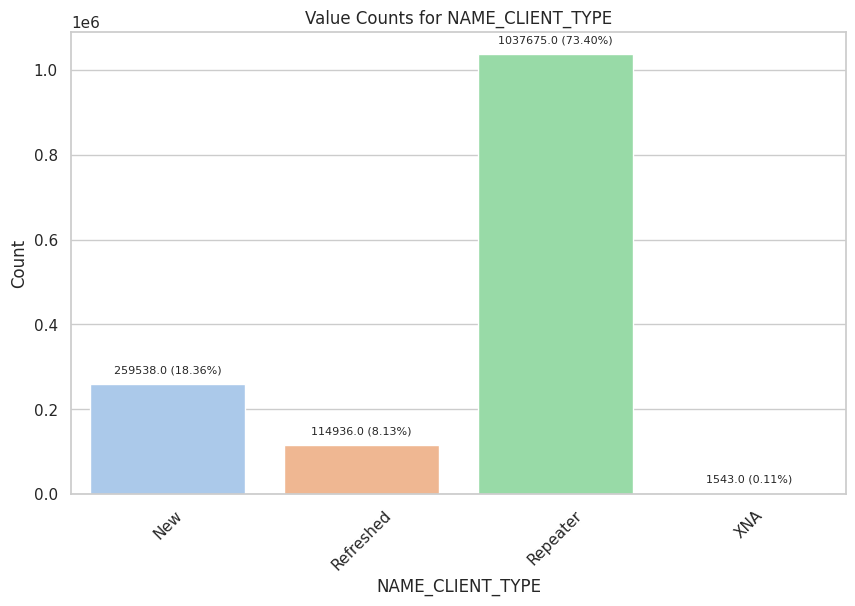

In [ ]:

plot_value_counts(combined_df, 'NAME_CLIENT_TYPE')

**Inference**:
* Most of applicants  were Repeaters applying for loan.

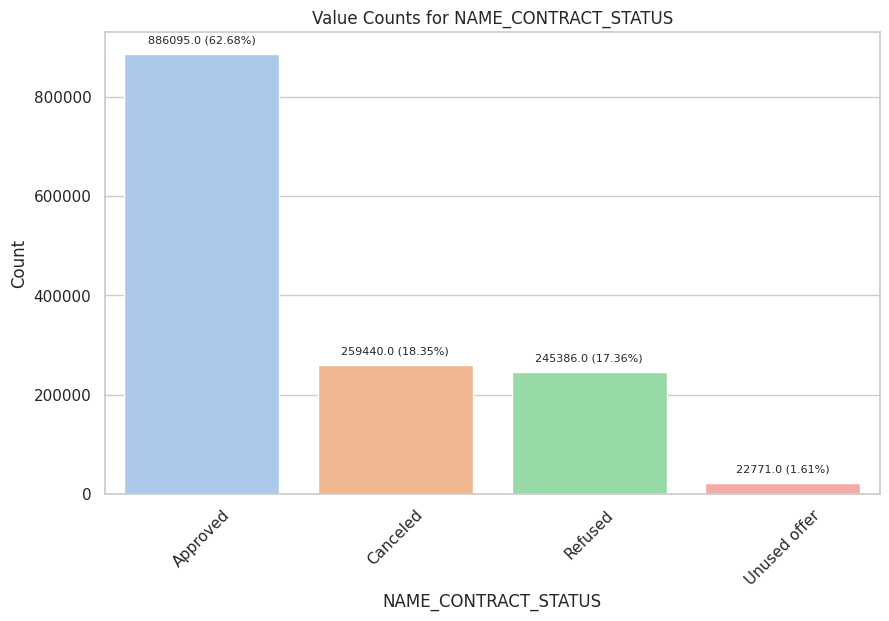

In [ ]:

plot_value_counts(combined_df, 'NAME_CONTRACT_STATUS')

**Inference**:
* Most of applicants  loans were aproved while very minority didn't utilise the offer.

In [ ]:


def bivariate_analysis(column_names):
    # Check if all columns exist in the dataframe
    missing_columns = [col for col in column_names if col not in combined_df.columns]
    if missing_columns:
        print(f"Columns {missing_columns} not found in the dataframe.")
        return

    # Create a new DataFrame for the bivariate analysis
    result_df = pd.DataFrame(columns=['Column', 'Category', 'Count_TARGET_0', 'Count_TARGET_1', 'Percentage_TARGET_0', 'Percentage_TARGET_1'])

    # Iterate over unique values in each specified column
    for column_name in column_names:
        for category in combined_df[column_name].unique():
            subset_df = combined_df[combined_df[column_name] == category]
            count_target_0 = subset_df[subset_df['TARGET'] == 0].shape[0]
            count_target_1 = subset_df[subset_df['TARGET'] == 1].shape[0]
            total_count = subset_df.shape[0]

            percentage_target_0 = (count_target_0 / total_count) * 100
            percentage_target_1 = (count_target_1 / total_count) * 100

            result_df = result_df.append({
                'Column': column_name,
                'Category': category,
                'Count_TARGET_0': count_target_0,
                'Count_TARGET_1': count_target_1,
                'Percentage_TARGET_0': percentage_target_0,
                'Percentage_TARGET_1': percentage_target_1
            }, ignore_index=True)

    # Display the result using tabulate
    print(tabulate(result_df, headers='keys', tablefmt='fancy_grid', showindex=False))


bivariate_analysis(['NAME_CASH_LOAN_PURPOSE', 'NAME_HOUSING_TYPE'])


╒════════════════════════╤══════════════════════════════════╤══════════════════╤══════════════════╤═══════════════════════╤═══════════════════════╕
│ Column                 │ Category                         │   Count_TARGET_0 │   Count_TARGET_1 │   Percentage_TARGET_0 │   Percentage_TARGET_1 │
╞════════════════════════╪══════════════════════════════════╪══════════════════╪══════════════════╪═══════════════════════╪═══════════════════════╡
│ NAME_CASH_LOAN_PURPOSE │ XAP                              │           721765 │            65163 │               91.7193 │               8.28068 │
├────────────────────────┼──────────────────────────────────┼──────────────────┼──────────────────┼───────────────────────┼───────────────────────┤
│ NAME_CASH_LOAN_PURPOSE │ XNA                              │           517893 │            49458 │               91.2826 │               8.71735 │
├────────────────────────┼──────────────────────────────────┼──────────────────┼──────────────────┼─────────────

**Inference** :
* Clients who already have other loans, under category " Refusal to name the goal", and who takes loans Hobby   finds it more difficult to pay back loans
* Clients who are taking loans to Buy Garage or build houses find it easier to pay back loans





# **CONCLUSION**



*   The combination with the highest percentage of Loan Payment Difficulties (TARGET=0) is: Cash loans-F-Unaccompanied-Pensioner-Secondary / secondary special-Married-House / apartment-Unknown-TUESDAY-XNA
*   The combination with the lowest percentage of Loan Payment Difficulties (TARGET=1) is: Cash loans-F-Children-Commercial associate-Higher education-Married-House / apartment-Core staff-MONDAY-Self-employed
* Clients who has already taken loans tend to take additional loans
* For Older people(DAYS_BIRTH) paying back loans looks easier
* "IT staff" and "HR staff" show higher repayment rates."Low-skill Laborers" and "Waiters/barmen staff" have lower repayment rates.
* Widows have the highest repayment rate (94.18%).
* Although very less in number, Businessman, Student and clients with Academic degree tends to payback loans better
* Clients who are in MAternity leave, Unemployed, and clients who live in Rented apartments are having difficulty i paying back loans
* Females have more chance of paying back loans
* Working category in income type are finding it difficult to payback loans

